# Breast Cancer

In [81]:
# loading the important libraries 

import numpy as np
import pandas as pd 
from matplotlib import pyplot as plt
import seaborn as sns 

import warnings
warnings.filterwarnings('ignore')
%matplotlib inline


In [82]:
# read the dataset 
pd.set_option("display.max_columns", None)

df = pd.read_csv('Group4_Cse499A_breast-cancer.csv')
print(df.shape)
df.head()

(569, 32)


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [83]:
df

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.1760,1.2560,7.673,158.70,0.010300,0.02891,0.05198,0.02454,0.01114,0.004239,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,0.7655,2.4630,5.203,99.04,0.005769,0.02423,0.03950,0.01678,0.01898,0.002498,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,0.4564,1.0750,3.425,48.55,0.005903,0.03731,0.04730,0.01557,0.01318,0.003892,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,0.7260,1.5950,5.772,86.22,0.006522,0.06158,0.07117,0.01664,0.02324,0.006185,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 32 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [5]:
for cols in df.columns:
    unique_vals = df[cols].unique()
    if len(unique_vals) <= 10:
        print("Feature ", cols, " has ", len(unique_vals), " unique values ----> ", unique_vals)
    else:
        print("Feature ", cols, " has ", len(unique_vals), " unique values")

Feature  id  has  569  unique values
Feature  diagnosis  has  2  unique values ---->  ['M' 'B']
Feature  radius_mean  has  456  unique values
Feature  texture_mean  has  479  unique values
Feature  perimeter_mean  has  522  unique values
Feature  area_mean  has  539  unique values
Feature  smoothness_mean  has  474  unique values
Feature  compactness_mean  has  537  unique values
Feature  concavity_mean  has  537  unique values
Feature  concave points_mean  has  542  unique values
Feature  symmetry_mean  has  432  unique values
Feature  fractal_dimension_mean  has  499  unique values
Feature  radius_se  has  540  unique values
Feature  texture_se  has  519  unique values
Feature  perimeter_se  has  533  unique values
Feature  area_se  has  528  unique values
Feature  smoothness_se  has  547  unique values
Feature  compactness_se  has  541  unique values
Feature  concavity_se  has  533  unique values
Feature  concave points_se  has  507  unique values
Feature  symmetry_se  has  498  uni

In [84]:
df.drop(columns = 'id', axis=1, inplace=True)

# Data Pre-processing Phase

# EDA 

In [9]:
## checking for null values
df.isnull().sum()

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64

In [85]:
# remove duplicate entries, if any
df.drop_duplicates(inplace = True)
print(df.shape)

(569, 31)


In [9]:
for colum in df.columns:
    
        print("Feature ", colum)
    
        print("value count ", df[colum].value_counts())

Feature  diagnosis
value count  B    357
M    212
Name: diagnosis, dtype: int64
Feature  radius_mean
value count  12.340    4
13.850    3
12.460    3
12.180    3
10.260    3
         ..
13.380    1
7.691     1
9.683     1
16.500    1
9.904     1
Name: radius_mean, Length: 456, dtype: int64
Feature  texture_mean
value count  19.83    3
16.85    3
17.46    3
18.90    3
20.52    3
        ..
22.07    1
23.12    1
24.98    1
16.18    1
18.16    1
Name: texture_mean, Length: 479, dtype: int64
Feature  perimeter_mean
value count  87.76     3
134.70    3
82.61     3
130.70    2
123.70    2
         ..
48.34     1
96.85     1
116.10    1
109.00    1
103.80    1
Name: perimeter_mean, Length: 522, dtype: int64
Feature  area_mean
value count  512.2     3
420.3     2
684.5     2
477.3     2
466.1     2
         ..
1169.0    1
642.7     1
466.5     1
1265.0    1
476.5     1
Name: area_mean, Length: 539, dtype: int64
Feature  smoothness_mean
value count  0.10070    5
0.10750    4
0.10540    4
0.1150

Feature  diagnosis


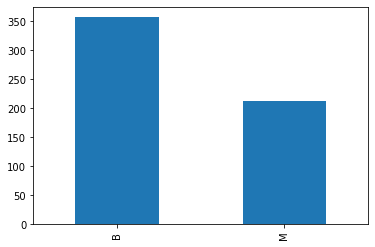

In [86]:
for colm in df.columns:
       if len(df[colm].unique()) <= 30:
            
          print("Feature ", colm)
          df[colm].value_counts().plot(kind="bar")
          plt.show()

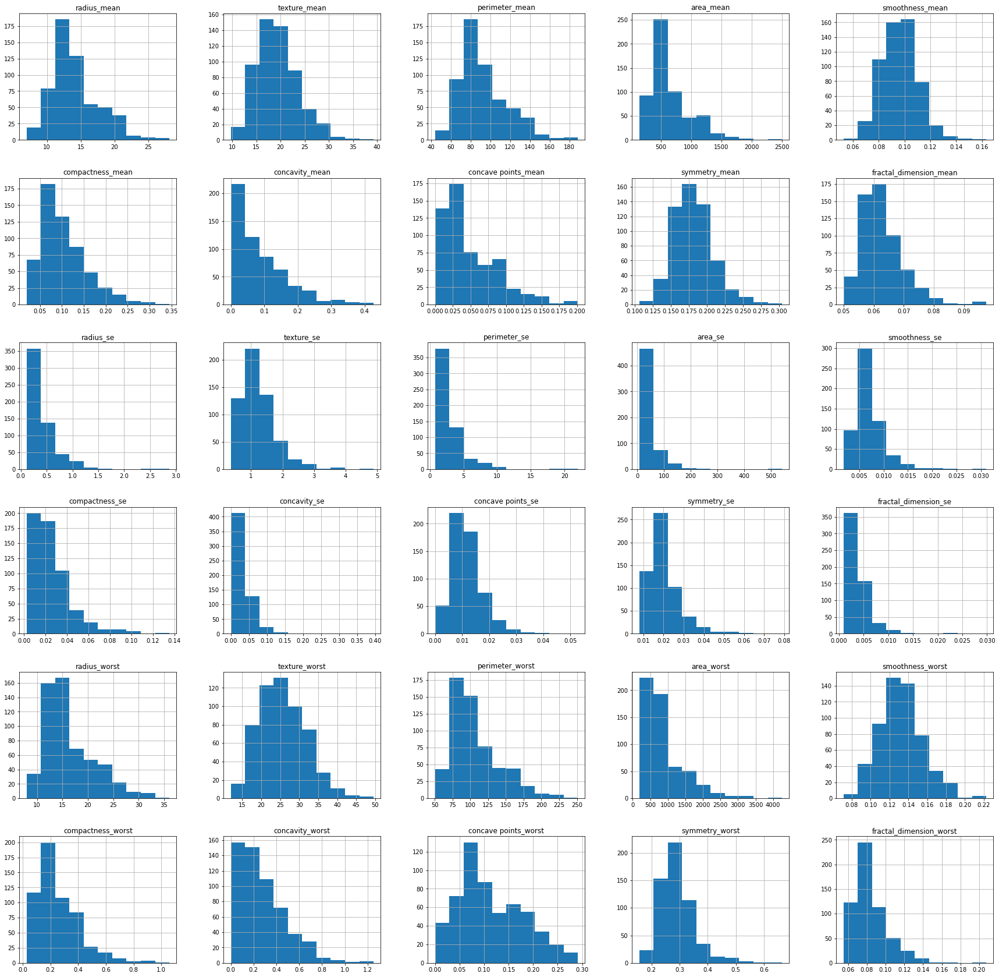

In [11]:
df.hist(figsize=(30,30))
plt.show()

<AxesSubplot:xlabel='radius_mean', ylabel='Count'>

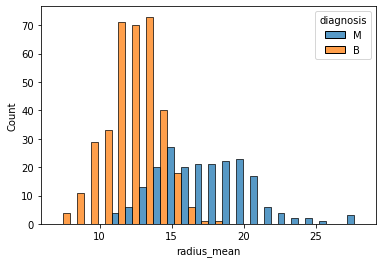

In [12]:
sns.histplot(x = 'radius_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='radius_mean', ylabel='diagnosis'>

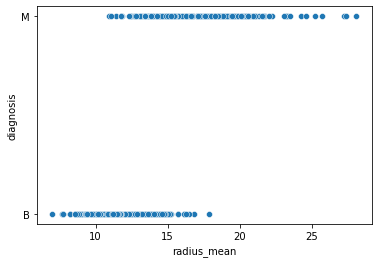

In [13]:
sns.scatterplot(df['radius_mean'],df['diagnosis'])

In [ ]:
For Feature radius_mean,the values after 15 have more chances of having malignant than benign

<AxesSubplot:xlabel='texture_mean', ylabel='Count'>

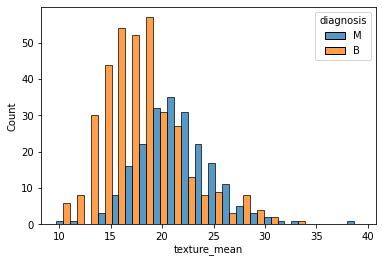

In [14]:
sns.histplot(x = 'texture_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='texture_mean', ylabel='diagnosis'>

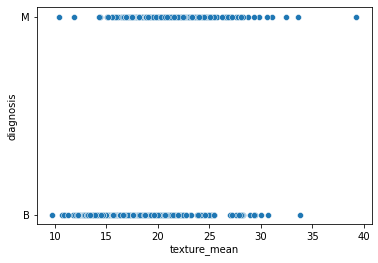

In [15]:
sns.scatterplot(df['texture_mean'],df['diagnosis'])

In [ ]:
For Feature texture_mean,the values after 20 have more chances of having malignant than benign

<AxesSubplot:xlabel='perimeter_mean', ylabel='Count'>

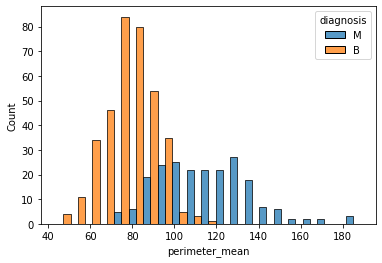

In [16]:
sns.histplot(x = 'perimeter_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='perimeter_mean', ylabel='diagnosis'>

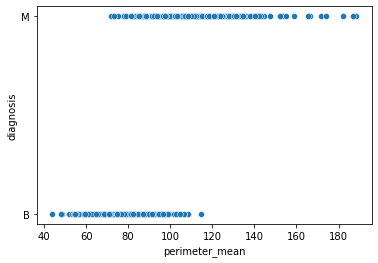

In [17]:
sns.scatterplot(df['perimeter_mean'],df['diagnosis'])

In [ ]:
For Feature perimeter_mean,the values after 100 have more chances of having malignant than benign

<AxesSubplot:xlabel='area_mean', ylabel='Count'>

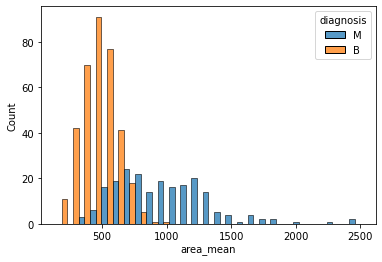

In [18]:
sns.histplot(x = 'area_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='area_mean', ylabel='diagnosis'>

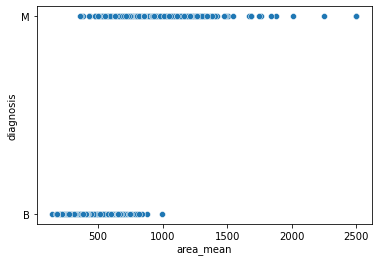

In [19]:
sns.scatterplot(df['area_mean'],df['diagnosis'])

In [ ]:
For Feature area_mean,the values after 800 have more chances of having malignant than benign

<AxesSubplot:xlabel='smoothness_mean', ylabel='Count'>

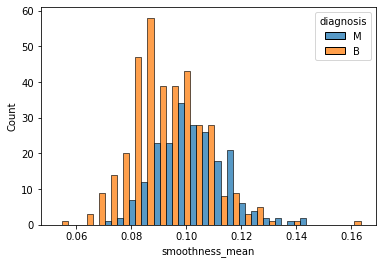

In [20]:
sns.histplot(x = 'smoothness_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='smoothness_mean', ylabel='diagnosis'>

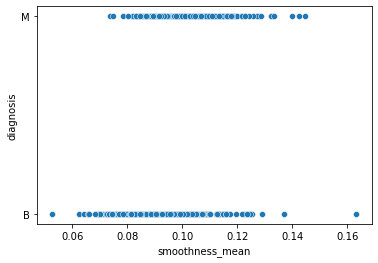

In [21]:
sns.scatterplot(df['smoothness_mean'],df['diagnosis'])

In [ ]:
For Feature smoothness_mean,the values after 0.11 have more chances of having malignant than benign

<AxesSubplot:xlabel='compactness_mean', ylabel='Count'>

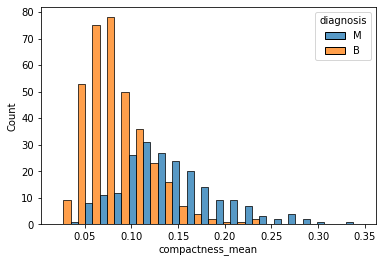

In [22]:
sns.histplot(x = 'compactness_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='compactness_mean', ylabel='diagnosis'>

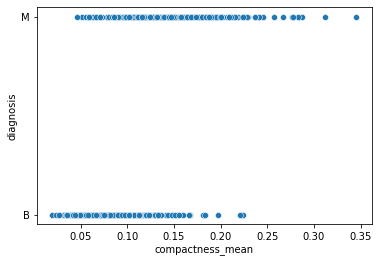

In [23]:
sns.scatterplot(df['compactness_mean'],df['diagnosis'])

In [ ]:
For Feature compactness_mean,the values after 0.12 have more chances of having malignant than benign

<AxesSubplot:xlabel='concavity_mean', ylabel='Count'>

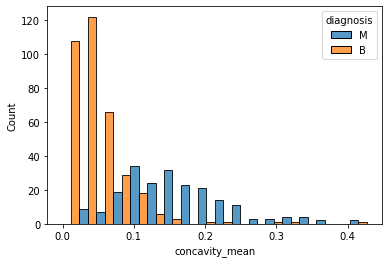

In [24]:
sns.histplot(x = 'concavity_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='concavity_mean', ylabel='diagnosis'>

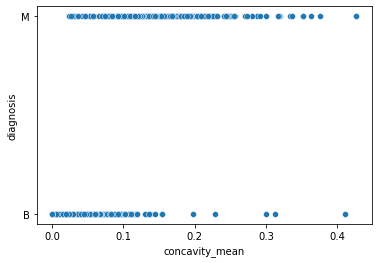

In [25]:
sns.scatterplot(df['concavity_mean'],df['diagnosis'])

In [ ]:
For Feature concavity_mean,the values after 0.1 have more chances of having malignant than benign

<AxesSubplot:xlabel='concave points_mean', ylabel='Count'>

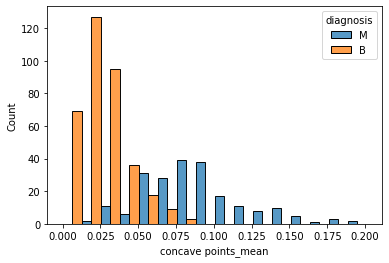

In [26]:
sns.histplot(x = 'concave points_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='concave points_mean', ylabel='diagnosis'>

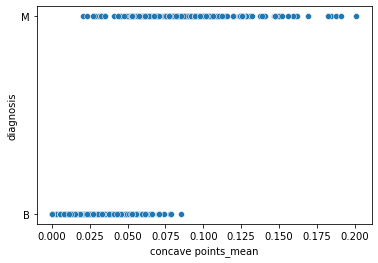

In [27]:
sns.scatterplot(df['concave points_mean'],df['diagnosis'])

In [ ]:
For Feature concave points_mean,the values after 0.050 have more chances of having malignant than benign

<AxesSubplot:xlabel='symmetry_mean', ylabel='Count'>

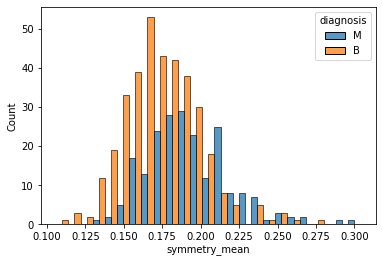

In [28]:
sns.histplot(x = 'symmetry_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='symmetry_mean', ylabel='diagnosis'>

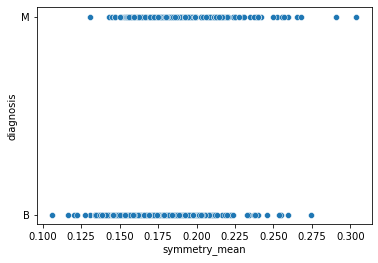

In [29]:
sns.scatterplot(df['symmetry_mean'],df['diagnosis'])

In [ ]:
For Feature symmetry_mean,the values after 0.200 have more chances of having malignant than benign

<AxesSubplot:xlabel='fractal_dimension_mean', ylabel='Count'>

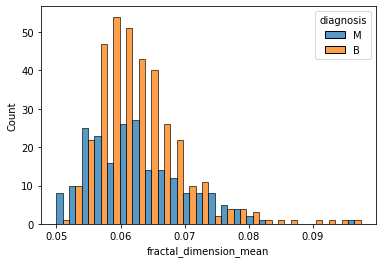

In [30]:
sns.histplot(x = 'fractal_dimension_mean', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='fractal_dimension_mean', ylabel='diagnosis'>

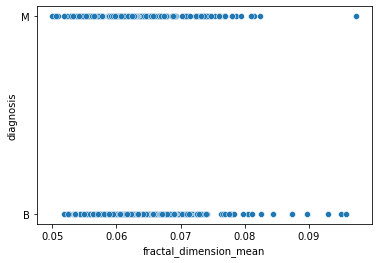

In [31]:
sns.scatterplot(df['fractal_dimension_mean'],df['diagnosis'])

In [ ]:
For Feature fractal_dimension_mean,the values before 0.00 have more chances of having malignant than benign

<AxesSubplot:xlabel='radius_se', ylabel='Count'>

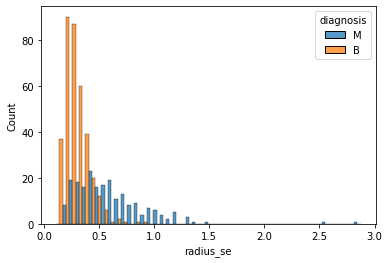

In [32]:
sns.histplot(x = 'radius_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='radius_se', ylabel='diagnosis'>

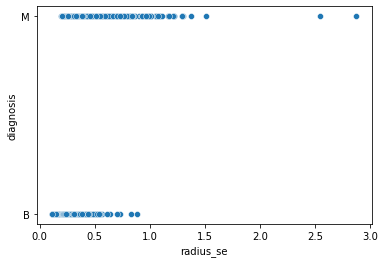

In [33]:
sns.scatterplot(df['radius_se'],df['diagnosis'])

In [ ]:
For Feature radius_se,the values after 0.5 have more chances of having malignant than benign

<AxesSubplot:xlabel='texture_se', ylabel='Count'>

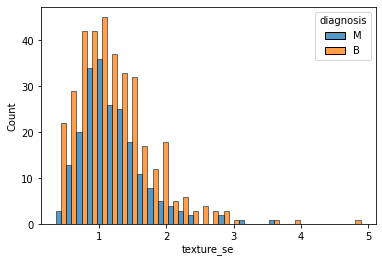

In [34]:
sns.histplot(x = 'texture_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='texture_se', ylabel='diagnosis'>

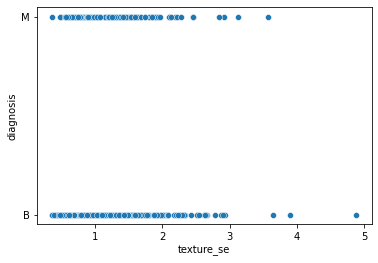

In [35]:
sns.scatterplot(df['texture_se'],df['diagnosis'])

In [ ]:
Feature texture_se has no variation in both categories

<AxesSubplot:xlabel='perimeter_se', ylabel='Count'>

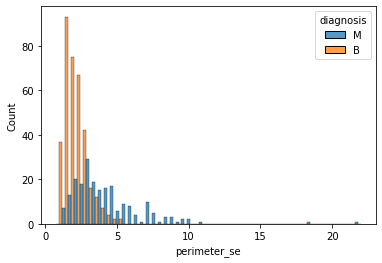

In [36]:
sns.histplot(x = 'perimeter_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='perimeter_se', ylabel='diagnosis'>

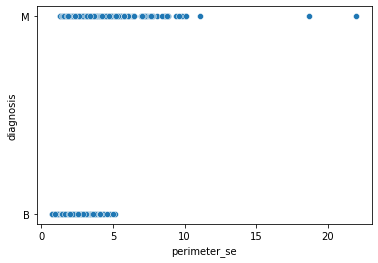

In [37]:
sns.scatterplot(df['perimeter_se'],df['diagnosis'])

In [ ]:
For Feature perimeter_se,the values after 5 have more chances of having malignant than benign

<AxesSubplot:xlabel='area_se', ylabel='Count'>

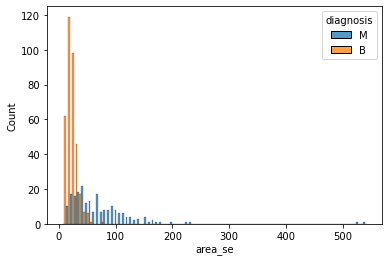

In [38]:
sns.histplot(x = 'area_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='area_se', ylabel='diagnosis'>

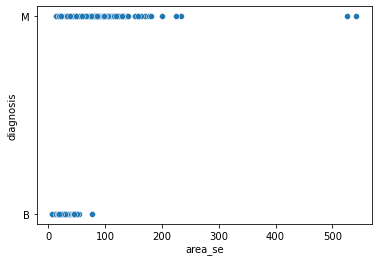

In [39]:
sns.scatterplot(df['area_se'],df['diagnosis'])

In [ ]:
For Feature area_se,the values after 30 have more chances of having malignant than benign

<AxesSubplot:xlabel='smoothness_se', ylabel='Count'>

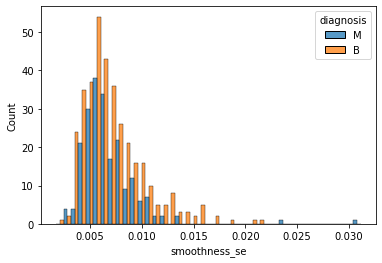

In [40]:
sns.histplot(x = 'smoothness_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='smoothness_se', ylabel='diagnosis'>

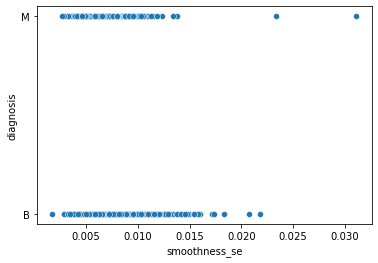

In [41]:
sns.scatterplot(df['smoothness_se'],df['diagnosis'])

In [ ]:
For Feature smoothness_se,the values after 0.020 have more chances of having malignant than benign

<AxesSubplot:xlabel='compactness_se', ylabel='Count'>

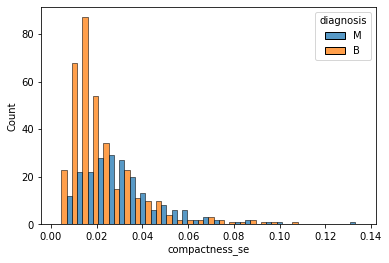

In [42]:
sns.histplot(x = 'compactness_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='compactness_se', ylabel='diagnosis'>

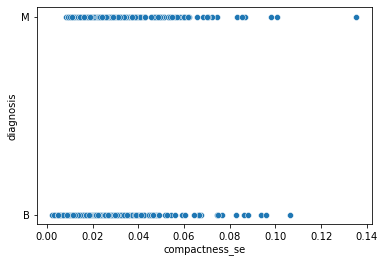

In [43]:
sns.scatterplot(df['compactness_se'],df['diagnosis'])

In [ ]:
For Feature compactness_se,the values after 0.02 have more chances of having malignant than benign

<AxesSubplot:xlabel='concavity_se', ylabel='Count'>

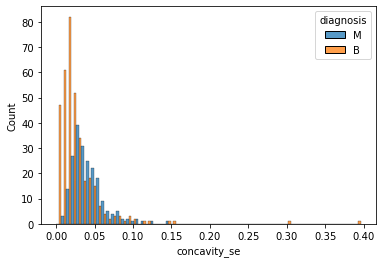

In [44]:
sns.histplot(x = 'concavity_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='concavity_se', ylabel='diagnosis'>

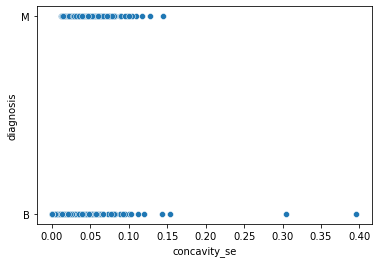

In [45]:
sns.scatterplot(df['concavity_se'],df['diagnosis'])

In [ ]:
For Feature concavity_se,the values after 0.03 have more chances of having malignant than benign

<AxesSubplot:xlabel='concave points_se', ylabel='Count'>

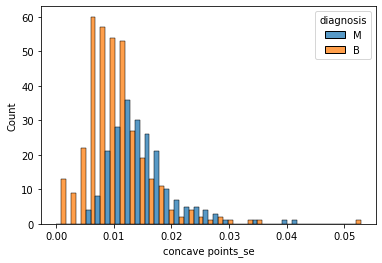

In [46]:
sns.histplot(x = 'concave points_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='concave points_se', ylabel='diagnosis'>

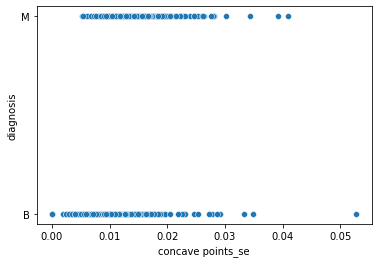

In [47]:
sns.scatterplot(df['concave points_se'],df['diagnosis'])

In [ ]:
For Feature concave points_se,the values after 0.01 have more chances of having malignant than benign

<AxesSubplot:xlabel='symmetry_se', ylabel='Count'>

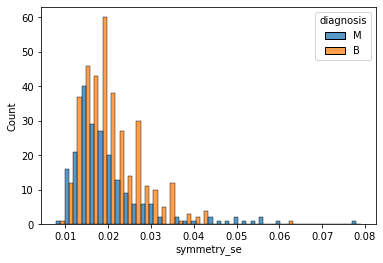

In [48]:
sns.histplot(x = 'symmetry_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='symmetry_se', ylabel='diagnosis'>

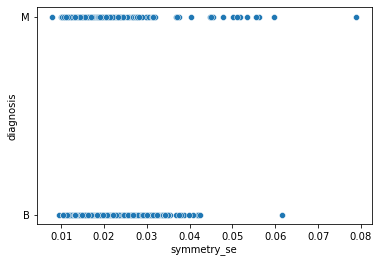

In [49]:
sns.scatterplot(df['symmetry_se'],df['diagnosis'])

In [ ]:
For Feature symmetry_se,the values after 0.04 have more chances of having malignant than benign

<AxesSubplot:xlabel='fractal_dimension_se', ylabel='Count'>

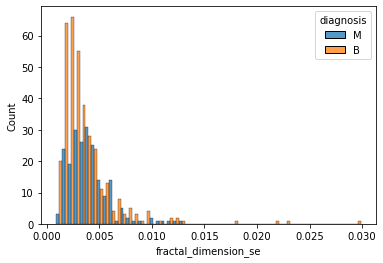

In [50]:
sns.histplot(x = 'fractal_dimension_se', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='fractal_dimension_se', ylabel='diagnosis'>

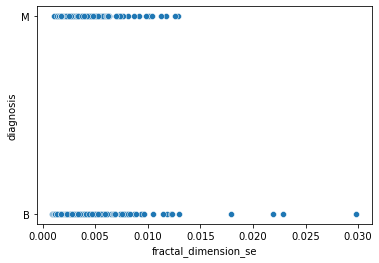

In [51]:
sns.scatterplot(df['fractal_dimension_se'],df['diagnosis'])

In [ ]:
For Feature fractal_dimension_se,the values after 0.004 have more chances of having malignant than benign

<AxesSubplot:xlabel='radius_worst', ylabel='Count'>

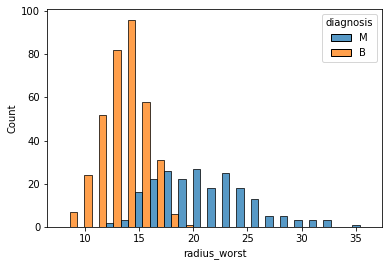

In [52]:
sns.histplot(x = 'radius_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='radius_worst', ylabel='diagnosis'>

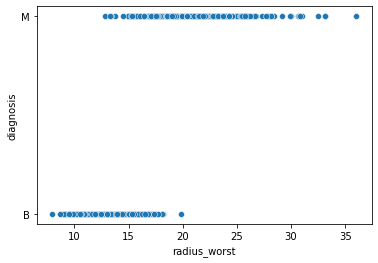

In [53]:
sns.scatterplot(df['radius_worst'],df['diagnosis'])

In [ ]:
For Feature radius_worst,the values after 19 have more chances of having malignant than benign

<AxesSubplot:xlabel='texture_worst', ylabel='Count'>

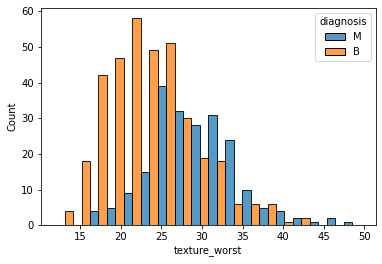

In [54]:
sns.histplot(x = 'texture_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='texture_worst', ylabel='diagnosis'>

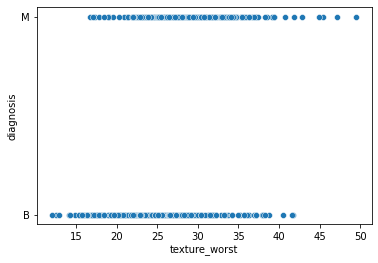

In [55]:
sns.scatterplot(df['texture_worst'],df['diagnosis'])

In [ ]:
For Feature texture_worst,the values after 30 have more chances of having malignant than benign

<AxesSubplot:xlabel='perimeter_worst', ylabel='Count'>

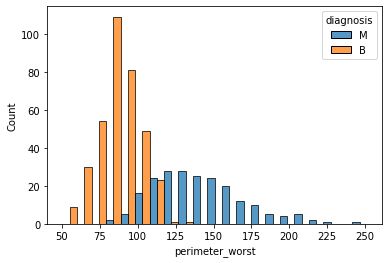

In [56]:
sns.histplot(x = 'perimeter_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='perimeter_worst', ylabel='diagnosis'>

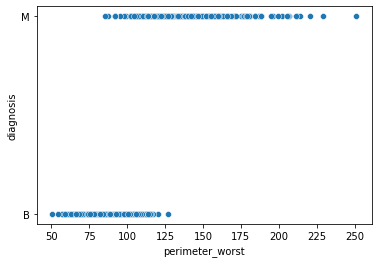

In [57]:
sns.scatterplot(df['perimeter_worst'],df['diagnosis'])

In [ ]:
For Feature perimeter_worst,the values after 125 have more chances of having malignant than benign

<AxesSubplot:xlabel='area_worst', ylabel='Count'>

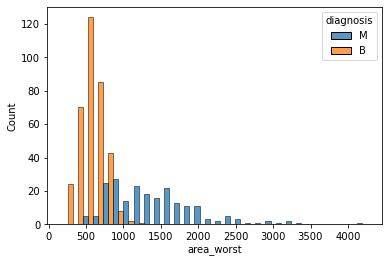

In [58]:
sns.histplot(x = 'area_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='area_worst', ylabel='diagnosis'>

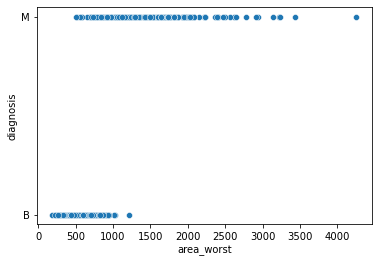

In [59]:
sns.scatterplot(df['area_worst'],df['diagnosis'])

In [ ]:
For Feature area_worst,the values after 1300 have more chances of having malignant than benign

<AxesSubplot:xlabel='smoothness_worst', ylabel='Count'>

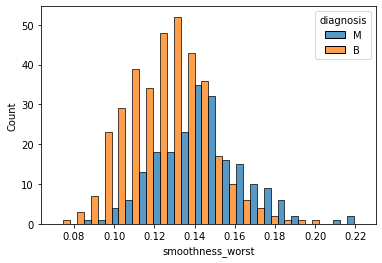

In [60]:
sns.histplot(x = 'smoothness_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='smoothness_worst', ylabel='diagnosis'>

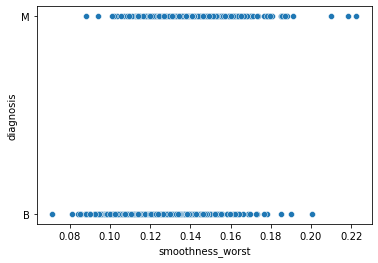

In [61]:
sns.scatterplot(df['smoothness_worst'],df['diagnosis'])

In [ ]:
For Feature smoothness_worst,the values after 0.15 have more chances of having malignant than benign

<AxesSubplot:xlabel='compactness_worst', ylabel='Count'>

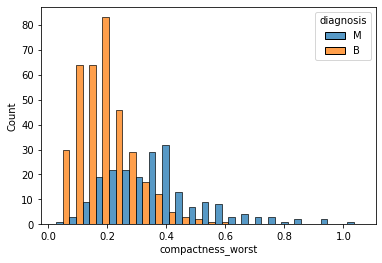

In [62]:
sns.histplot(x = 'compactness_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='compactness_worst', ylabel='diagnosis'>

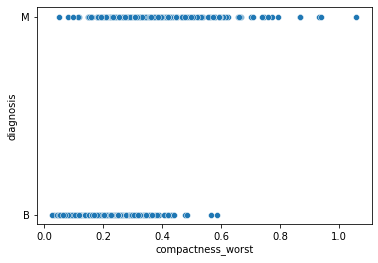

In [63]:
sns.scatterplot(df['compactness_worst'],df['diagnosis'])

In [ ]:
For Feature compactness_worst,the values after 0.3 have more chances of having malignant than benign

<AxesSubplot:xlabel='concavity_worst', ylabel='Count'>

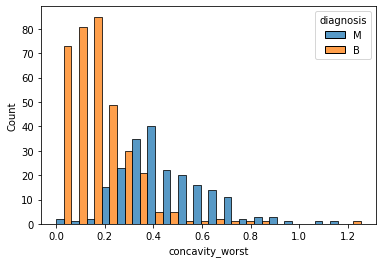

In [64]:
sns.histplot(x = 'concavity_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='concavity_worst', ylabel='diagnosis'>

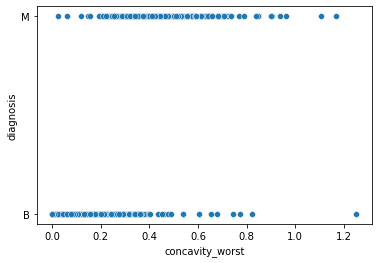

In [65]:
sns.scatterplot(df['concavity_worst'],df['diagnosis'])

In [ ]:
For Feature concavity_worst,the values after 0.2 have more chances of having malignant than benign

<AxesSubplot:xlabel='concave points_worst', ylabel='Count'>

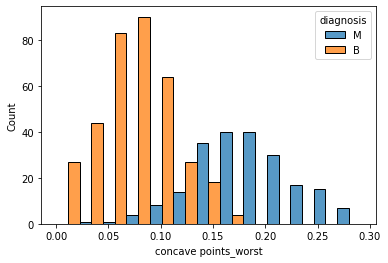

In [66]:
sns.histplot(x = 'concave points_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='concave points_worst', ylabel='diagnosis'>

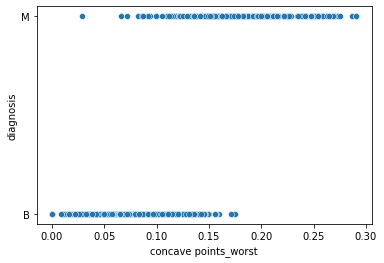

In [67]:
sns.scatterplot(df['concave points_worst'],df['diagnosis'])

In [ ]:
For Feature concave points_worst,the values after 0.10 have more chances of having malignant than benign

<AxesSubplot:xlabel='symmetry_worst', ylabel='Count'>

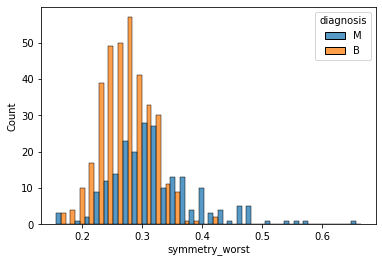

In [68]:
sns.histplot(x = 'symmetry_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='symmetry_worst', ylabel='diagnosis'>

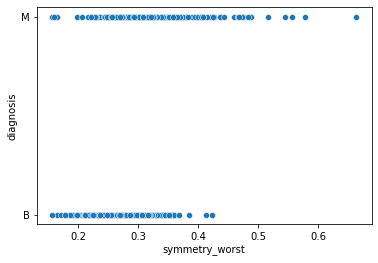

In [69]:
sns.scatterplot(df['symmetry_worst'],df['diagnosis'])

In [ ]:
For Feature symmetry_worst,the values after 0.3 have more chances of having malignant than benign

<AxesSubplot:xlabel='fractal_dimension_worst', ylabel='Count'>

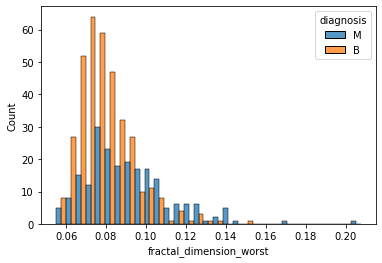

In [70]:
sns.histplot(x = 'fractal_dimension_worst', data = df, hue = 'diagnosis',multiple = 'dodge')

<AxesSubplot:xlabel='fractal_dimension_worst', ylabel='diagnosis'>

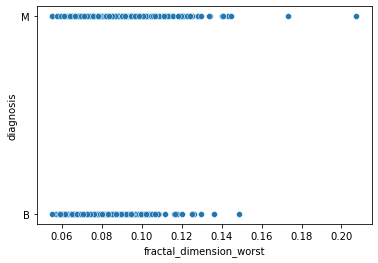

In [71]:
sns.scatterplot(df['fractal_dimension_worst'],df['diagnosis'])

In [ ]:
For Feature fractal_dimension_worst,the values after 0.12 have more chances of having malignant than benign

#Checking outliers

In [12]:
df.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,2.873000,4.885000,21.980000,542.200000,0.031130,0.135400,0.396000,0.052790,0.078950,0.029840,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


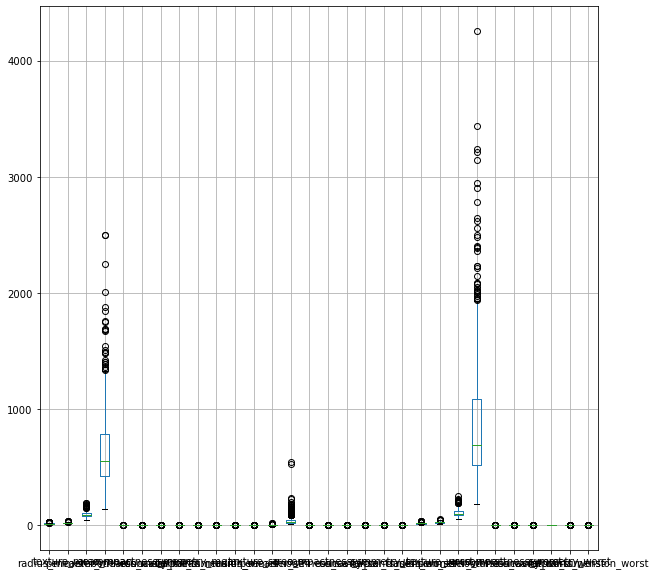

In [13]:
df.boxplot(figsize=(10,10))
plt.show()

In [14]:
# implementation of the Tukey's algorithm
def findOutliers(dataset):
    outliers = []
    Q2 = dataset.median()
    Q1 = dataset.describe()[4]
    Q3 = dataset.describe()[6]
    IQR = Q3 - Q1
    lf = Q1 - 1.5*IQR # lf = lower fence
    uf = Q3 + 1.5*IQR # Uf = Upper fence
    for x in dataset:
        if x < lf or x > uf:
            outliers.append(x)
    return outliers

In [15]:
findOutliers(df['radius_mean'])

[25.22,
 22.27,
 24.25,
 23.27,
 27.22,
 23.29,
 28.11,
 23.21,
 23.51,
 25.73,
 22.01,
 27.42,
 23.09,
 24.63]

<AxesSubplot:xlabel='radius_mean'>

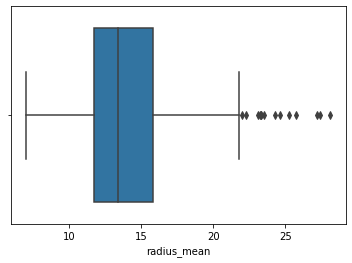

In [16]:
sns.boxplot(x = 'radius_mean', data = df)

In [17]:
Q1 = df['radius_mean'].quantile(0.25)
Q3 = df['radius_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['radius_mean']=np.where(df['radius_mean']>upper_whisker,upper_whisker,np.where(df['radius_mean']<lower_whisker,
                                                                                  lower_whisker,df['radius_mean']))

<AxesSubplot:xlabel='radius_mean'>

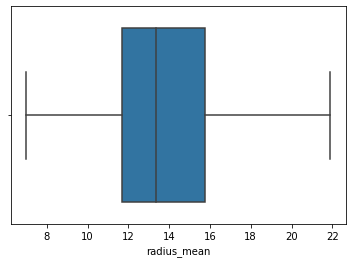

In [18]:
sns.boxplot(x = 'radius_mean', data = df)

In [19]:
findOutliers(df['texture_mean'])

[32.47, 33.81, 39.28, 33.56, 31.12, 30.72, 30.62]

<AxesSubplot:xlabel='texture_mean'>

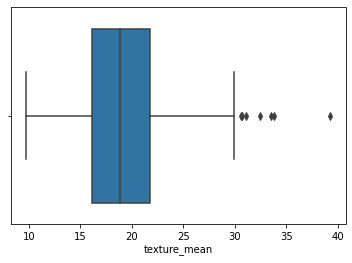

In [20]:
sns.boxplot(x = 'texture_mean', data = df)

In [21]:
Q1 = df['texture_mean'].quantile(0.25)
Q3 = df['texture_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['texture_mean']=np.where(df['texture_mean']>upper_whisker,upper_whisker,np.where(df['texture_mean']<lower_whisker,
                                                                                    lower_whisker,df['texture_mean']))

<AxesSubplot:xlabel='texture_mean'>

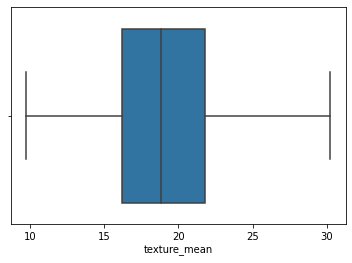

In [22]:
sns.boxplot(x = 'texture_mean', data = df)

In [23]:
findOutliers(df['perimeter_mean'])

[171.5,
 152.8,
 166.2,
 152.1,
 182.1,
 158.9,
 188.5,
 153.5,
 155.1,
 174.2,
 186.9,
 152.1,
 165.5]

<AxesSubplot:xlabel='perimeter_mean'>

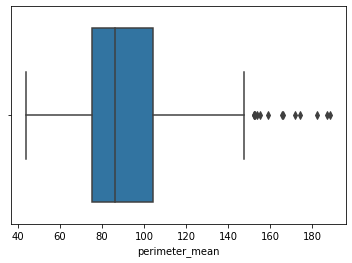

In [24]:
sns.boxplot(x = 'perimeter_mean', data = df)

In [25]:
Q1 = df['perimeter_mean'].quantile(0.25)
Q3 = df['perimeter_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['perimeter_mean']=np.where(df['perimeter_mean']>upper_whisker,upper_whisker,np.where(df['perimeter_mean']<lower_whisker,
                                                                                        lower_whisker,df['perimeter_mean']))

<AxesSubplot:xlabel='perimeter_mean'>

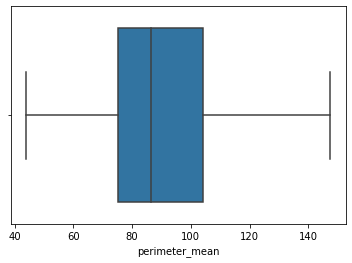

In [26]:
sns.boxplot(x = 'perimeter_mean', data = df)

In [27]:
findOutliers(df['area_mean'])

[1404.0,
 1878.0,
 1509.0,
 1761.0,
 1686.0,
 2250.0,
 1685.0,
 2499.0,
 1670.0,
 1364.0,
 1419.0,
 1491.0,
 1747.0,
 2010.0,
 1546.0,
 1482.0,
 1386.0,
 1335.0,
 1407.0,
 1384.0,
 2501.0,
 1682.0,
 1841.0,
 1347.0,
 1479.0]

<AxesSubplot:xlabel='area_mean'>

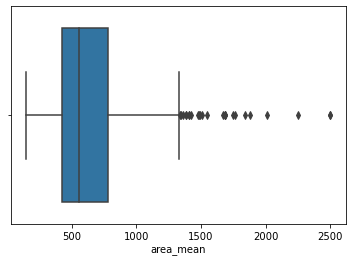

In [28]:
sns.boxplot(x = 'area_mean', data = df)

In [29]:
Q1 = df['area_mean'].quantile(0.25)
Q3 = df['area_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['area_mean']=np.where(df['area_mean']>upper_whisker,upper_whisker,np.where(df['area_mean']<lower_whisker,
                                                                              lower_whisker,df['area_mean']))

<AxesSubplot:xlabel='area_mean'>

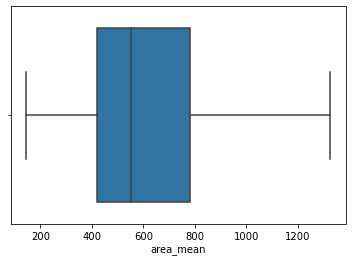

In [30]:
sns.boxplot(x = 'area_mean', data = df)

In [31]:
findOutliers(df['smoothness_mean'])

[0.1425, 0.1398, 0.1447, 0.1634, 0.1371, 0.05263]

<AxesSubplot:xlabel='smoothness_mean'>

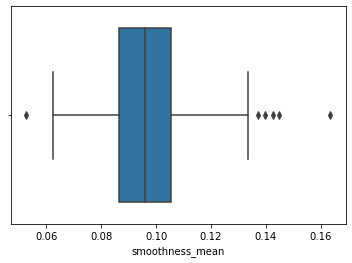

In [32]:
sns.boxplot(x = 'smoothness_mean', data = df)

In [33]:
Q1 = df['smoothness_mean'].quantile(0.25)
Q3 = df['smoothness_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['smoothness_mean']=np.where(df['smoothness_mean']>upper_whisker,upper_whisker,np.where(df['smoothness_mean']<lower_whisker,
                                                                                          lower_whisker,df['smoothness_mean']))

<AxesSubplot:xlabel='smoothness_mean'>

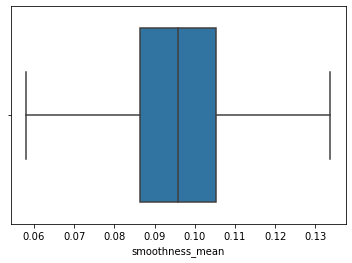

In [34]:
sns.boxplot(x = 'smoothness_mean', data = df)

In [35]:
findOutliers(df['compactness_mean'])

[0.2776,
 0.2839,
 0.2396,
 0.2458,
 0.2293,
 0.3454,
 0.2665,
 0.2768,
 0.2867,
 0.2832,
 0.2413,
 0.3114,
 0.2364,
 0.2363,
 0.2576,
 0.277]

<AxesSubplot:xlabel='compactness_mean'>

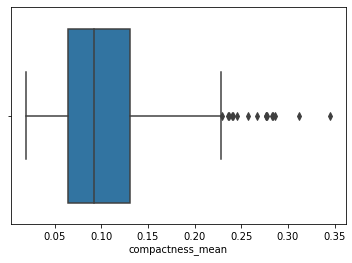

In [36]:
sns.boxplot(x = 'compactness_mean', data = df)

In [37]:
Q1 = df['compactness_mean'].quantile(0.25)
Q3 = df['compactness_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['compactness_mean']=np.where(df['compactness_mean']>upper_whisker,upper_whisker,np.where(df['compactness_mean']<lower_whisker,
                                                                                            lower_whisker,df['compactness_mean']))

<AxesSubplot:xlabel='compactness_mean'>

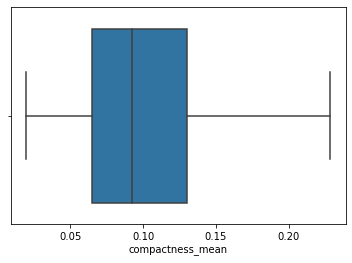

In [38]:
sns.boxplot(x = 'compactness_mean', data = df)

In [39]:
findOutliers(df['concavity_mean'])

[0.3001,
 0.313,
 0.3754,
 0.3339,
 0.4264,
 0.3003,
 0.4268,
 0.4108,
 0.2871,
 0.3523,
 0.3201,
 0.3176,
 0.2914,
 0.3368,
 0.3189,
 0.3635,
 0.3174,
 0.3514]

<AxesSubplot:xlabel='concavity_mean'>

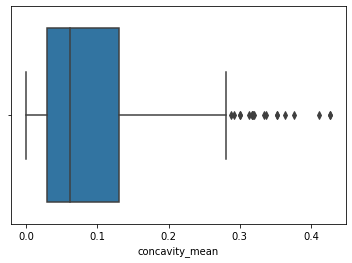

In [40]:
sns.boxplot(x = 'concavity_mean', data = df)

In [41]:
Q1 = df['concavity_mean'].quantile(0.25)
Q3 = df['concavity_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['concavity_mean']=np.where(df['concavity_mean']>upper_whisker,upper_whisker,np.where(df['concavity_mean']<lower_whisker,
                                                                                        lower_whisker,df['concavity_mean']))

<AxesSubplot:xlabel='concavity_mean'>

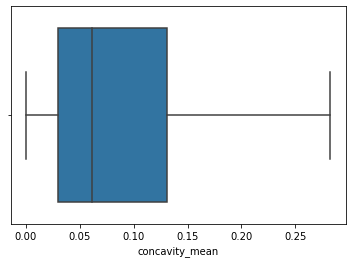

In [42]:
sns.boxplot(x = 'concavity_mean', data = df)

In [43]:
findOutliers(df['concave points_mean'])

[0.1604, 0.1845, 0.1823, 0.2012, 0.1878, 0.162, 0.1595, 0.1913, 0.1562, 0.1689]

<AxesSubplot:xlabel='concave points_mean'>

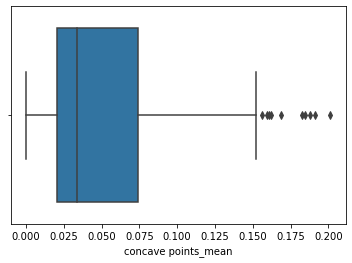

In [44]:
sns.boxplot(x = 'concave points_mean', data = df)

In [45]:
Q1 = df['concave points_mean'].quantile(0.25)
Q3 = df['concave points_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['concave points_mean']=np.where(df['concave points_mean']>upper_whisker,upper_whisker,np.where
                                   (df['concave points_mean']<lower_whisker,lower_whisker,df['concave points_mean']))

<AxesSubplot:xlabel='concave points_mean'>

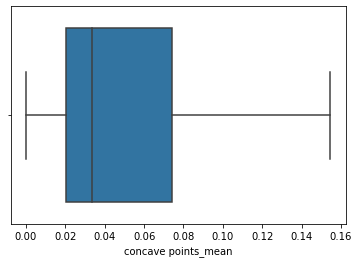

In [46]:
sns.boxplot(x = 'concave points_mean', data = df)

In [47]:
findOutliers(df['symmetry_mean'])

[0.2597,
 0.2521,
 0.304,
 0.2743,
 0.2906,
 0.2556,
 0.2655,
 0.2678,
 0.254,
 0.2548,
 0.2495,
 0.2595,
 0.2569,
 0.2538,
 0.106]

<AxesSubplot:xlabel='symmetry_mean'>

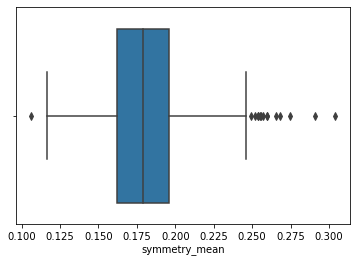

In [48]:
sns.boxplot(x = 'symmetry_mean', data = df)

In [49]:
Q1 = df['symmetry_mean'].quantile(0.25)
Q3 = df['symmetry_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['symmetry_mean']=np.where(df['symmetry_mean']>upper_whisker,upper_whisker,np.where(df['symmetry_mean']<lower_whisker,
                                                                                      lower_whisker,df['symmetry_mean']))

<AxesSubplot:xlabel='symmetry_mean'>

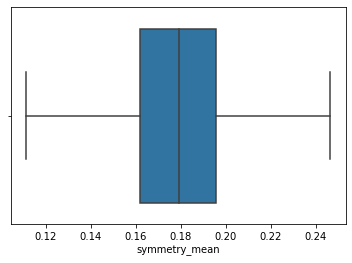

In [50]:
sns.boxplot(x = 'symmetry_mean', data = df)

In [51]:
findOutliers(df['fractal_dimension_mean'])

[0.09744,
 0.08243,
 0.08046,
 0.0898,
 0.08142,
 0.08261,
 0.09296,
 0.08116,
 0.08104,
 0.08743,
 0.0845,
 0.0795,
 0.09502,
 0.09575,
 0.07976]

<AxesSubplot:xlabel='fractal_dimension_mean'>

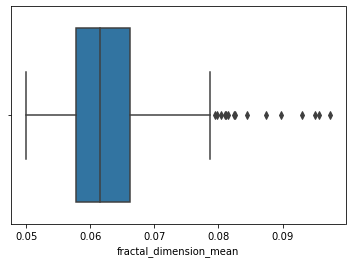

In [52]:
sns.boxplot(x = 'fractal_dimension_mean', data = df)

In [53]:
Q1 = df['fractal_dimension_mean'].quantile(0.25)
Q3 = df['fractal_dimension_mean'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['fractal_dimension_mean']=np.where(df['fractal_dimension_mean']>upper_whisker,upper_whisker,
                                      np.where(df['fractal_dimension_mean']<lower_whisker,lower_whisker,
                                               df['fractal_dimension_mean']))

<AxesSubplot:xlabel='fractal_dimension_mean'>

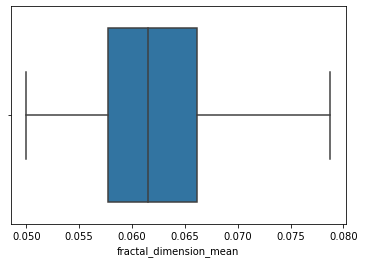

In [54]:
sns.boxplot(x = 'fractal_dimension_mean', data = df)

In [55]:
findOutliers(df['radius_se'])

[1.095,
 0.9555,
 1.046,
 0.8529,
 1.214,
 0.9811,
 0.9806,
 0.9317,
 0.8973,
 1.215,
 1.509,
 1.296,
 1.0,
 1.088,
 0.8601,
 2.873,
 0.9553,
 1.058,
 1.004,
 1.292,
 1.172,
 1.167,
 0.8811,
 1.111,
 1.072,
 1.009,
 0.9948,
 0.9761,
 1.207,
 1.008,
 1.37,
 0.9291,
 2.547,
 0.9289,
 1.291,
 0.9915,
 0.9622,
 1.176]

<AxesSubplot:xlabel='radius_se'>

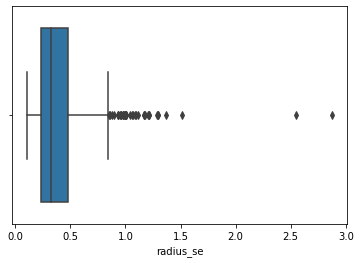

In [56]:
sns.boxplot(x = 'radius_se', data = df)

In [57]:
Q1 = df['radius_se'].quantile(0.25)
Q3 = df['radius_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['radius_se']=np.where(df['radius_se']>upper_whisker,upper_whisker,np.where(df['radius_se']<lower_whisker,
                                                                              lower_whisker,df['radius_se']))

<AxesSubplot:xlabel='radius_se'>

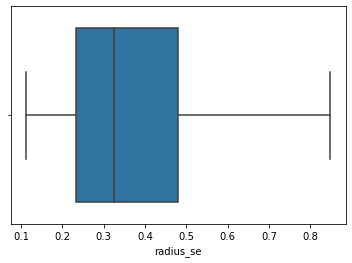

In [58]:
sns.boxplot(x = 'radius_se', data = df)

In [59]:
findOutliers(df['texture_se'])

[3.568,
 2.91,
 3.12,
 2.508,
 2.664,
 4.885,
 2.612,
 2.454,
 2.777,
 2.509,
 2.836,
 2.878,
 2.542,
 2.643,
 3.647,
 2.635,
 2.927,
 2.904,
 3.896,
 2.463]

<AxesSubplot:xlabel='texture_se'>

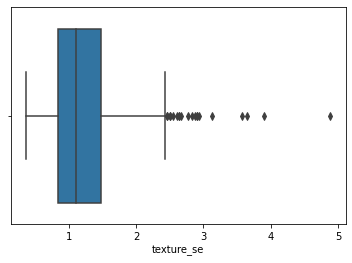

In [60]:
sns.boxplot(x = 'texture_se', data = df)

In [61]:
Q1 = df['texture_se'].quantile(0.25)
Q3 = df['texture_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['texture_se']=np.where(df['texture_se']>upper_whisker,upper_whisker,np.where(df['texture_se']<lower_whisker,
                                                                                lower_whisker,df['texture_se']))

<AxesSubplot:xlabel='texture_se'>

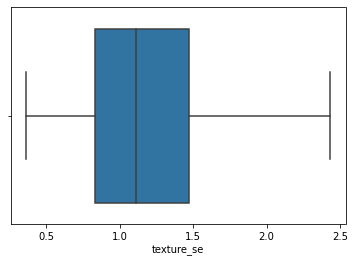

In [62]:
sns.boxplot(x = 'texture_se', data = df)

In [63]:
findOutliers(df['perimeter_se'])

[8.589,
 11.07,
 7.276,
 8.077,
 8.83,
 6.311,
 8.649,
 7.382,
 10.05,
 9.807,
 8.419,
 6.971,
 7.337,
 7.029,
 21.98,
 6.487,
 7.247,
 6.372,
 7.158,
 10.12,
 6.146,
 7.749,
 8.867,
 7.237,
 7.804,
 6.076,
 6.462,
 7.222,
 7.128,
 7.733,
 7.561,
 9.424,
 6.051,
 18.65,
 9.635,
 7.05,
 8.758,
 7.673]

<AxesSubplot:xlabel='perimeter_se'>

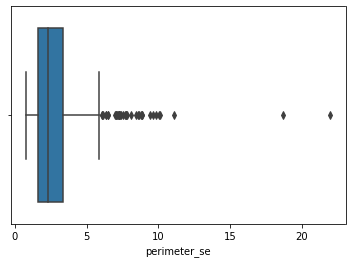

In [64]:
sns.boxplot(x = 'perimeter_se', data = df)

In [65]:
Q1 = df['perimeter_se'].quantile(0.25)
Q3 = df['perimeter_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['perimeter_se']=np.where(df['perimeter_se']>upper_whisker,upper_whisker,np.where(df['perimeter_se']<lower_whisker,
                                                                                    lower_whisker,df['perimeter_se']))

<AxesSubplot:xlabel='perimeter_se'>

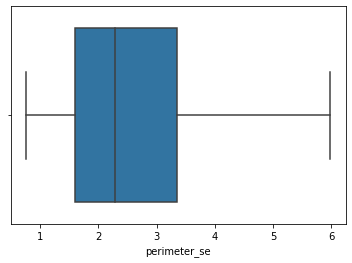

In [66]:
sns.boxplot(x = 'perimeter_se', data = df)

In [67]:
findOutliers(df['area_se'])

[153.4,
 94.03,
 94.44,
 116.2,
 112.4,
 93.99,
 102.6,
 111.4,
 93.54,
 105.0,
 106.0,
 104.9,
 98.81,
 102.5,
 96.05,
 134.8,
 116.4,
 120.0,
 87.87,
 170.0,
 90.47,
 233.0,
 101.9,
 93.91,
 119.3,
 97.07,
 97.85,
 122.3,
 128.7,
 111.7,
 525.6,
 124.4,
 109.9,
 155.8,
 137.9,
 92.81,
 106.4,
 138.5,
 90.94,
 199.7,
 156.8,
 133.0,
 130.8,
 87.17,
 88.25,
 164.1,
 153.1,
 103.6,
 224.1,
 130.2,
 176.5,
 103.9,
 115.2,
 542.2,
 104.9,
 89.74,
 95.77,
 180.2,
 139.9,
 100.4,
 87.78,
 118.8,
 158.7,
 99.04,
 86.22]

<AxesSubplot:xlabel='area_se'>

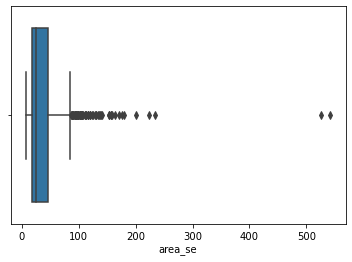

In [68]:
sns.boxplot(x = 'area_se', data = df)

In [69]:
Q1 = df['area_se'].quantile(0.25)
Q3 = df['area_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['area_se']=np.where(df['area_se']>upper_whisker,upper_whisker,np.where(df['area_se']<lower_whisker,lower_whisker,
                                                                          df['area_se']))

<AxesSubplot:xlabel='area_se'>

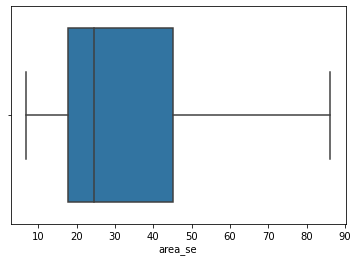

In [70]:
sns.boxplot(x = 'area_se', data = df)

In [71]:
findOutliers(df['smoothness_se'])

[0.01721,
 0.0134,
 0.01385,
 0.01291,
 0.01835,
 0.02333,
 0.01496,
 0.01286,
 0.01439,
 0.0138,
 0.01345,
 0.03113,
 0.01604,
 0.0138,
 0.01418,
 0.01574,
 0.02075,
 0.01289,
 0.01736,
 0.01582,
 0.01474,
 0.01307,
 0.01459,
 0.02177,
 0.01262,
 0.01546,
 0.01288,
 0.01266,
 0.01547,
 0.01291]

<AxesSubplot:xlabel='smoothness_se'>

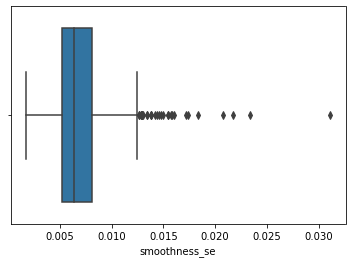

In [72]:
sns.boxplot(x = 'smoothness_se', data = df)

In [73]:
Q1 = df['smoothness_se'].quantile(0.25)
Q3 = df['smoothness_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['smoothness_se']=np.where(df['smoothness_se']>upper_whisker,upper_whisker,np.where(df['smoothness_se']<lower_whisker,
                                                                                      lower_whisker,df['smoothness_se']))

<AxesSubplot:xlabel='smoothness_se'>

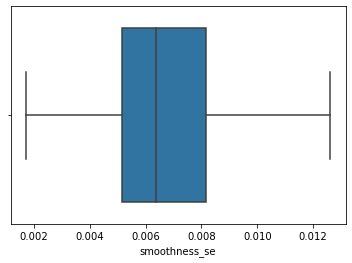

In [74]:
sns.boxplot(x = 'smoothness_se', data = df)

In [75]:
findOutliers(df['compactness_se'])

[0.07458,
 0.07217,
 0.08297,
 0.1006,
 0.07056,
 0.08606,
 0.09368,
 0.06835,
 0.08668,
 0.07446,
 0.0676,
 0.09806,
 0.09586,
 0.08808,
 0.1354,
 0.08555,
 0.08262,
 0.1064,
 0.0659,
 0.06559,
 0.07643,
 0.06669,
 0.06213,
 0.06657,
 0.07025,
 0.07471,
 0.06457,
 0.06158]

<AxesSubplot:xlabel='compactness_se'>

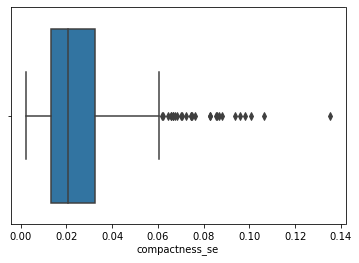

In [76]:
sns.boxplot(x = 'compactness_se', data = df)

In [77]:
Q1 = df['compactness_se'].quantile(0.25)
Q3 = df['compactness_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['compactness_se']=np.where(df['compactness_se']>upper_whisker,upper_whisker,np.where(df['compactness_se']<lower_whisker,
                                                                                        lower_whisker,df['compactness_se']))

<AxesSubplot:xlabel='compactness_se'>

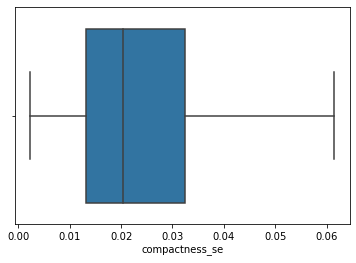

In [78]:
sns.boxplot(x = 'compactness_se', data = df)

In [79]:
findOutliers(df['concavity_se'])

[0.0889,
 0.09723,
 0.3038,
 0.1091,
 0.104,
 0.1435,
 0.09263,
 0.1278,
 0.396,
 0.1197,
 0.1166,
 0.08958,
 0.1438,
 0.0888,
 0.09518,
 0.0996,
 0.1027,
 0.09953,
 0.1535,
 0.09472,
 0.1114,
 0.09252]

<AxesSubplot:xlabel='concavity_se'>

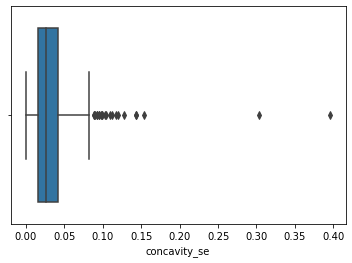

In [80]:
sns.boxplot(x = 'concavity_se', data = df)

In [81]:
Q1 = df['concavity_se'].quantile(0.25)
Q3 = df['concavity_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['concavity_se']=np.where(df['concavity_se']>upper_whisker,upper_whisker,np.where(df['concavity_se']<lower_whisker,
                                                                                    lower_whisker,df['concavity_se']))

<AxesSubplot:xlabel='concavity_se'>

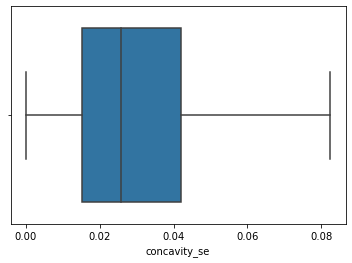

In [82]:
sns.boxplot(x = 'concavity_se', data = df)

In [83]:
findOutliers(df['concave points_se'])

[0.0409,
 0.02638,
 0.03322,
 0.02593,
 0.02801,
 0.05279,
 0.02794,
 0.02765,
 0.03927,
 0.03024,
 0.03487,
 0.02771,
 0.02536,
 0.02919,
 0.03441,
 0.02598,
 0.02721,
 0.02853,
 0.02624]

<AxesSubplot:xlabel='concave points_se'>

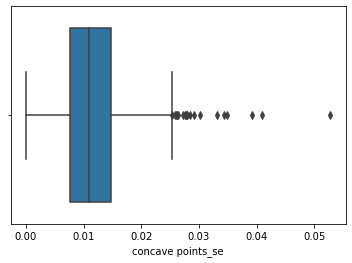

In [84]:
sns.boxplot(x = 'concave points_se', data = df)

In [85]:
Q1 = df['concave points_se'].quantile(0.25)
Q3 = df['concave points_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['concave points_se']=np.where(df['concave points_se']>upper_whisker,upper_whisker,np.where
                                 (df['concave points_se']<lower_whisker,lower_whisker,df['concave points_se']))

<AxesSubplot:xlabel='concave points_se'>

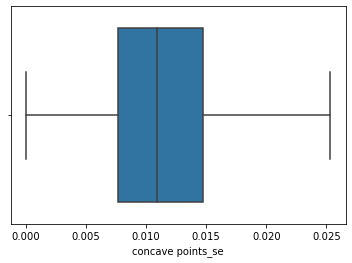

In [86]:
sns.boxplot(x = 'concave points_se', data = df)

In [87]:
findOutliers(df['symmetry_se'])

[0.05963,
 0.04484,
 0.03672,
 0.05333,
 0.04183,
 0.04192,
 0.04197,
 0.07895,
 0.05014,
 0.04547,
 0.05168,
 0.05628,
 0.0388,
 0.05113,
 0.03799,
 0.04783,
 0.04499,
 0.04077,
 0.06146,
 0.04022,
 0.04243,
 0.03756,
 0.03675,
 0.05543,
 0.0371,
 0.03997,
 0.03759]

<AxesSubplot:xlabel='symmetry_se'>

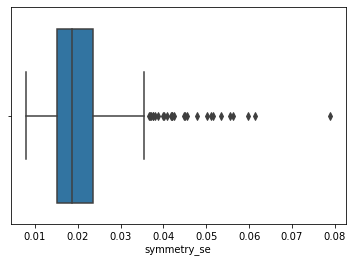

In [88]:
sns.boxplot(x = 'symmetry_se', data = df)

In [89]:
Q1 = df['symmetry_se'].quantile(0.25)
Q3 = df['symmetry_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['symmetry_se']=np.where(df['symmetry_se']>upper_whisker,upper_whisker,np.where(df['symmetry_se']<lower_whisker,
                                                                                  lower_whisker,df['symmetry_se']))

<AxesSubplot:xlabel='symmetry_se'>

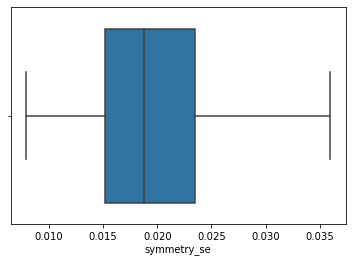

In [90]:
sns.boxplot(x = 'symmetry_se', data = df)

In [91]:
findOutliers(df['fractal_dimension_se'])

[0.009208,
 0.01008,
 0.01284,
 0.008093,
 0.009559,
 0.02193,
 0.01039,
 0.01298,
 0.009875,
 0.009423,
 0.009368,
 0.01178,
 0.02984,
 0.01792,
 0.01172,
 0.01256,
 0.008675,
 0.00866,
 0.02286,
 0.0122,
 0.01233,
 0.008925,
 0.008133,
 0.0113,
 0.009627,
 0.01045,
 0.01148,
 0.008313]

<AxesSubplot:xlabel='fractal_dimension_se'>

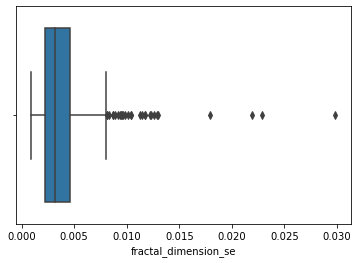

In [92]:
sns.boxplot(x = 'fractal_dimension_se', data = df)

In [93]:
Q1 = df['fractal_dimension_se'].quantile(0.25)
Q3 = df['fractal_dimension_se'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['fractal_dimension_se']=np.where(df['fractal_dimension_se']>upper_whisker,upper_whisker,np.where
                                    (df['fractal_dimension_se']<lower_whisker,lower_whisker,df['fractal_dimension_se']))

<AxesSubplot:xlabel='fractal_dimension_se'>

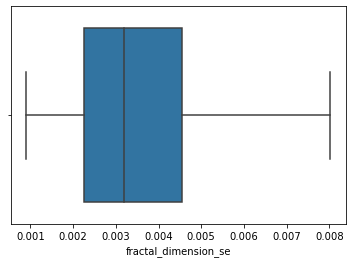

In [94]:
sns.boxplot(x = 'fractal_dimension_se', data = df)

In [95]:
findOutliers(df['radius_worst'])

[29.17,
 30.0,
 28.4,
 28.01,
 33.12,
 28.11,
 27.9,
 31.01,
 32.49,
 28.19,
 30.67,
 33.13,
 30.75,
 27.66,
 36.04,
 30.79,
 29.92]

<AxesSubplot:xlabel='radius_worst'>

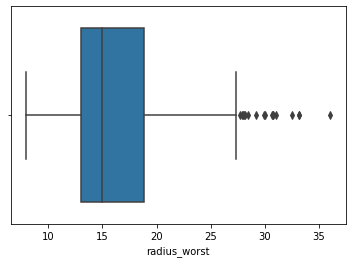

In [96]:
sns.boxplot(x = 'radius_worst', data = df)

In [97]:
Q1 = df['radius_worst'].quantile(0.25)
Q3 = df['radius_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['radius_worst']=np.where(df['radius_worst']>upper_whisker,upper_whisker,np.where(df['radius_worst']<lower_whisker,
                                                                                    lower_whisker,df['radius_worst']))

<AxesSubplot:xlabel='radius_worst'>

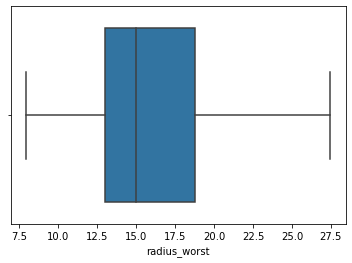

In [98]:
sns.boxplot(x = 'radius_worst', data = df)

In [99]:
findOutliers(df['texture_worst'])

[45.41, 44.87, 49.54, 47.16, 42.79]

<AxesSubplot:xlabel='texture_worst'>

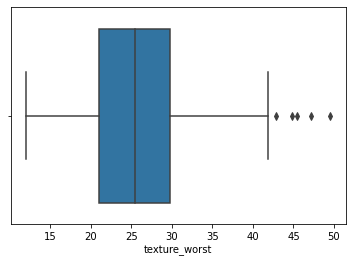

In [100]:
sns.boxplot(x = 'texture_worst', data = df)

In [101]:
Q1 = df['texture_worst'].quantile(0.25)
Q3 = df['texture_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['texture_worst']=np.where(df['texture_worst']>upper_whisker,upper_whisker,np.where(df['texture_worst']<lower_whisker,
                                                                                      lower_whisker,df['texture_worst']))

<AxesSubplot:xlabel='texture_worst'>

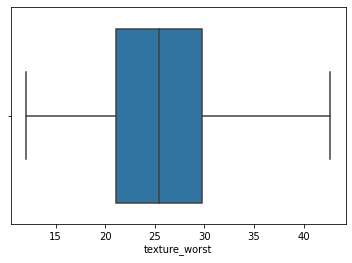

In [102]:
sns.boxplot(x = 'texture_worst', data = df)

In [103]:
findOutliers(df['perimeter_worst'])

[188.0,
 211.7,
 206.8,
 220.8,
 188.5,
 206.0,
 214.0,
 195.9,
 202.4,
 229.3,
 199.5,
 195.0,
 251.2,
 211.5,
 205.7]

<AxesSubplot:xlabel='perimeter_worst'>

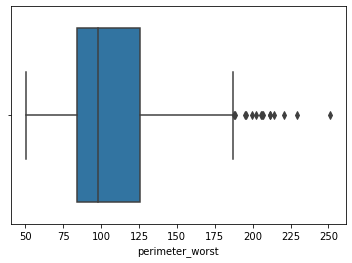

In [104]:
sns.boxplot(x = 'perimeter_worst', data = df)

In [105]:
Q1 = df['perimeter_worst'].quantile(0.25)
Q3 = df['perimeter_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['perimeter_worst']=np.where(df['perimeter_worst']>upper_whisker,upper_whisker,np.where
                               (df['perimeter_worst']<lower_whisker,lower_whisker,df['perimeter_worst']))

<AxesSubplot:xlabel='perimeter_worst'>

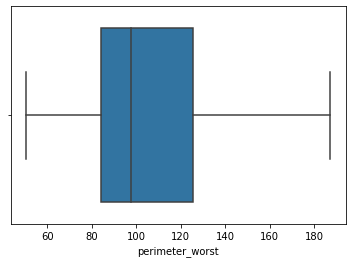

In [106]:
sns.boxplot(x = 'perimeter_worst', data = df)

In [107]:
findOutliers(df['area_worst'])

[2019.0,
 1956.0,
 2398.0,
 2615.0,
 2215.0,
 2145.0,
 2562.0,
 2360.0,
 2073.0,
 2232.0,
 2403.0,
 3216.0,
 2089.0,
 1986.0,
 2499.0,
 2009.0,
 2477.0,
 2944.0,
 2010.0,
 1972.0,
 3432.0,
 2384.0,
 2053.0,
 1938.0,
 2906.0,
 3234.0,
 3143.0,
 2227.0,
 1946.0,
 2081.0,
 2022.0,
 4254.0,
 2782.0,
 2642.0,
 2027.0]

<AxesSubplot:xlabel='area_worst'>

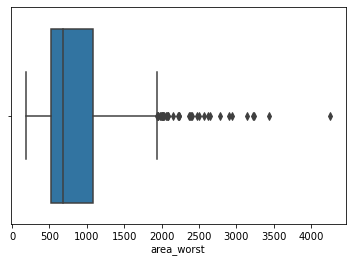

In [108]:
sns.boxplot(x = 'area_worst', data = df)

In [109]:
Q1 = df['area_worst'].quantile(0.25)
Q3 = df['area_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['area_worst']=np.where(df['area_worst']>upper_whisker,upper_whisker,np.where(df['area_worst']<lower_whisker,
                                                                                lower_whisker,df['area_worst']))

<AxesSubplot:xlabel='area_worst'>

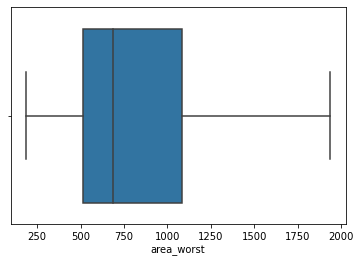

In [110]:
sns.boxplot(x = 'area_worst', data = df)

In [111]:
findOutliers(df['smoothness_worst'])

[0.2098, 0.1909, 0.07117, 0.2226, 0.2184, 0.1902, 0.2006]

<AxesSubplot:xlabel='smoothness_worst'>

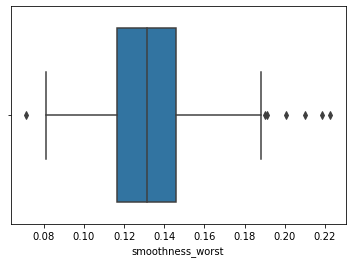

In [112]:
sns.boxplot(x = 'smoothness_worst', data = df)

In [113]:
Q1 = df['smoothness_worst'].quantile(0.25)
Q3 = df['smoothness_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['smoothness_worst']=np.where(df['smoothness_worst']>upper_whisker,upper_whisker,np.where
                                (df['smoothness_worst']<lower_whisker,lower_whisker,df['smoothness_worst']))

<AxesSubplot:xlabel='smoothness_worst'>

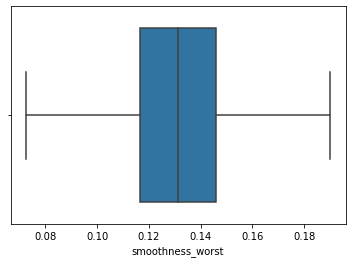

In [114]:
sns.boxplot(x = 'smoothness_worst', data = df)

In [115]:
findOutliers(df['compactness_worst'])

[0.6656,
 0.8663,
 1.058,
 0.7725,
 0.6577,
 0.6643,
 0.659,
 0.7444,
 0.7394,
 0.6997,
 0.7584,
 0.9327,
 0.9379,
 0.709,
 0.7917,
 0.8681]

<AxesSubplot:xlabel='compactness_worst'>

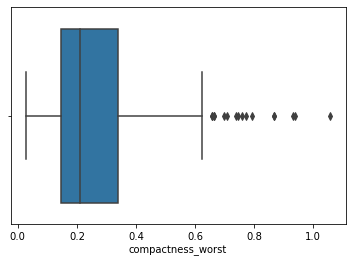

In [116]:
sns.boxplot(x = 'compactness_worst', data = df)

In [117]:
Q1 = df['compactness_worst'].quantile(0.25)
Q3 = df['compactness_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['compactness_worst']=np.where(df['compactness_worst']>upper_whisker,upper_whisker,np.where
                                 (df['compactness_worst']<lower_whisker,lower_whisker,df['compactness_worst']))

<AxesSubplot:xlabel='compactness_worst'>

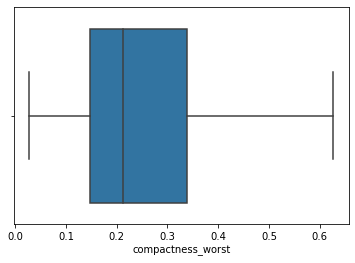

In [118]:
sns.boxplot(x = 'compactness_worst', data = df)

In [119]:
findOutliers(df['concavity_worst'])

[1.105,
 1.252,
 0.9608,
 0.8216,
 0.8488,
 0.7892,
 0.8489,
 0.8402,
 0.9034,
 0.9019,
 1.17,
 0.9387]

<AxesSubplot:xlabel='concavity_worst'>

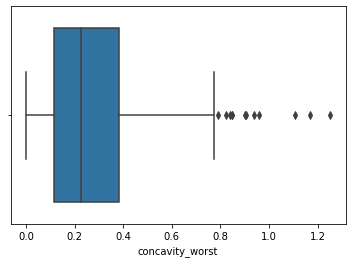

In [120]:
sns.boxplot(x = 'concavity_worst', data = df)

In [121]:
Q1 = df['concavity_worst'].quantile(0.25)
Q3 = df['concavity_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['concavity_worst']=np.where(df['concavity_worst']>upper_whisker,upper_whisker,np.where
                               (df['concavity_worst']<lower_whisker,lower_whisker,df['concavity_worst']))

<AxesSubplot:xlabel='concavity_worst'>

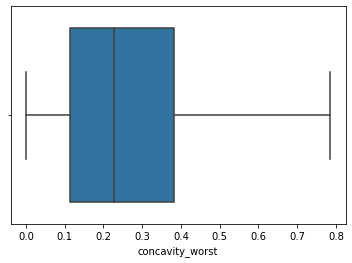

In [122]:
sns.boxplot(x = 'concavity_worst', data = df)

In [123]:
findOutliers(df['concave points_worst'])

[]

<AxesSubplot:xlabel='concave points_worst'>

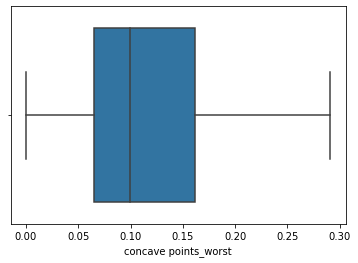

In [124]:
sns.boxplot(x = 'concave points_worst', data = df)

In [125]:
findOutliers(df['symmetry_worst'])

[0.4601,
 0.6638,
 0.4378,
 0.4366,
 0.4218,
 0.4667,
 0.4264,
 0.4761,
 0.427,
 0.4863,
 0.467,
 0.4228,
 0.544,
 0.4882,
 0.5774,
 0.5166,
 0.4753,
 0.4432,
 0.4724,
 0.5558,
 0.4245,
 0.4824,
 0.4677]

<AxesSubplot:xlabel='symmetry_worst'>

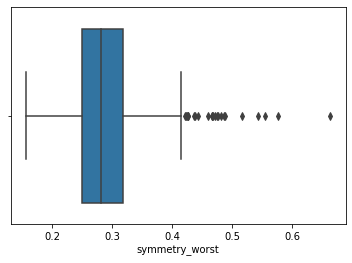

In [126]:
sns.boxplot(x = 'symmetry_worst', data = df)

In [127]:
Q1 = df['symmetry_worst'].quantile(0.25)
Q3 = df['symmetry_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['symmetry_worst']=np.where(df['symmetry_worst']>upper_whisker,upper_whisker,np.where
                              (df['symmetry_worst']<lower_whisker,lower_whisker,df['symmetry_worst']))

<AxesSubplot:xlabel='symmetry_worst'>

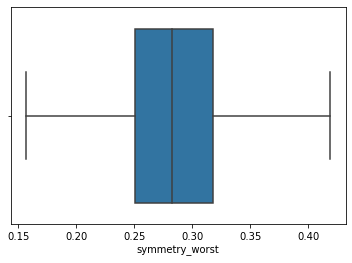

In [128]:
sns.boxplot(x = 'symmetry_worst', data = df)

In [129]:
findOutliers(df['fractal_dimension_worst'])

[0.173,
 0.1244,
 0.2075,
 0.1431,
 0.1341,
 0.1275,
 0.1402,
 0.1233,
 0.1339,
 0.1405,
 0.1252,
 0.1486,
 0.1259,
 0.1284,
 0.1446,
 0.1243,
 0.1297,
 0.1297,
 0.1403,
 0.1249,
 0.1252,
 0.1364,
 0.1409,
 0.124]

<AxesSubplot:xlabel='fractal_dimension_worst'>

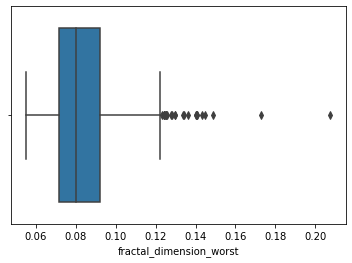

In [130]:
sns.boxplot(x = 'fractal_dimension_worst', data = df)

In [131]:
Q1 = df['fractal_dimension_worst'].quantile(0.25)
Q3 = df['fractal_dimension_worst'].quantile(0.75)
IQR = Q3 - Q1
whisker_width = 1.5
lower_whisker = Q1 -(whisker_width*IQR)
upper_whisker = Q3 + (whisker_width*IQR)
df['fractal_dimension_worst']=np.where(df['fractal_dimension_worst']>upper_whisker,upper_whisker,
                                       np.where(df['fractal_dimension_worst']<lower_whisker,lower_whisker,
                                                df['fractal_dimension_worst']))

<AxesSubplot:xlabel='fractal_dimension_worst'>

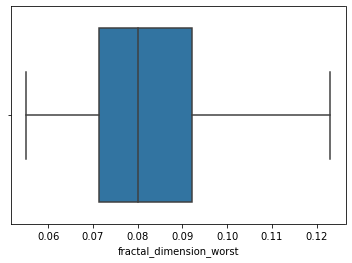

In [132]:
sns.boxplot(x = 'fractal_dimension_worst', data = df)

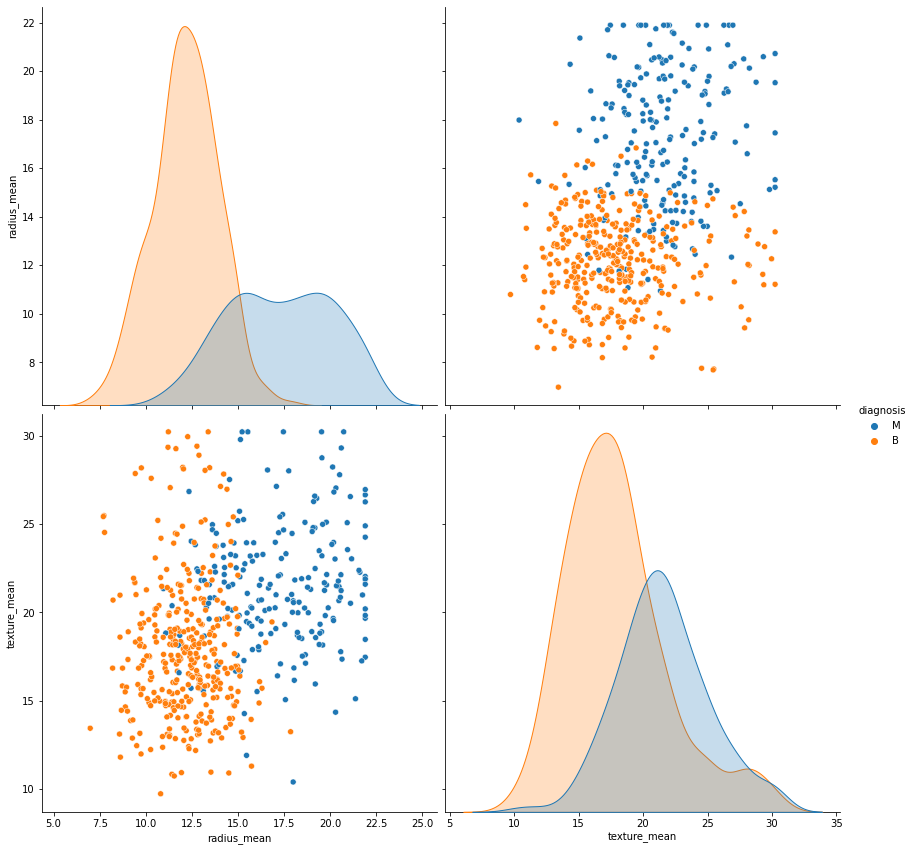

In [133]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'texture_mean'], height=6, aspect=1 )

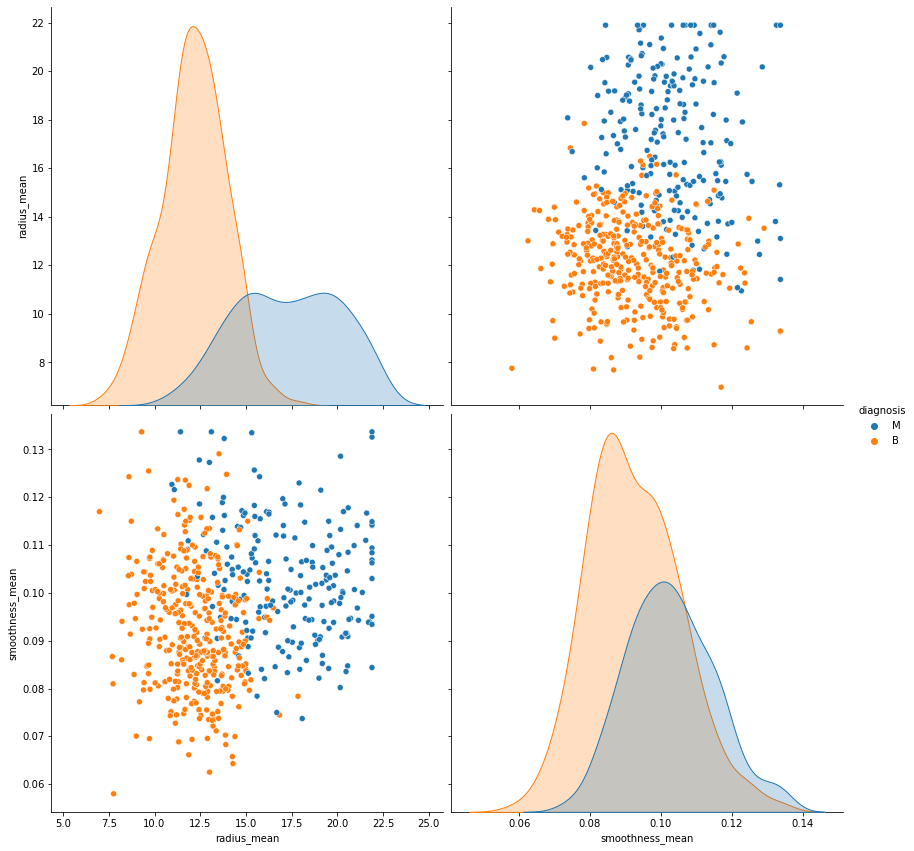

In [134]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'smoothness_mean'], height=6, aspect=1 )

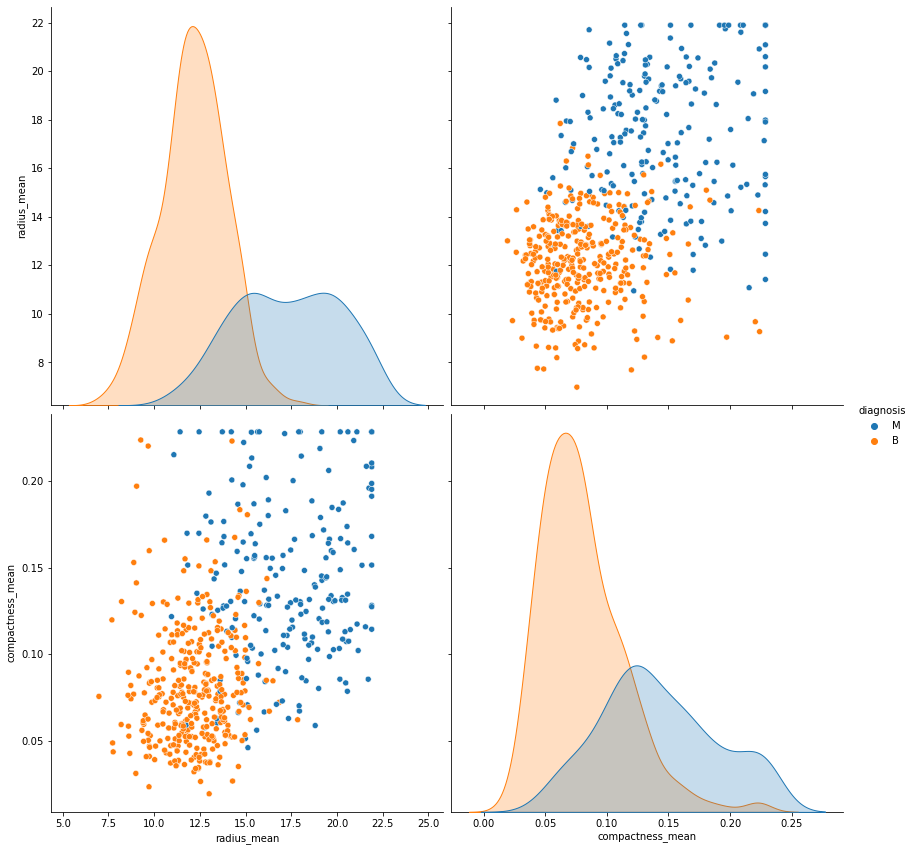

In [195]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'compactness_mean'], height=6, aspect=1 )

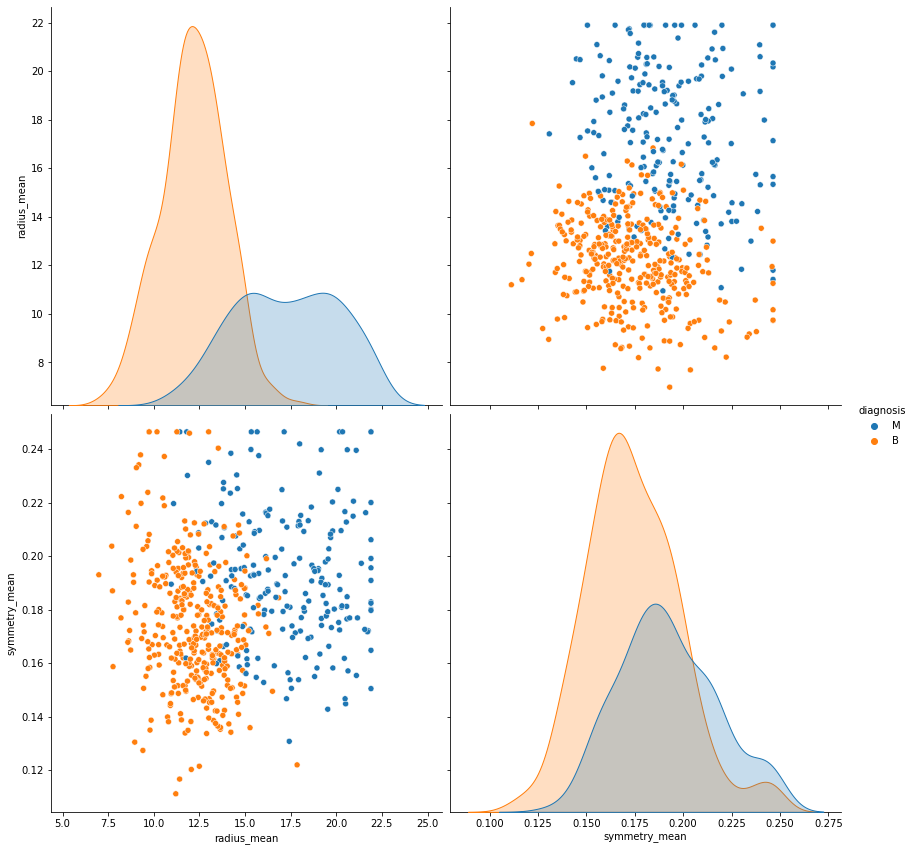

In [196]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'symmetry_mean'], height=6, aspect=1 )

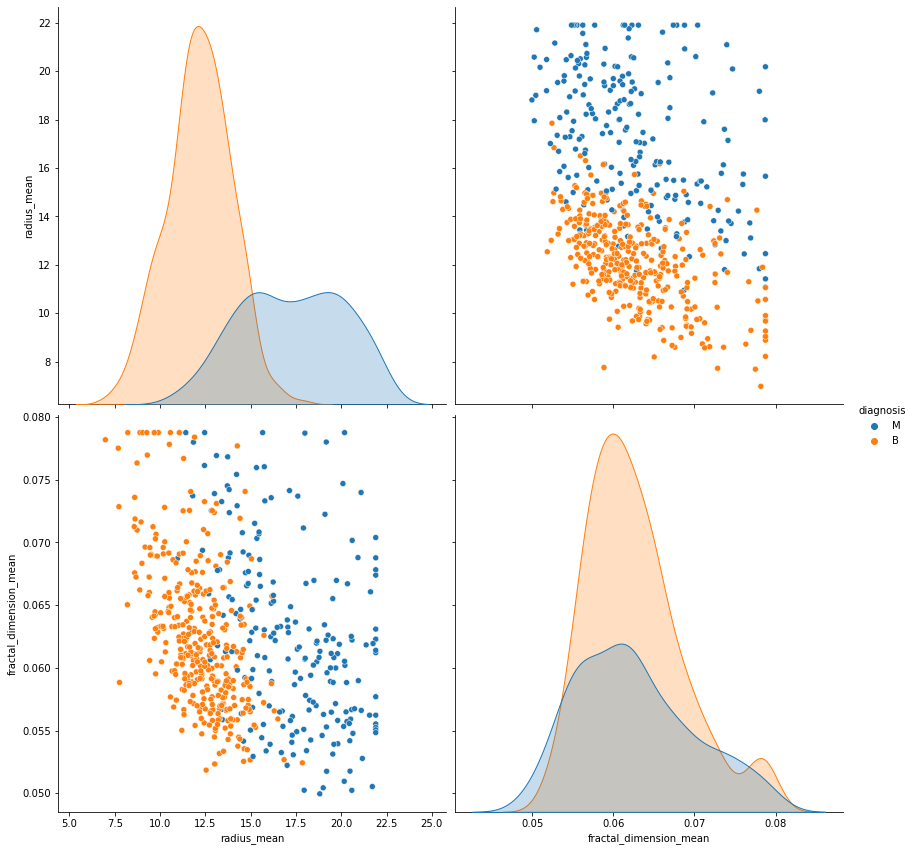

In [197]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'fractal_dimension_mean'], height=6, aspect=1 )

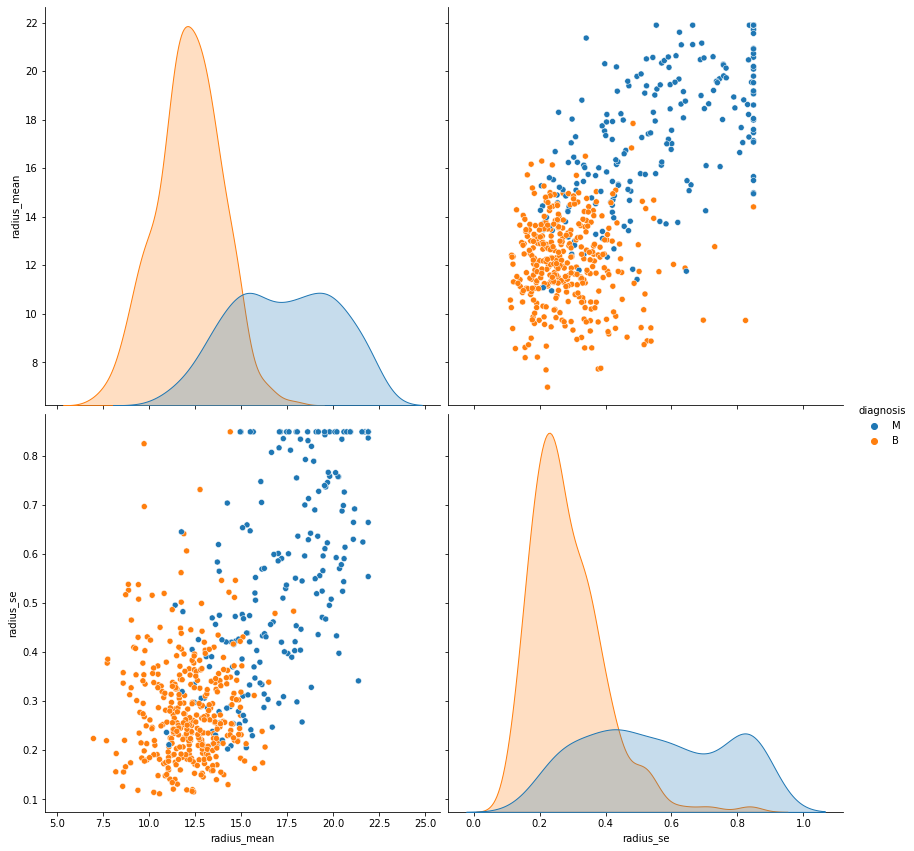

In [198]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'radius_se'], height=6, aspect=1 )

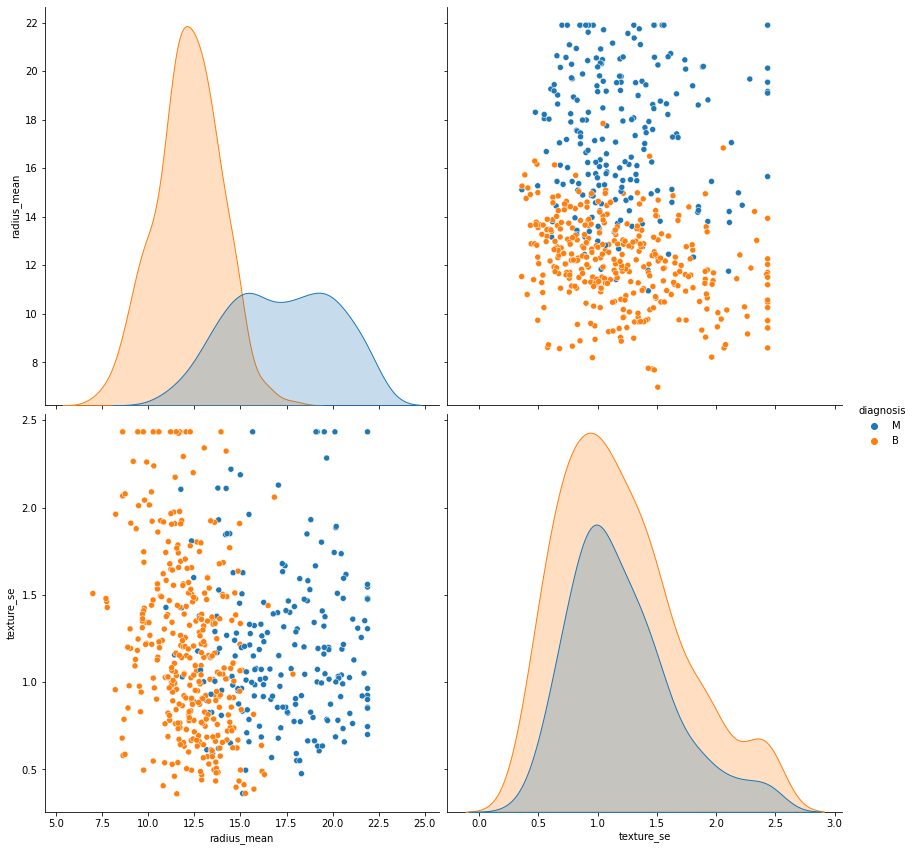

In [199]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'texture_se'], height=6, aspect=1 )

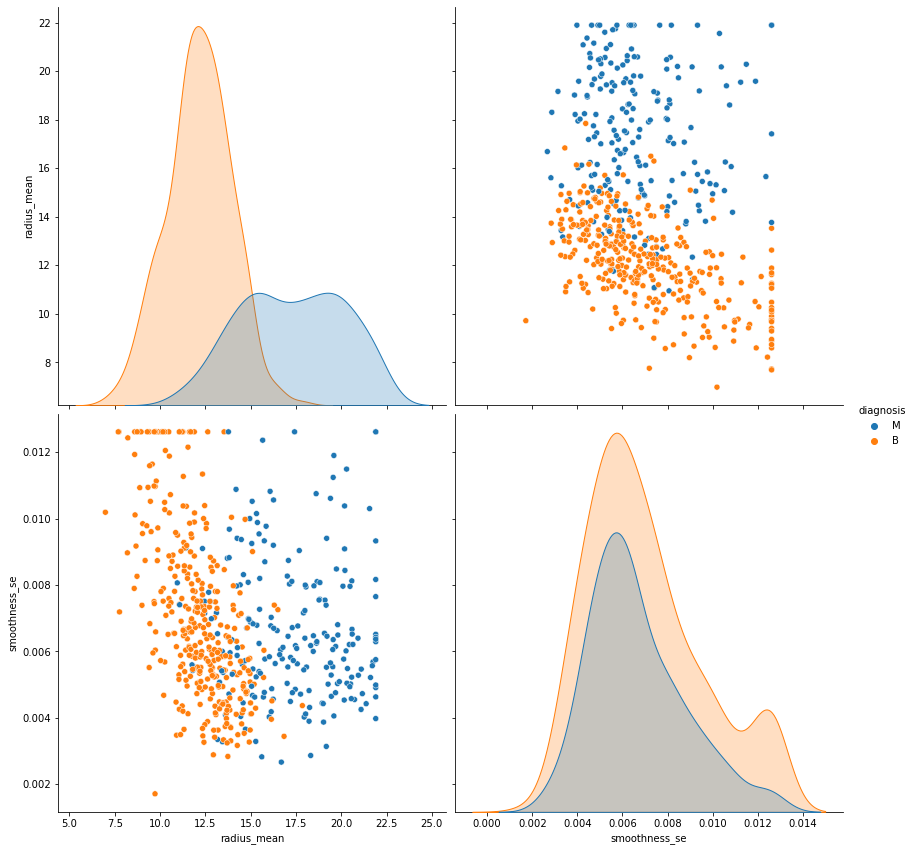

In [200]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'smoothness_se'], height=6, aspect=1 )

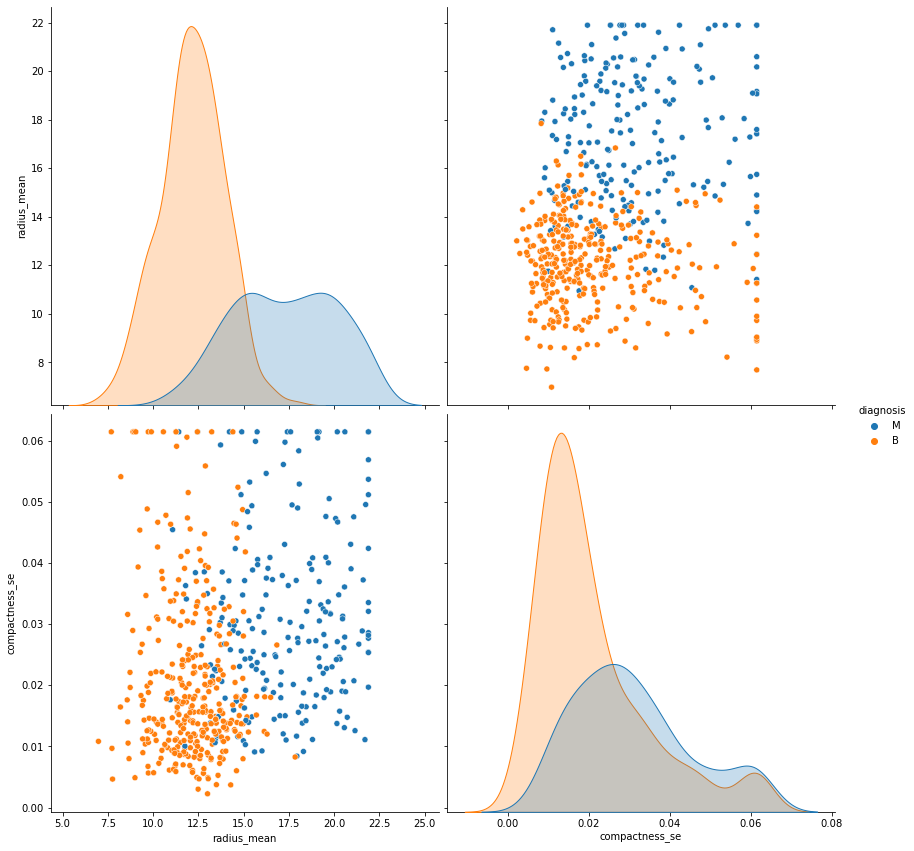

In [201]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'compactness_se'], height=6, aspect=1 )

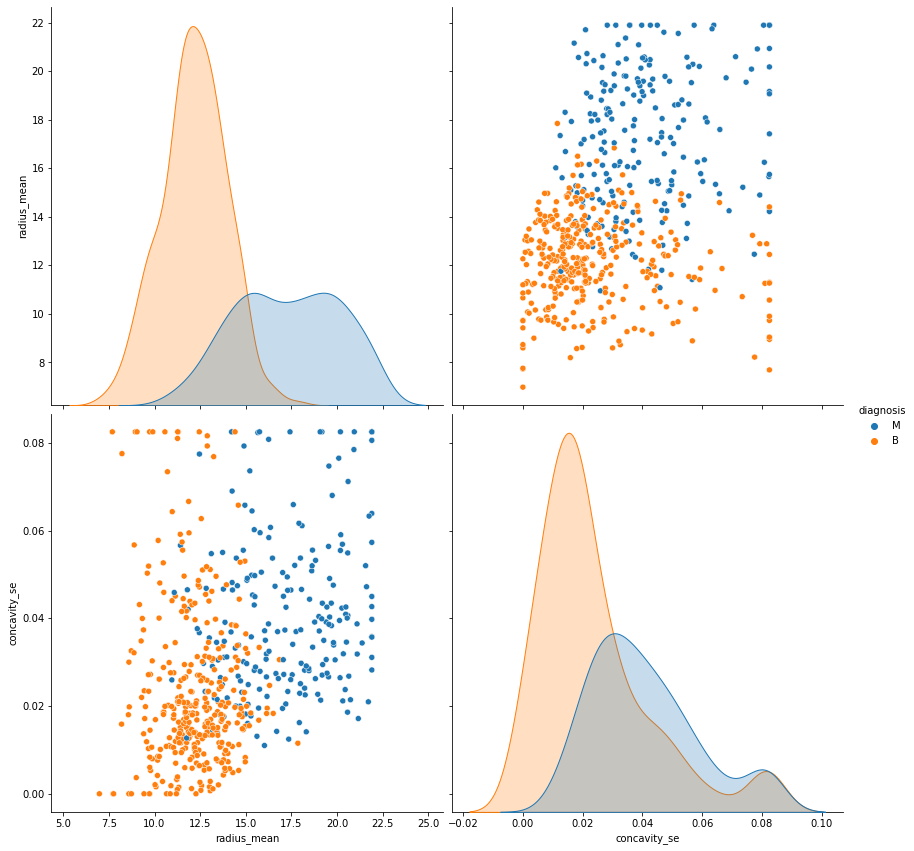

In [202]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'concavity_se'], height=6, aspect=1 )

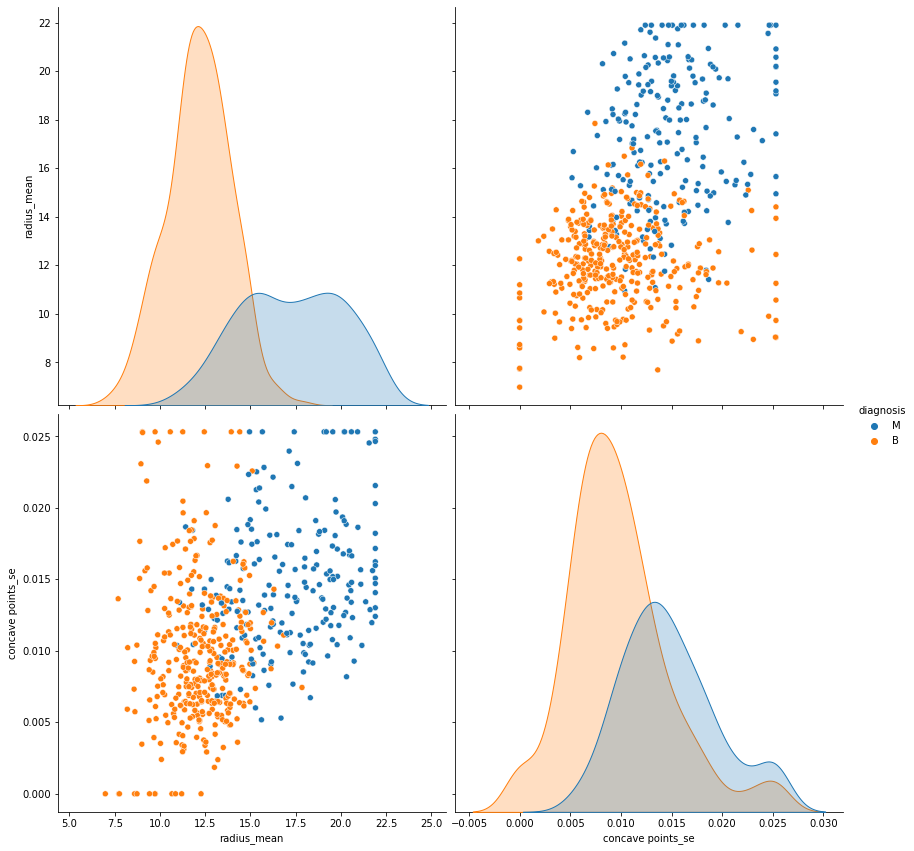

In [203]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'concave points_se'], height=6, aspect=1 )

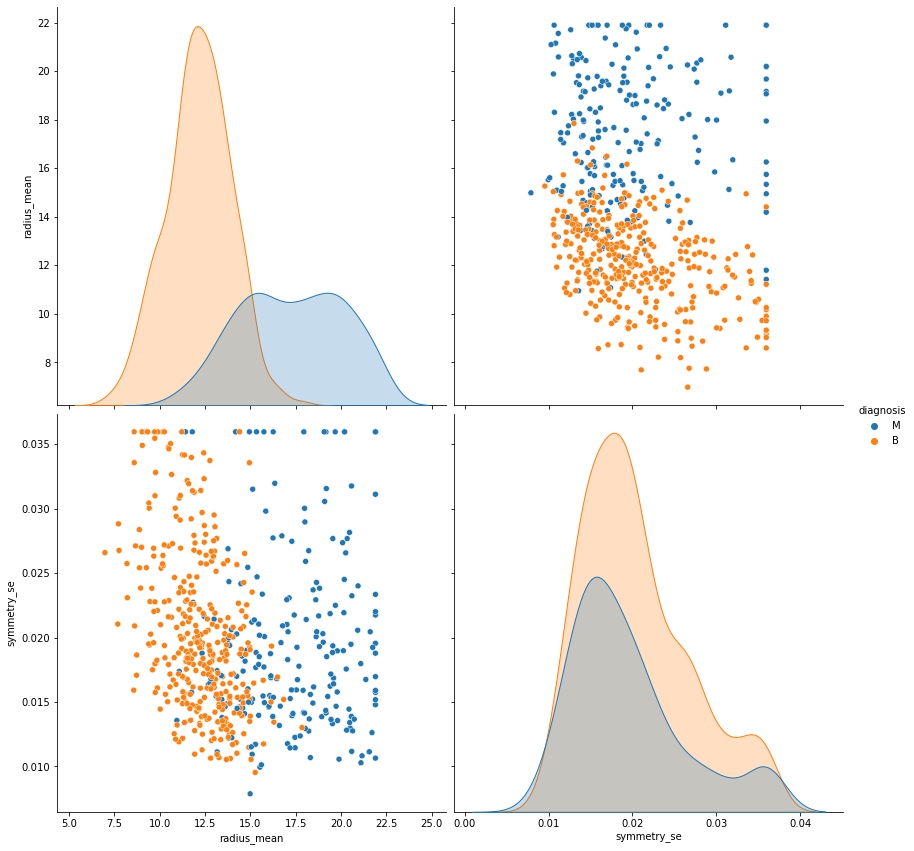

In [204]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'symmetry_se'], height=6, aspect=1 )

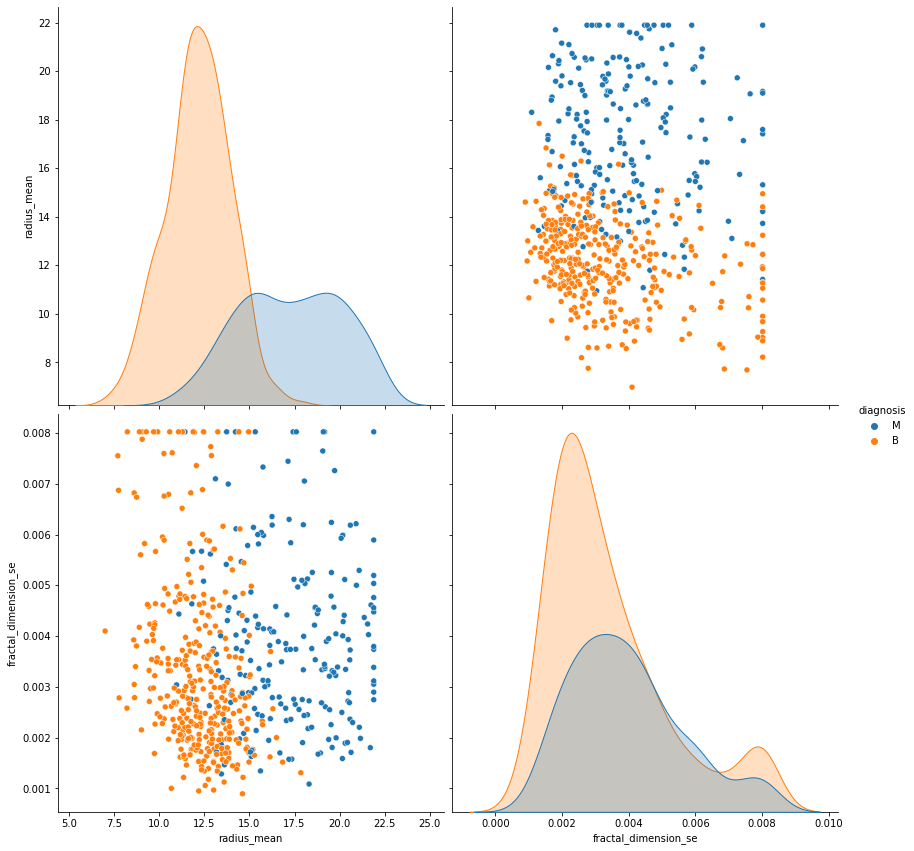

In [205]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'fractal_dimension_se'], height=6, aspect=1 )

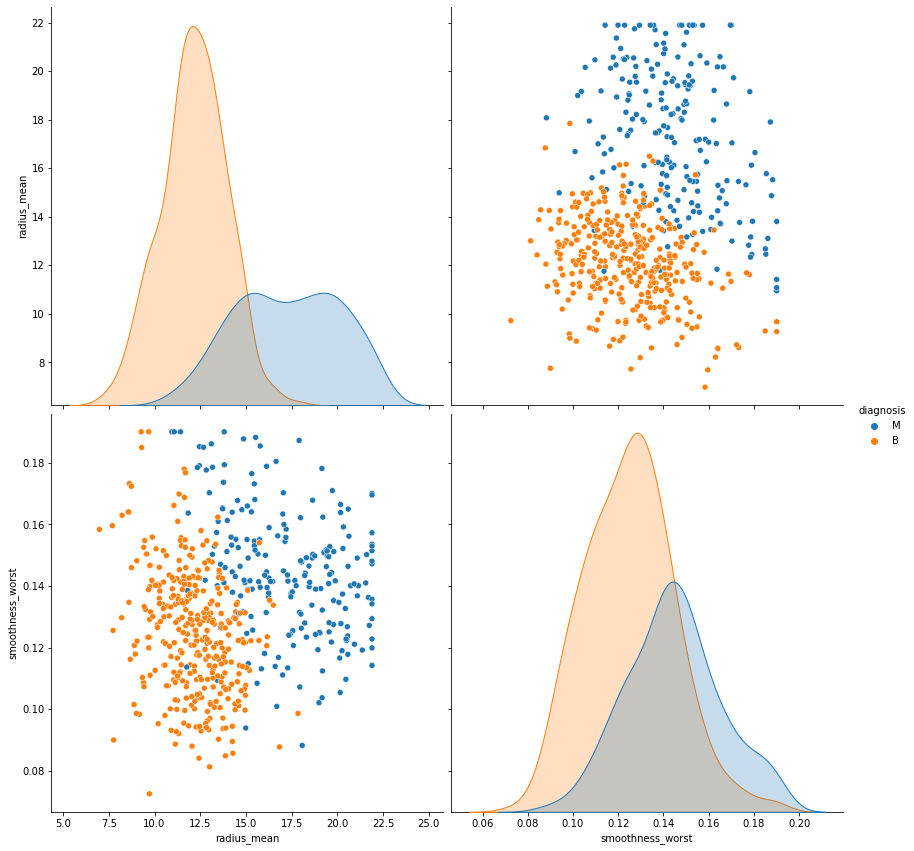

In [206]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'smoothness_worst'], height=6, aspect=1 )

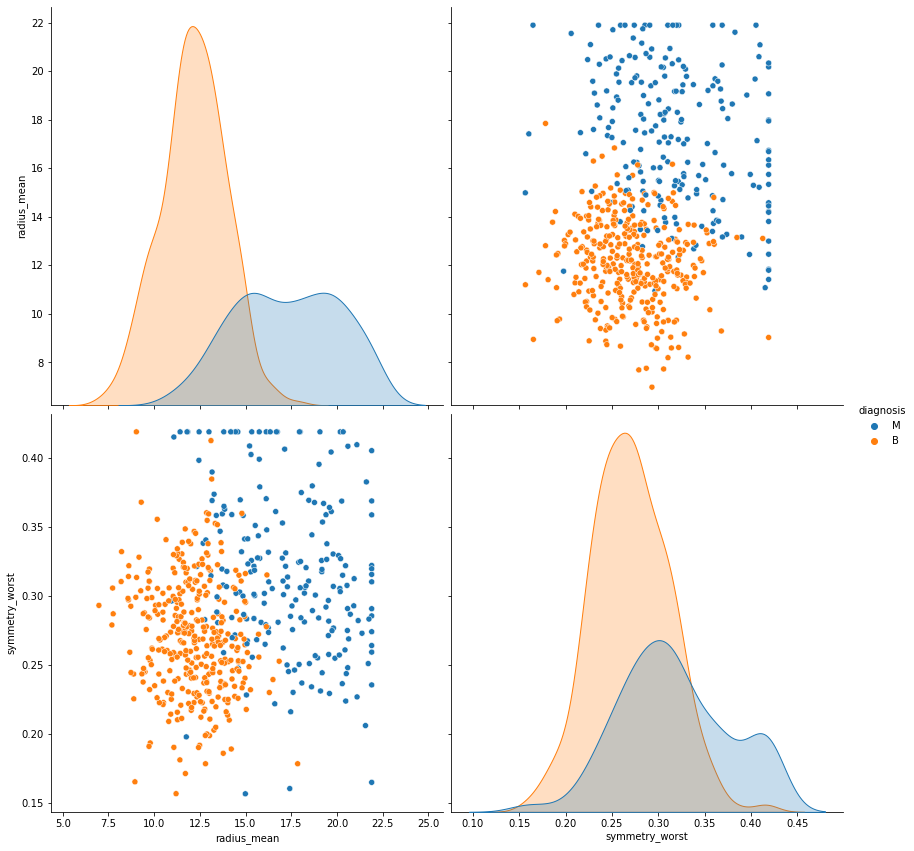

In [207]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'symmetry_worst'], height=6, aspect=1 )

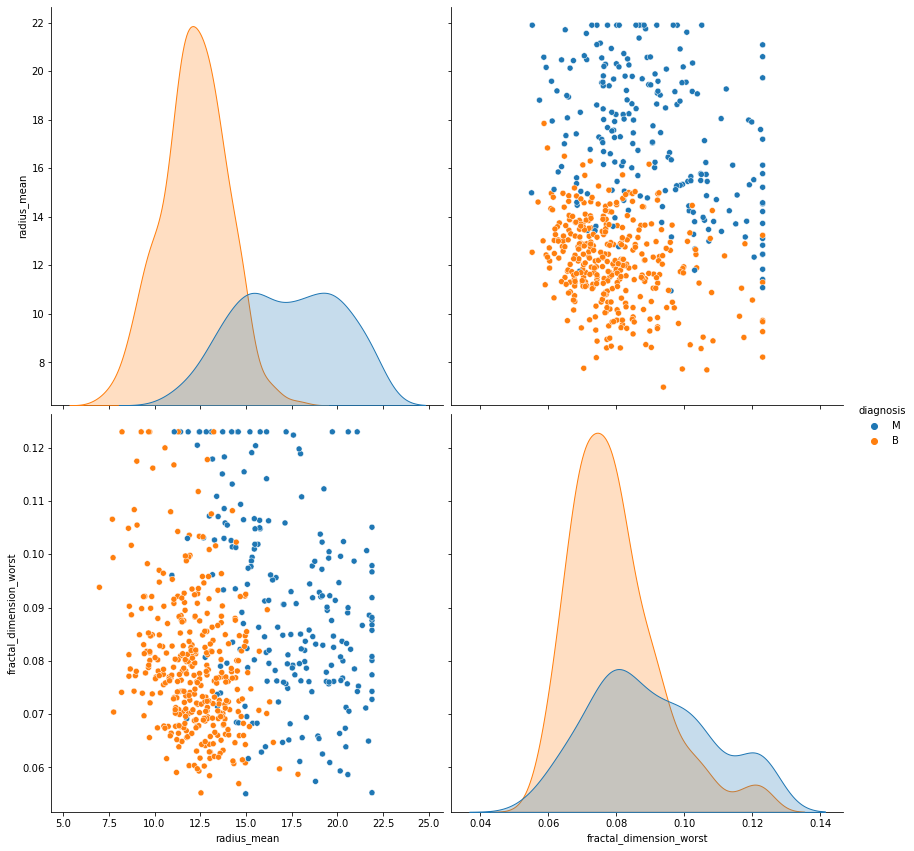

In [208]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_mean', 'fractal_dimension_worst'], height=6, aspect=1 )

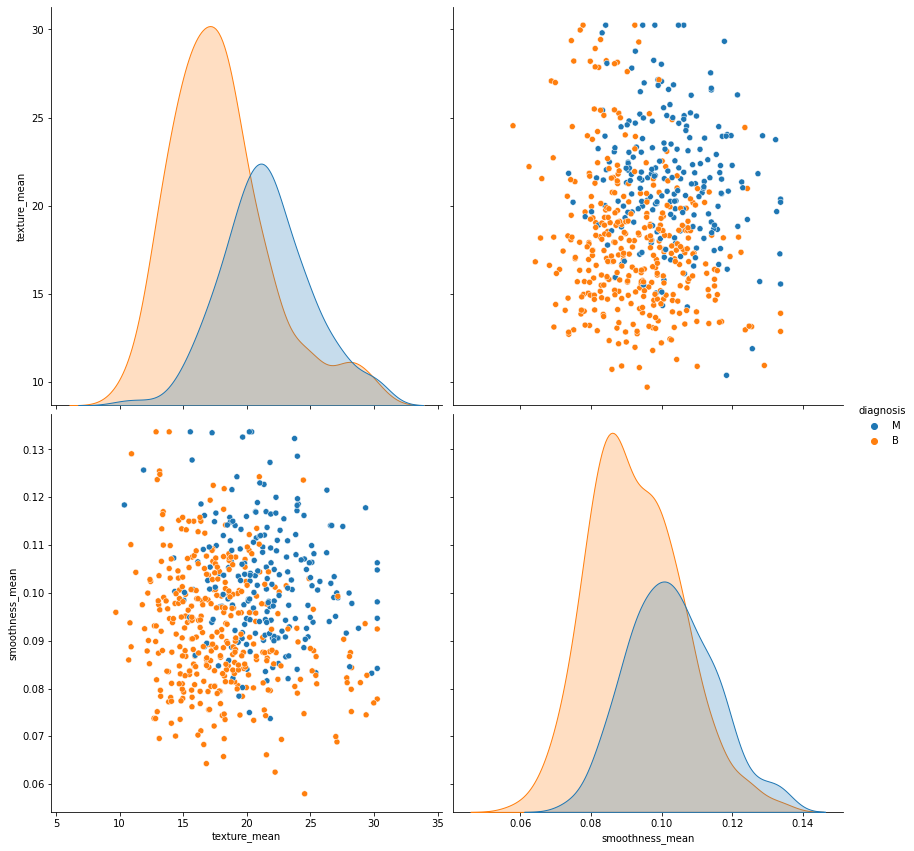

In [209]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'smoothness_mean'], height=6, aspect=1 )

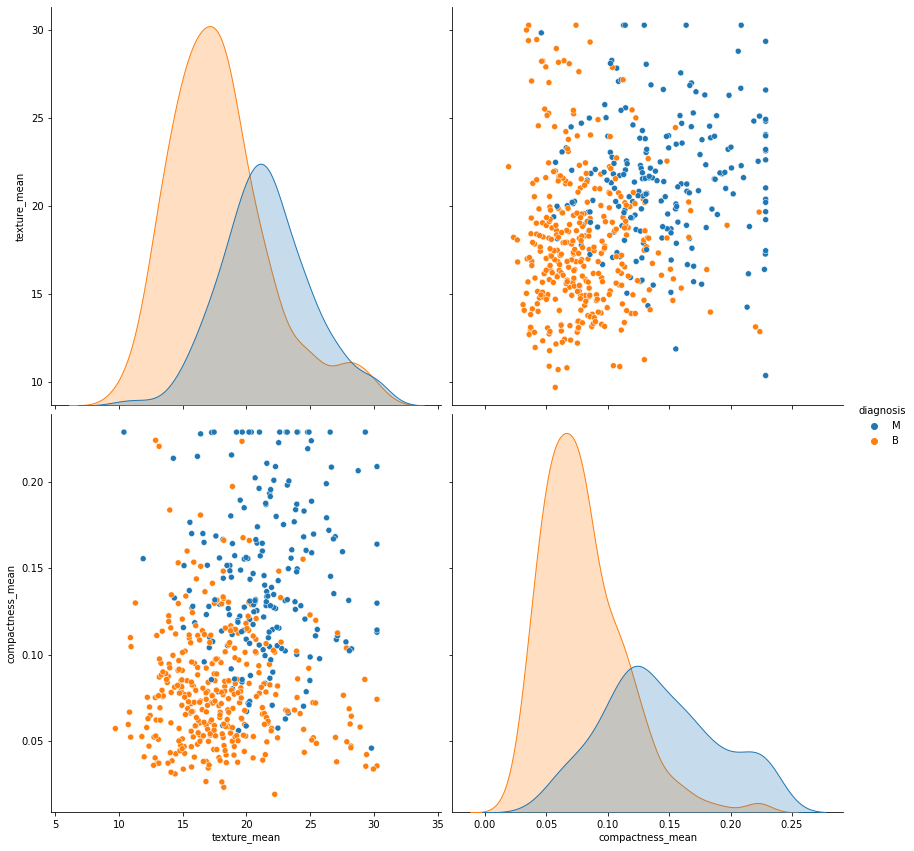

In [210]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'compactness_mean'], height=6, aspect=1 )

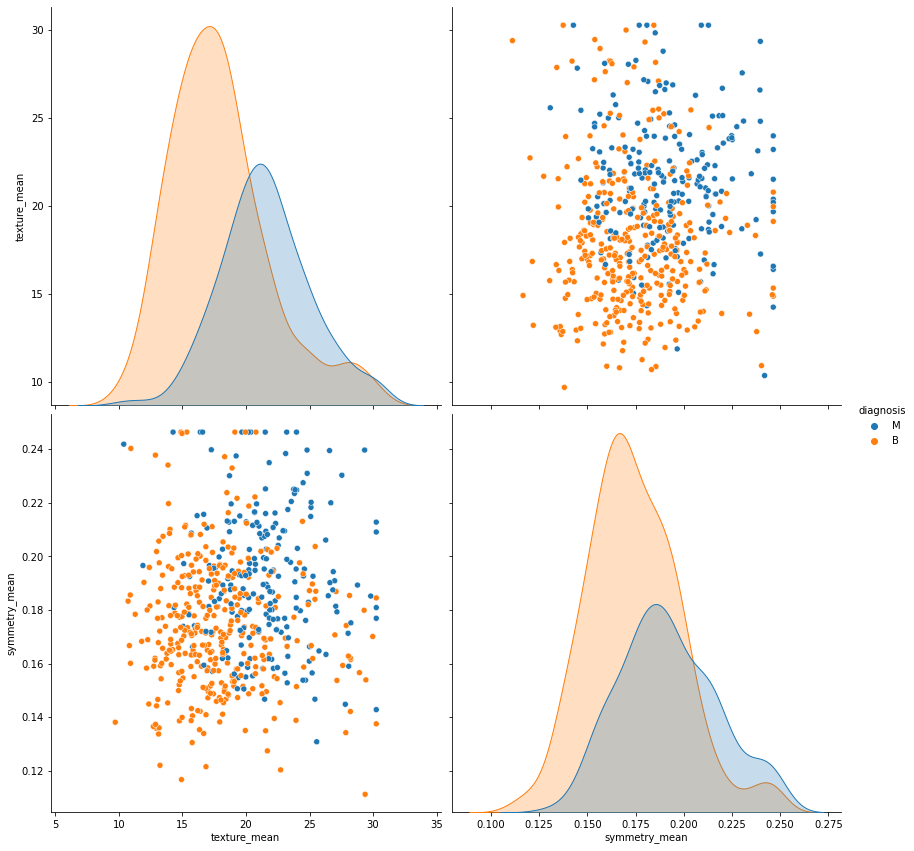

In [211]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'symmetry_mean'], height=6, aspect=1 )

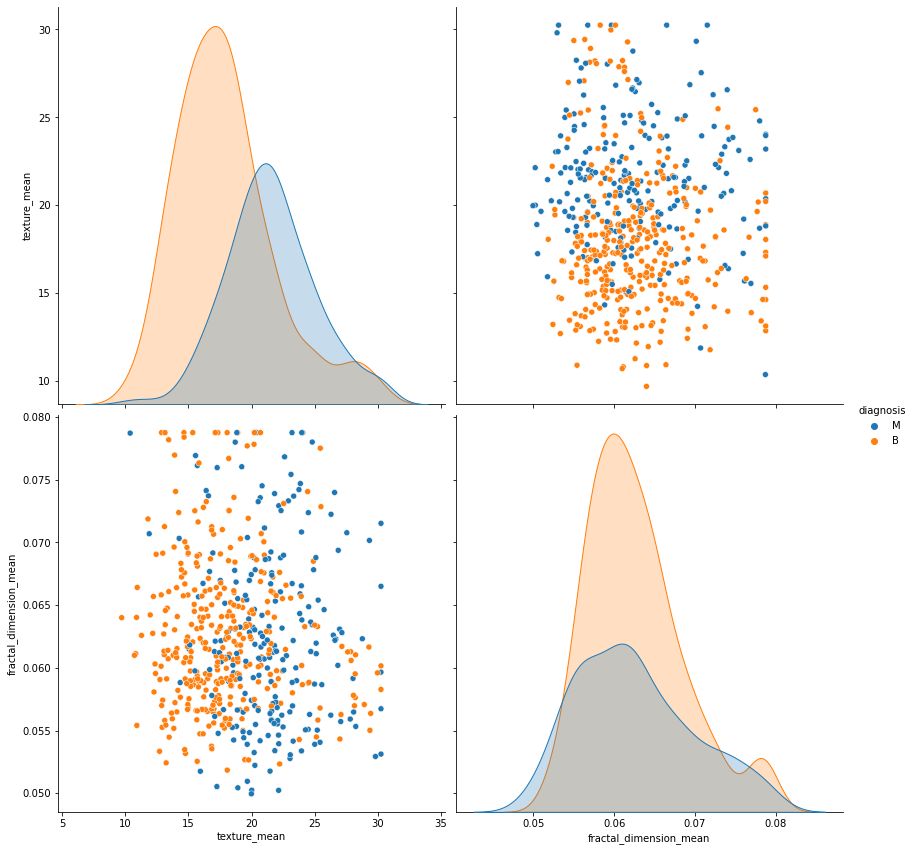

In [212]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'fractal_dimension_mean'], height=6, aspect=1 )

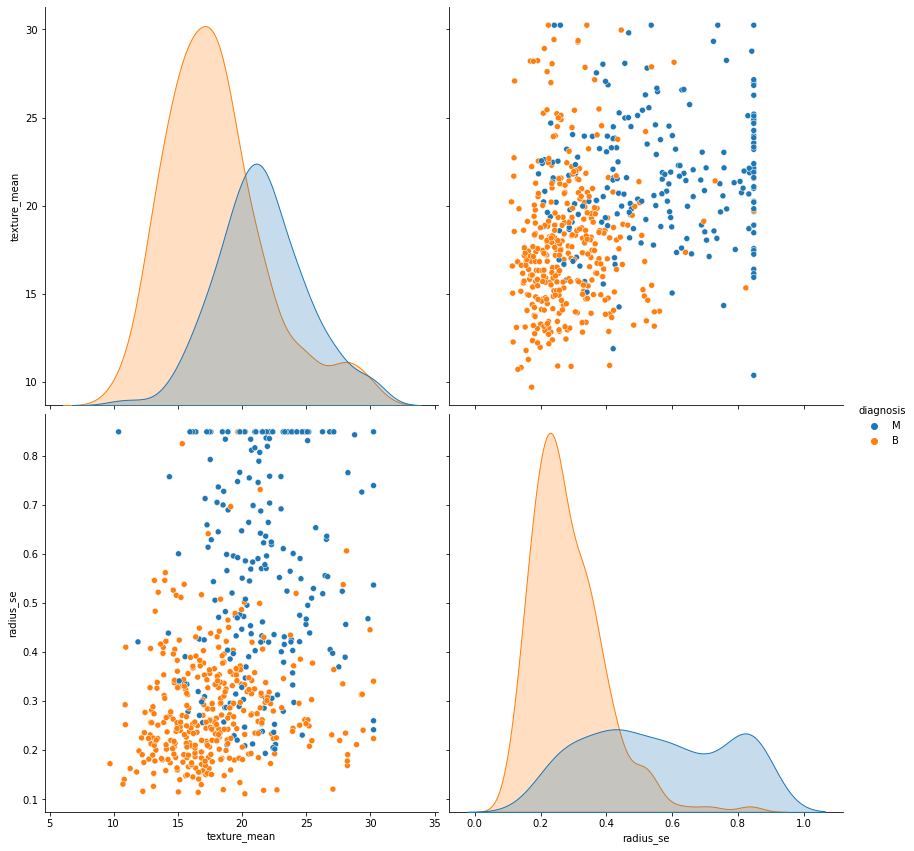

In [213]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'radius_se'], height=6, aspect=1 )

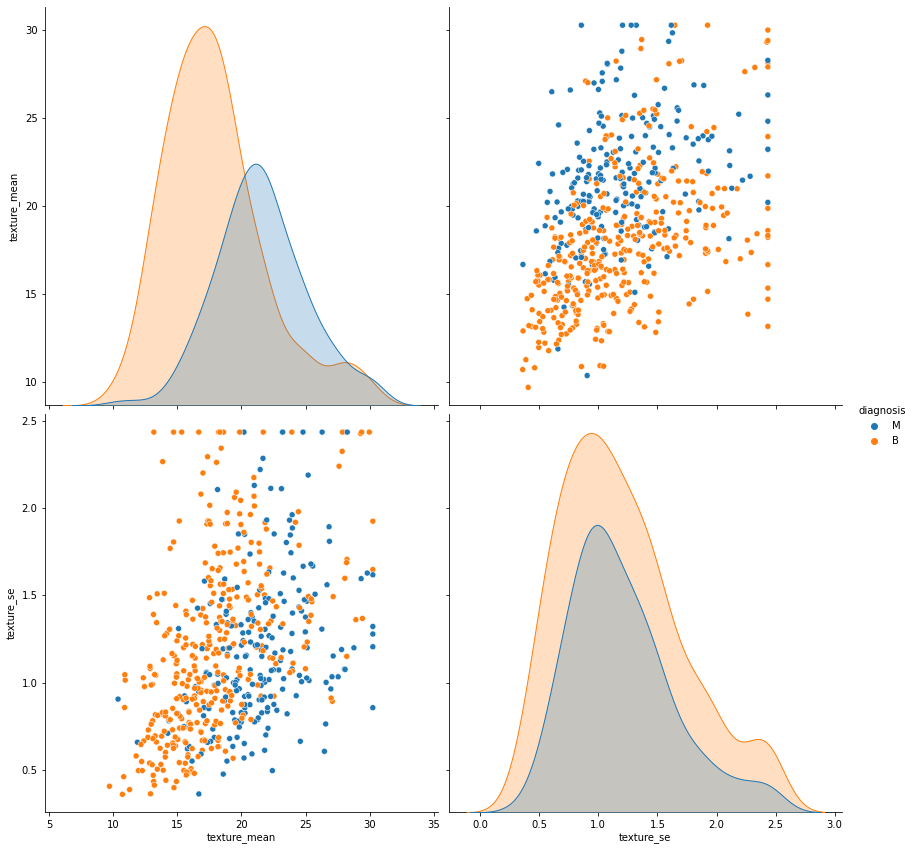

In [214]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'texture_se'], height=6, aspect=1 )

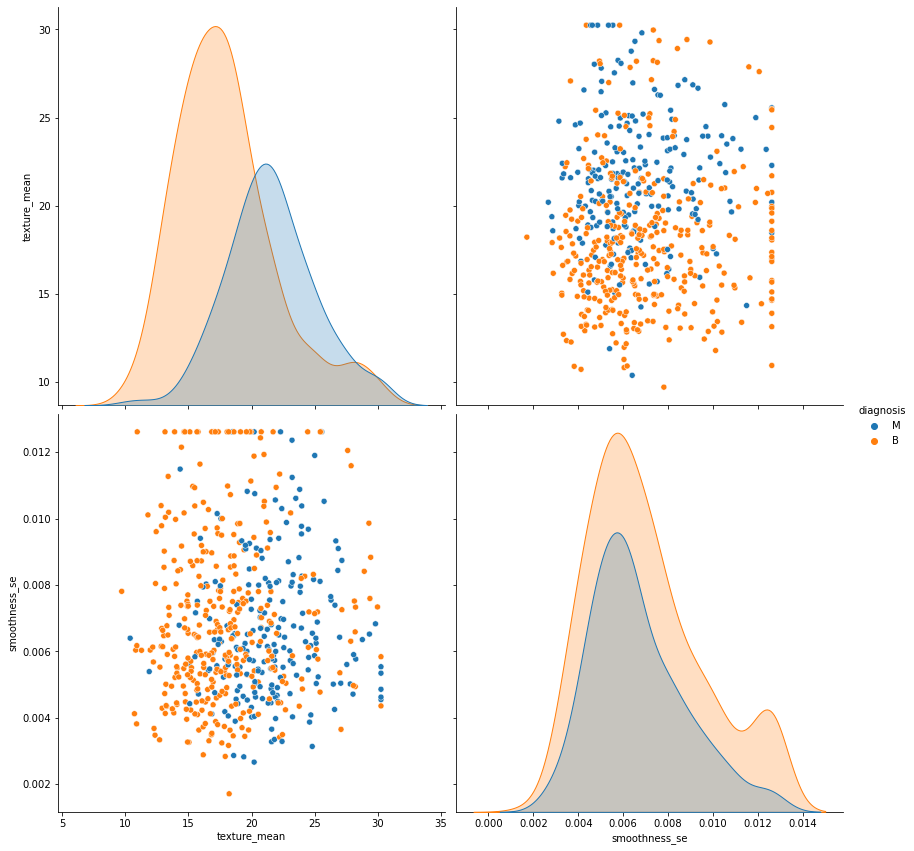

In [215]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'smoothness_se'], height=6, aspect=1 )

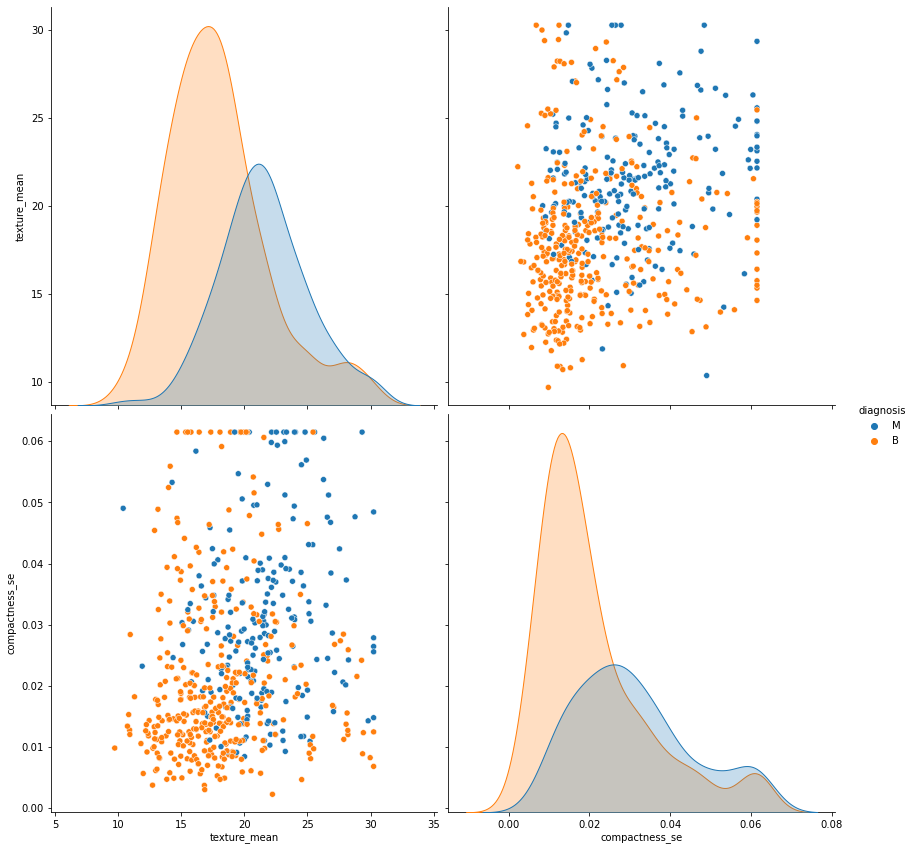

In [216]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'compactness_se'], height=6, aspect=1 )

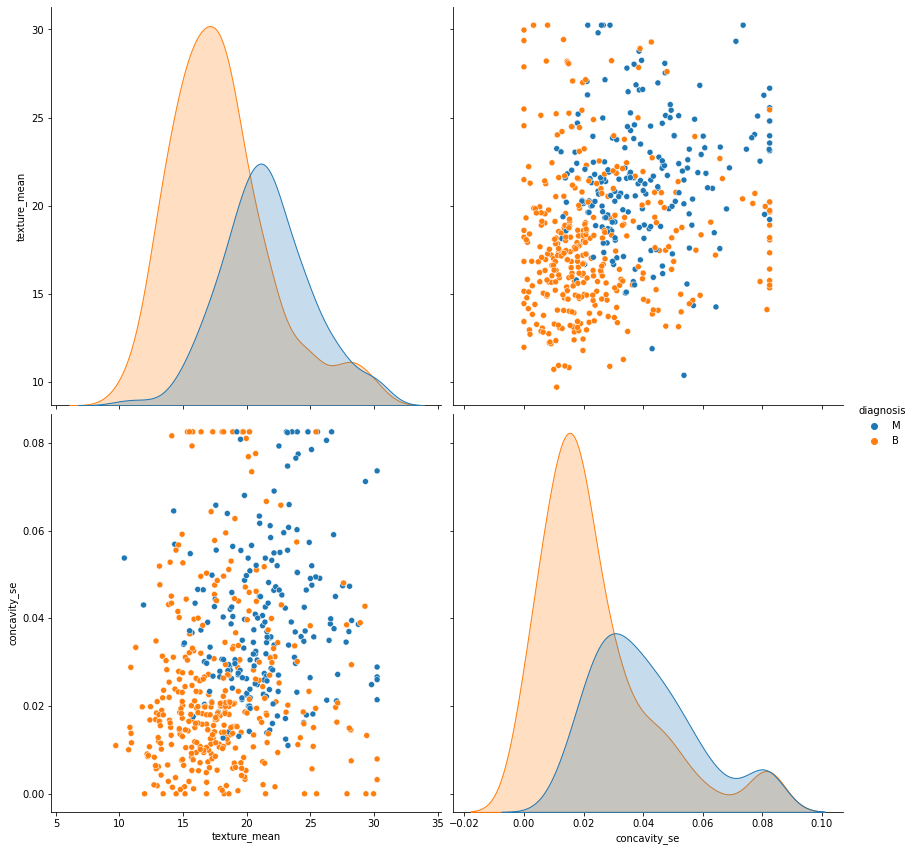

In [217]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'concavity_se'], height=6, aspect=1 )

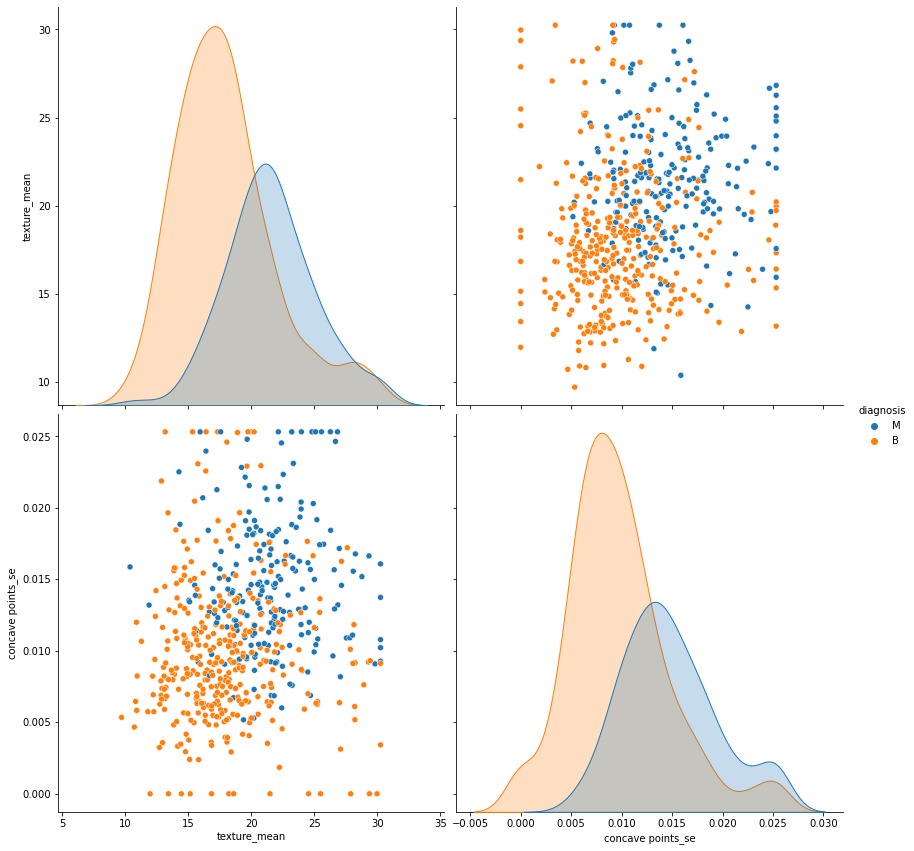

In [218]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'concave points_se'], height=6, aspect=1 )

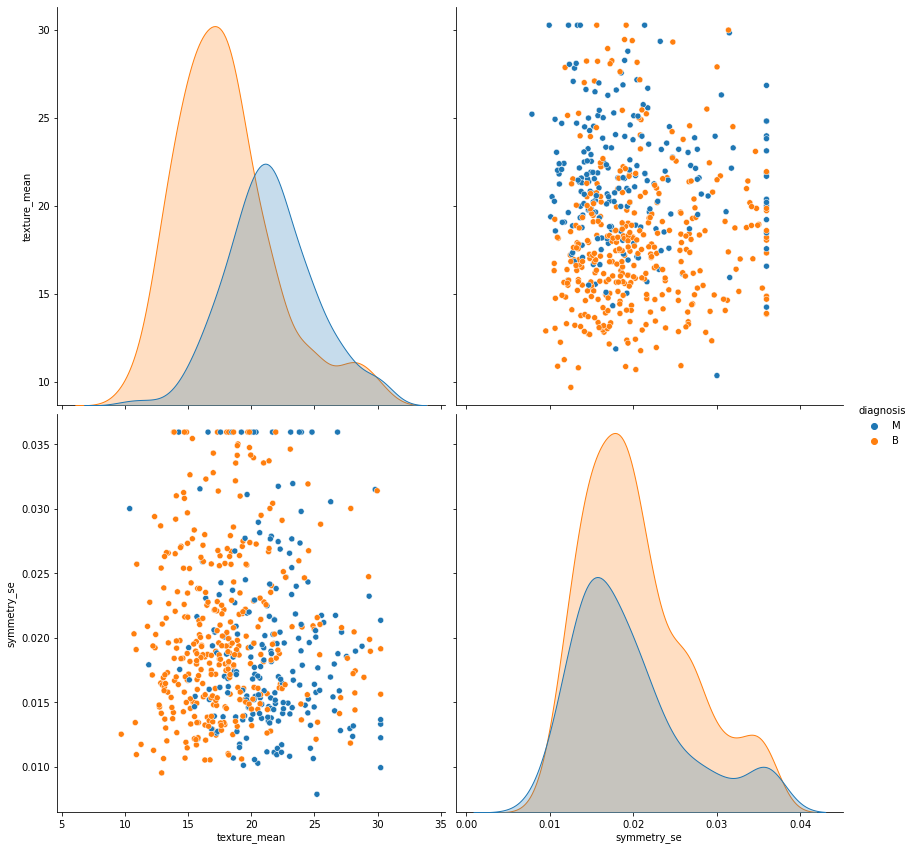

In [219]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'symmetry_se'], height=6, aspect=1 )

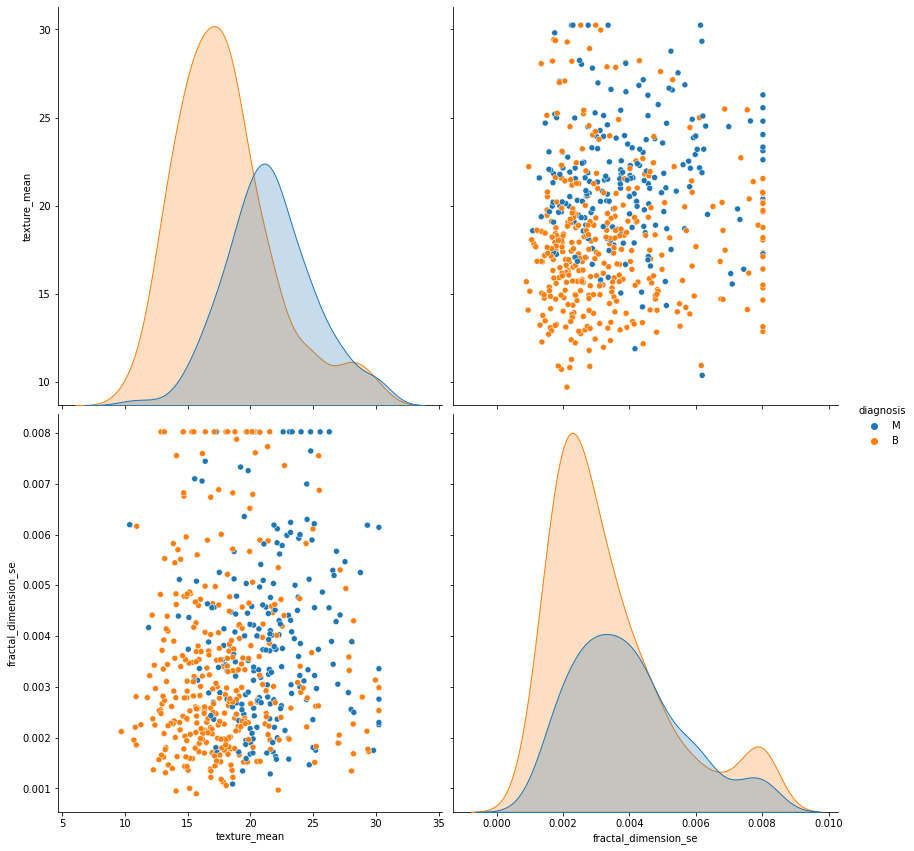

In [220]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'fractal_dimension_se'], height=6, aspect=1 )

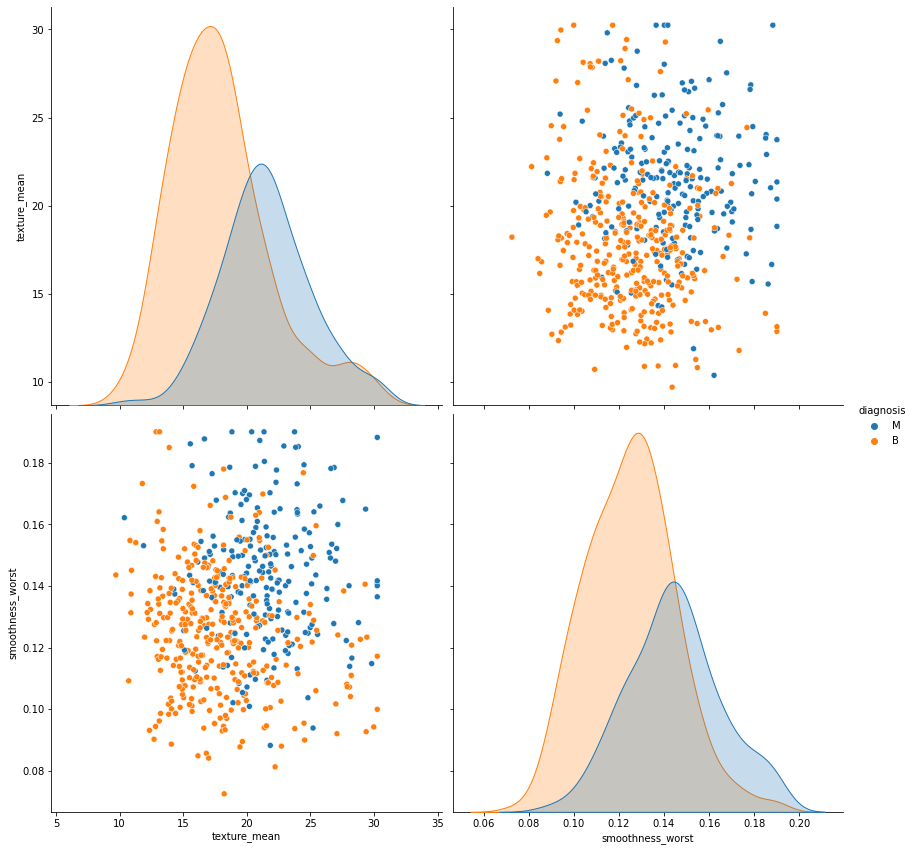

In [221]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'smoothness_worst'], height=6, aspect=1 )

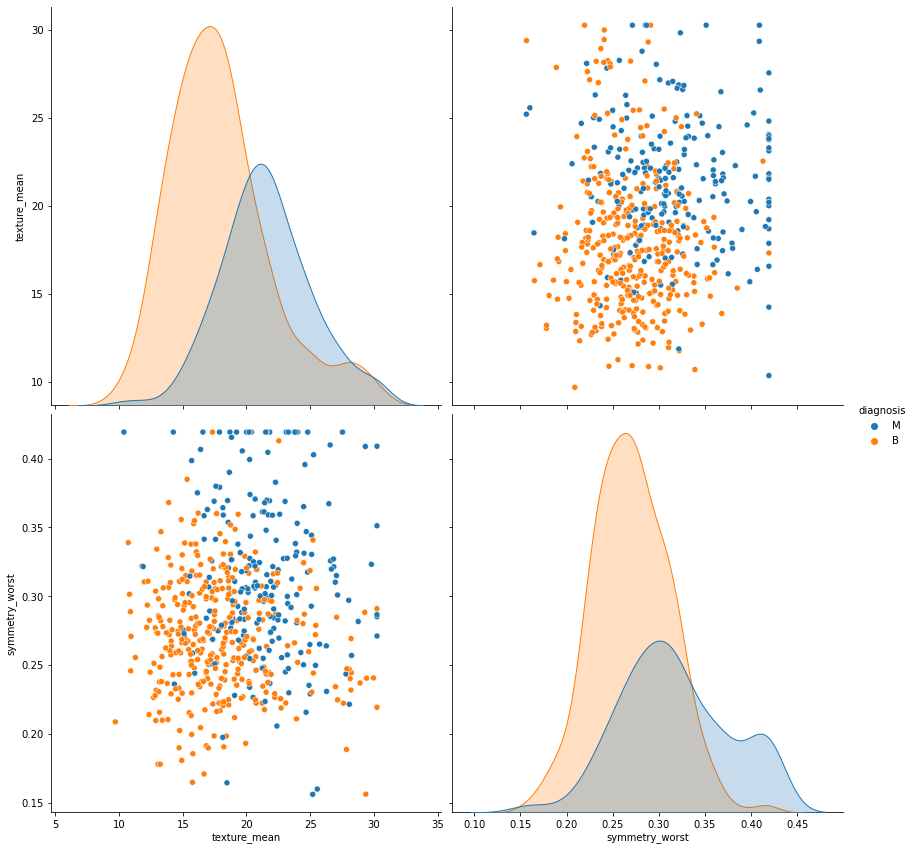

In [222]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'symmetry_worst'], height=6, aspect=1 )

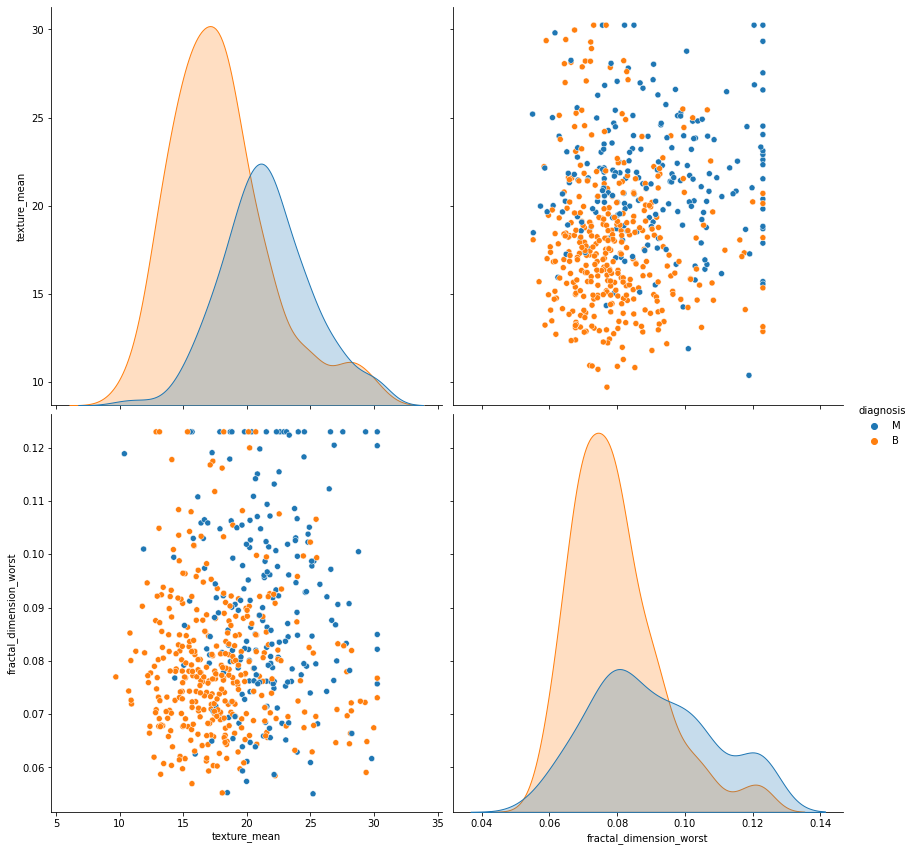

In [223]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_mean', 'fractal_dimension_worst'], height=6, aspect=1 )

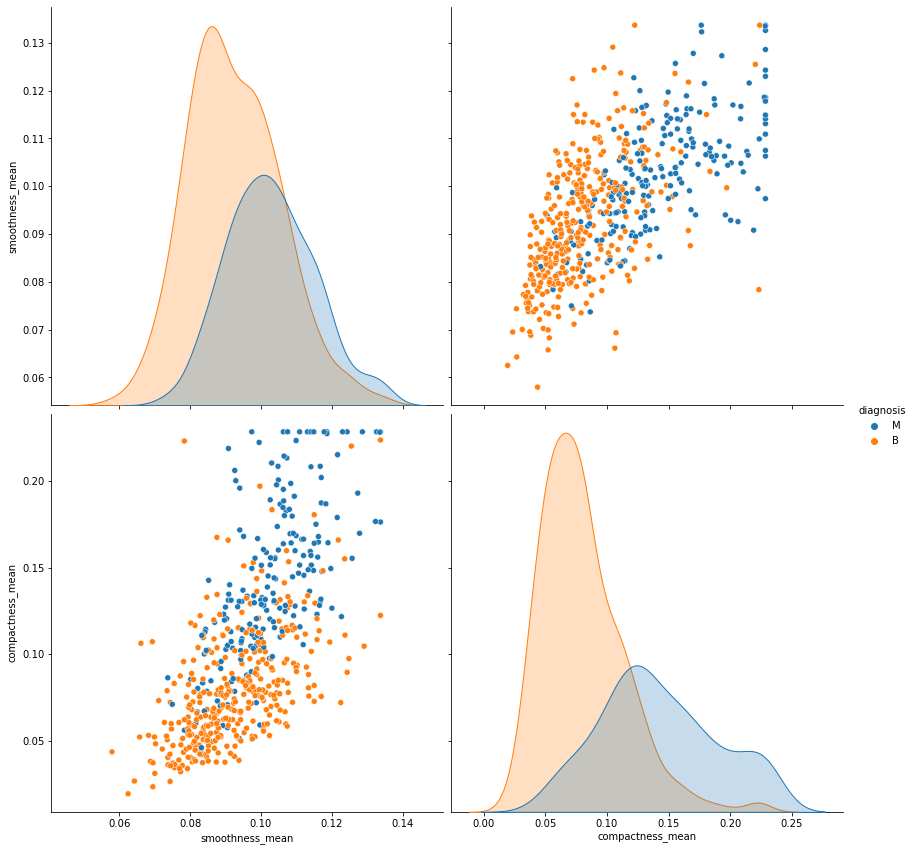

In [224]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'compactness_mean'], height=6, aspect=1 )

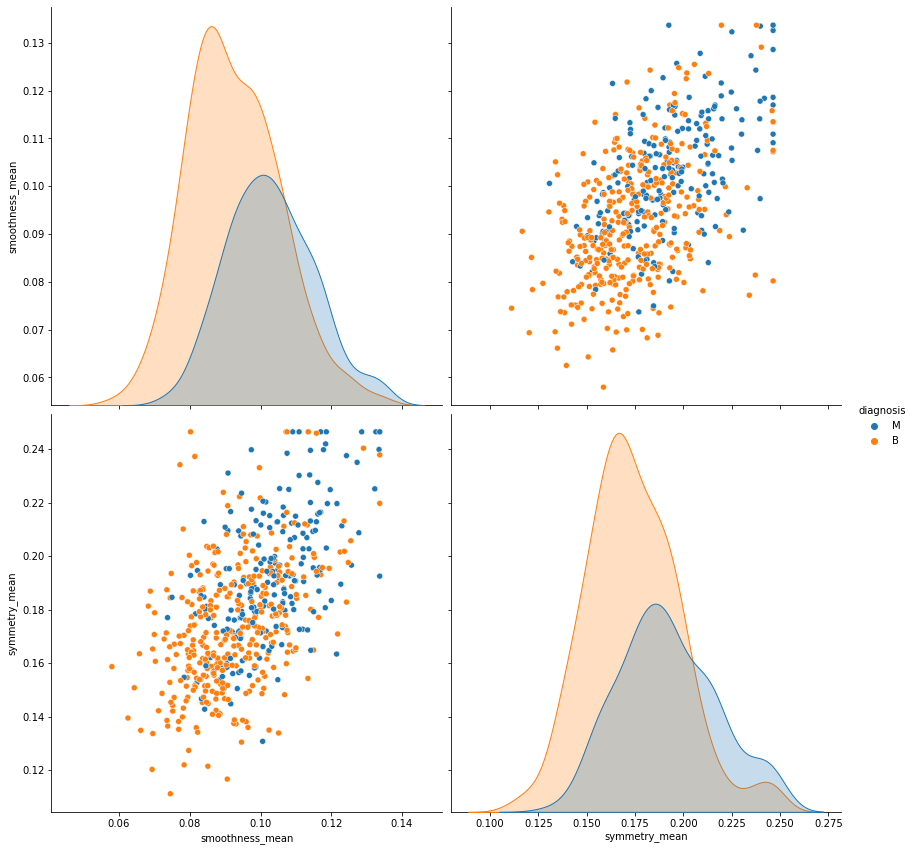

In [225]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'symmetry_mean'], height=6, aspect=1 )

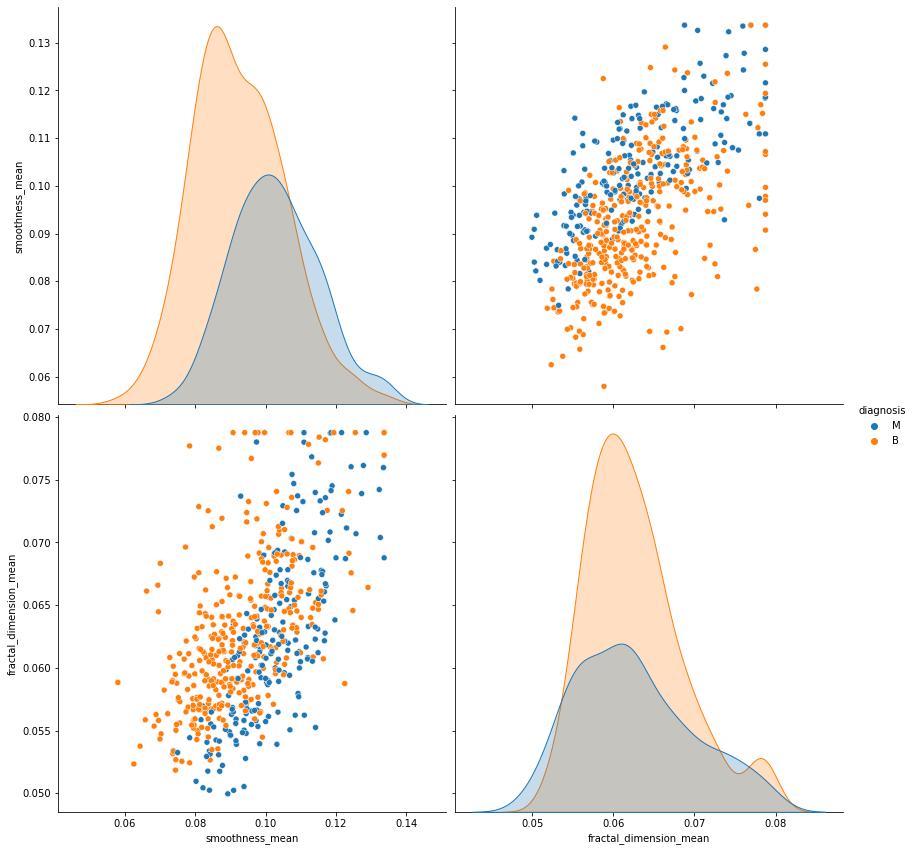

In [226]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'fractal_dimension_mean'], height=6, aspect=1 )

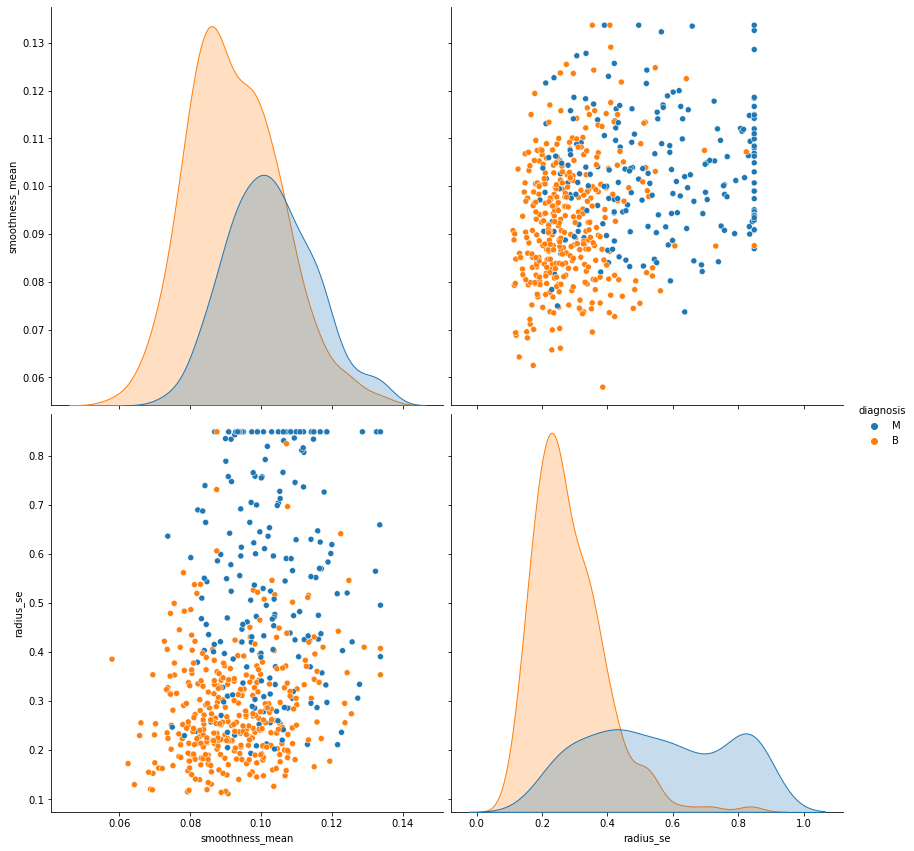

In [227]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'radius_se'], height=6, aspect=1 )

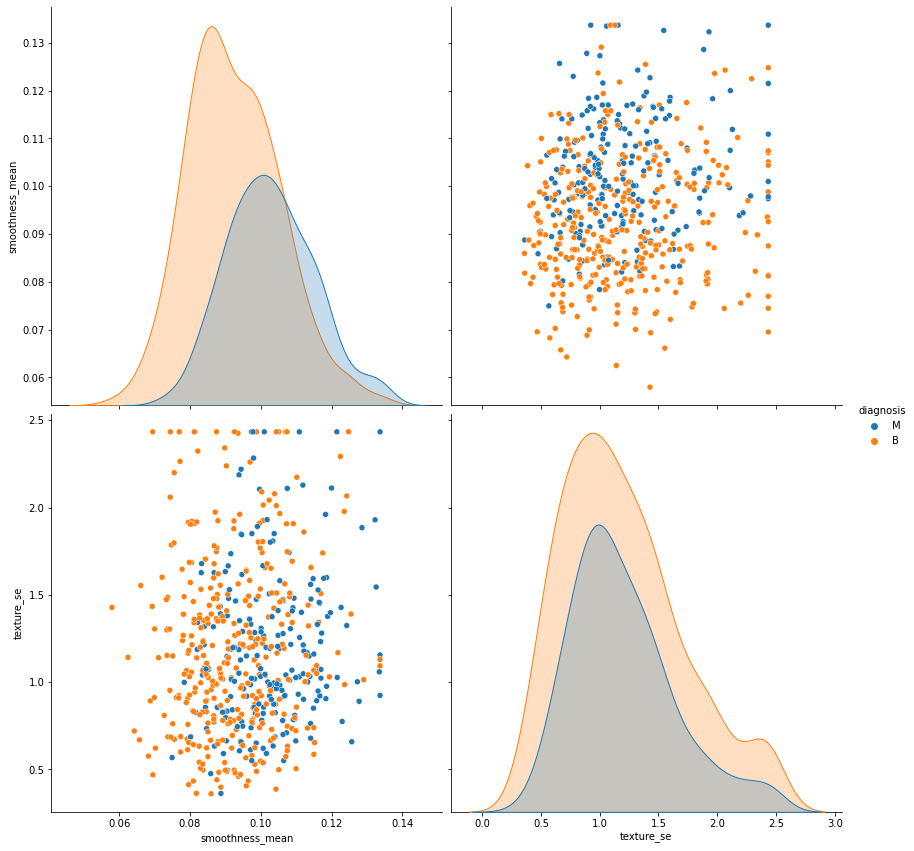

In [228]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'texture_se'], height=6, aspect=1 )

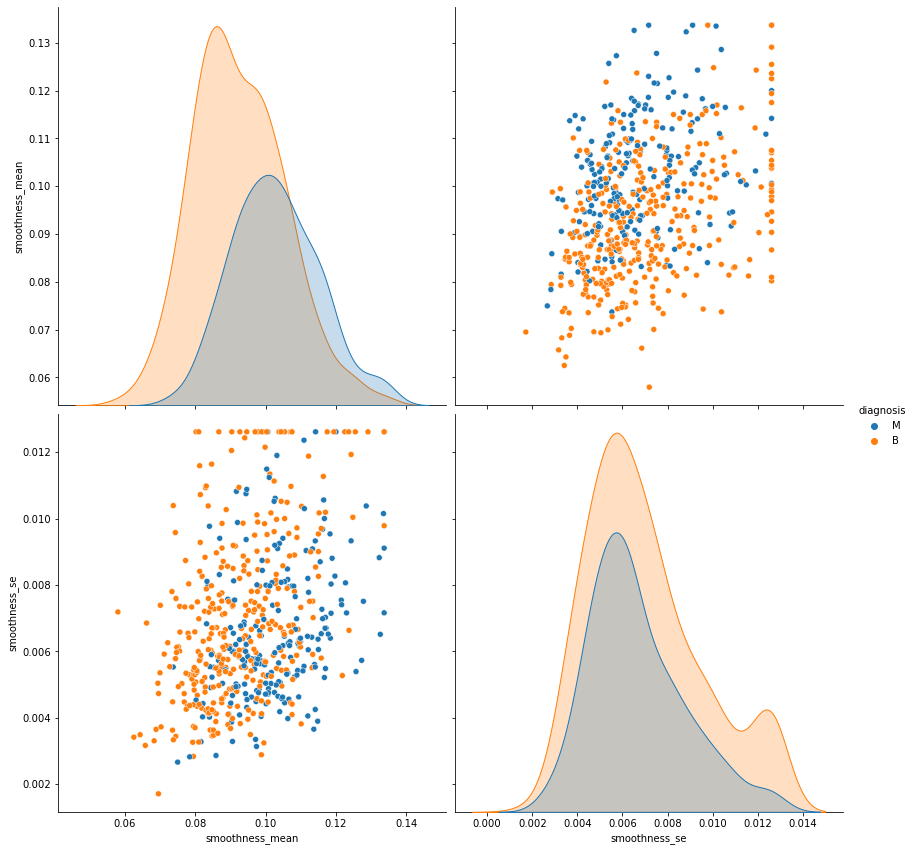

In [229]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'smoothness_se'], height=6, aspect=1 )

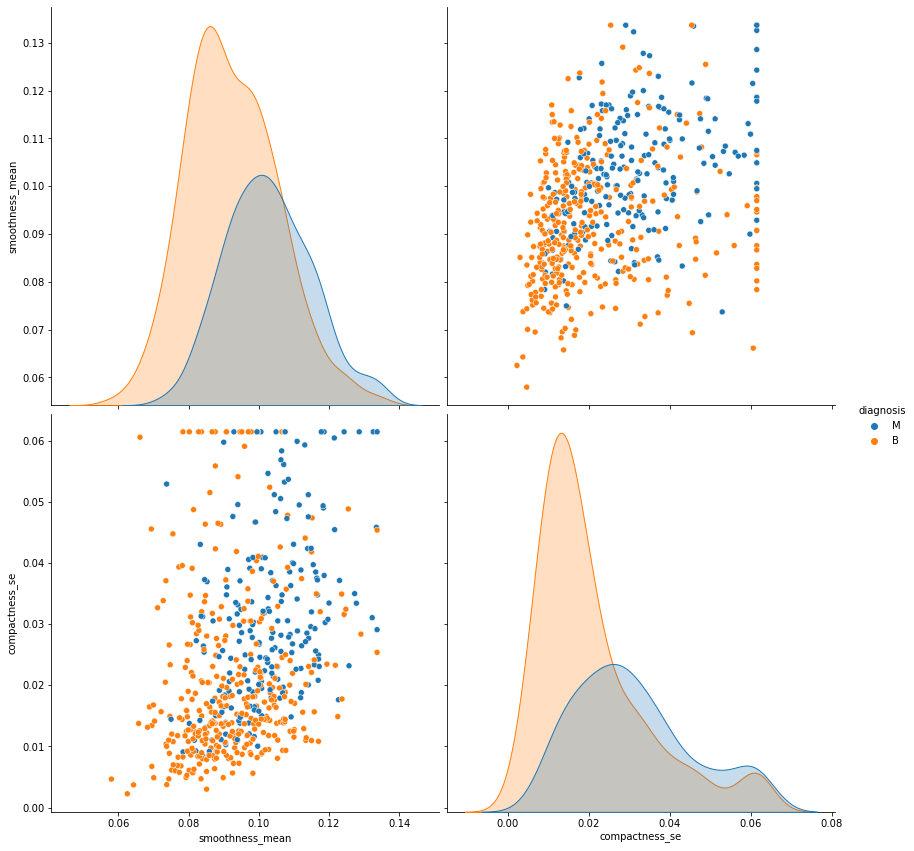

In [230]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'compactness_se'], height=6, aspect=1 )

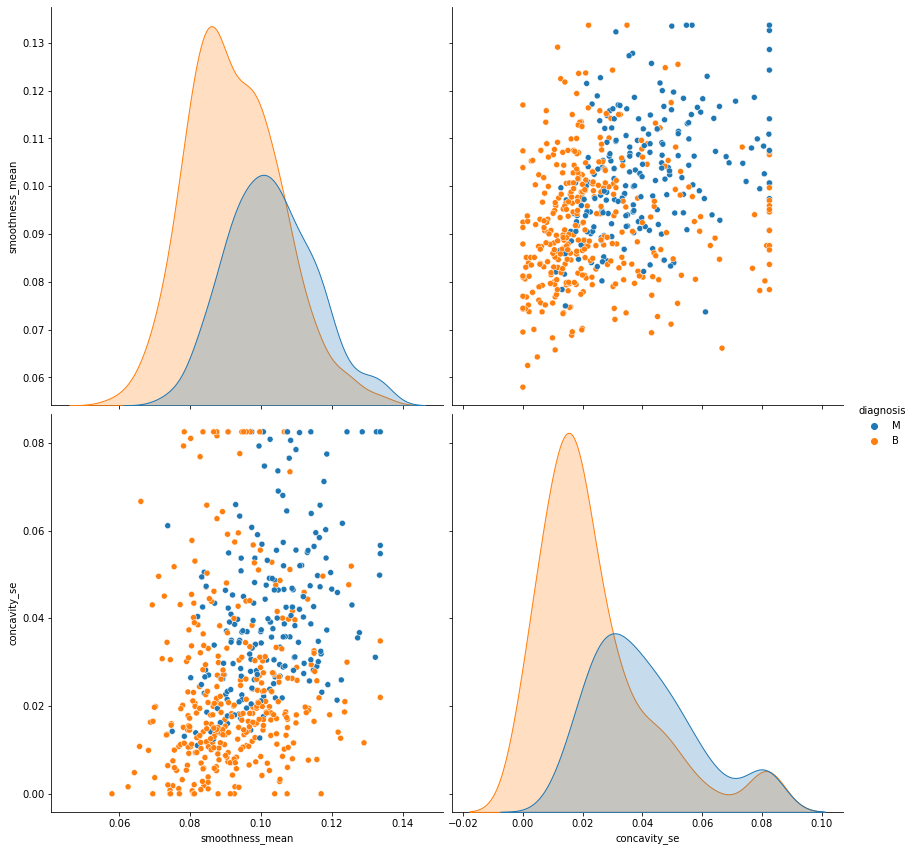

In [231]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'concavity_se'], height=6, aspect=1 )

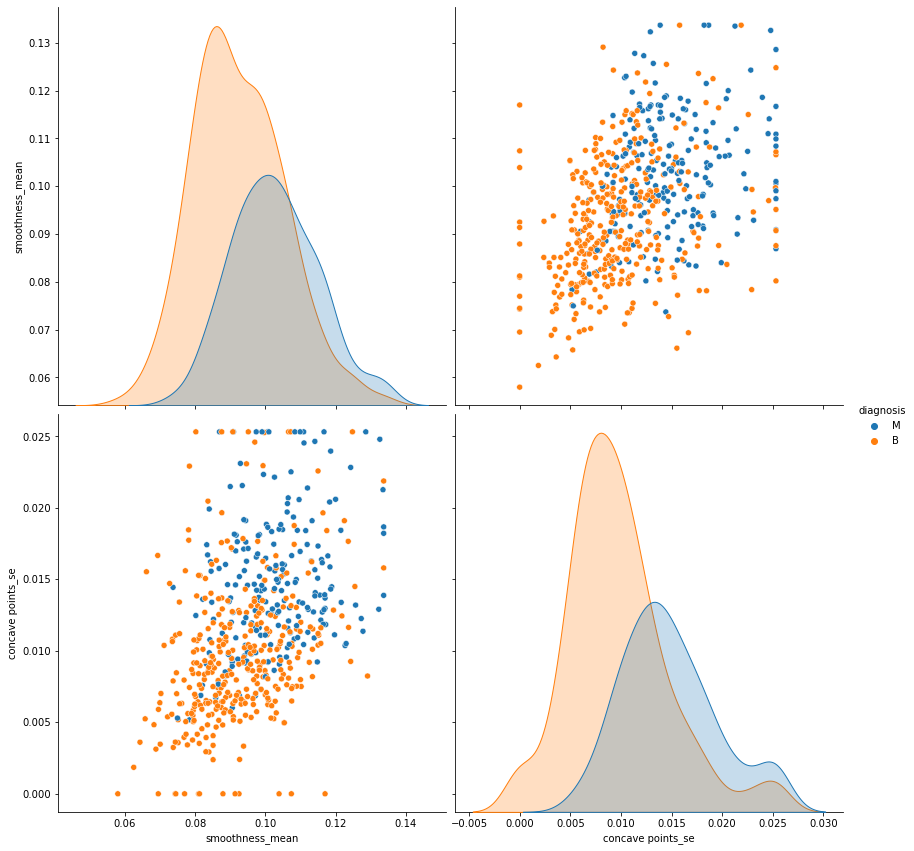

In [232]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'concave points_se'], height=6, aspect=1 )

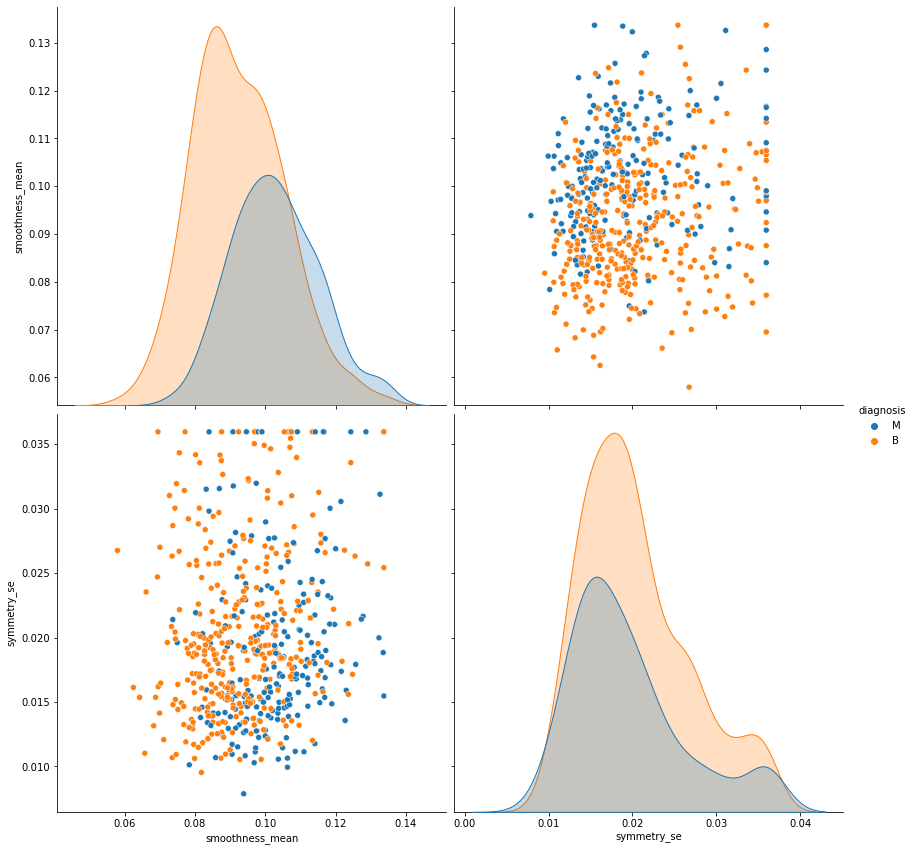

In [233]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'symmetry_se'], height=6, aspect=1 )

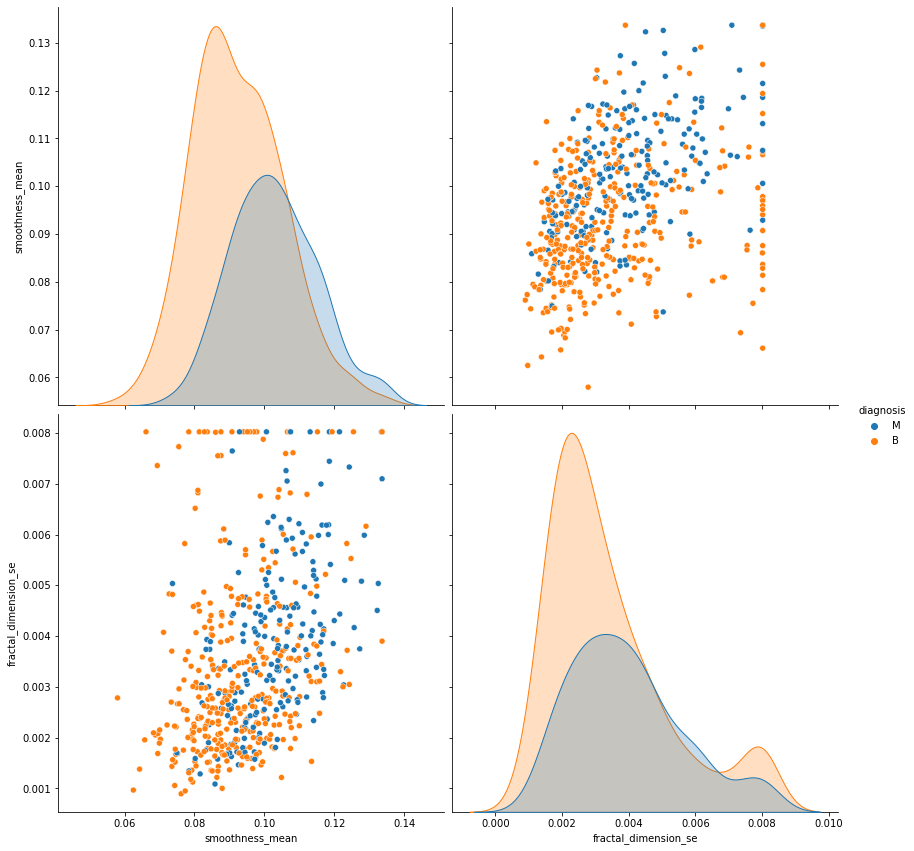

In [234]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'fractal_dimension_se'], height=6, aspect=1 )

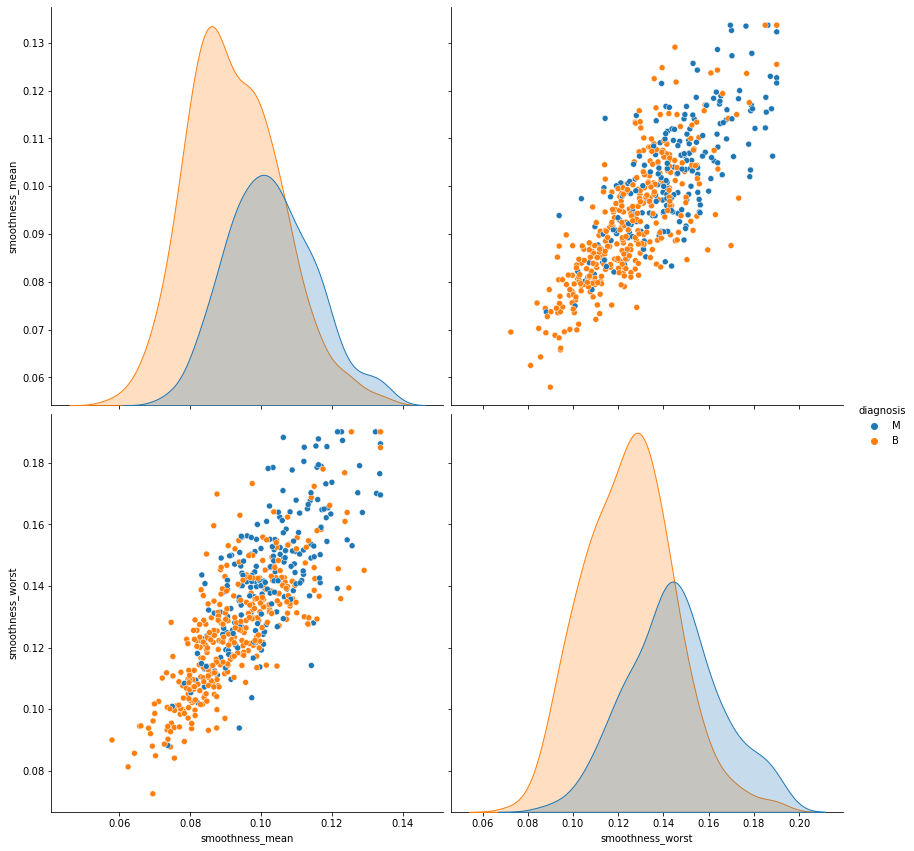

In [235]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'smoothness_worst'], height=6, aspect=1 )

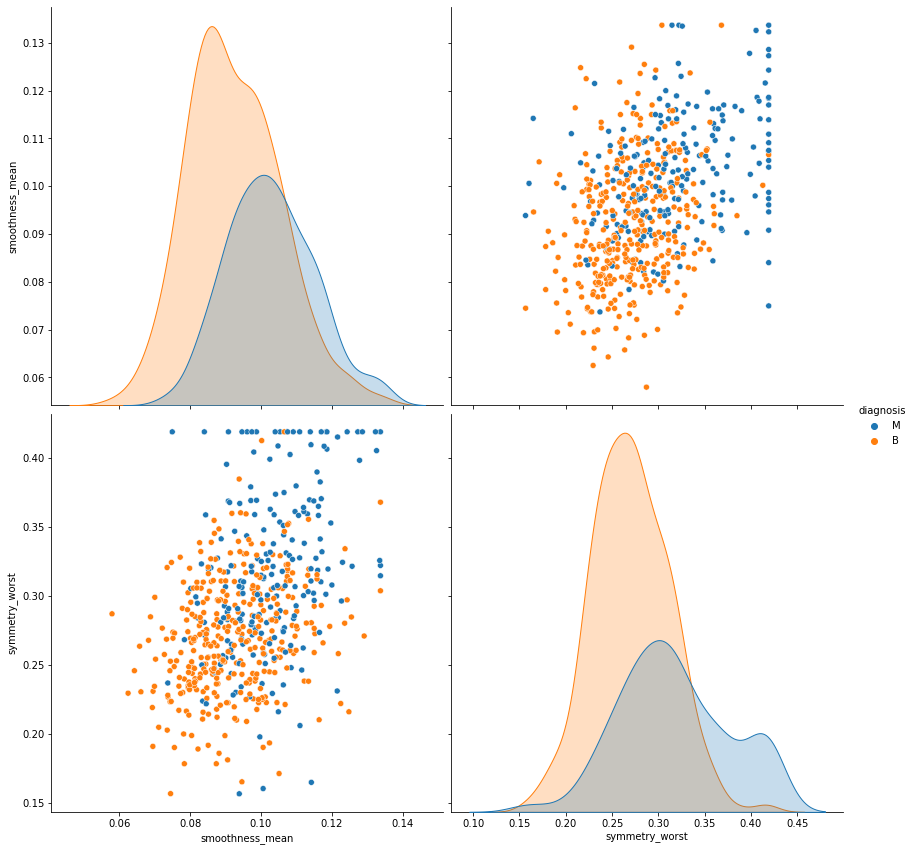

In [236]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'symmetry_worst'], height=6, aspect=1 )

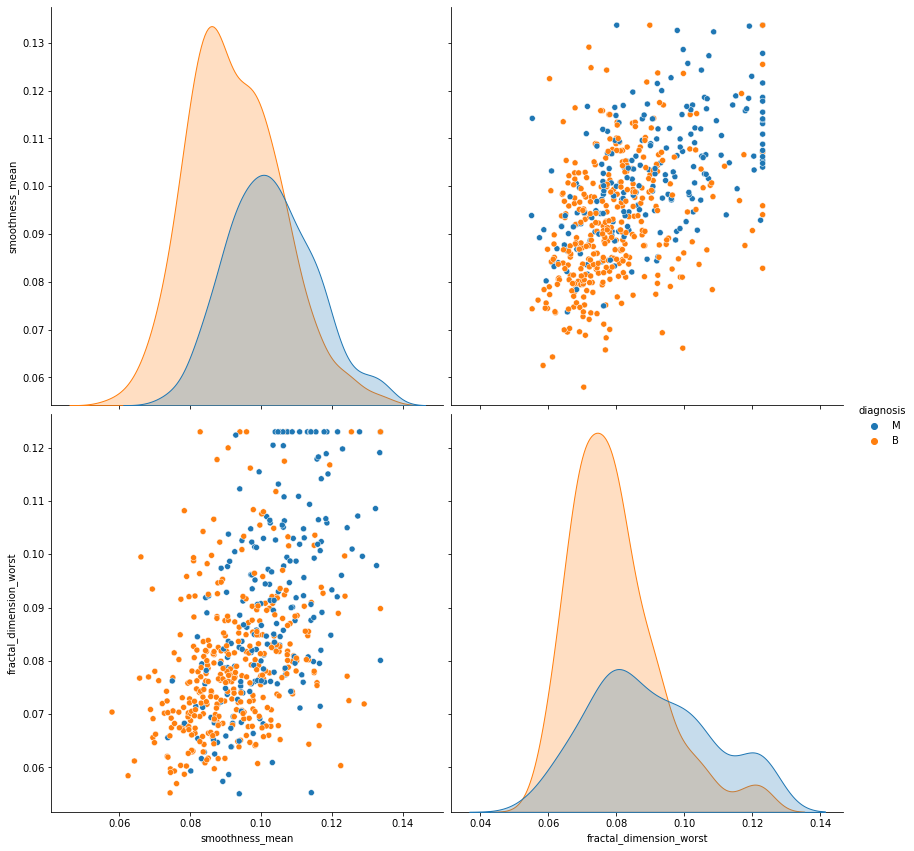

In [237]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_mean', 'fractal_dimension_worst'], height=6, aspect=1 )

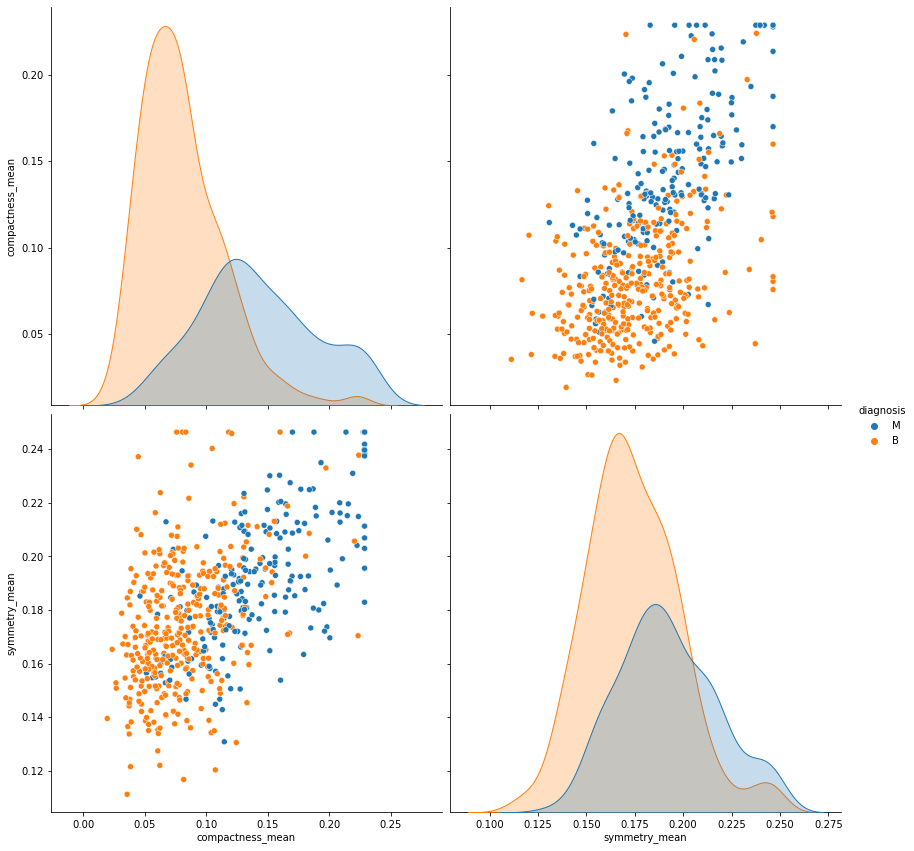

In [238]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'symmetry_mean'], height=6, aspect=1 )

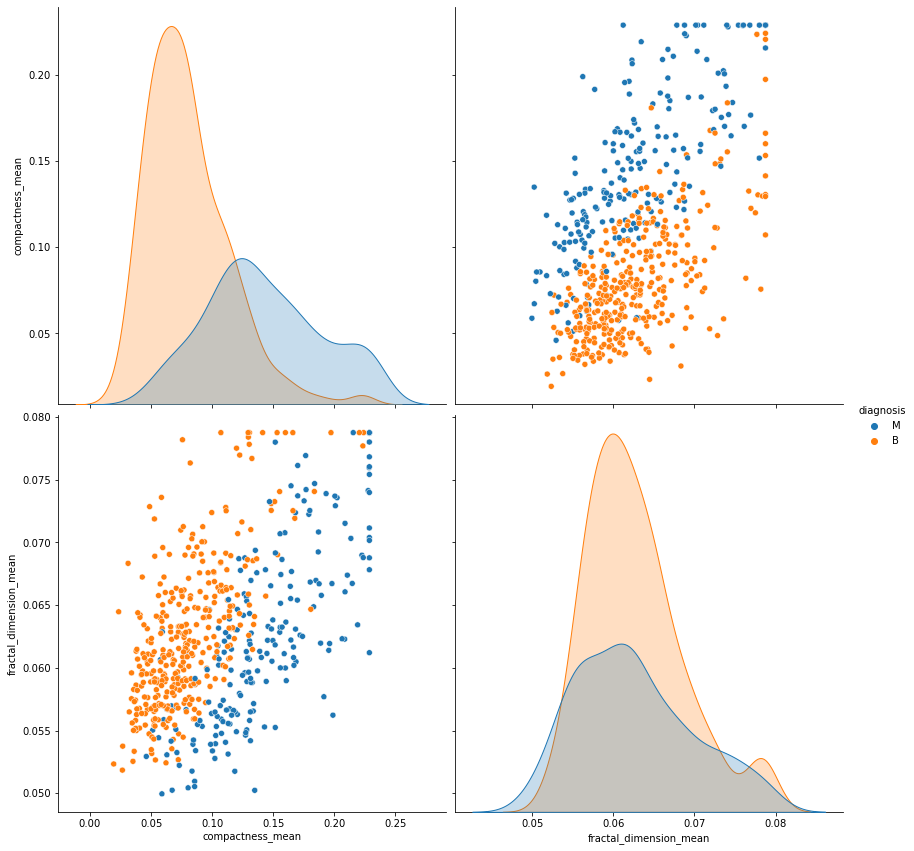

In [239]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'fractal_dimension_mean'], height=6, aspect=1 )

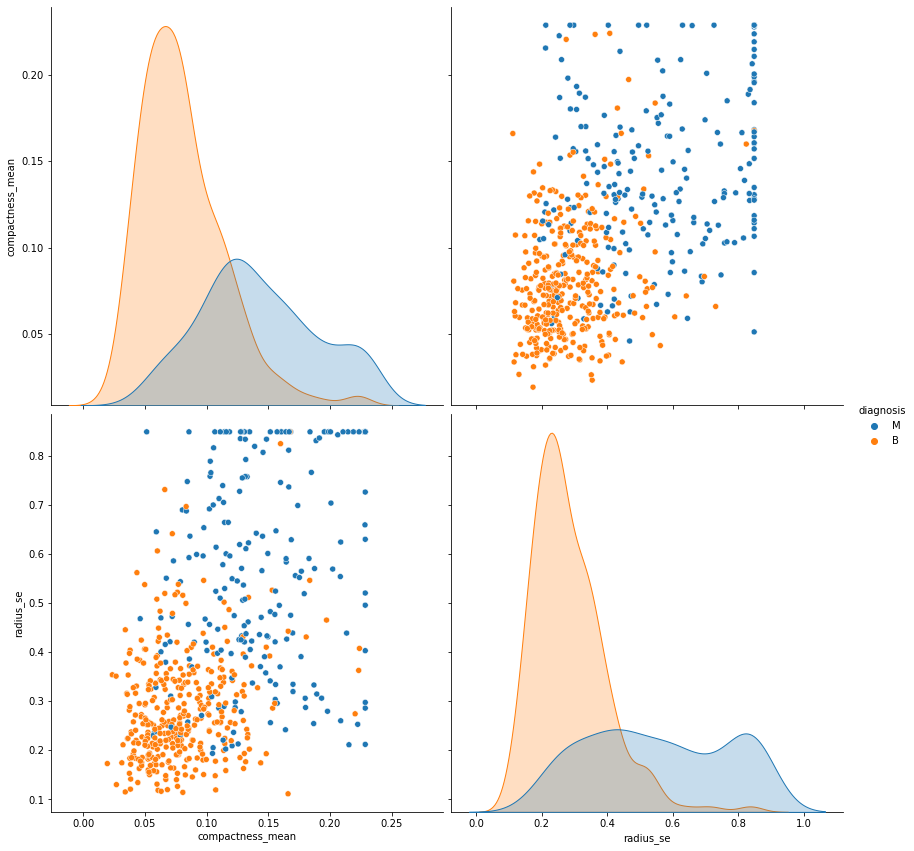

In [240]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'radius_se'], height=6, aspect=1 )

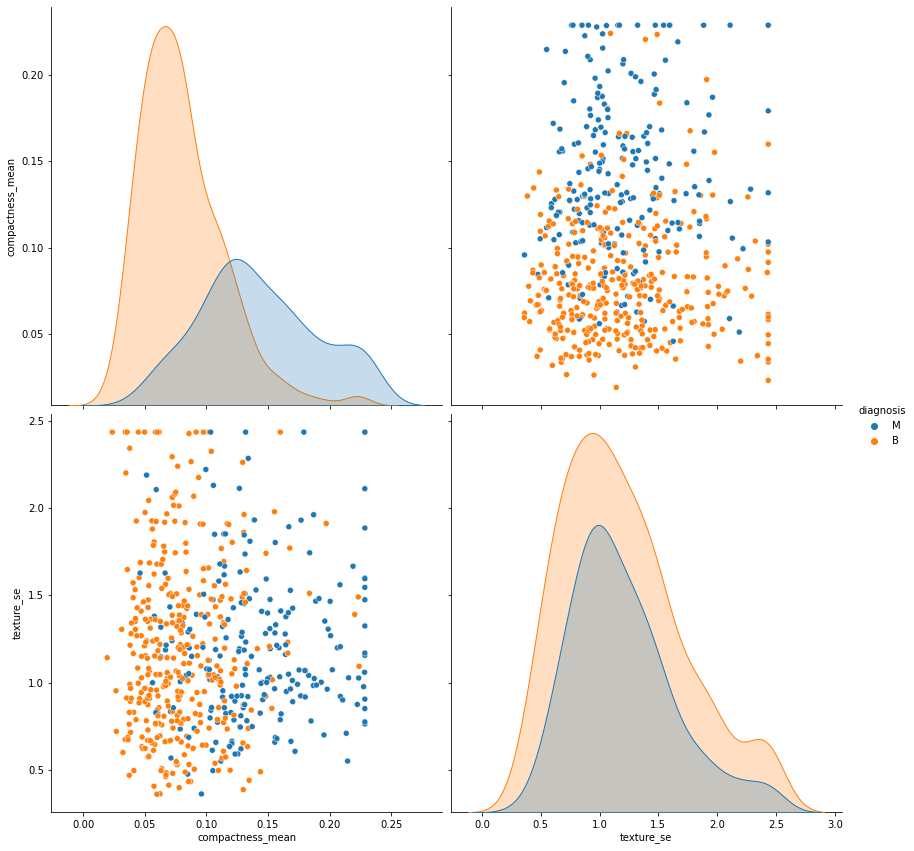

In [241]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'texture_se'], height=6, aspect=1 )

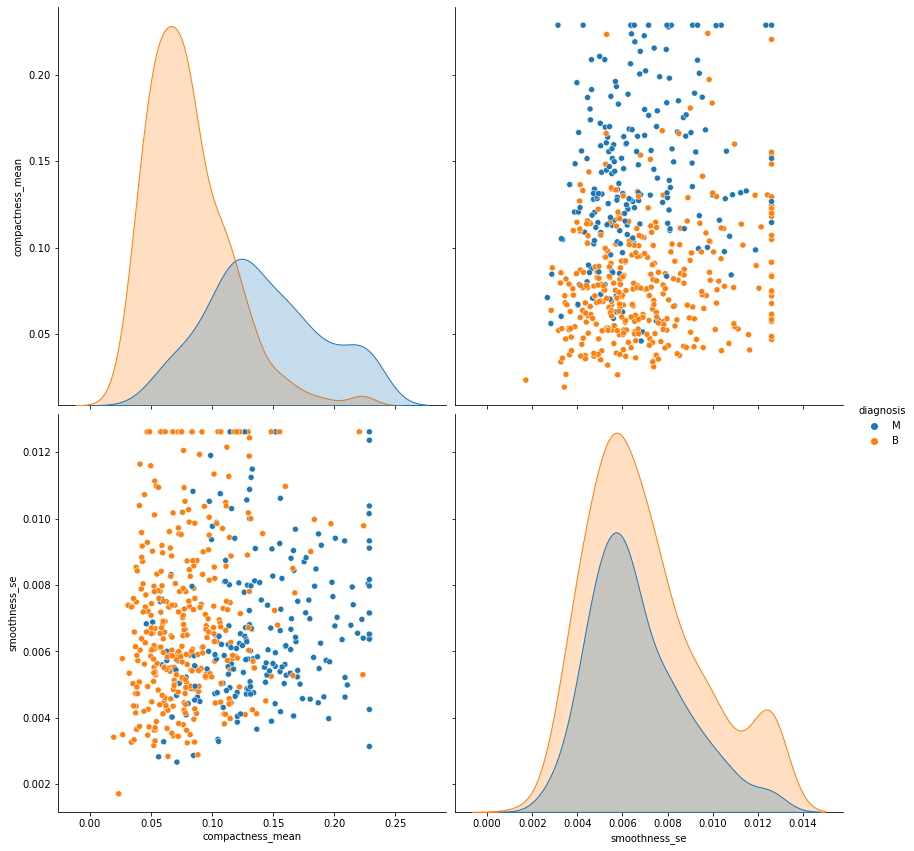

In [242]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'smoothness_se'], height=6, aspect=1 )

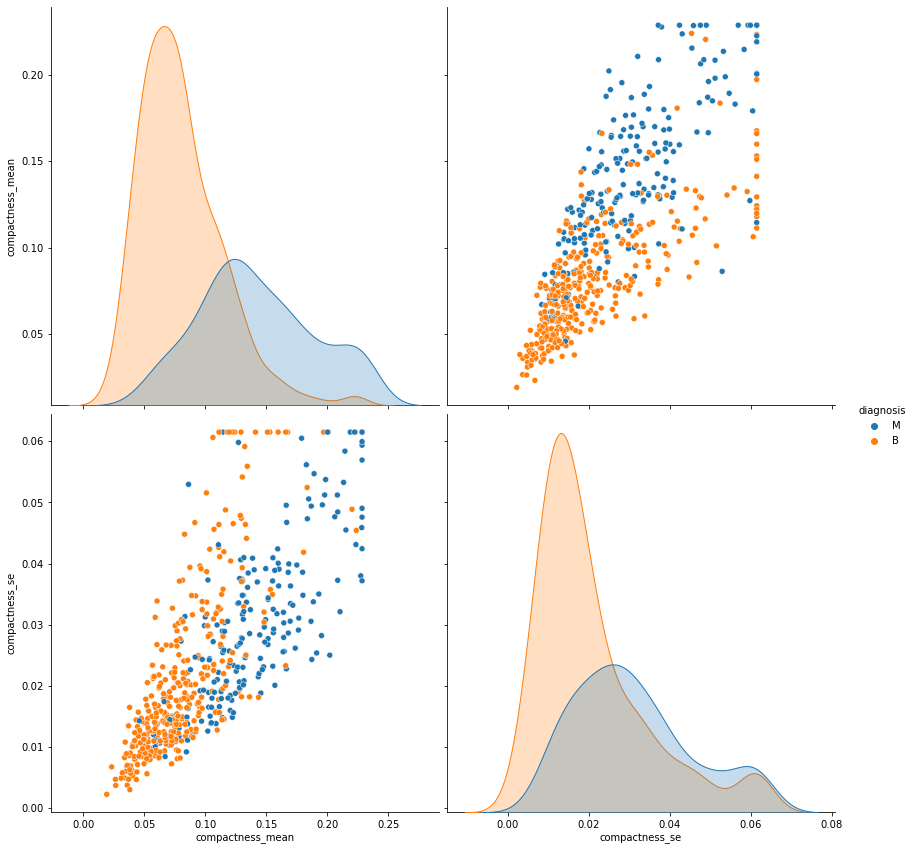

In [243]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'compactness_se'], height=6, aspect=1 )

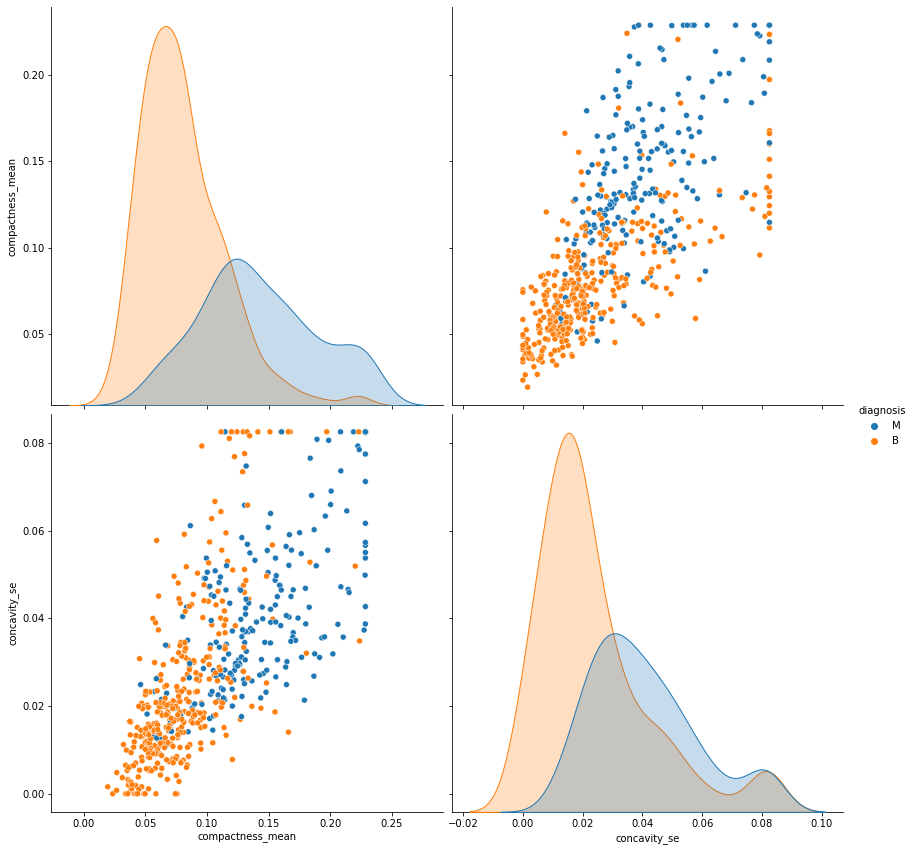

In [244]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'concavity_se'], height=6, aspect=1 )

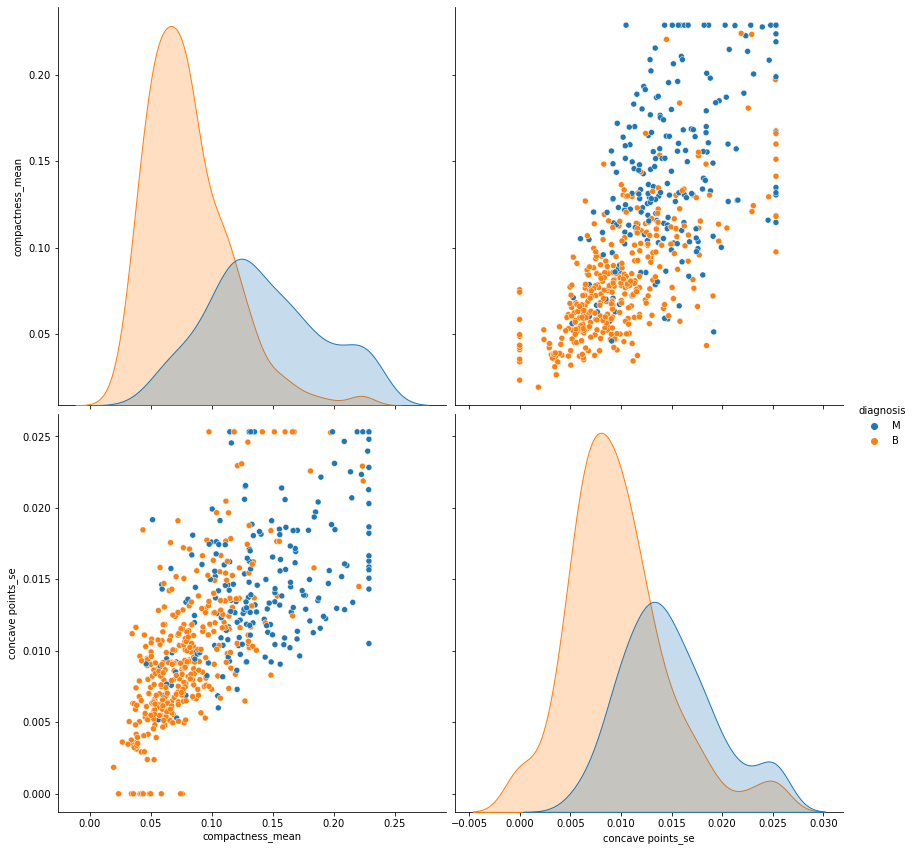

In [245]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'concave points_se'], height=6, aspect=1 )

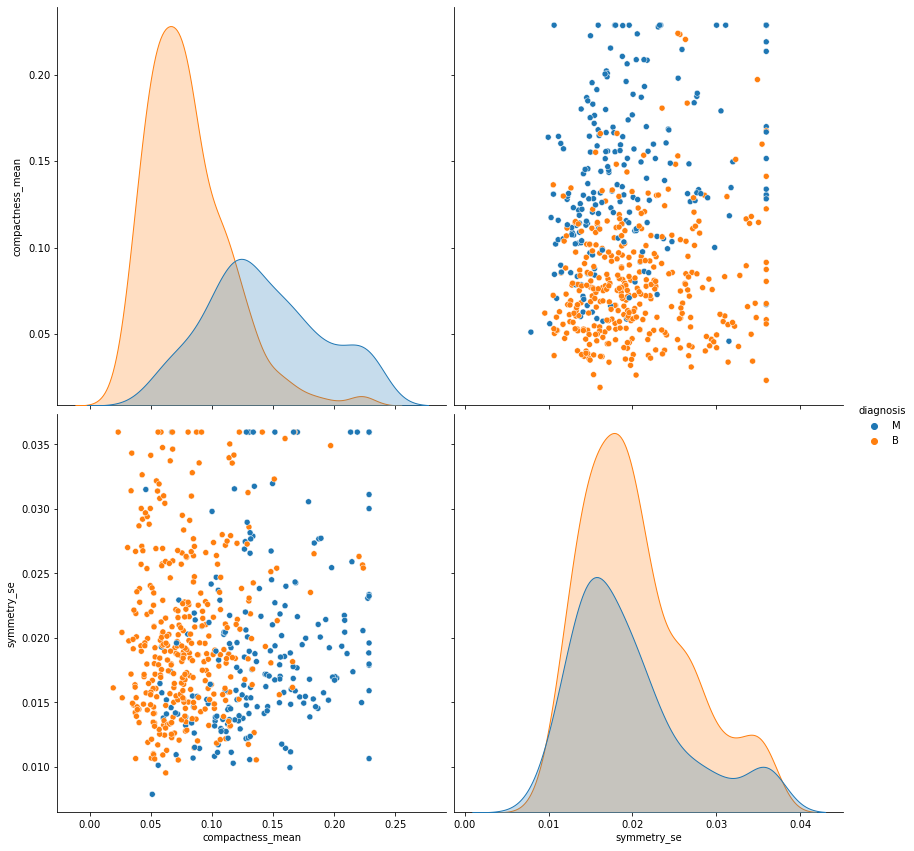

In [246]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'symmetry_se'], height=6, aspect=1 )

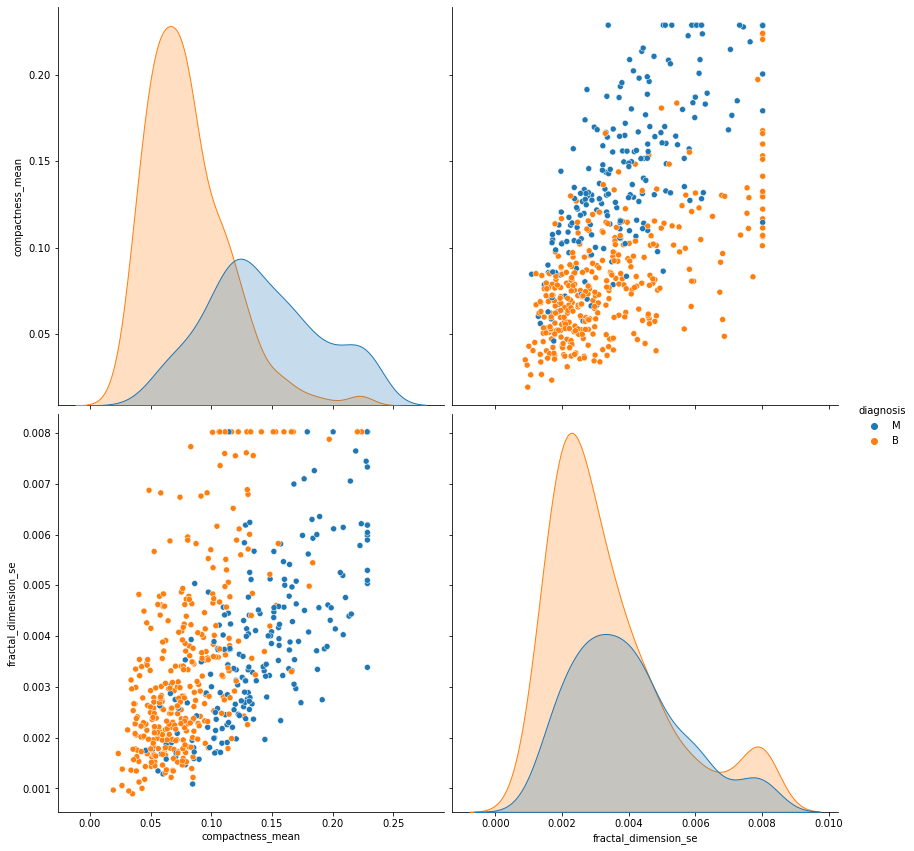

In [247]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'fractal_dimension_se'], height=6, aspect=1 )

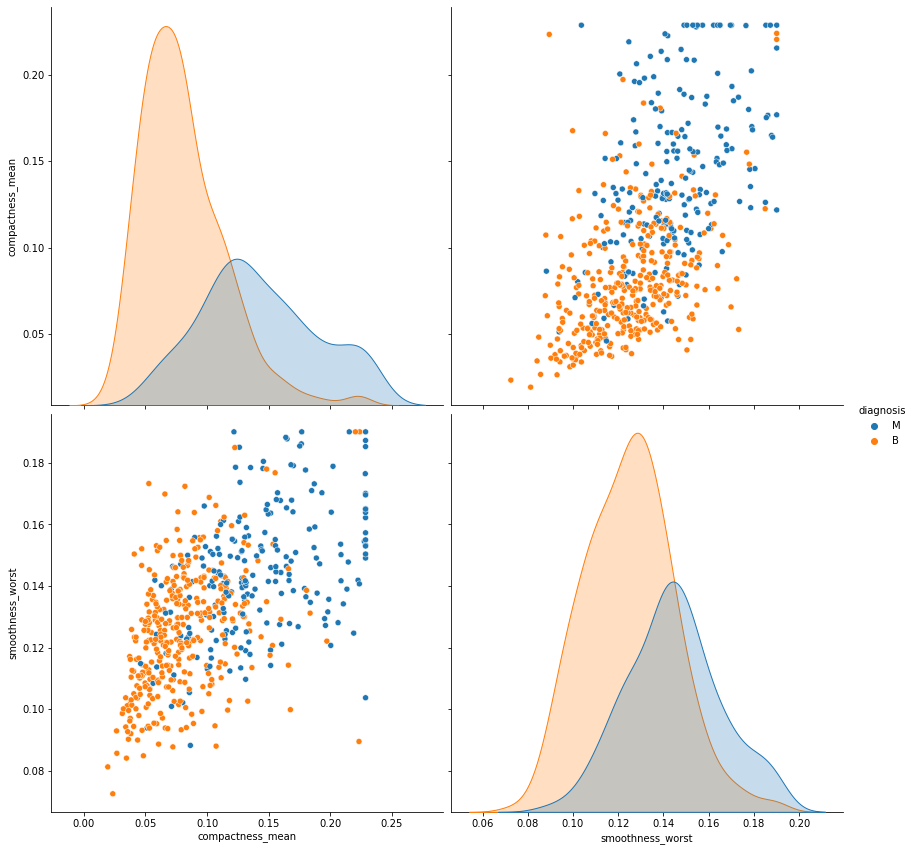

In [248]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'smoothness_worst'], height=6, aspect=1 )

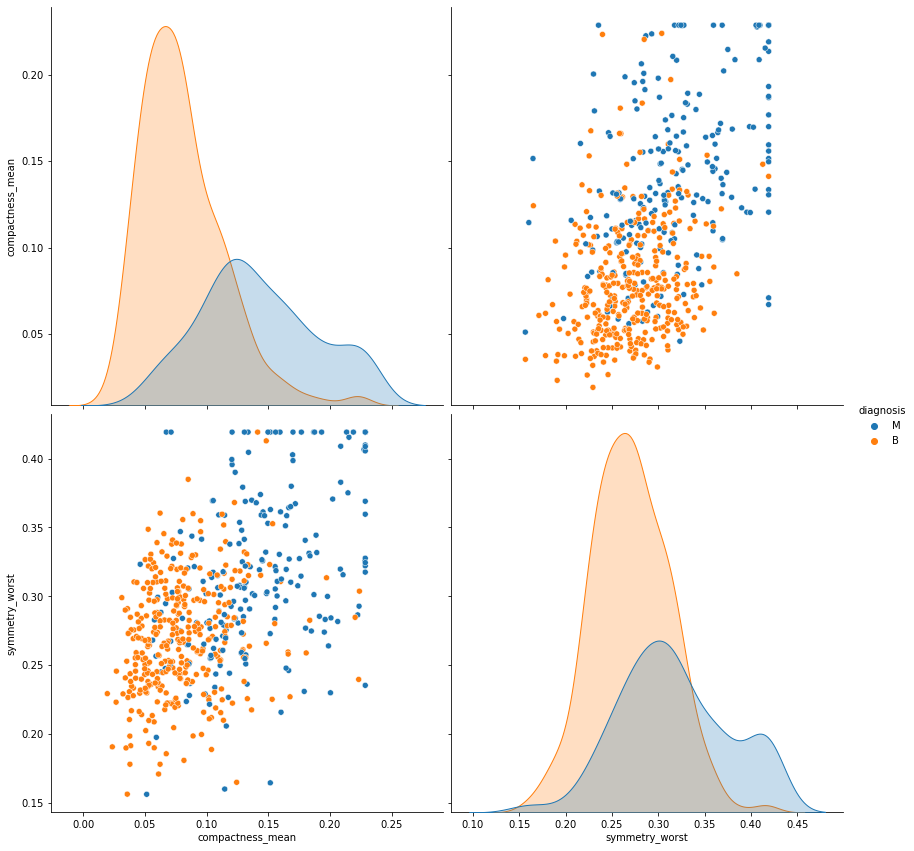

In [249]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'symmetry_worst'], height=6, aspect=1 )

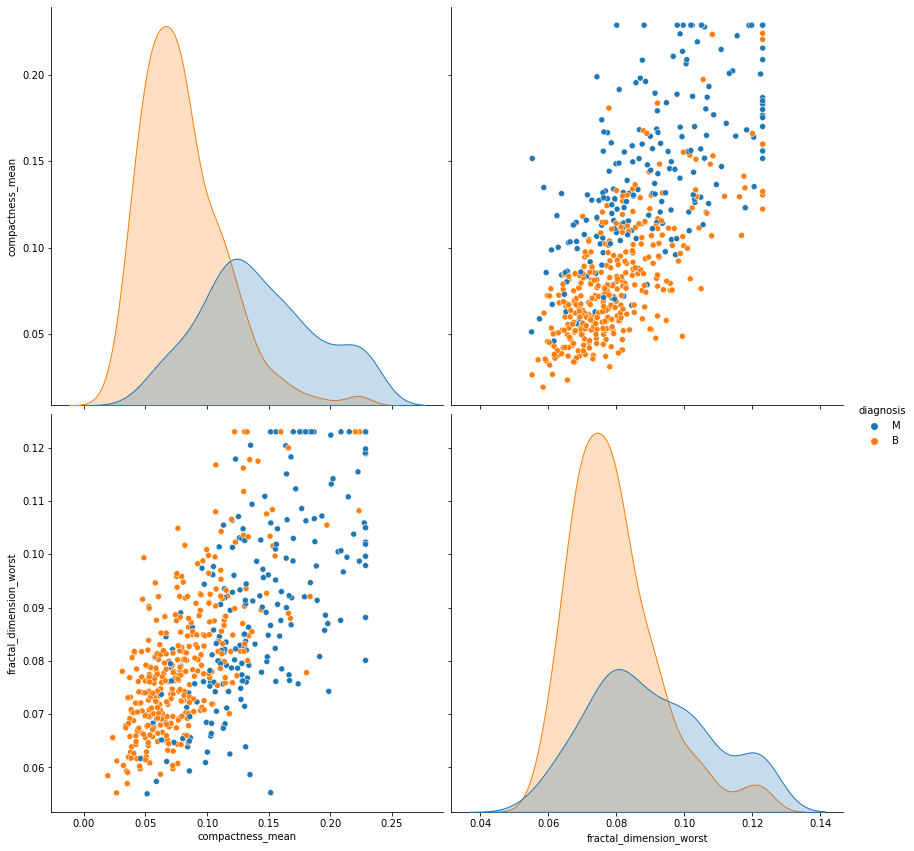

In [250]:
sns.pairplot(df, hue ='diagnosis', vars=['compactness_mean', 'fractal_dimension_worst'], height=6, aspect=1 )

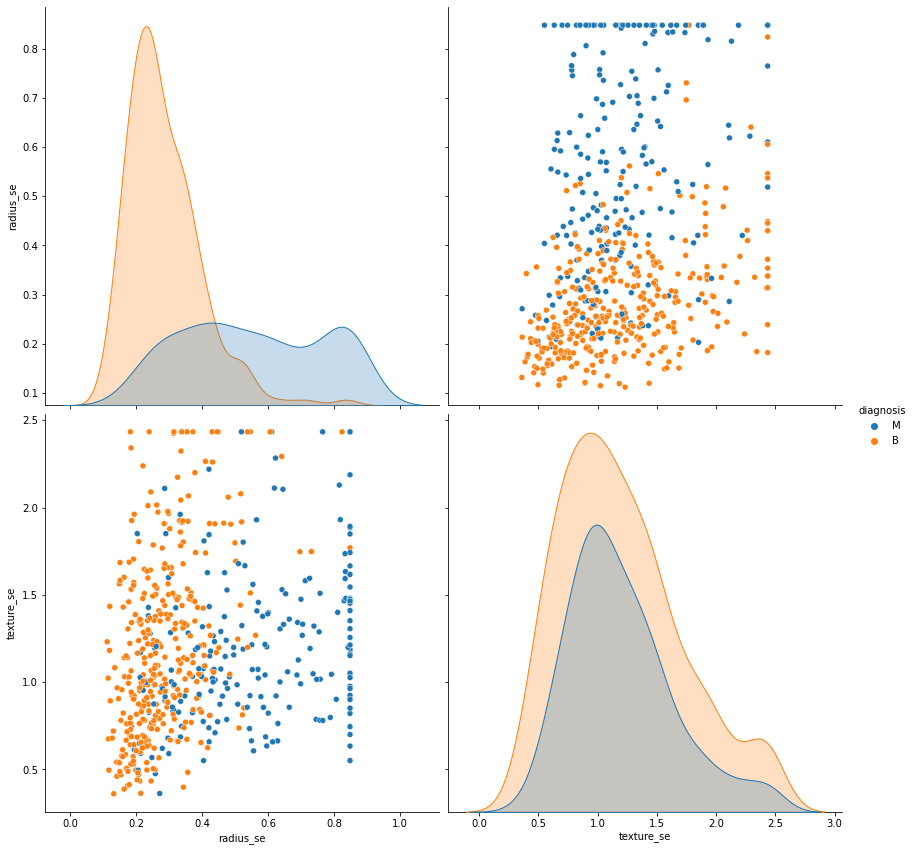

In [251]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'texture_se'], height=6, aspect=1 )

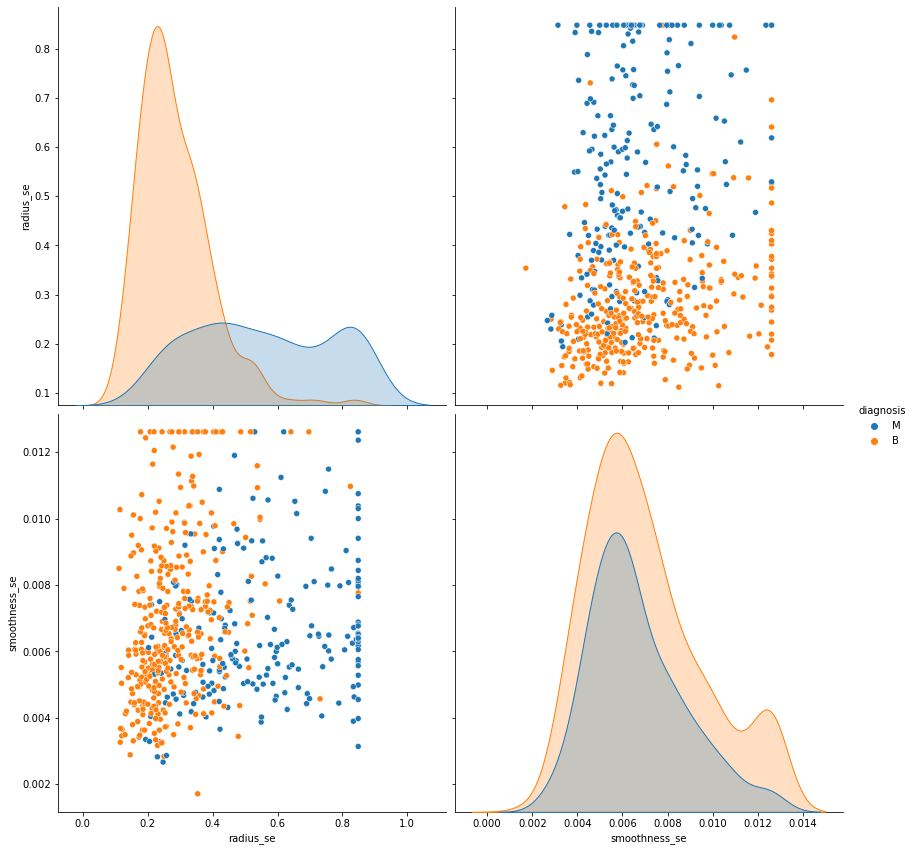

In [252]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'smoothness_se'], height=6, aspect=1 )

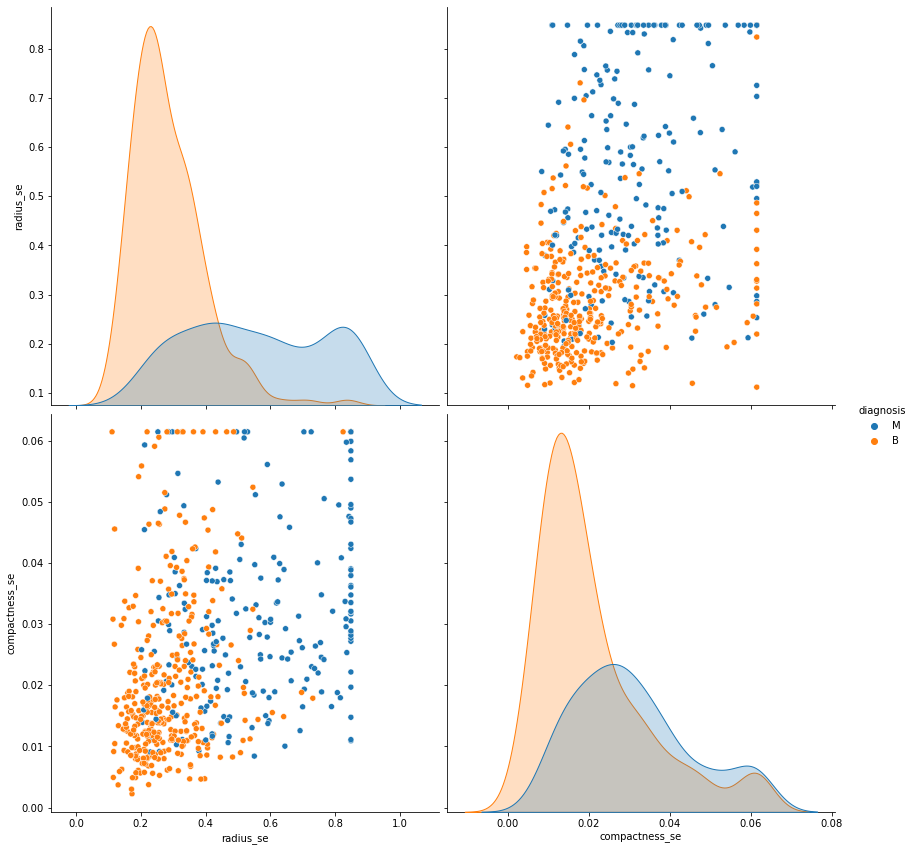

In [253]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'compactness_se'], height=6, aspect=1 )

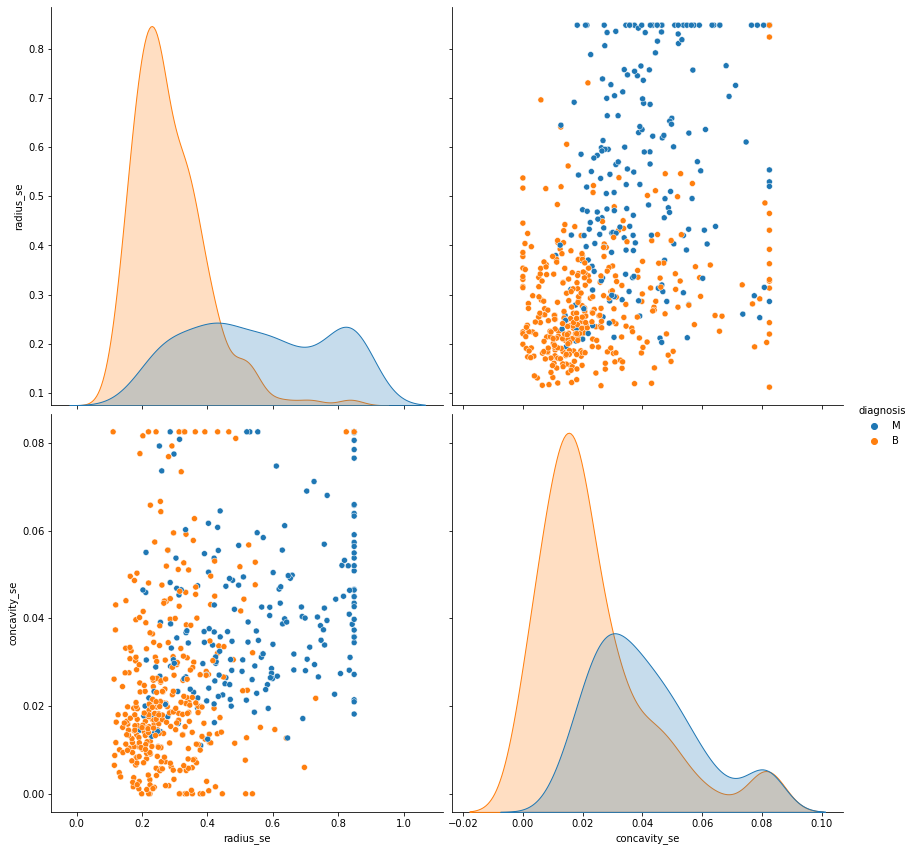

In [254]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'concavity_se'], height=6, aspect=1 )

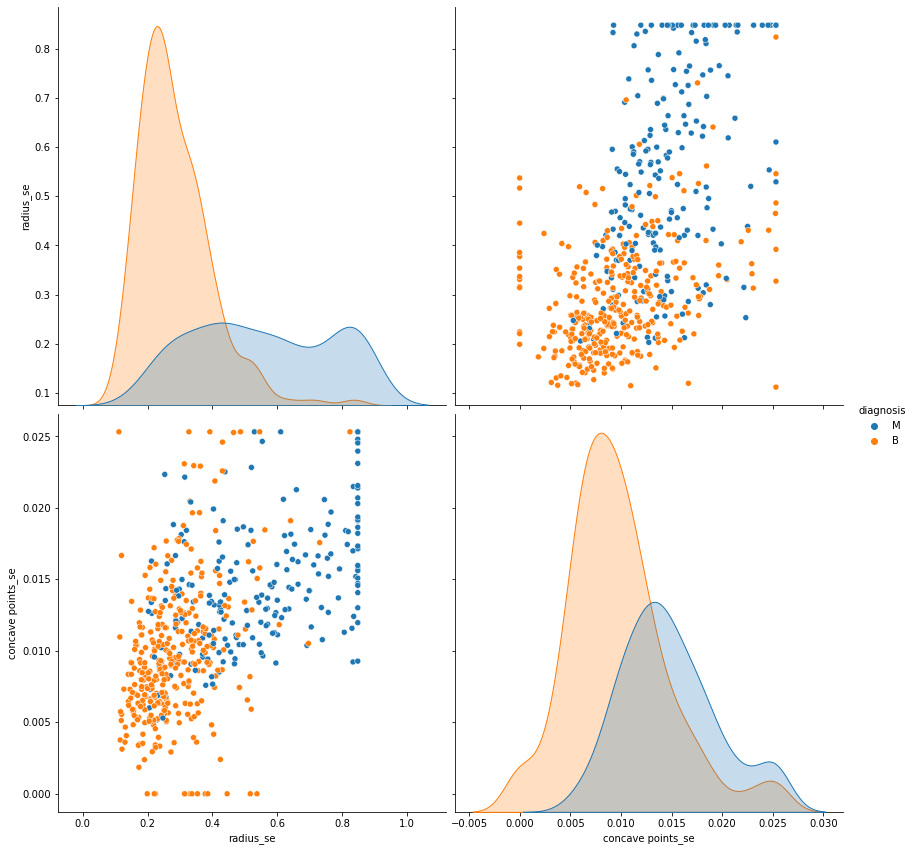

In [255]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'concave points_se'], height=6, aspect=1 )

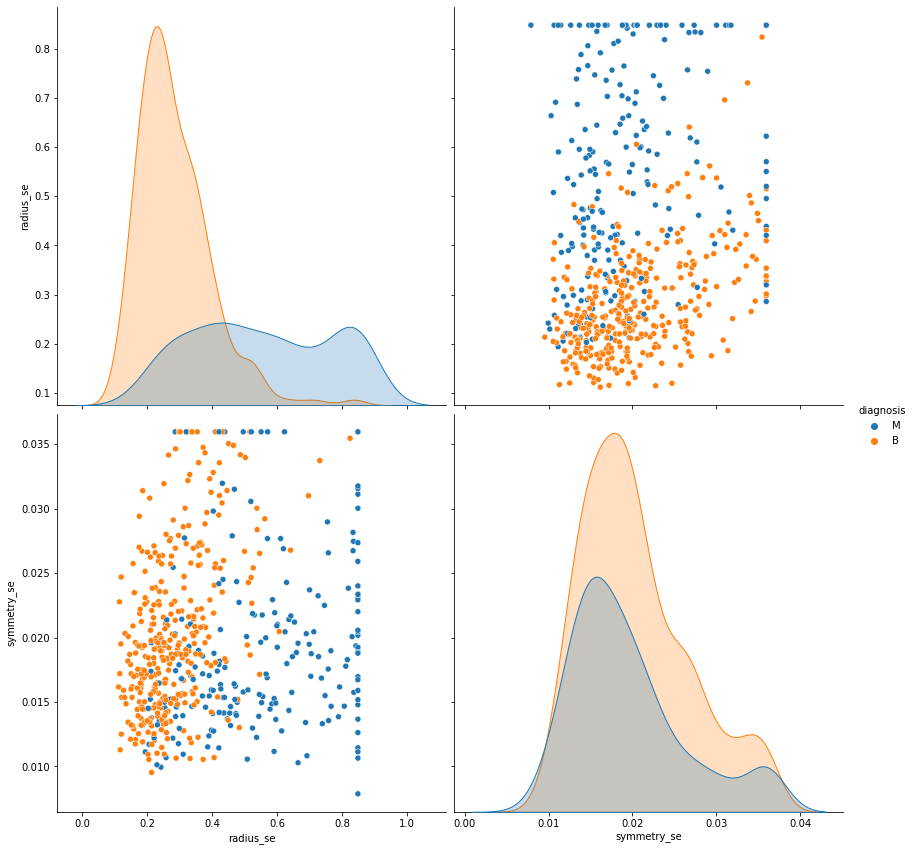

In [256]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'symmetry_se'], height=6, aspect=1 )

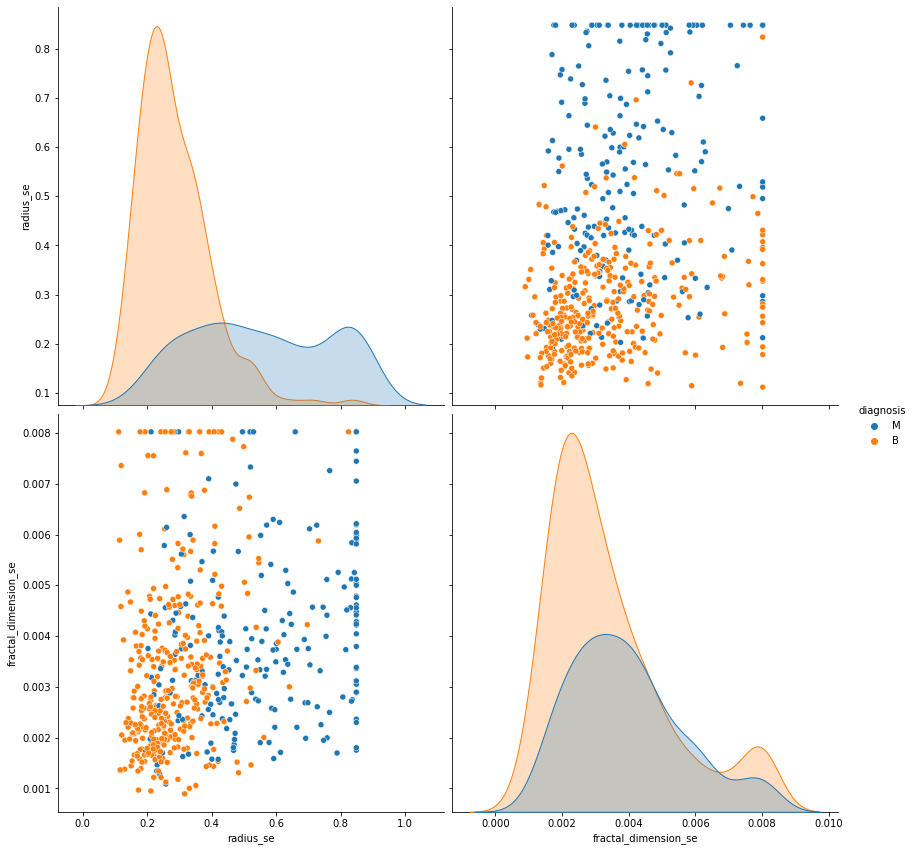

In [257]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'fractal_dimension_se'], height=6, aspect=1 )

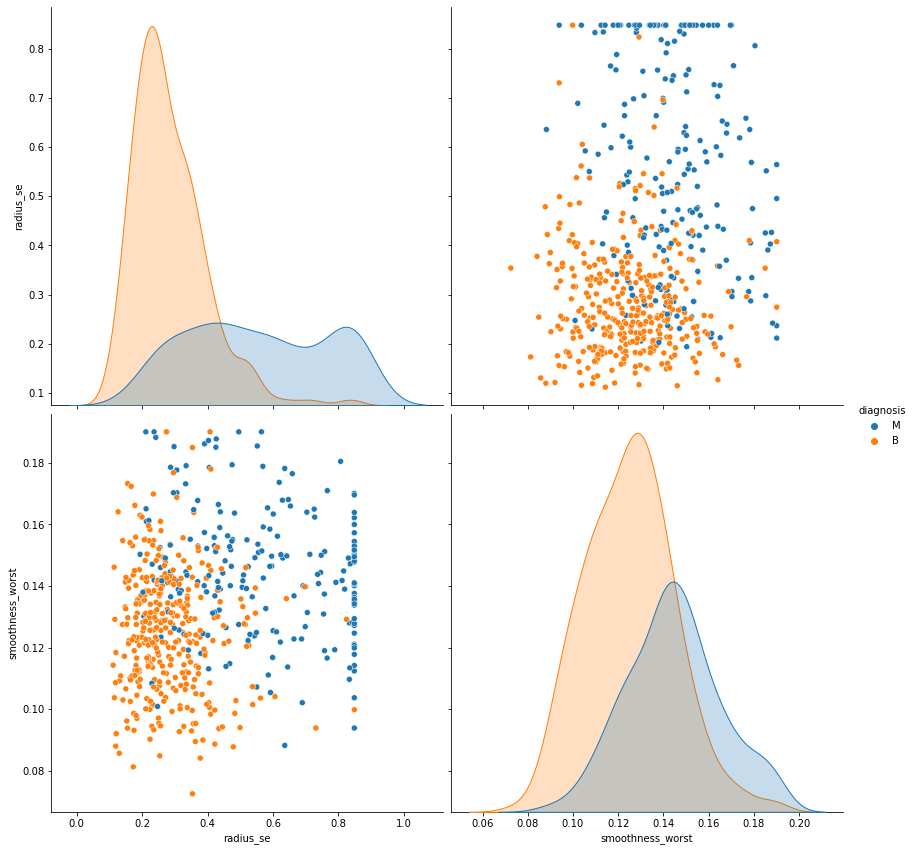

In [258]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'smoothness_worst'], height=6, aspect=1 )

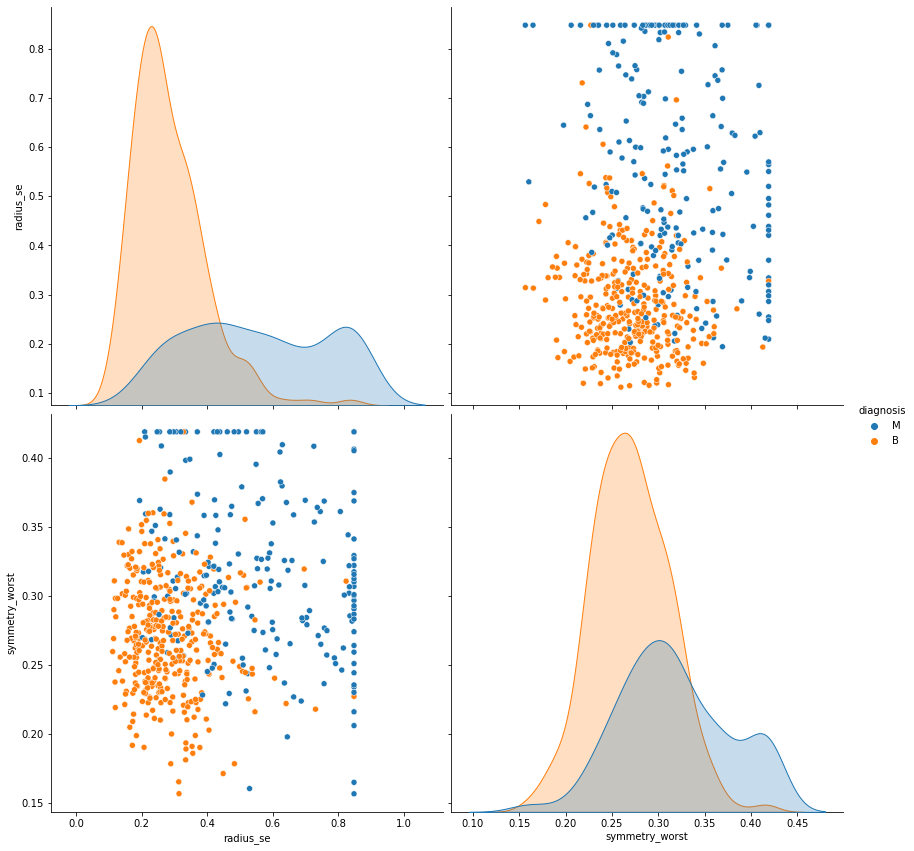

In [259]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'symmetry_worst'], height=6, aspect=1 )

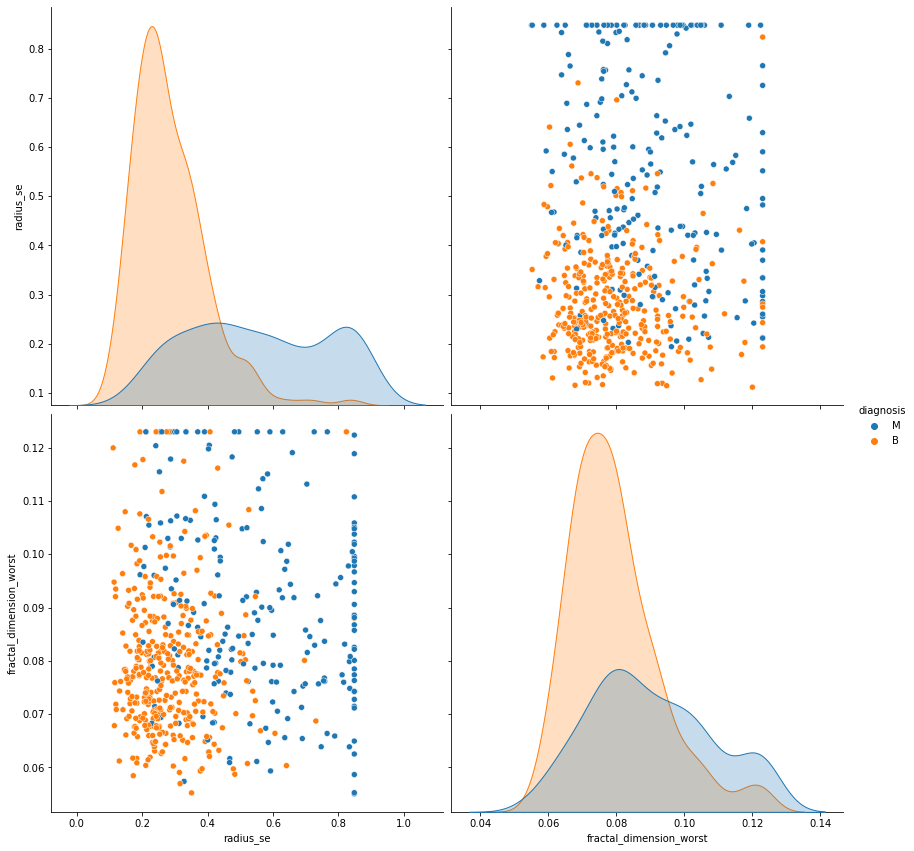

In [260]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'fractal_dimension_worst'], height=6, aspect=1 )

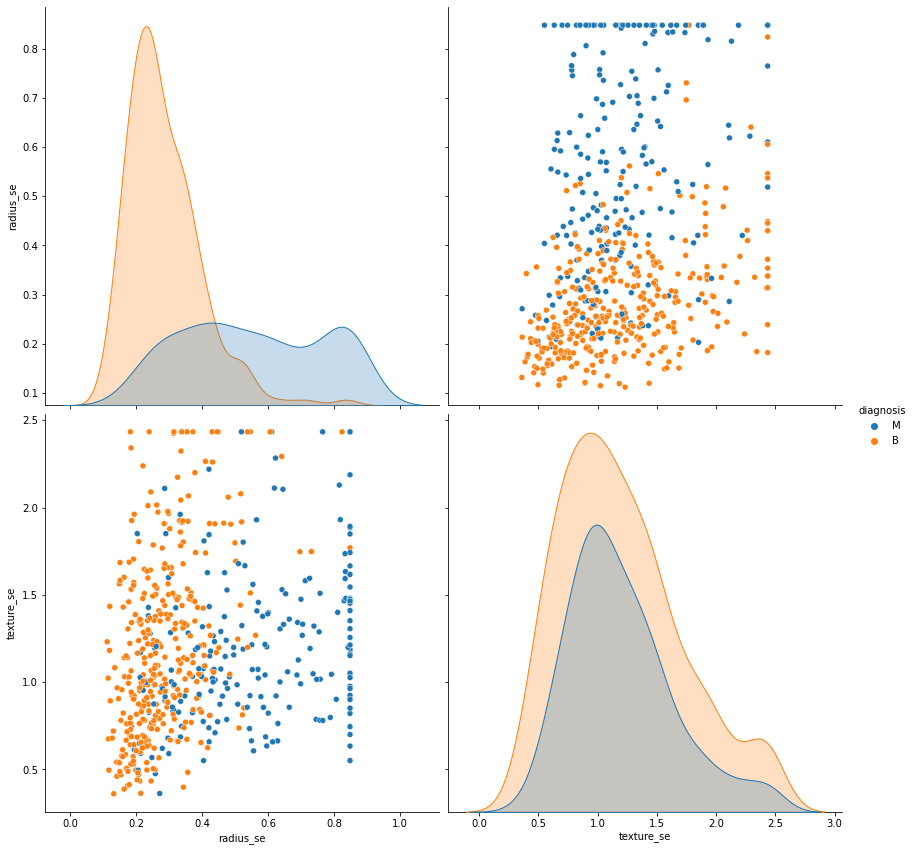

In [261]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'texture_se'], height=6, aspect=1 )

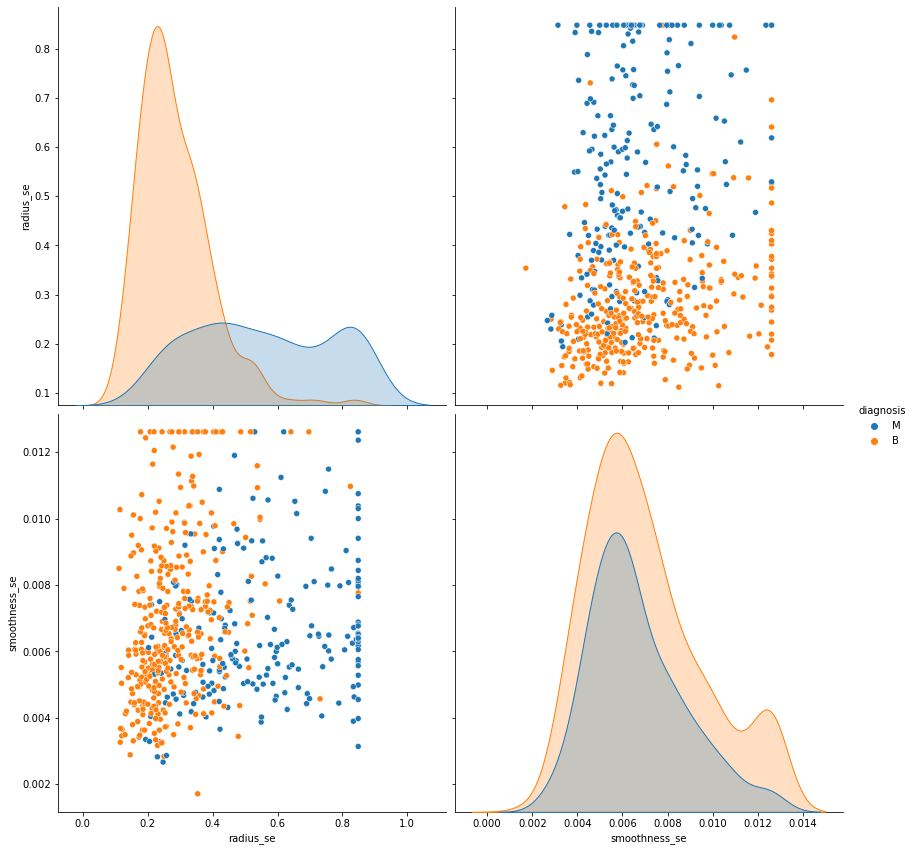

In [262]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'smoothness_se'], height=6, aspect=1 )

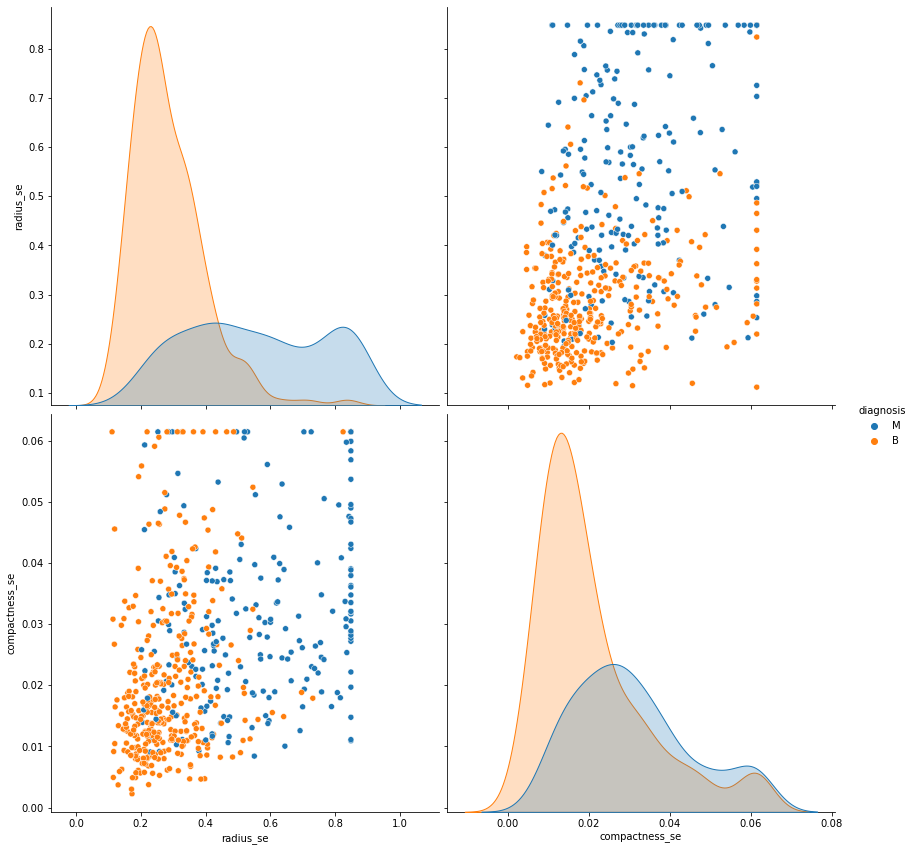

In [263]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'compactness_se'], height=6, aspect=1 )

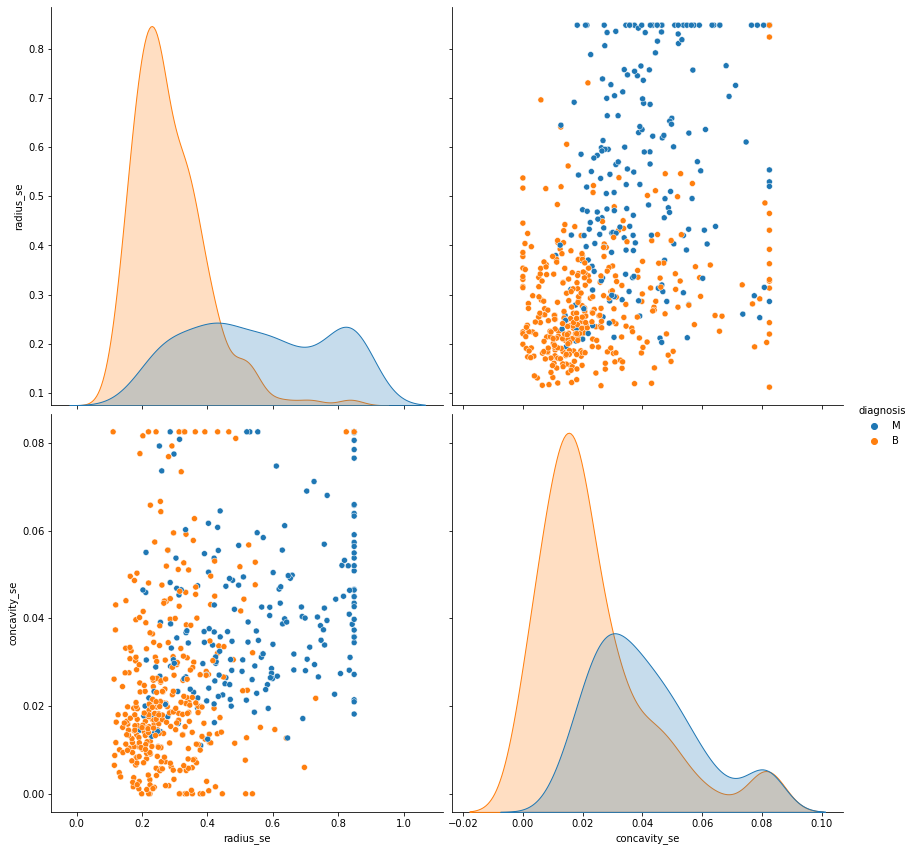

In [264]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'concavity_se'], height=6, aspect=1 )

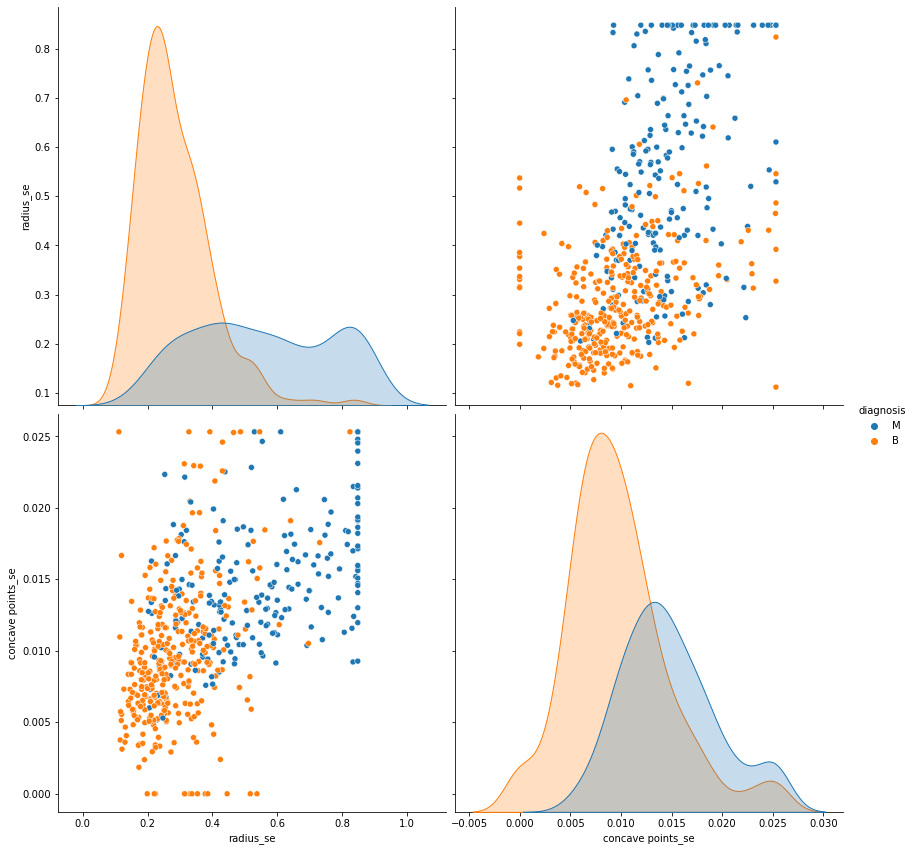

In [265]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'concave points_se'], height=6, aspect=1 )

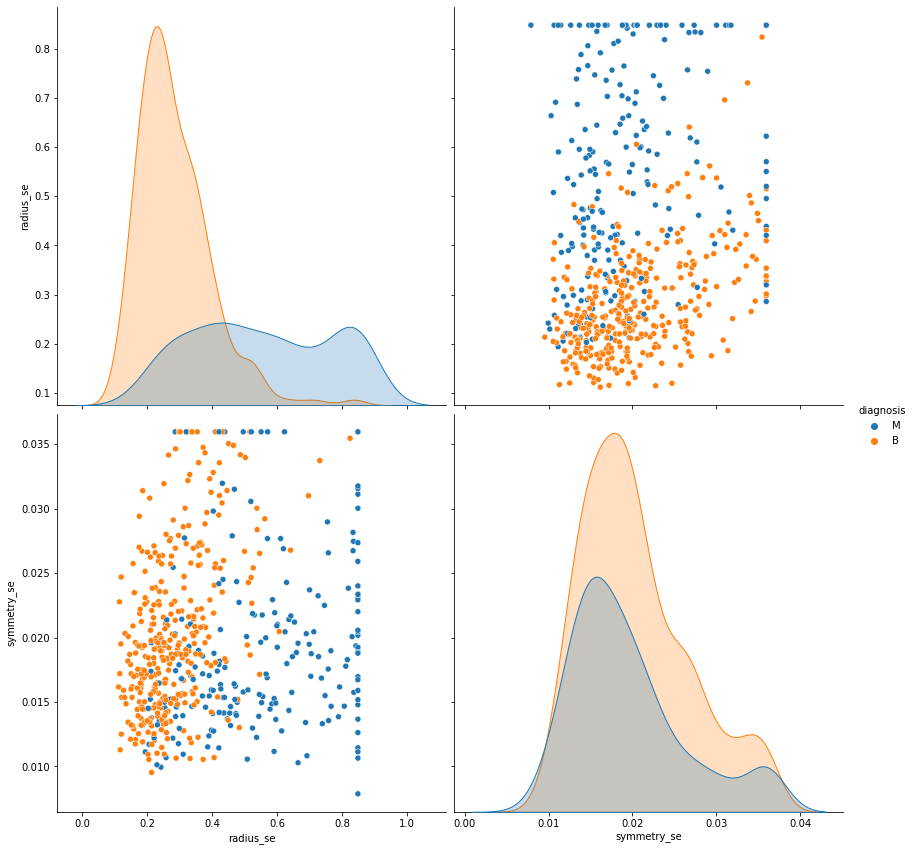

In [266]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'symmetry_se'], height=6, aspect=1 )

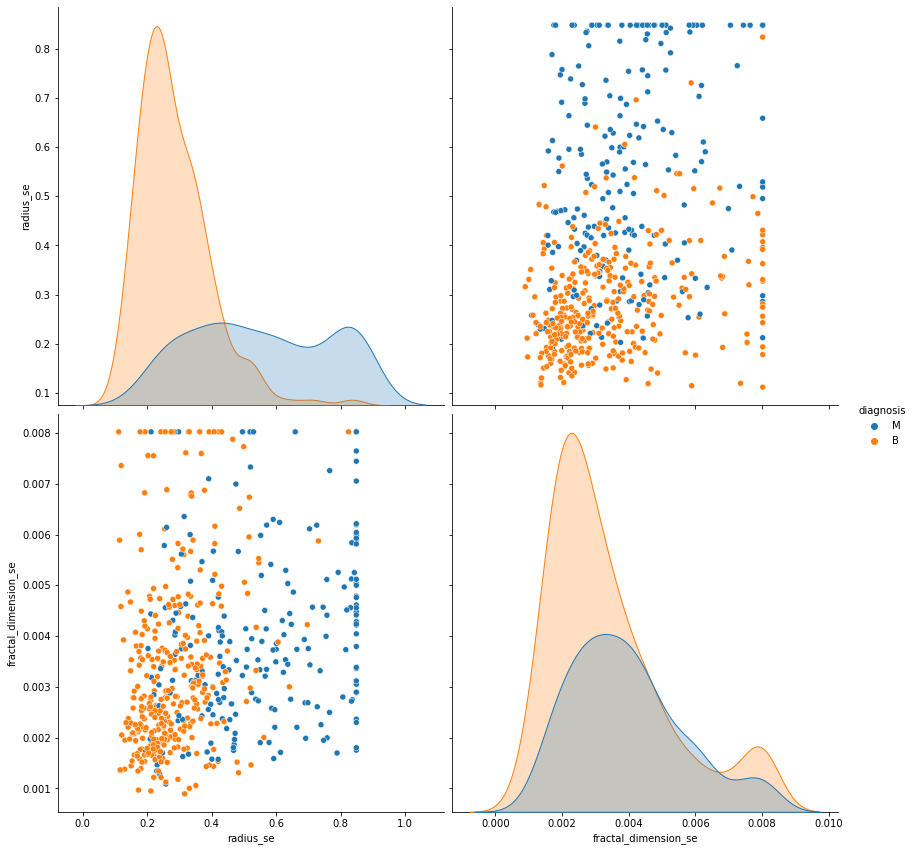

In [267]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'fractal_dimension_se'], height=6, aspect=1 )

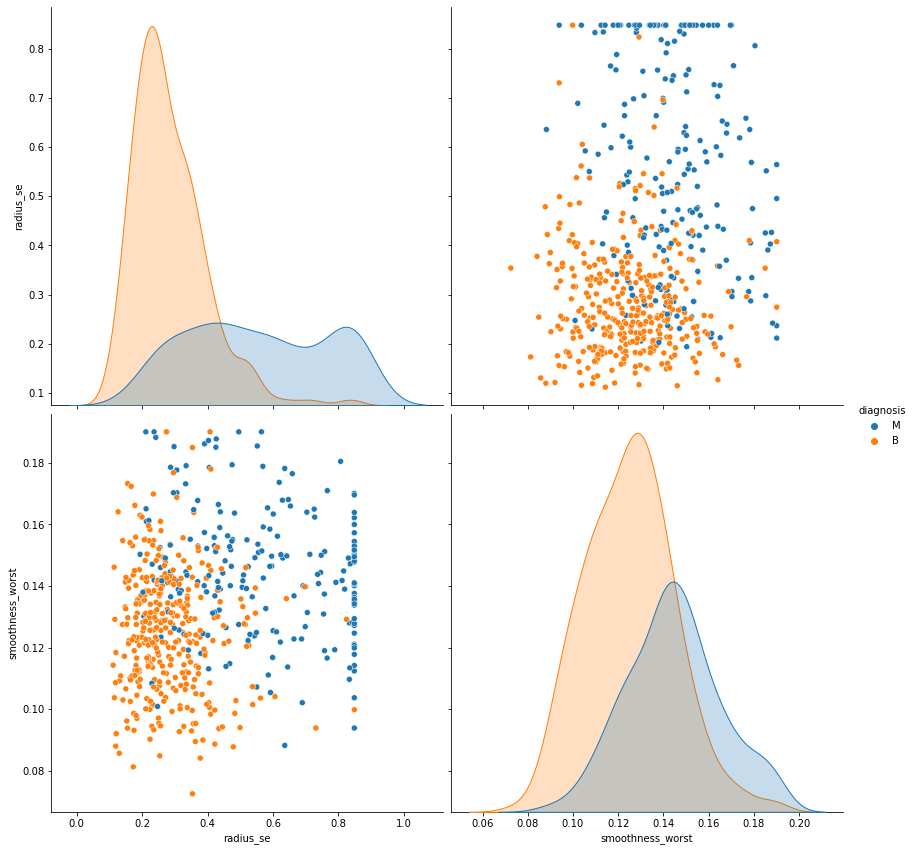

In [268]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'smoothness_worst'], height=6, aspect=1 )

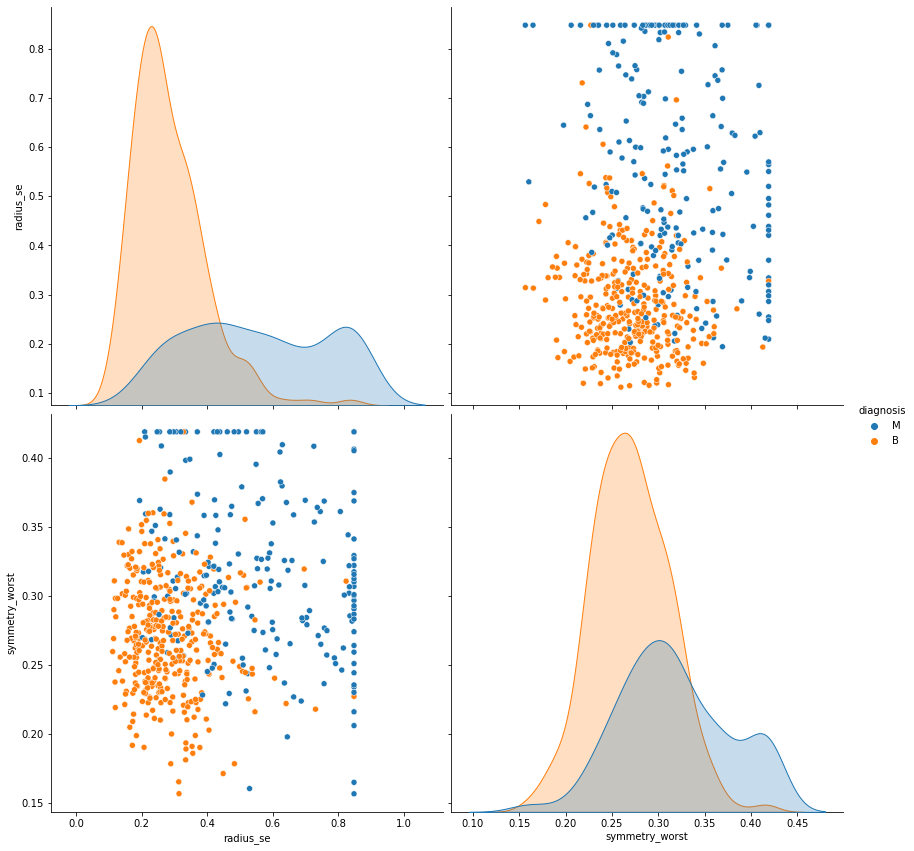

In [269]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'symmetry_worst'], height=6, aspect=1 )

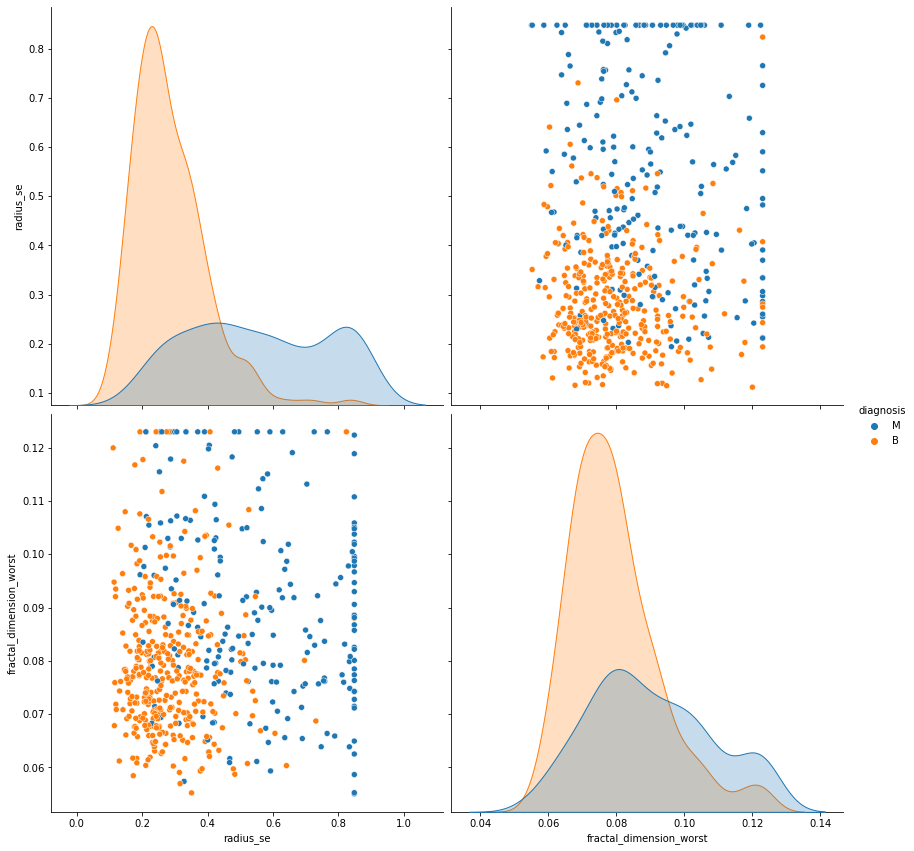

In [270]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'fractal_dimension_worst'], height=6, aspect=1 )

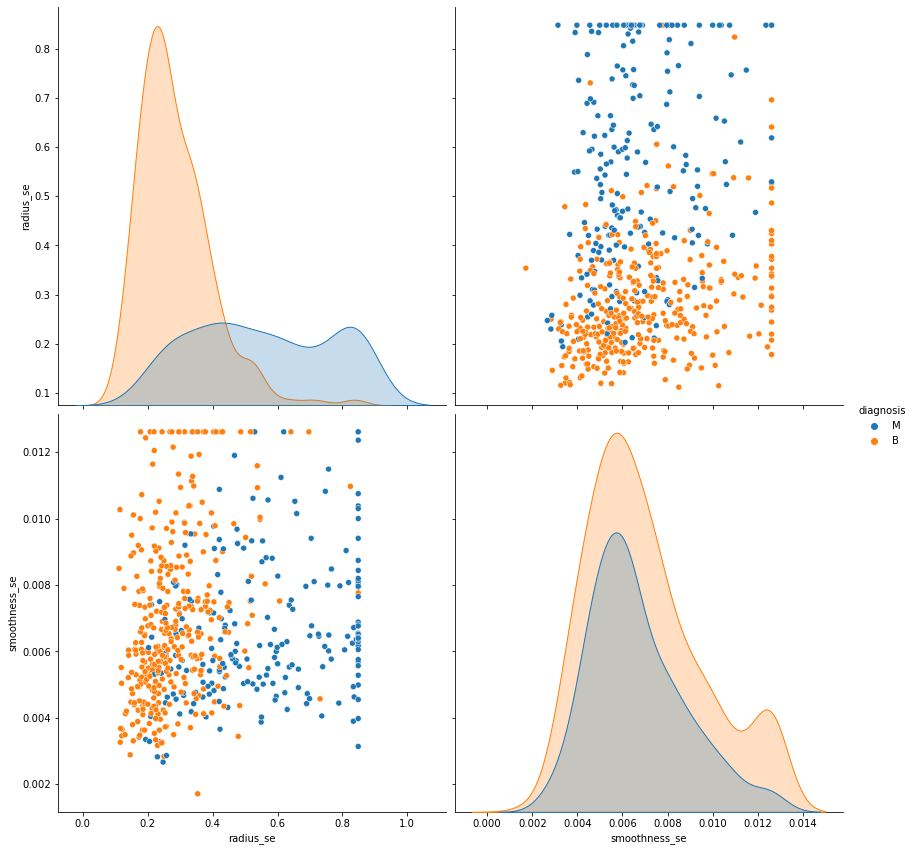

In [271]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'smoothness_se'], height=6, aspect=1 )

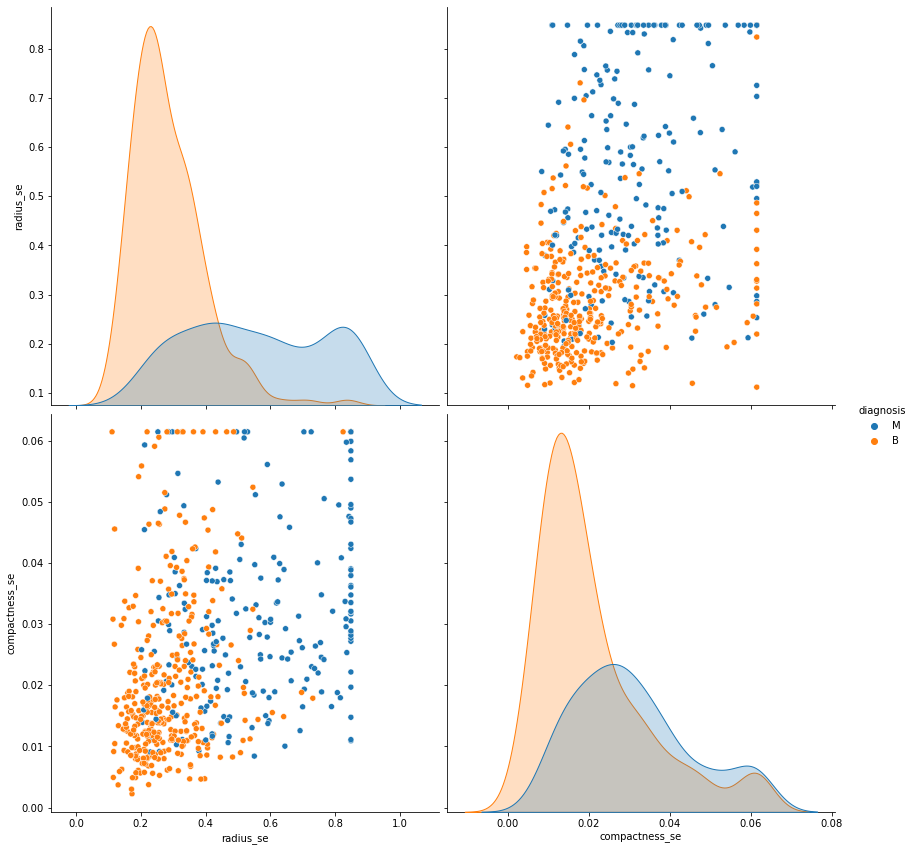

In [272]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'compactness_se'], height=6, aspect=1 )

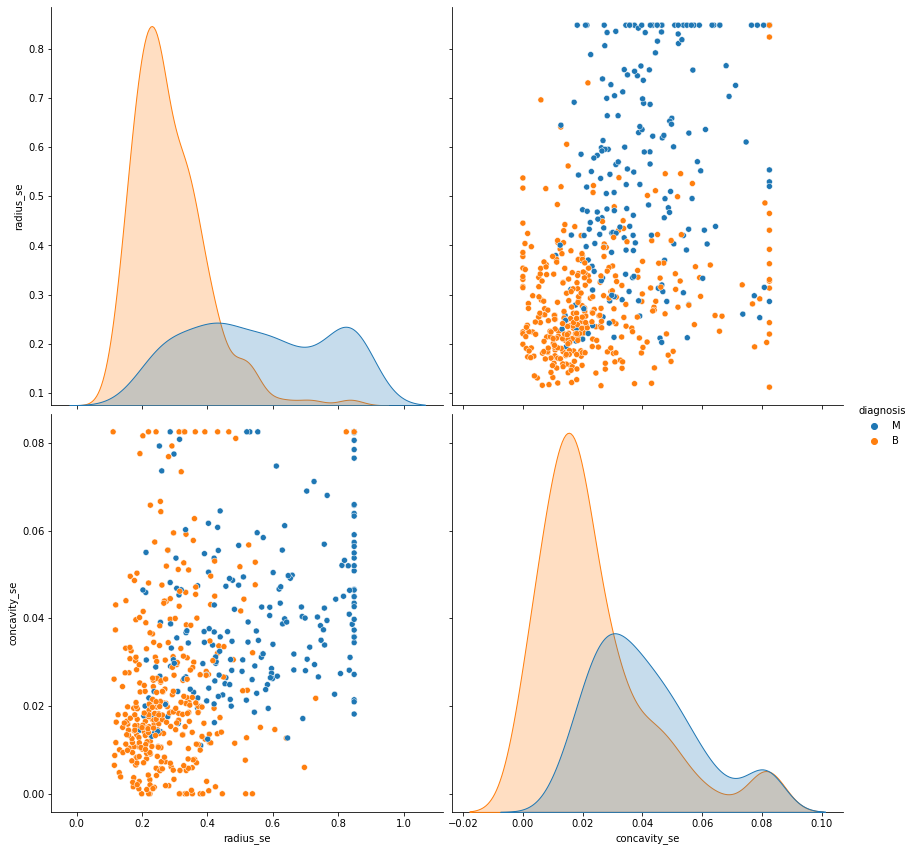

In [273]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'concavity_se'], height=6, aspect=1 )

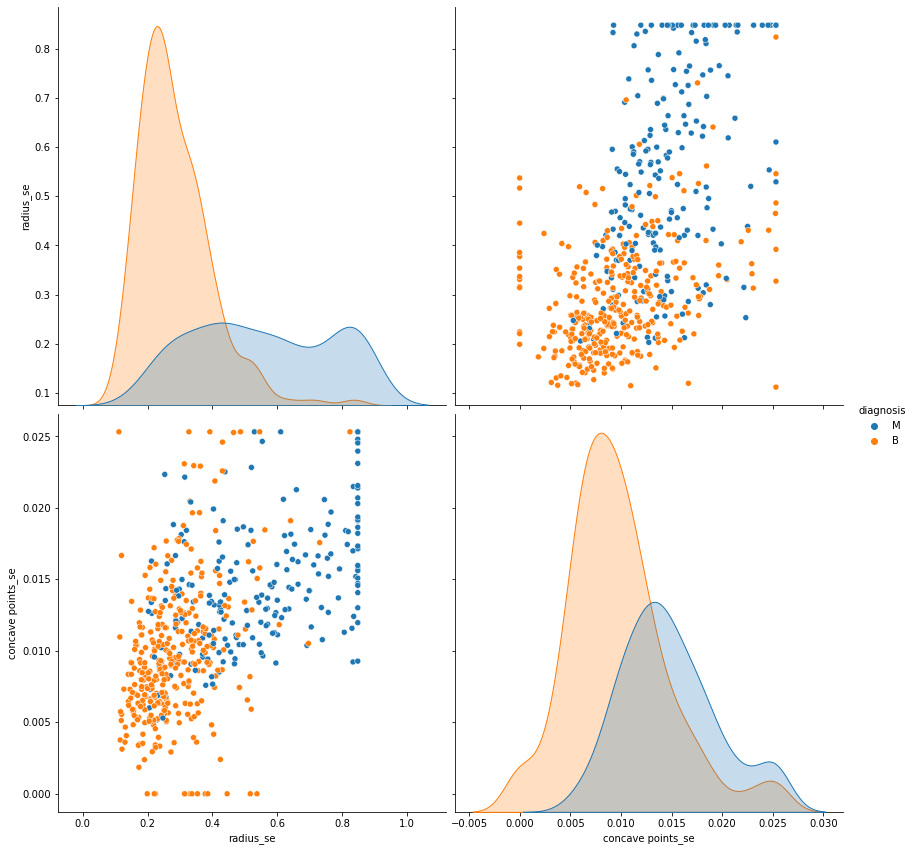

In [274]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'concave points_se'], height=6, aspect=1 )

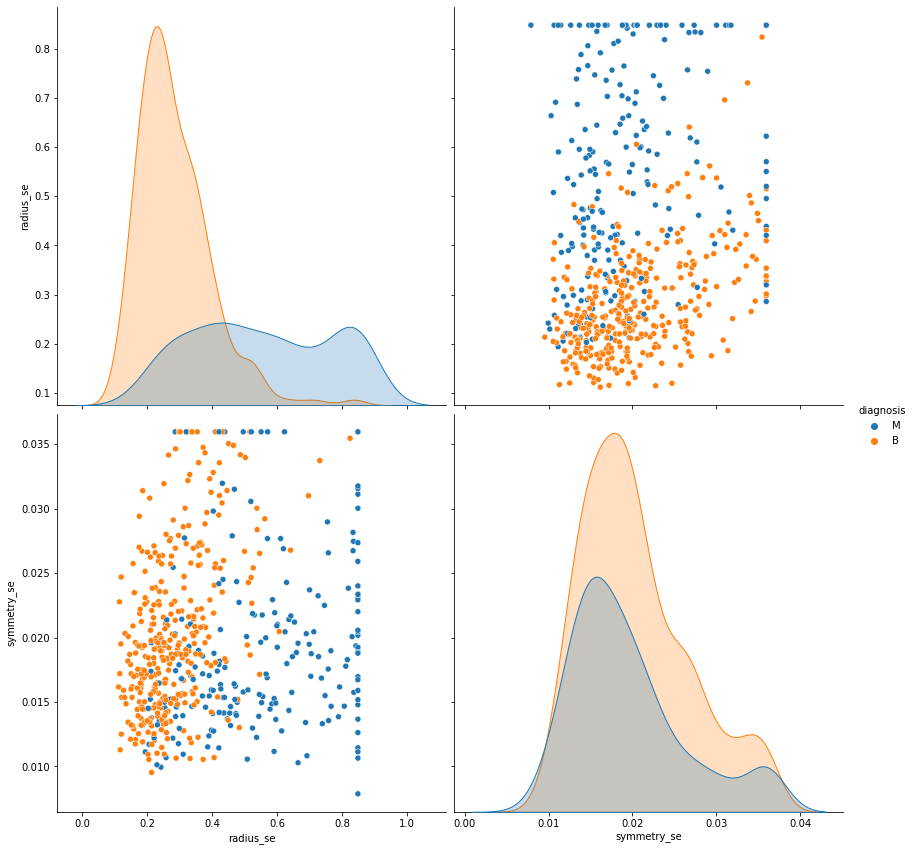

In [275]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'symmetry_se'], height=6, aspect=1 )

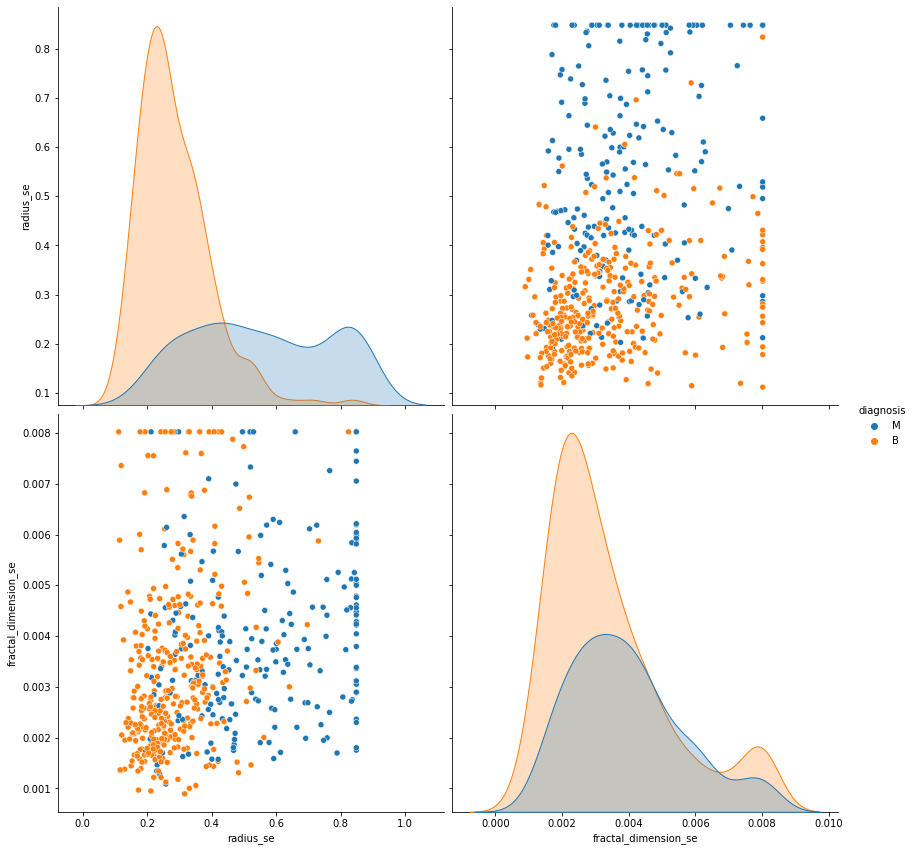

In [276]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'fractal_dimension_se'], height=6, aspect=1 )

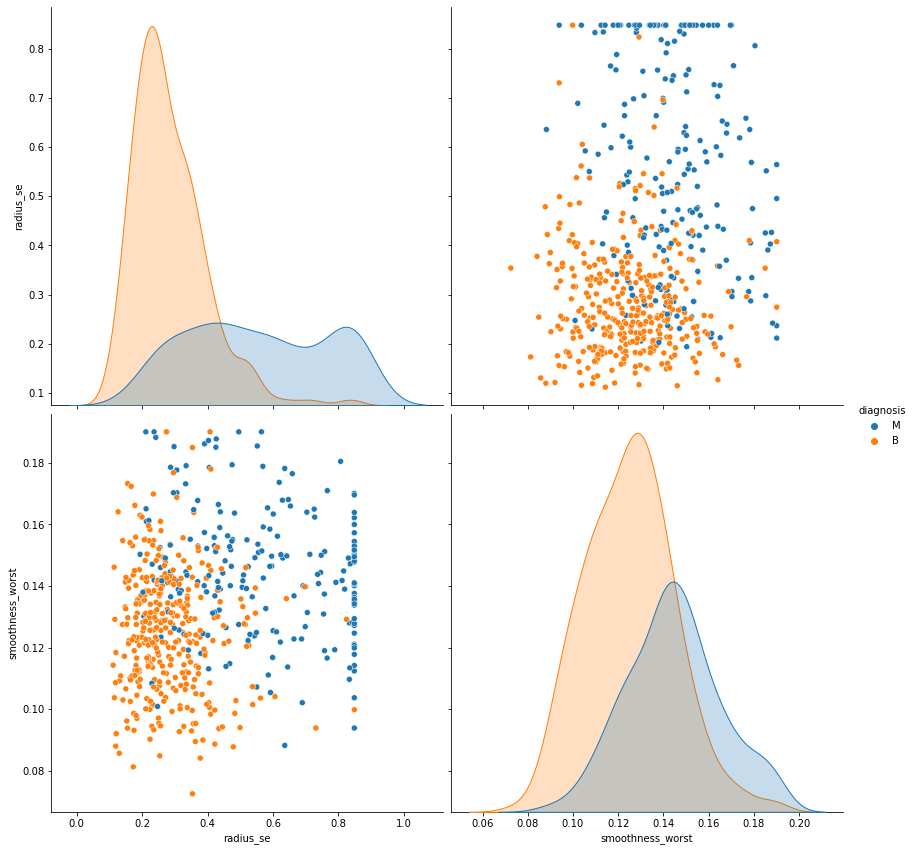

In [277]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'smoothness_worst'], height=6, aspect=1 )

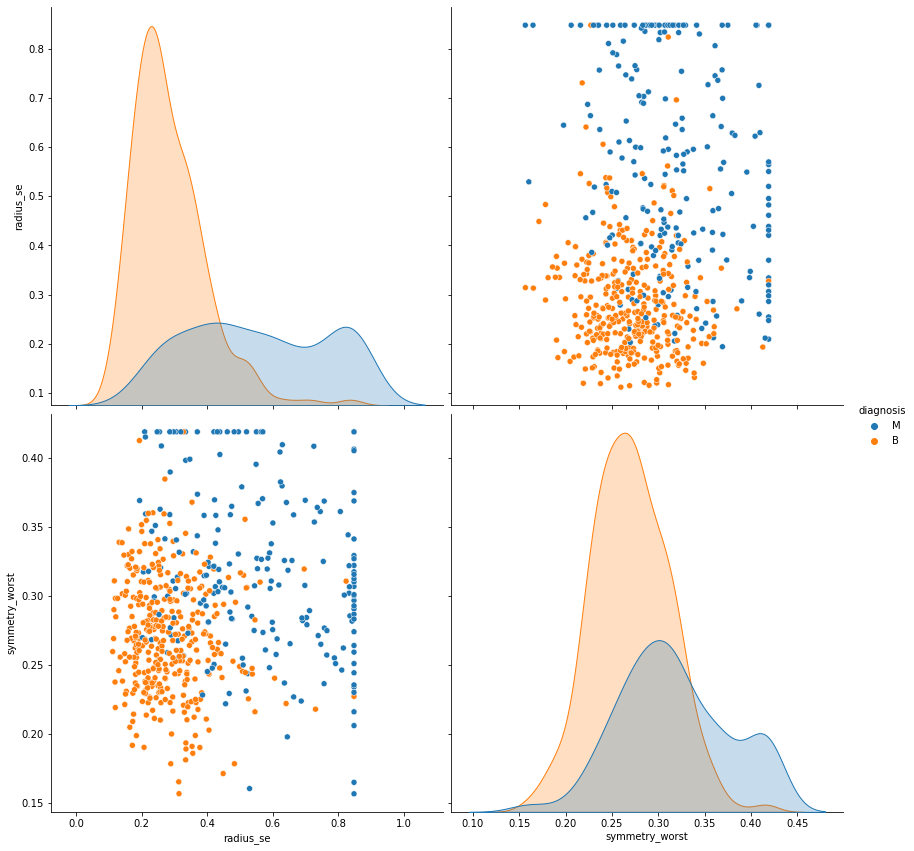

In [278]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'symmetry_worst'], height=6, aspect=1 )

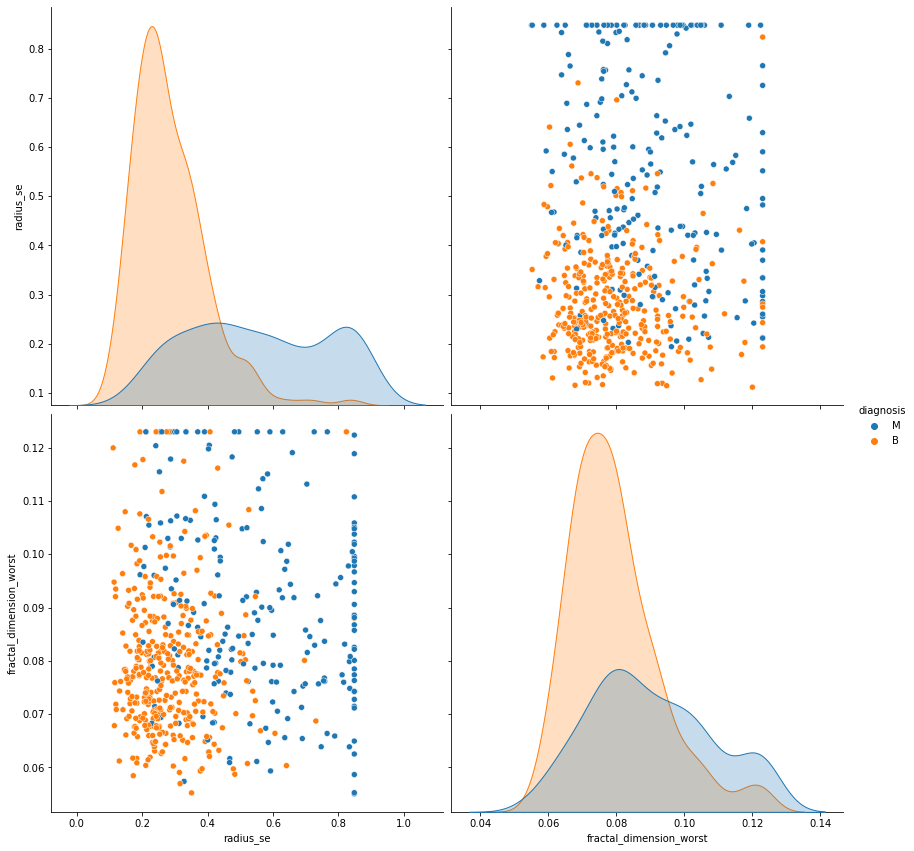

In [279]:
sns.pairplot(df, hue ='diagnosis', vars=['radius_se', 'fractal_dimension_worst'], height=6, aspect=1 )

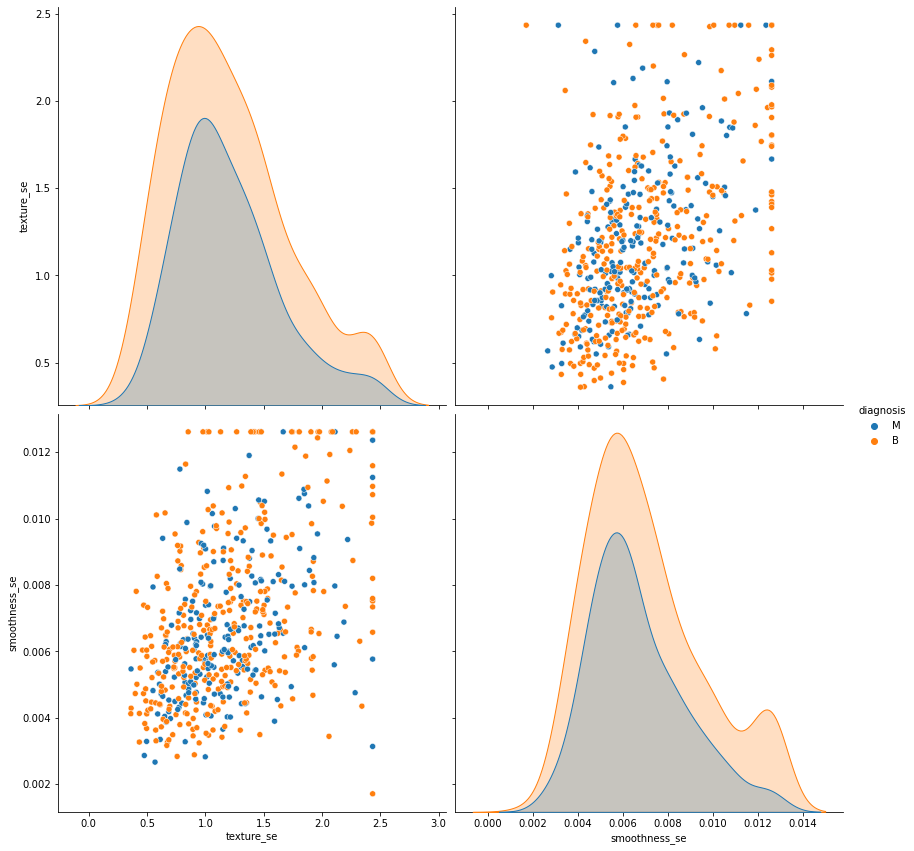

In [280]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'smoothness_se'], height=6, aspect=1 )

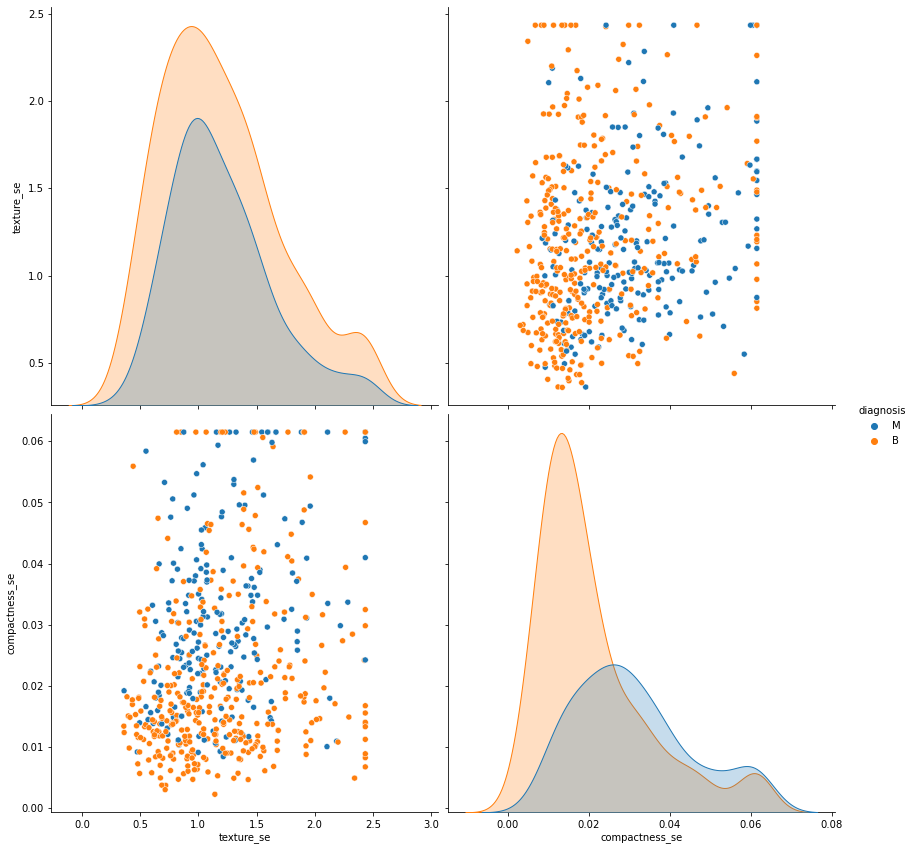

In [281]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'compactness_se'], height=6, aspect=1 )

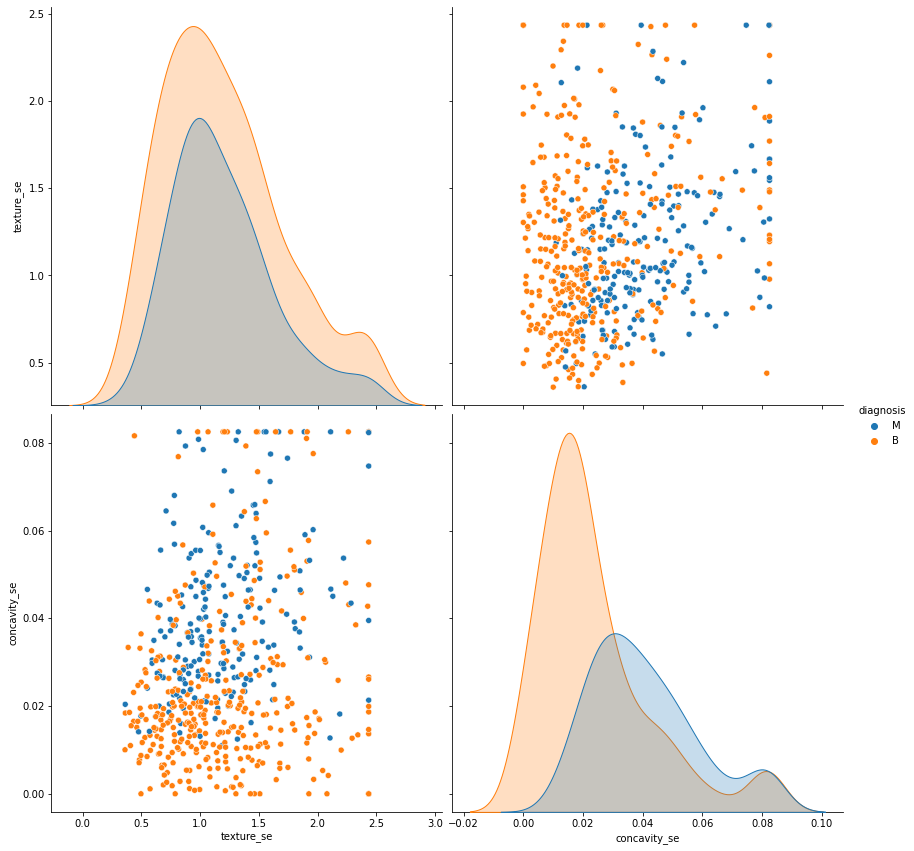

In [282]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'concavity_se'], height=6, aspect=1 )

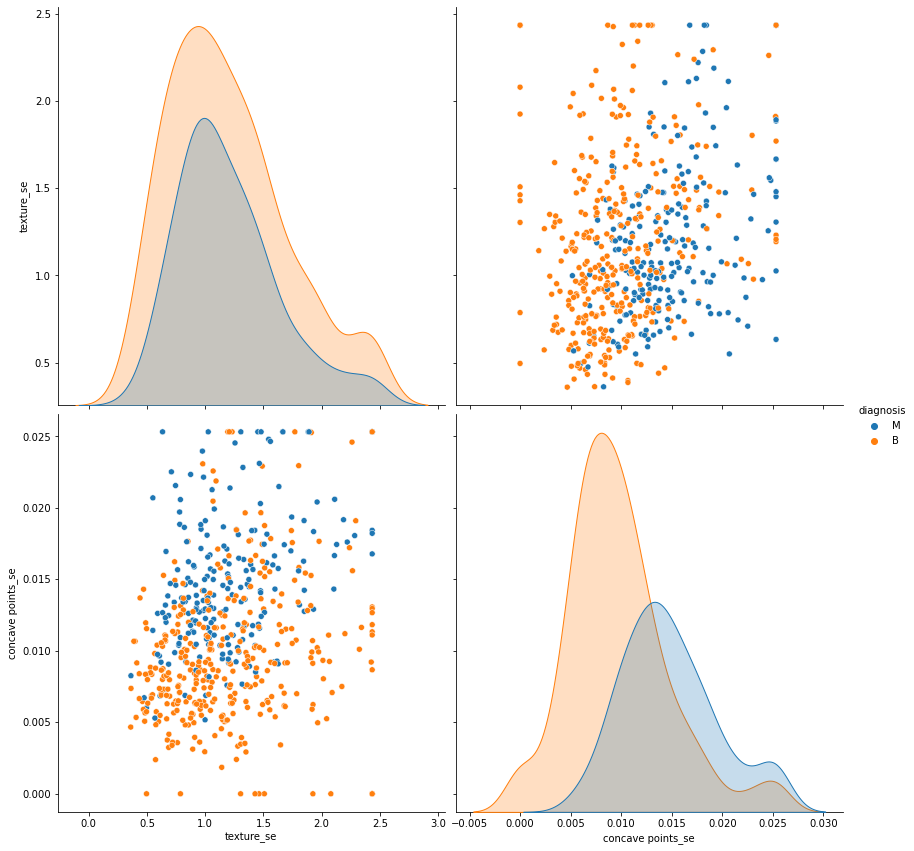

In [283]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'concave points_se'], height=6, aspect=1 )

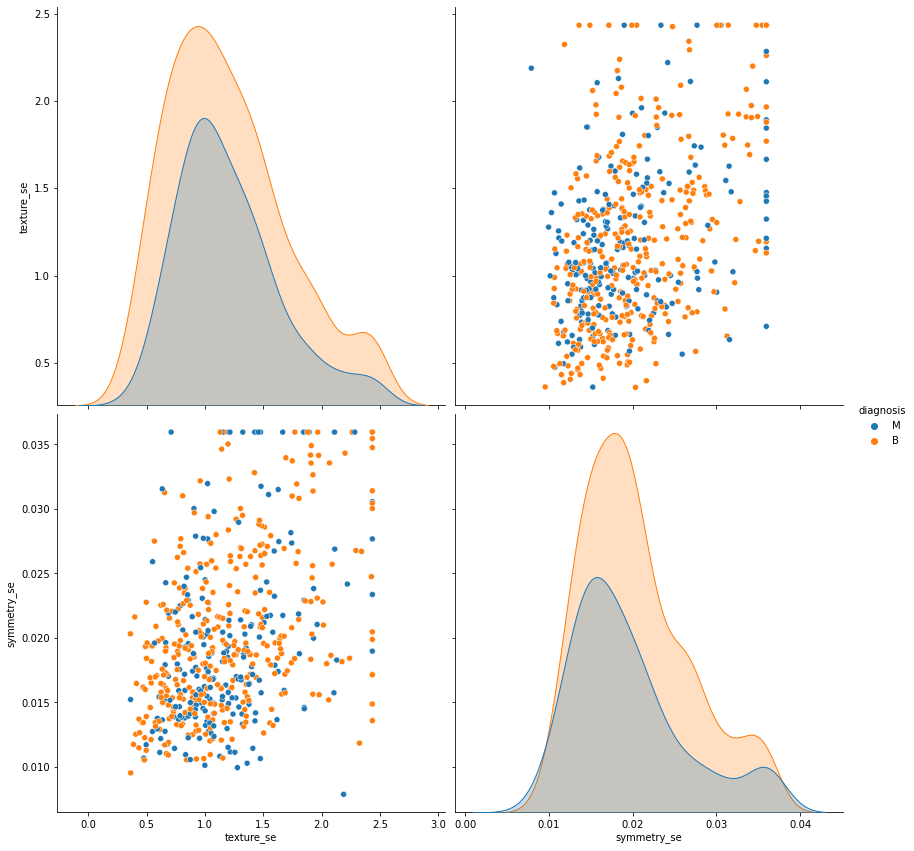

In [284]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'symmetry_se'], height=6, aspect=1 )

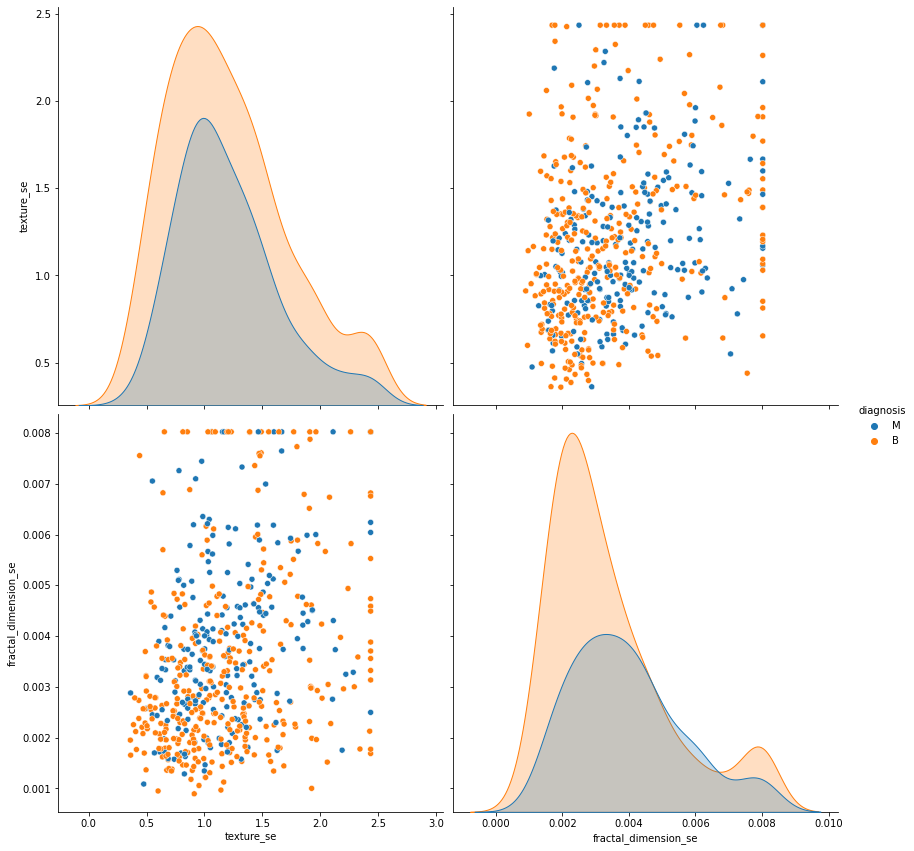

In [285]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'fractal_dimension_se'], height=6, aspect=1 )

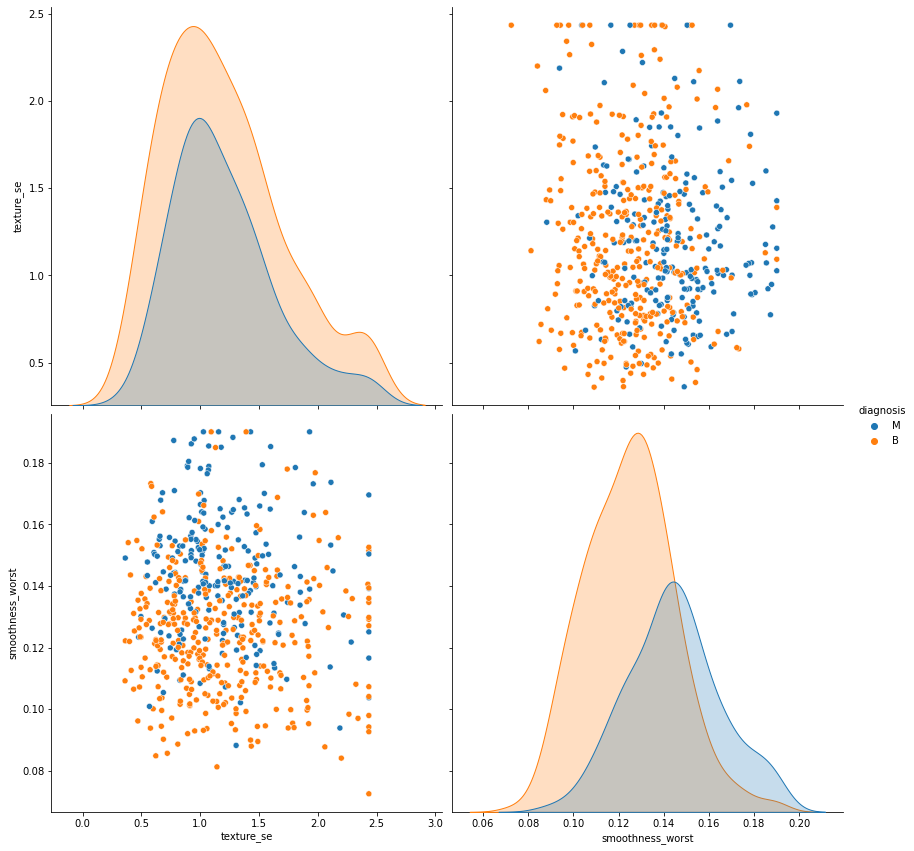

In [286]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'smoothness_worst'], height=6, aspect=1 )

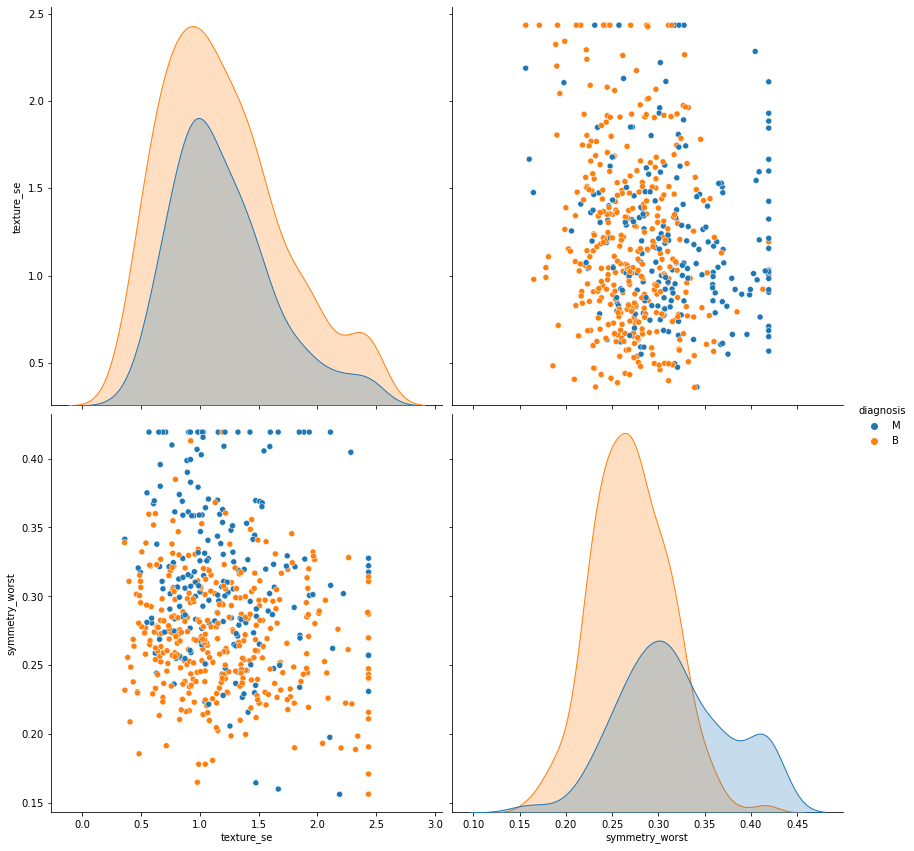

In [287]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'symmetry_worst'], height=6, aspect=1 )

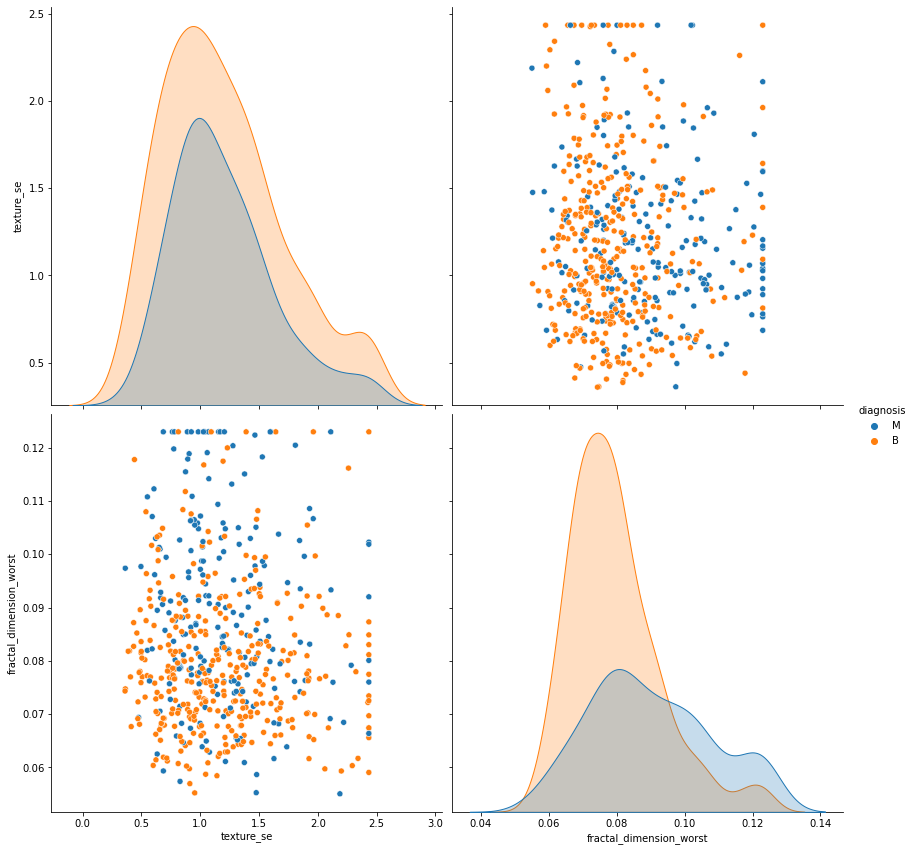

In [288]:
sns.pairplot(df, hue ='diagnosis', vars=['texture_se', 'fractal_dimension_worst'], height=6, aspect=1 )

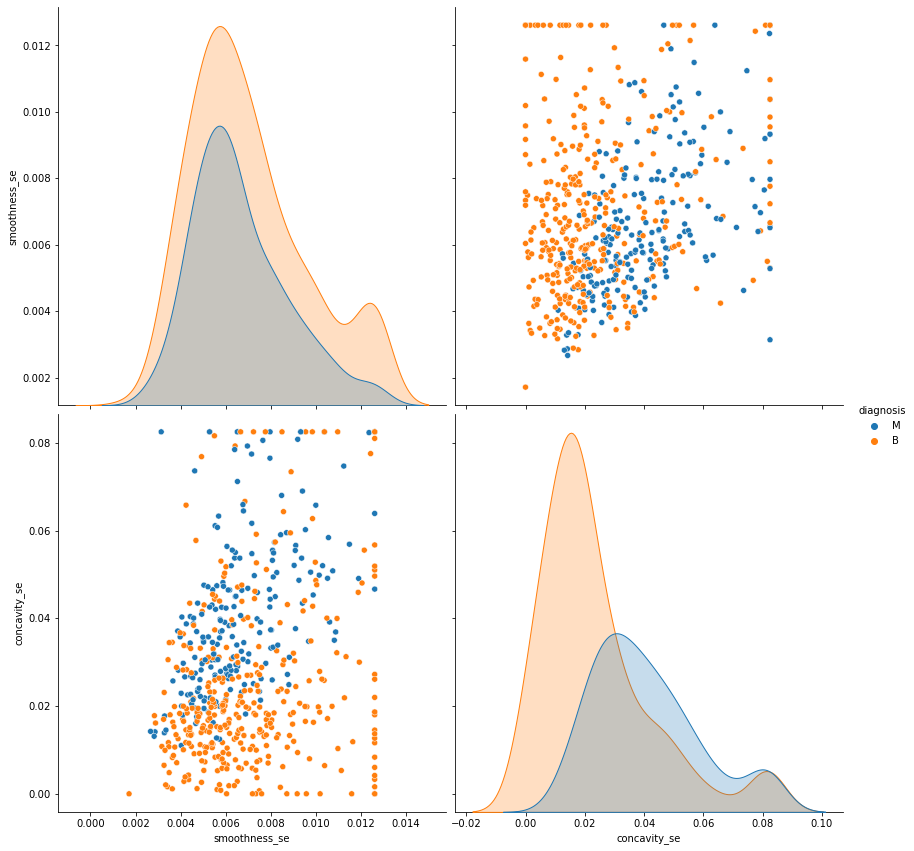

In [289]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'concavity_se'], height=6, aspect=1 )

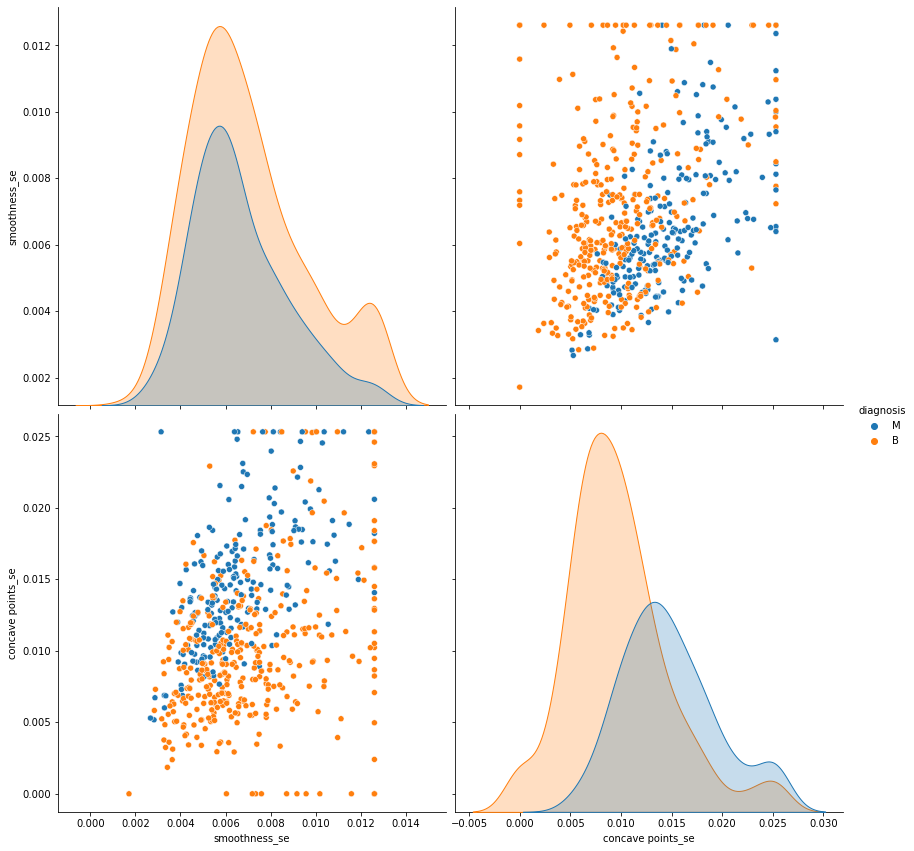

In [290]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'concave points_se'], height=6, aspect=1 )

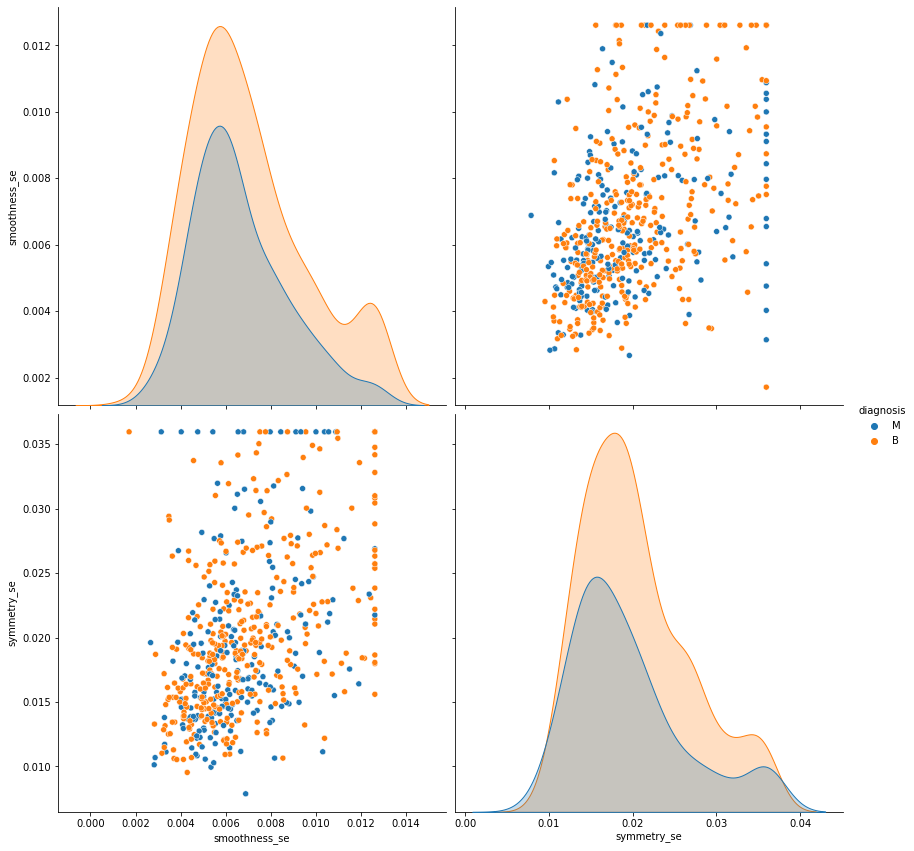

In [291]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'symmetry_se'], height=6, aspect=1 )

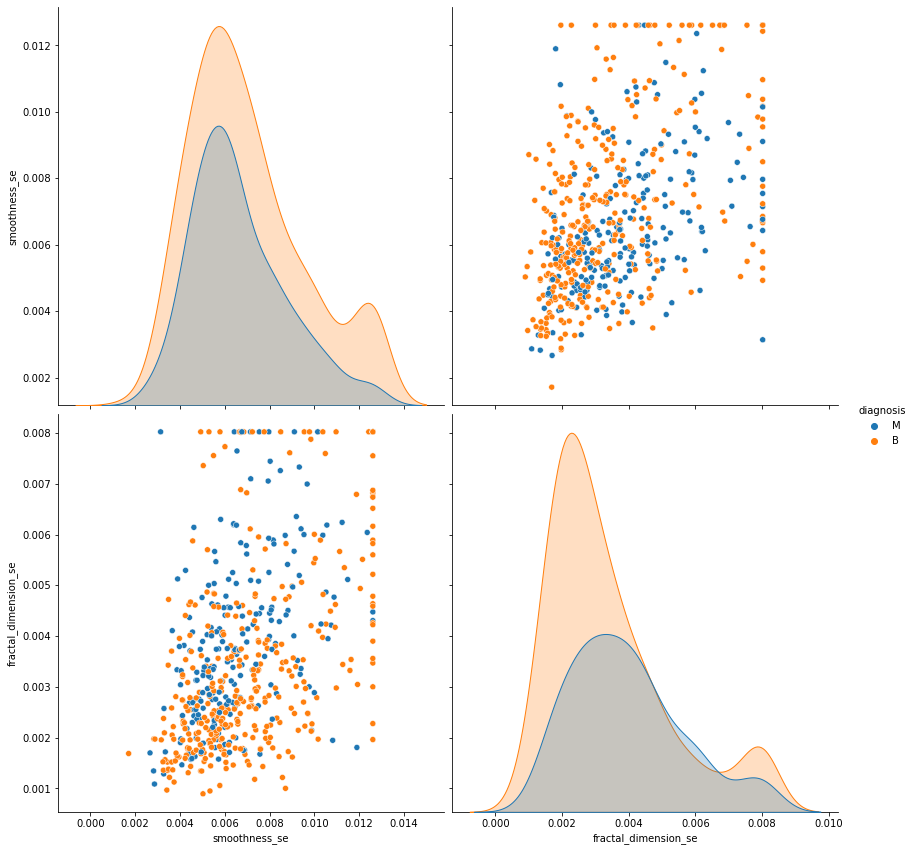

In [292]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'fractal_dimension_se'], height=6, aspect=1 )

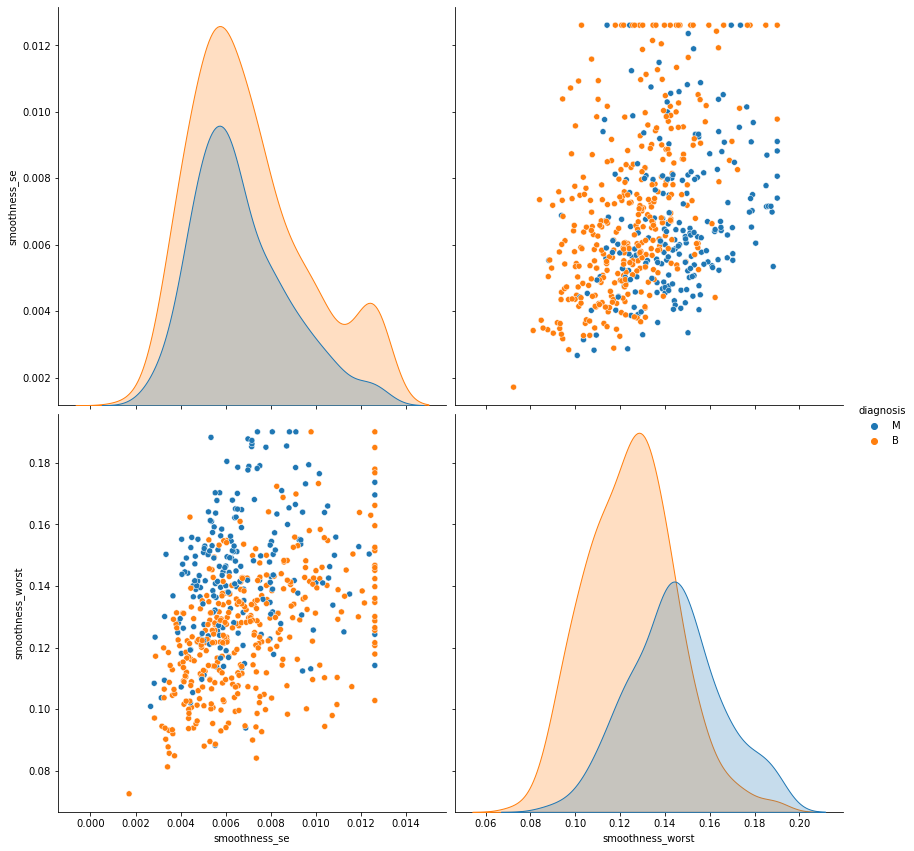

In [293]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'smoothness_worst'], height=6, aspect=1 )

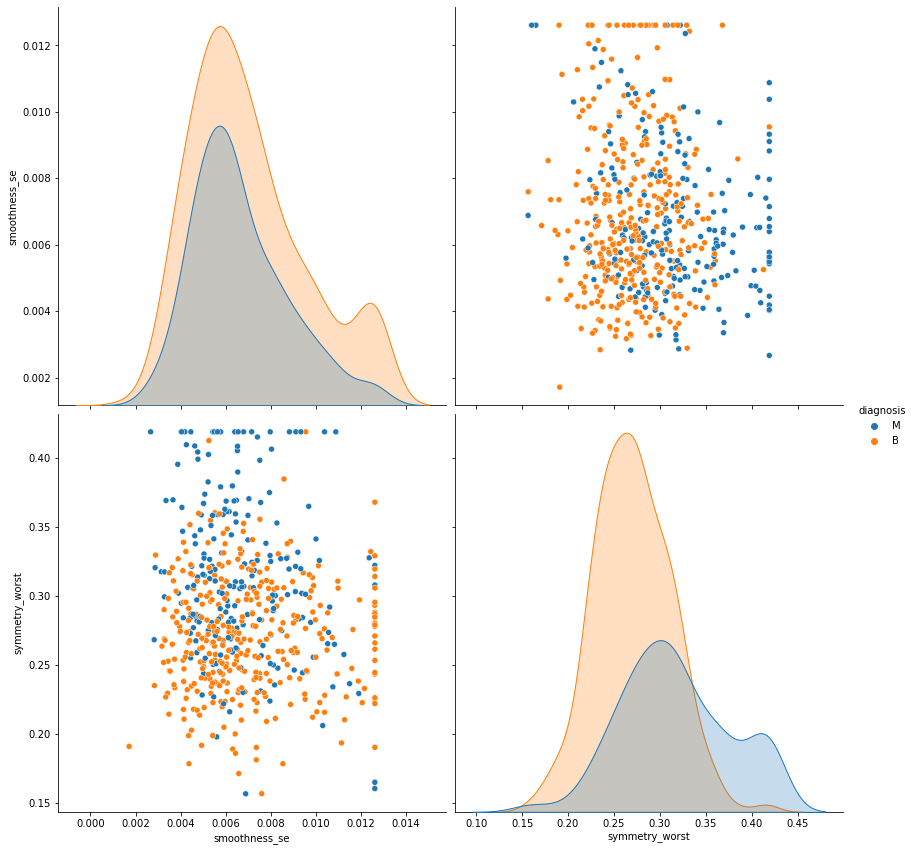

In [294]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'symmetry_worst'], height=6, aspect=1 )

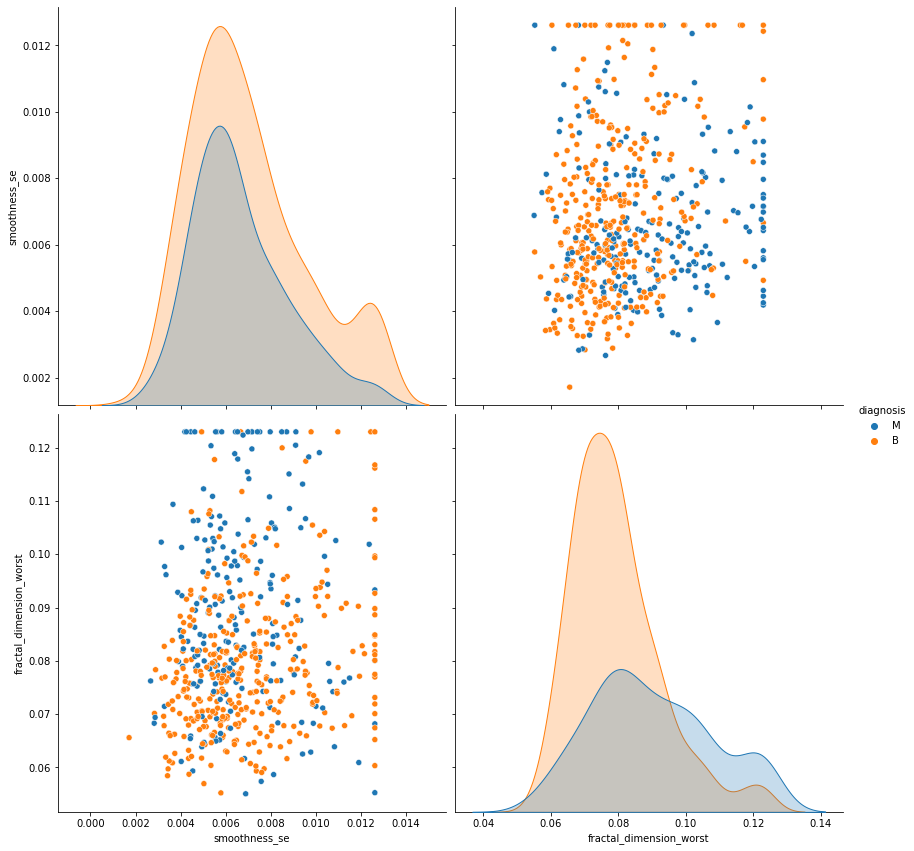

In [295]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_se', 'fractal_dimension_worst'], height=6, aspect=1 )

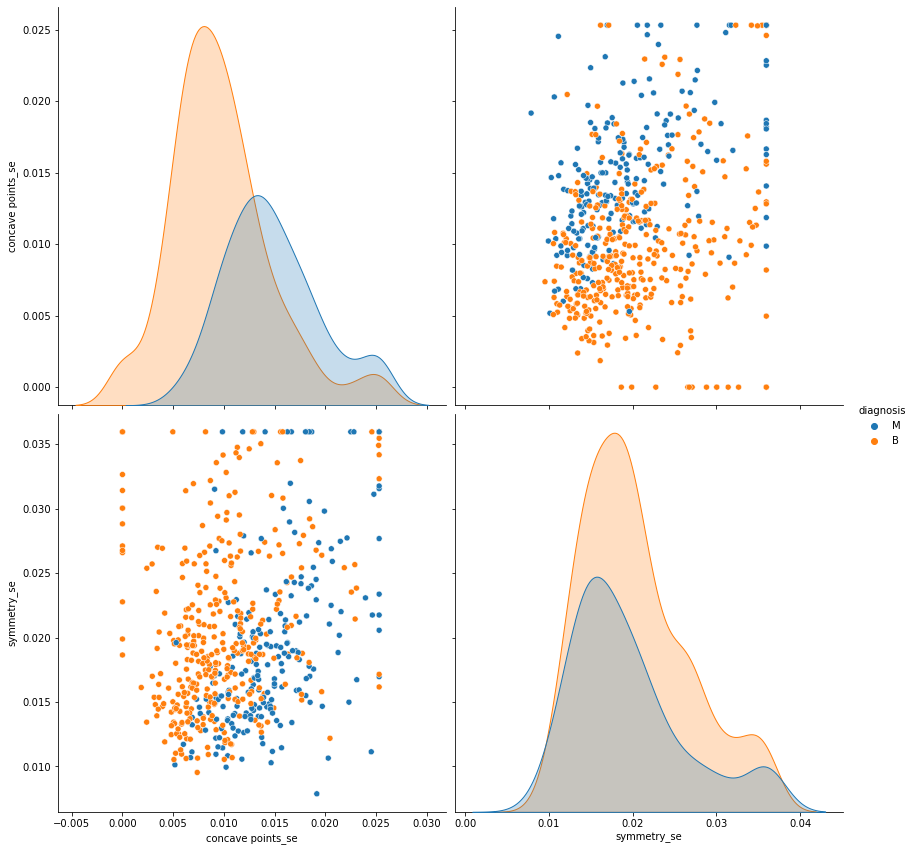

In [296]:
sns.pairplot(df, hue ='diagnosis', vars=['concave points_se', 'symmetry_se'], height=6, aspect=1 )

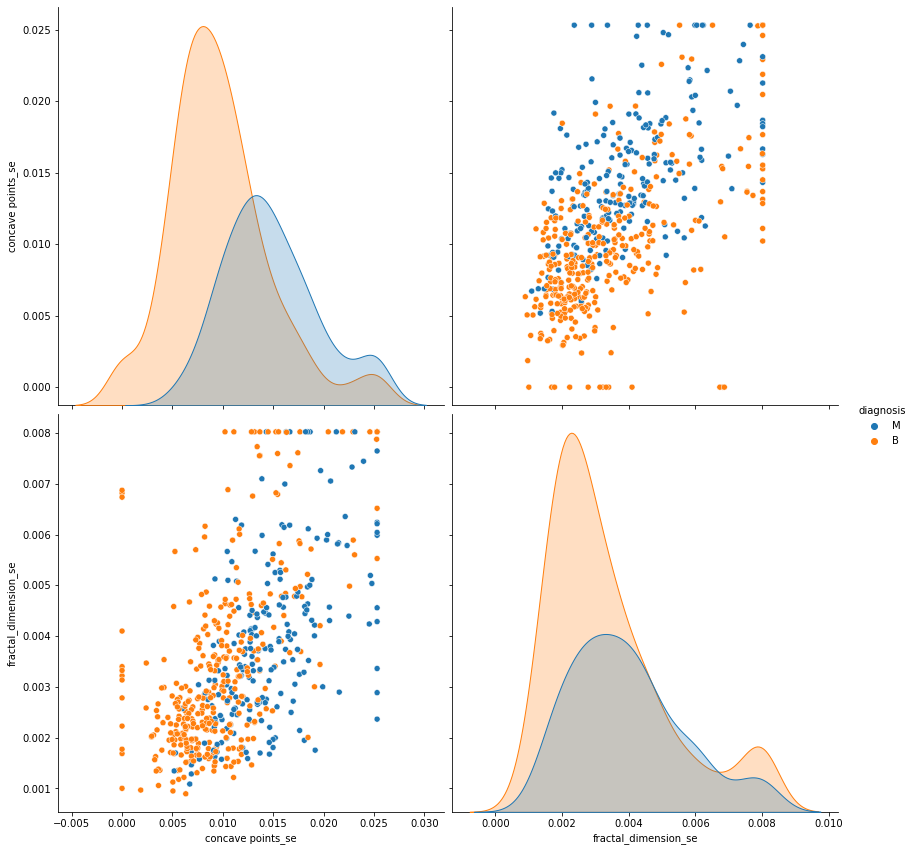

In [297]:
sns.pairplot(df, hue ='diagnosis', vars=['concave points_se', 'fractal_dimension_se'], height=6, aspect=1 )

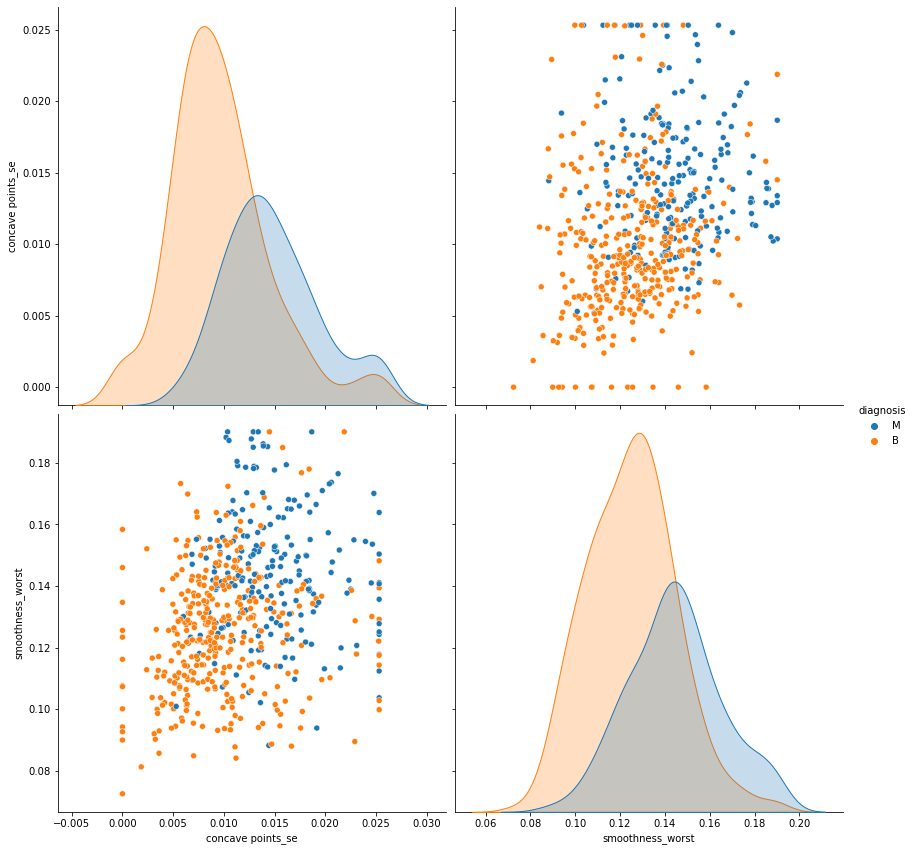

In [298]:
sns.pairplot(df, hue ='diagnosis', vars=['concave points_se', 'smoothness_worst'], height=6, aspect=1 )

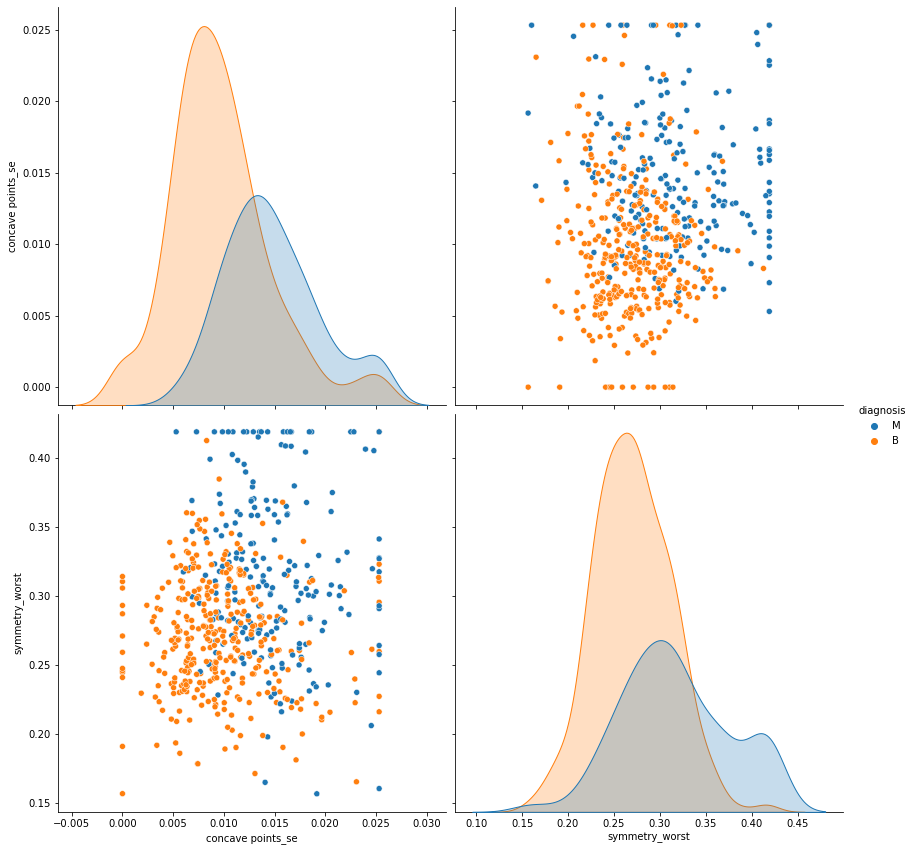

In [299]:
sns.pairplot(df, hue ='diagnosis', vars=['concave points_se', 'symmetry_worst'], height=6, aspect=1 )

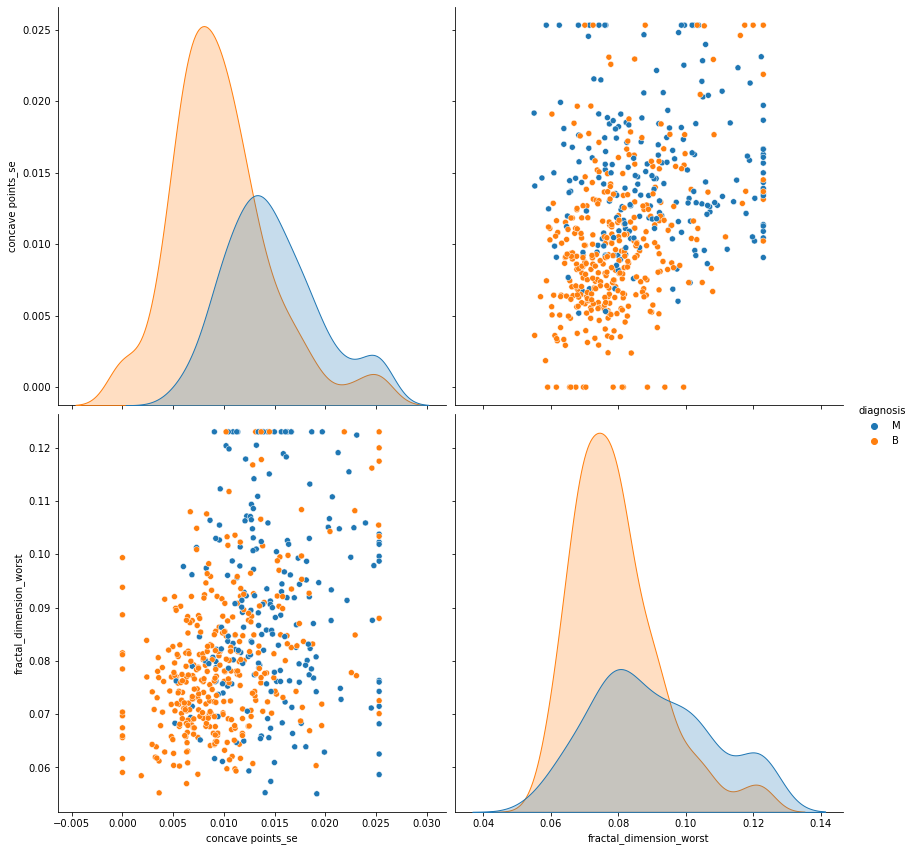

In [300]:
sns.pairplot(df, hue ='diagnosis', vars=['concave points_se', 'fractal_dimension_worst'], height=6, aspect=1 )

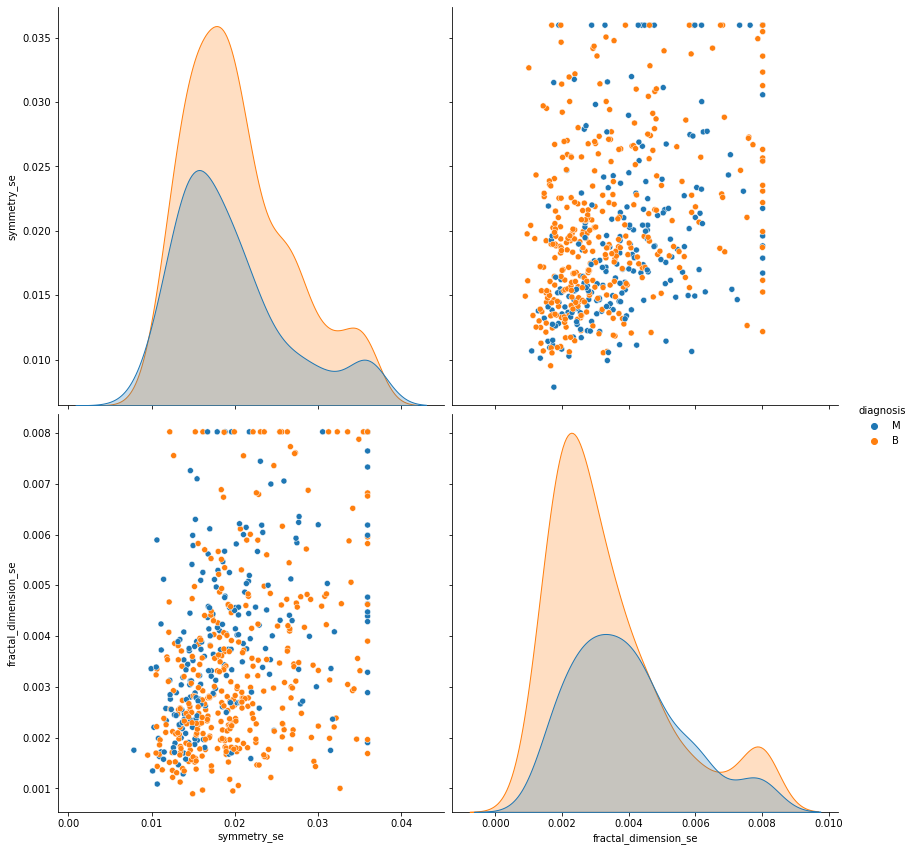

In [301]:
sns.pairplot(df, hue ='diagnosis', vars=['symmetry_se', 'fractal_dimension_se'], height=6, aspect=1 )

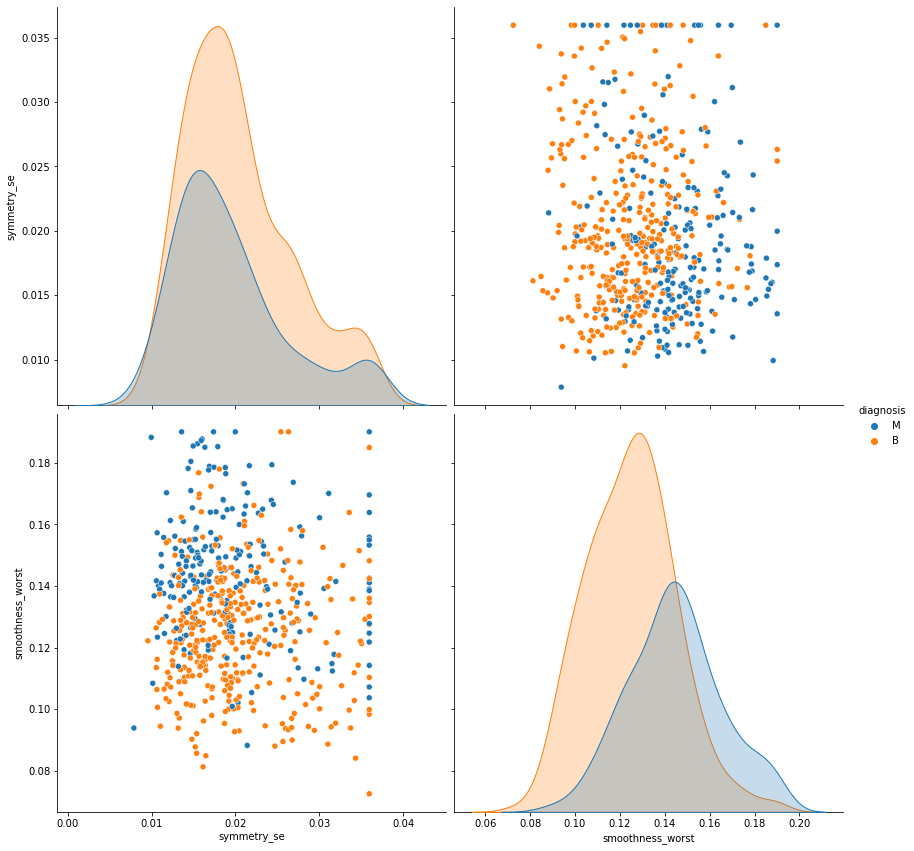

In [302]:
sns.pairplot(df, hue ='diagnosis', vars=['symmetry_se', 'smoothness_worst'], height=6, aspect=1 )

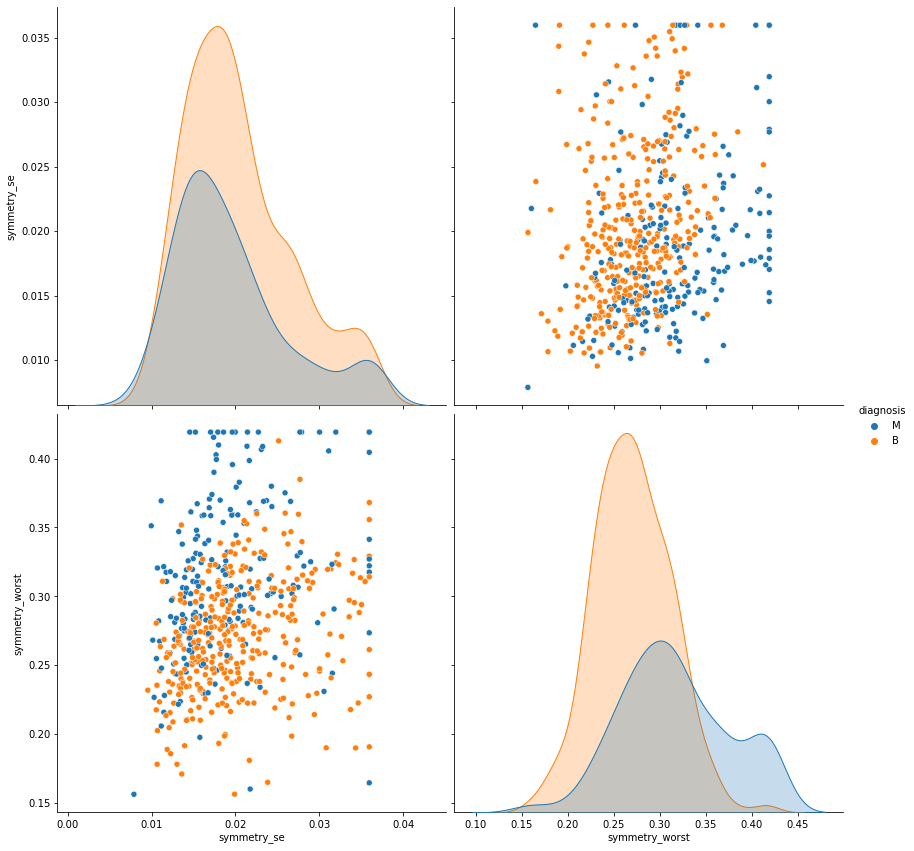

In [303]:
sns.pairplot(df, hue ='diagnosis', vars=['symmetry_se', 'symmetry_worst'], height=6, aspect=1 )

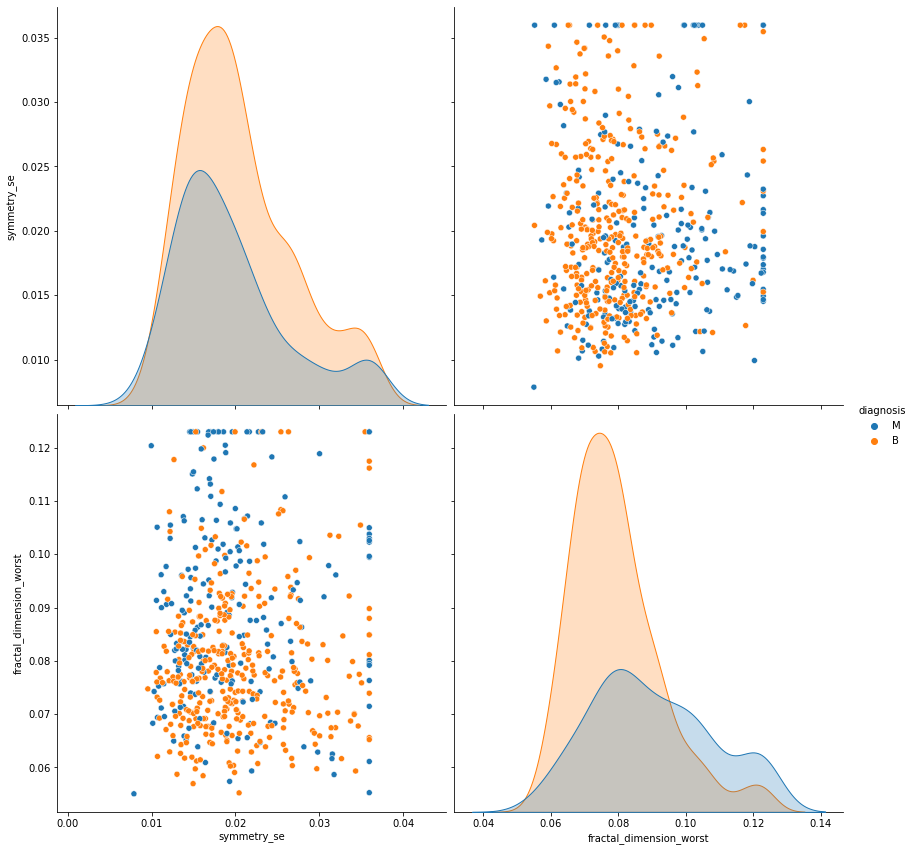

In [304]:
sns.pairplot(df, hue ='diagnosis', vars=['symmetry_se', 'fractal_dimension_worst'], height=6, aspect=1 )

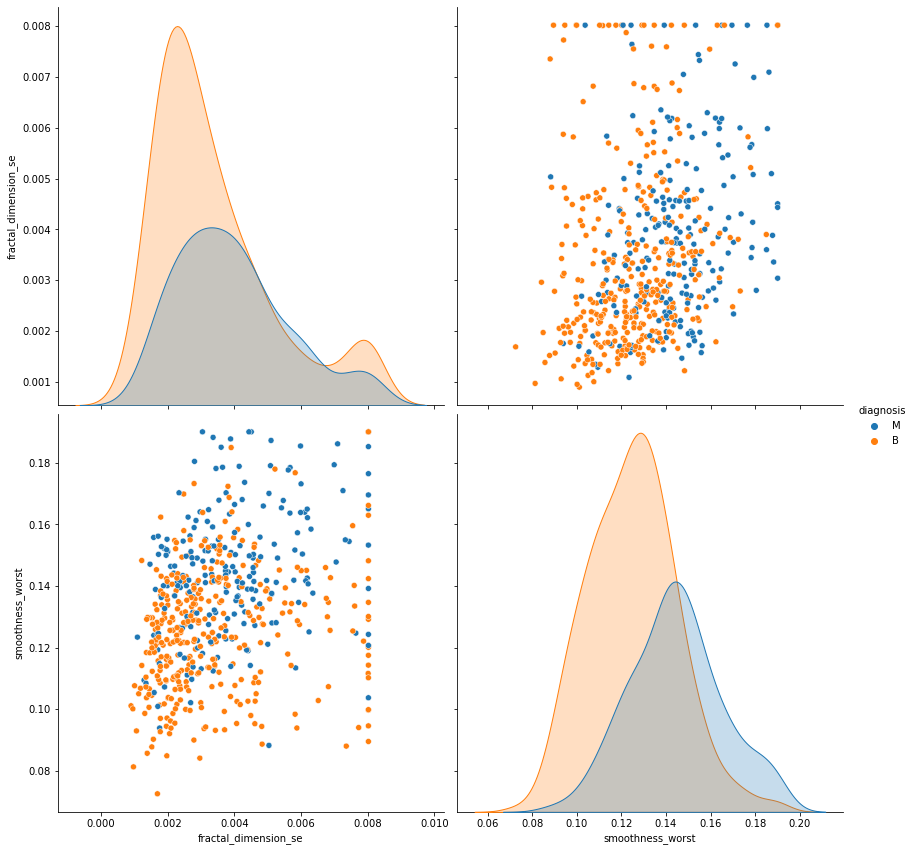

In [305]:
sns.pairplot(df, hue ='diagnosis', vars=['fractal_dimension_se', 'smoothness_worst'], height=6, aspect=1 )

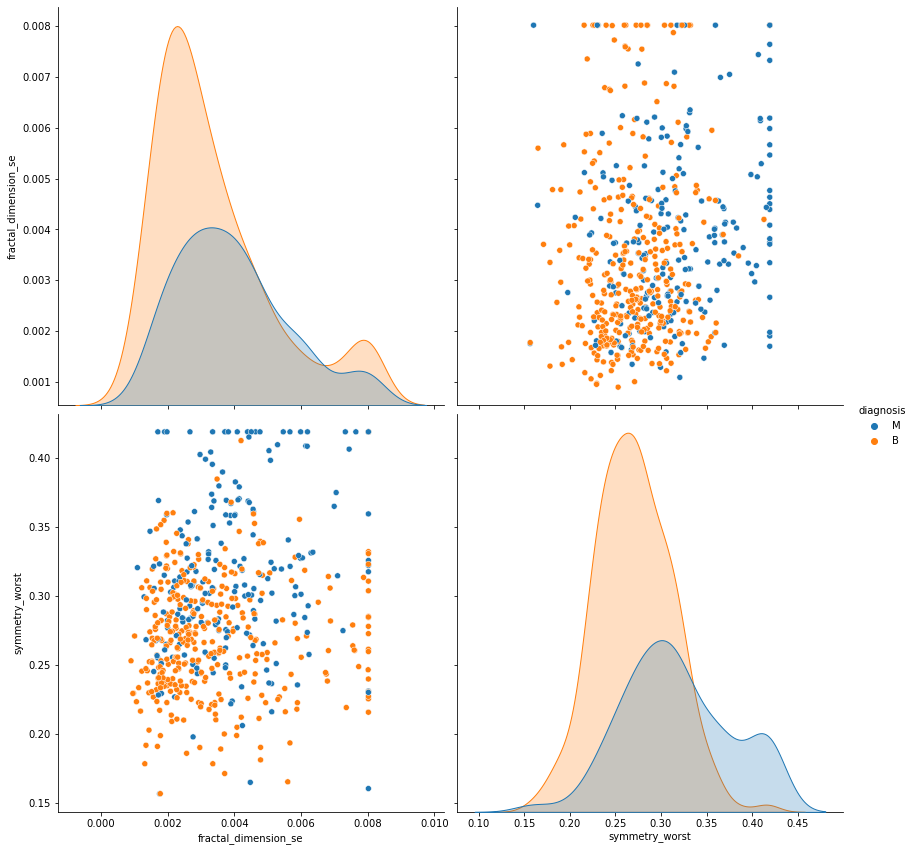

In [306]:
sns.pairplot(df, hue ='diagnosis', vars=['fractal_dimension_se', 'symmetry_worst'], height=6, aspect=1 )

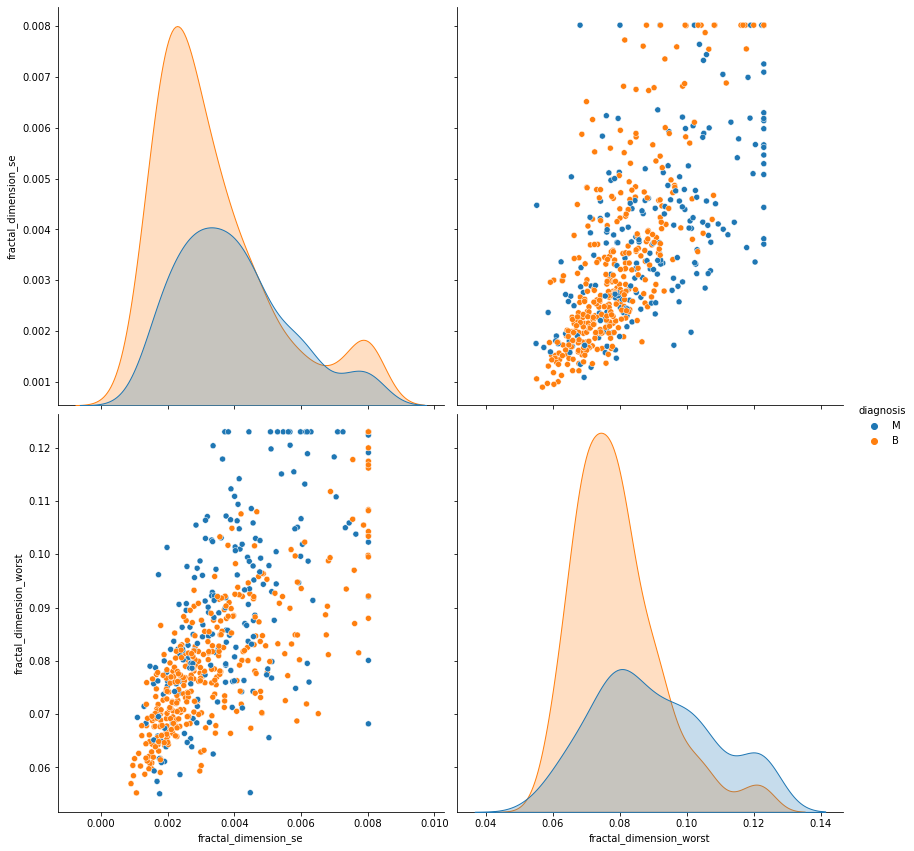

In [307]:
sns.pairplot(df, hue ='diagnosis', vars=['fractal_dimension_se', 'fractal_dimension_worst'], height=6, aspect=1 )

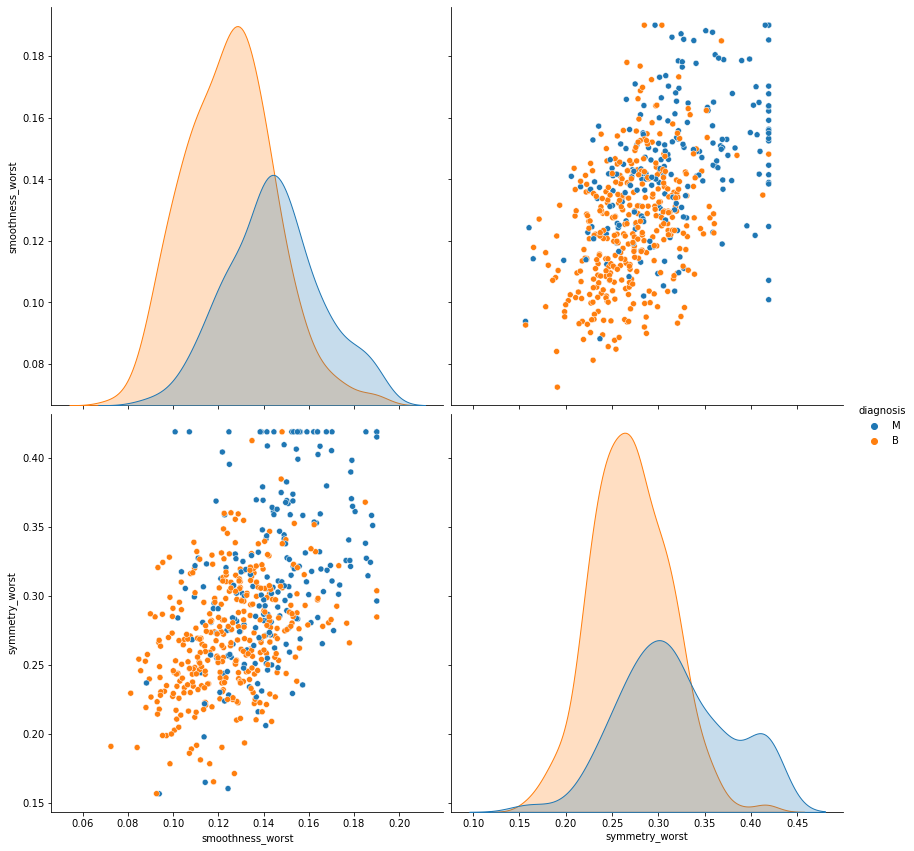

In [308]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_worst', 'symmetry_worst'], height=6, aspect=1 )

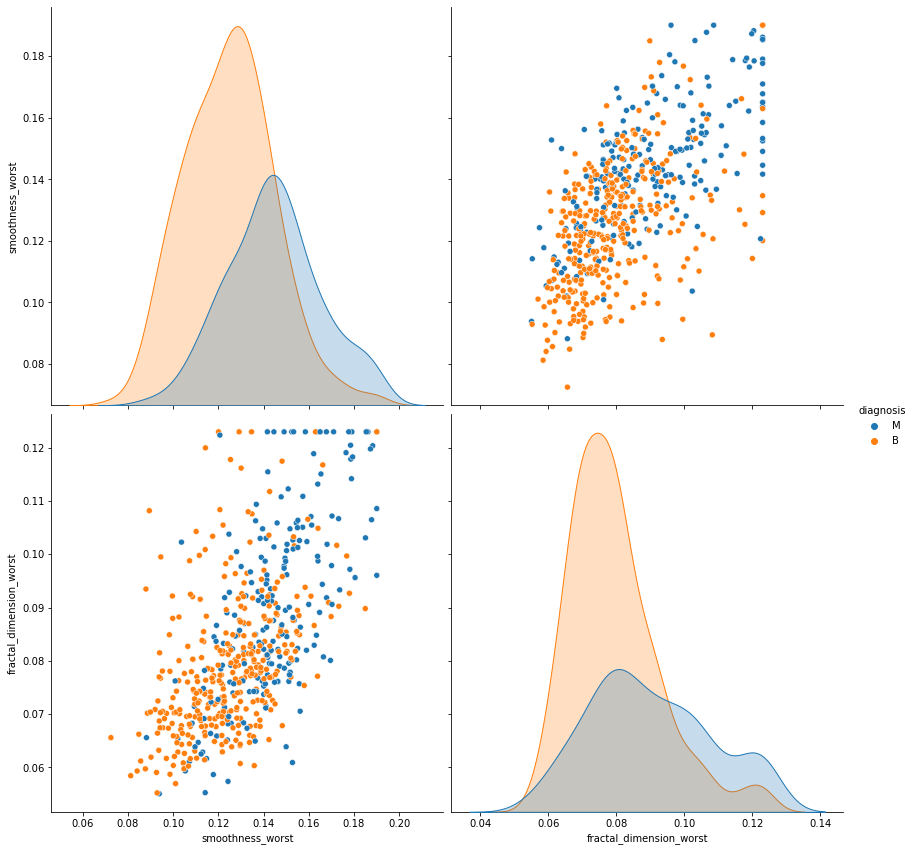

In [309]:
sns.pairplot(df, hue ='diagnosis', vars=['smoothness_worst', 'fractal_dimension_worst'], height=6, aspect=1 )

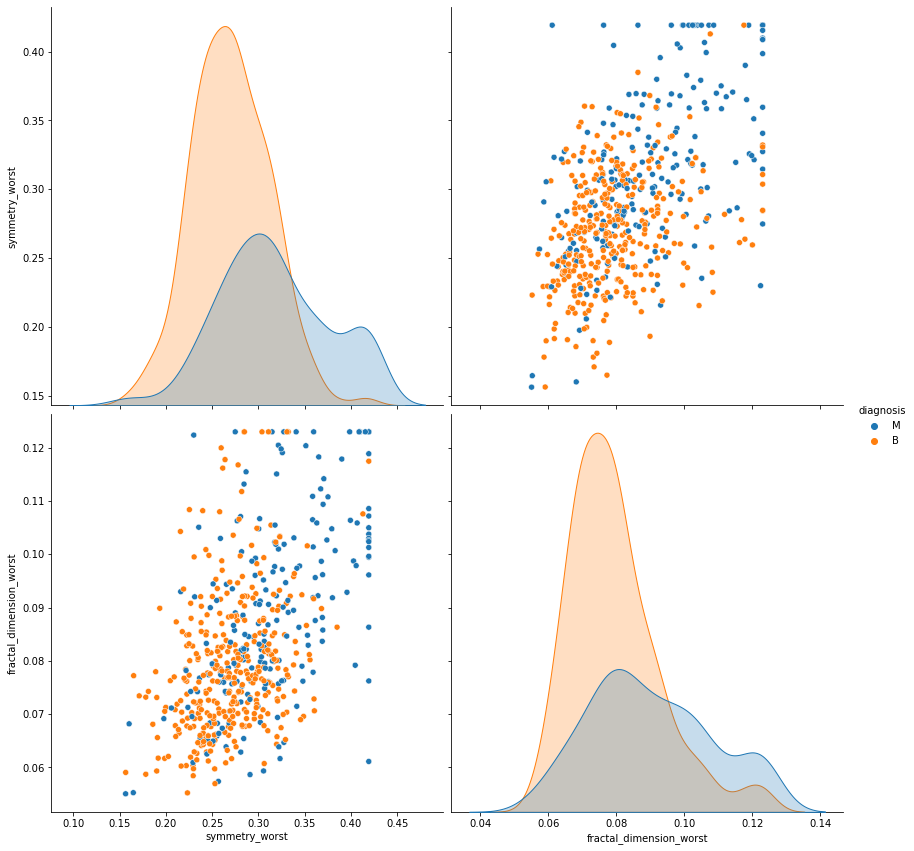

In [310]:
sns.pairplot(df, hue ='diagnosis', vars=['symmetry_worst', 'fractal_dimension_worst'], height=6, aspect=1 )

#Note:we dont need to do data manupulation as our data is already well organised and in csv file.we dont need to do data blending as it means of merging several csv files but we have only 1 csv file.Feature generation means generating more features.We have 37 features already.We can't generate more features for this dataset

In [312]:
# Convert Catergorical values to numeric representation

Since,the categorical values in our original dataset is already represented as discrete,numerical 
values so we don't need to convert them using get_dummies or LabelEncoder

# Partitioning

In [87]:
X = df.drop('diagnosis',axis=1)

In [88]:
X

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,1.0950,0.9053,8.589,153.40,0.006399,0.04904,0.05373,0.01587,0.03003,0.006193,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,0.5435,0.7339,3.398,74.08,0.005225,0.01308,0.01860,0.01340,0.01389,0.003532,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,0.7456,0.7869,4.585,94.03,0.006150,0.04006,0.03832,0.02058,0.02250,0.004571,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,0.4956,1.1560,3.445,27.23,0.009110,0.07458,0.05661,0.01867,0.05963,0.009208,14.910,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,0.7572,0.7813,5.438,94.44,0.011490,0.02461,0.05688,0.01885,0.01756,0.005115,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,1.1760,1.2560,7.673,158.70,0.010300,0.02891,0.05198,0.02454,0.01114,0.004239,25.450,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,0.7655,2.4630,5.203,99.04,0.005769,0.02423,0.03950,0.01678,0.01898,0.002498,23.690,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,0.4564,1.0750,3.425,48.55,0.005903,0.03731,0.04730,0.01557,0.01318,0.003892,18.980,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,0.7260,1.5950,5.772,86.22,0.006522,0.06158,0.07117,0.01664,0.02324,0.006185,25.740,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400


In [89]:
Y= df['diagnosis']

In [90]:
Y

0      M
1      M
2      M
3      M
4      M
      ..
564    M
565    M
566    M
567    M
568    B
Name: diagnosis, Length: 569, dtype: object

In [91]:
Y.value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

In [92]:
#HoldOut Validation Approach - Train-test split

In [93]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size = 0.30, random_state = 0)


In [94]:
y_test.value_counts()

B    108
M     63
Name: diagnosis, dtype: int64

In [95]:
#Stratified Train Test Split

In [96]:
X1_train, X1_test, y1_train, y1_test = train_test_split(X, Y, test_size = 0.30, random_state = 0, stratify = Y)


In [97]:
y1_train.value_counts()

B    250
M    148
Name: diagnosis, dtype: int64

In [98]:
y1_test.value_counts()

B    107
M     64
Name: diagnosis, dtype: int64

# Normalization

In [99]:
# Feature Scaling

In [100]:
#We always scale the features in the range between 0 to 1 after partitioning

In [101]:
X.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,0.062798,0.405172,1.216853,2.866059,40.337079,0.007041,0.025478,0.031894,0.011796,0.020542,0.003795,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,0.007060,0.277313,0.551648,2.021855,45.491006,0.003003,0.017908,0.030186,0.006170,0.008266,0.002646,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.111500,0.360200,0.757000,6.802000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,0.057700,0.232400,0.833900,1.606000,17.850000,0.005169,0.013080,0.015090,0.007638,0.015160,0.002248,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,0.061540,0.324200,1.108000,2.287000,24.530000,0.006380,0.020450,0.025890,0.010930,0.018730,0.003187,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,0.066120,0.478900,1.474000,3.357000,45.190000,0.008146,0.032450,0.042050,0.014710,0.023480,0.004558,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,0.097440,2.873000,4.885000,21.980000,542.200000,0.031130,0.135400,0.396000,0.052790,0.078950,0.029840,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [102]:
scale_vars = []

for cols in X.columns:
    if X[cols].max() > 1:
        scale_vars.append(cols)
scale_vars

['radius_mean',
 'texture_mean',
 'perimeter_mean',
 'area_mean',
 'radius_se',
 'texture_se',
 'perimeter_se',
 'area_se',
 'radius_worst',
 'texture_worst',
 'perimeter_worst',
 'area_worst',
 'compactness_worst',
 'concavity_worst']

In [103]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()



In [104]:
#We will scale based on X_train and then transform both X_train and X_test

In [105]:
scaler.fit(X_train[scale_vars])
X_train[scale_vars] = scaler.transform(X_train[scale_vars])
X_test[scale_vars] = scaler.transform(X_test[scale_vars])

In [106]:
X_test.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
512,0.303800,0.448548,0.309930,0.175270,0.11060,0.14690,0.14450,0.08172,0.2116,0.07325,0.101068,0.125558,0.110069,0.049427,0.005414,0.022650,0.034520,0.013340,0.01705,0.004005,0.301672,0.470149,0.313213,0.162013,0.15740,0.347634,0.462081,0.20510,0.3585,0.11090
457,0.294808,0.644813,0.278557,0.167296,0.08791,0.05205,0.02772,0.02068,0.1619,0.05584,0.035090,0.218301,0.026245,0.019351,0.005768,0.008082,0.015100,0.006451,0.01347,0.001828,0.228388,0.591951,0.203596,0.110032,0.12890,0.076656,0.125792,0.06005,0.2444,0.06788
439,0.333144,0.246888,0.316495,0.196394,0.07966,0.05581,0.02087,0.02652,0.1589,0.05586,0.037190,0.064592,0.040004,0.022472,0.004837,0.009238,0.009213,0.010760,0.01171,0.002104,0.248310,0.194296,0.229693,0.123796,0.10340,0.072193,0.056652,0.08216,0.2136,0.06710
298,0.344503,0.351037,0.327759,0.207678,0.06576,0.05220,0.02475,0.01374,0.1635,0.05586,0.042911,0.067710,0.042595,0.024921,0.003169,0.013770,0.010790,0.005243,0.01103,0.001957,0.294913,0.352878,0.275860,0.155943,0.09445,0.183767,0.141629,0.07530,0.2636,0.07676
37,0.286289,0.361411,0.268261,0.161315,0.08983,0.03766,0.02562,0.02923,0.1467,0.05863,0.026218,0.437663,0.019460,0.012958,0.004352,0.004899,0.013430,0.011640,0.02671,0.001777,0.191035,0.287580,0.169580,0.088650,0.09701,0.018337,0.043738,0.05013,0.1987,0.06169


In [107]:
X_train.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000
mean,0.340977,0.393479,0.335468,0.219877,0.096475,0.104080,0.088794,0.049479,0.180698,0.062646,0.107766,0.186117,0.099402,0.063847,0.006984,0.025099,0.031226,0.011678,0.020402,0.003735,0.299880,0.360195,0.285502,0.174264,0.132529,0.219343,0.243014,0.115221,0.289187,0.083718
std,0.170317,0.173879,0.171165,0.155486,0.013916,0.051031,0.078154,0.039216,0.028057,0.006861,0.106451,0.122059,0.099417,0.093146,0.002861,0.016835,0.028576,0.005862,0.008181,0.002638,0.176634,0.163845,0.171625,0.146936,0.022989,0.149075,0.174886,0.065688,0.063439,0.017957
min,0.000000,0.000000,0.000000,0.000000,0.052630,0.019380,0.000000,0.000000,0.106000,0.049960,0.000000,0.000000,0.000000,0.000000,0.001713,0.002252,0.000000,0.000000,0.007882,0.000895,0.000000,0.000000,0.000000,0.000000,0.071170,0.000000,0.000000,0.000000,0.156500,0.055040
25%,0.223816,0.262344,0.217815,0.117434,0.086740,0.066805,0.030385,0.020710,0.161525,0.057685,0.043753,0.102881,0.039544,0.019855,0.005180,0.013628,0.016055,0.007932,0.014950,0.002238,0.182231,0.235741,0.167899,0.081406,0.116300,0.117696,0.107783,0.065320,0.247850,0.071462
50%,0.299541,0.374066,0.292654,0.171771,0.096035,0.094035,0.062650,0.033870,0.179150,0.061715,0.076136,0.158595,0.069406,0.031706,0.006266,0.020500,0.026245,0.010800,0.018610,0.003110,0.248488,0.350080,0.234300,0.122100,0.132250,0.183087,0.208009,0.098855,0.280950,0.080075
75%,0.416087,0.493257,0.419356,0.269618,0.105400,0.128750,0.128775,0.075022,0.195400,0.065735,0.131595,0.243620,0.119623,0.070830,0.008161,0.032060,0.040000,0.014417,0.022937,0.004502,0.393988,0.464619,0.375342,0.223174,0.145275,0.292696,0.342760,0.161300,0.318275,0.091853
max,1.000000,1.000000,1.000000,1.000000,0.144700,0.311400,0.426800,0.201200,0.304000,0.097440,1.000000,1.000000,1.000000,1.000000,0.023330,0.106400,0.396000,0.052790,0.061460,0.029840,1.000000,1.000000,1.000000,1.000000,0.222600,1.000000,1.000000,0.290300,0.663800,0.207500


In [108]:
X_test.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000
mean,0.331810,0.406845,0.327041,0.210039,0.096093,0.104948,0.088811,0.047617,0.182241,0.063149,0.103038,0.195237,0.099315,0.057333,0.007175,0.026360,0.033448,0.012070,0.020868,0.003934,0.289175,0.372851,0.277634,0.163090,0.131995,0.222236,0.254029,0.113174,0.292144,0.084476
std,0.158569,0.188909,0.160429,0.133884,0.014441,0.056895,0.083486,0.037904,0.025905,0.007513,0.084940,0.121938,0.085104,0.062194,0.003313,0.020213,0.033674,0.006844,0.008477,0.002668,0.160737,0.163875,0.157304,0.122133,0.022525,0.161093,0.218145,0.066006,0.058172,0.018343
min,0.035402,0.041909,0.028954,0.014973,0.065760,0.033980,0.000000,0.000000,0.120300,0.050240,0.001050,-0.000575,0.000679,-0.000796,0.002667,0.003746,0.000000,0.000000,0.010130,0.001126,0.036784,0.012527,0.033667,0.014009,0.084090,0.018337,0.000000,0.000000,0.160300,0.058650
25%,0.220503,0.289627,0.210283,0.115461,0.085095,0.059845,0.025760,0.018785,0.164000,0.057940,0.044650,0.114026,0.042478,0.020023,0.005179,0.012370,0.013550,0.007388,0.015360,0.002292,0.173426,0.253865,0.167389,0.076177,0.116850,0.104937,0.093891,0.061815,0.254700,0.071500
50%,0.303800,0.387137,0.297699,0.172895,0.094910,0.089950,0.055000,0.030990,0.180900,0.061000,0.080427,0.178276,0.077746,0.035146,0.006543,0.020080,0.024890,0.011120,0.019060,0.003288,0.253291,0.366738,0.243538,0.125959,0.129700,0.176199,0.180271,0.102500,0.284900,0.079440
75%,0.422121,0.513693,0.414346,0.276564,0.104450,0.134700,0.135450,0.068600,0.196250,0.066780,0.139326,0.249480,0.124464,0.070923,0.008116,0.033685,0.044950,0.015685,0.024310,0.004602,0.381537,0.488806,0.369740,0.215002,0.146800,0.306158,0.355385,0.162100,0.316950,0.092130
max,0.768091,1.226971,0.758137,0.647508,0.163400,0.345400,0.426400,0.182300,0.290600,0.095020,0.455731,0.726239,0.485935,0.316413,0.031130,0.135400,0.303800,0.040900,0.078950,0.021930,0.821060,0.875533,0.778873,0.678038,0.190200,0.878433,1.133032,0.291000,0.544000,0.144600


In [109]:
scaler.fit(X1_train[scale_vars])
X1_train[scale_vars] = scaler.transform(X1_train[scale_vars])
X1_test[scale_vars] = scaler.transform(X1_test[scale_vars])

In [110]:
X1_test.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
510,0.225235,0.168414,0.224725,0.119830,0.08099,0.09661,0.06726,0.02639,0.1499,0.06758,0.029296,0.085117,0.027706,0.011651,0.006982,0.039160,0.040170,0.015280,0.02260,0.006822,0.160797,0.148721,0.153593,0.070930,0.1073,0.239313,0.214856,0.10560,0.2604,0.09879
520,0.109518,0.141698,0.111741,0.048484,0.13710,0.12250,0.03332,0.02421,0.2197,0.07696,0.087742,0.233767,0.076851,0.023960,0.015460,0.025400,0.021970,0.015800,0.03997,0.003901,0.093917,0.155117,0.086807,0.034752,0.1850,0.171323,0.079840,0.07262,0.3681,0.08982
311,0.361068,0.202232,0.337848,0.221166,0.07618,0.03515,0.01447,0.01877,0.1632,0.05255,0.074054,0.167250,0.056401,0.041274,0.005031,0.006021,0.005325,0.006324,0.01494,0.000895,0.303451,0.259328,0.265402,0.161129,0.1011,0.035705,0.037907,0.05813,0.2530,0.05695
25,0.480808,0.226243,0.498998,0.326278,0.11860,0.22760,0.22290,0.14010,0.3040,0.07413,0.338403,0.186885,0.307167,0.195365,0.008029,0.037990,0.037320,0.023970,0.02308,0.007444,0.509427,0.250000,0.507944,0.313557,0.1545,0.352239,0.307748,0.25500,0.4066,0.10590
530,0.225709,0.265472,0.221823,0.118515,0.10730,0.09713,0.05282,0.04440,0.1598,0.06677,0.118378,0.470304,0.112708,0.044561,0.006587,0.018150,0.017370,0.013160,0.01835,0.002318,0.198150,0.425373,0.189800,0.090223,0.1349,0.147585,0.109105,0.10100,0.2478,0.07757


In [111]:
X1_train.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000,398.000000
mean,0.337380,0.326679,0.332248,0.216469,0.096194,0.103157,0.088790,0.048648,0.180677,0.062693,0.106933,0.260137,0.100421,0.063312,0.006934,0.024725,0.031083,0.011545,0.020333,0.003750,0.295384,0.366547,0.282279,0.169685,0.131921,0.212426,0.217225,0.113276,0.289340,0.083857
std,0.167519,0.149319,0.169563,0.150854,0.014079,0.053939,0.082791,0.040355,0.027357,0.006844,0.106685,0.166156,0.102909,0.091598,0.002939,0.016992,0.027423,0.006093,0.008199,0.002562,0.170035,0.165215,0.167223,0.137580,0.022641,0.155017,0.171876,0.067157,0.061090,0.018285
min,0.000000,0.000000,0.000000,0.000000,0.052630,0.019380,0.000000,0.000000,0.120300,0.049960,0.000000,0.000000,0.000000,0.000000,0.002667,0.002252,0.000000,0.000000,0.007882,0.000950,0.000000,0.000000,0.000000,0.000000,0.081250,0.000000,0.000000,0.000000,0.156500,0.055040
25%,0.225354,0.218211,0.216277,0.119141,0.086130,0.063732,0.028275,0.020195,0.161550,0.058027,0.043753,0.143064,0.040074,0.020799,0.005111,0.013135,0.014620,0.007455,0.015005,0.002217,0.182231,0.241738,0.168410,0.081406,0.114925,0.103138,0.086861,0.063532,0.248050,0.070840
50%,0.298121,0.310788,0.290408,0.170838,0.095820,0.088630,0.058465,0.031905,0.178950,0.061285,0.077603,0.225243,0.071644,0.033336,0.006244,0.020115,0.025405,0.010680,0.018500,0.003107,0.249200,0.357276,0.232930,0.123341,0.131150,0.171470,0.170687,0.097330,0.282650,0.080195
75%,0.412182,0.410720,0.411582,0.262185,0.105250,0.129350,0.132250,0.072772,0.195550,0.065982,0.131595,0.334683,0.118162,0.071247,0.008107,0.031780,0.041642,0.014320,0.022935,0.004430,0.377446,0.489006,0.369989,0.212176,0.146225,0.301124,0.309545,0.161200,0.319525,0.092202
max,1.000000,1.000000,1.000000,1.000000,0.163400,0.345400,0.426800,0.201200,0.290600,0.095020,1.000000,1.000000,1.000000,1.000000,0.031130,0.106400,0.303800,0.040900,0.078950,0.022860,1.000000,1.000000,1.000000,1.000000,0.218400,1.000000,1.000000,0.291000,0.577400,0.207500


In [112]:
X1_test.describe()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000,171.000000
mean,0.340182,0.317648,0.334534,0.217970,0.096746,0.107098,0.088821,0.049550,0.182291,0.063040,0.104977,0.260369,0.096944,0.061061,0.007289,0.027230,0.033780,0.012381,0.021030,0.003901,0.299640,0.358067,0.285135,0.173748,0.133409,0.220517,0.217816,0.117702,0.291787,0.084153
std,0.165544,0.136242,0.164496,0.145963,0.014062,0.050138,0.072298,0.035028,0.027594,0.007556,0.084330,0.172499,0.074725,0.067259,0.003140,0.019820,0.035821,0.006327,0.008424,0.002836,0.176765,0.160823,0.168125,0.145634,0.023305,0.150877,0.154223,0.062371,0.063790,0.017579
min,0.033603,0.034156,0.031442,0.011410,0.064290,0.023440,0.000000,0.000000,0.106000,0.050250,0.001050,-0.000578,0.004095,0.000979,0.001713,0.003710,0.000000,0.000000,0.010130,0.000895,0.026610,0.022655,0.020320,0.009438,0.071170,-0.006867,0.000000,0.000000,0.156600,0.056950
25%,0.220029,0.223876,0.216986,0.112789,0.086610,0.067505,0.031515,0.020885,0.163400,0.057525,0.045048,0.147006,0.039391,0.020299,0.005262,0.013050,0.015430,0.008590,0.015375,0.002262,0.174493,0.241738,0.165496,0.075489,0.120000,0.118181,0.102915,0.068060,0.254100,0.072485
50%,0.306167,0.305715,0.298735,0.173446,0.096390,0.102200,0.072930,0.042740,0.179800,0.062280,0.075430,0.227069,0.074777,0.032589,0.006627,0.020830,0.026260,0.011640,0.019480,0.003339,0.253291,0.356610,0.243538,0.122739,0.133800,0.185878,0.190895,0.110500,0.281000,0.079200
75%,0.438923,0.401082,0.435077,0.285133,0.105850,0.132200,0.124600,0.074440,0.195950,0.066370,0.141318,0.345186,0.129105,0.075379,0.008294,0.034815,0.042445,0.015665,0.023835,0.004699,0.393988,0.445229,0.385428,0.226799,0.144900,0.284689,0.301078,0.161950,0.313650,0.091300
max,0.863221,0.769699,0.882524,0.735737,0.142500,0.283900,0.410800,0.184500,0.304000,0.097440,0.396705,1.376876,0.380389,0.405863,0.021770,0.135400,0.396000,0.052790,0.059630,0.029840,0.873710,0.936567,0.814732,0.797975,0.222600,0.877598,0.720367,0.286700,0.663800,0.173000


# Feature Selection

In [113]:
X_train.head()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
478,0.213403,0.202490,0.208693,0.110880,0.10460,0.08228,0.05308,0.01969,0.1779,0.06574,0.033279,0.177613,0.038166,0.013294,0.004957,0.021140,0.04156,0.008038,0.01843,0.003614,0.159018,0.263326,0.157528,0.069406,0.1352,0.168534,0.234932,0.07431,0.2941,0.09180
303,0.166075,0.369295,0.159422,0.080933,0.10680,0.06678,0.02297,0.01780,0.1482,0.06600,0.013399,0.265402,0.013099,0.005331,0.008875,0.009362,0.01808,0.009199,0.01791,0.003317,0.111348,0.333689,0.101350,0.046746,0.1413,0.074813,0.076226,0.06528,0.2213,0.07842
155,0.249373,0.341494,0.238270,0.134380,0.08654,0.06679,0.03885,0.02331,0.1970,0.06228,0.039290,0.136991,0.034255,0.017350,0.005518,0.015620,0.01994,0.007924,0.01799,0.002484,0.201352,0.351812,0.180238,0.093148,0.1217,0.146996,0.175837,0.08211,0.3113,0.08132
186,0.536182,0.368050,0.516965,0.380700,0.08588,0.08468,0.08169,0.05814,0.1621,0.05425,0.052942,0.024966,0.049946,0.040548,0.002866,0.009181,0.01412,0.006719,0.01069,0.001087,0.475987,0.382196,0.442203,0.301022,0.1234,0.210738,0.320181,0.15710,0.3206,0.06938
101,0.000000,0.154357,0.000000,0.000000,0.11700,0.07568,0.00000,0.00000,0.1930,0.07818,0.040775,0.253240,0.037506,0.004869,0.010190,0.010840,0.00000,0.000000,0.02659,0.004100,0.000000,0.200426,0.000000,0.000000,0.1584,0.090142,0.000000,0.00000,0.2932,0.09382


In [114]:
#Algorithm 3 - Feature Selection using Information Gain

In [115]:
from sklearn.feature_selection import mutual_info_classif

mutual_info = mutual_info_classif(X_train, y_train, random_state = 20)
mutual_info


array([0.33116318, 0.08767504, 0.39275354, 0.35112978, 0.10298329,
       0.27908738, 0.38330193, 0.45822865, 0.07609152, 0.00207413,
       0.26052321, 0.00295809, 0.26249322, 0.32325727, 0.01351094,
       0.06595737, 0.12414734, 0.13275689, 0.01232343, 0.05228655,
       0.42933642, 0.11736315, 0.45854617, 0.45138261, 0.09196583,
       0.23113478, 0.32720512, 0.45979298, 0.07184819, 0.03273109])

In [116]:
print(len(mutual_info))
print(X_train.shape)

30
(398, 30)


In [117]:
mutual_info = pd.Series(mutual_info)
mutual_info.index = X_train.columns
mutual_info.sort_values(ascending = False)

concave points_worst       0.459793
perimeter_worst            0.458546
concave points_mean        0.458229
area_worst                 0.451383
radius_worst               0.429336
perimeter_mean             0.392754
concavity_mean             0.383302
area_mean                  0.351130
radius_mean                0.331163
concavity_worst            0.327205
area_se                    0.323257
compactness_mean           0.279087
perimeter_se               0.262493
radius_se                  0.260523
compactness_worst          0.231135
concave points_se          0.132757
concavity_se               0.124147
texture_worst              0.117363
smoothness_mean            0.102983
smoothness_worst           0.091966
texture_mean               0.087675
symmetry_mean              0.076092
symmetry_worst             0.071848
compactness_se             0.065957
fractal_dimension_se       0.052287
fractal_dimension_worst    0.032731
smoothness_se              0.013511
symmetry_se                0

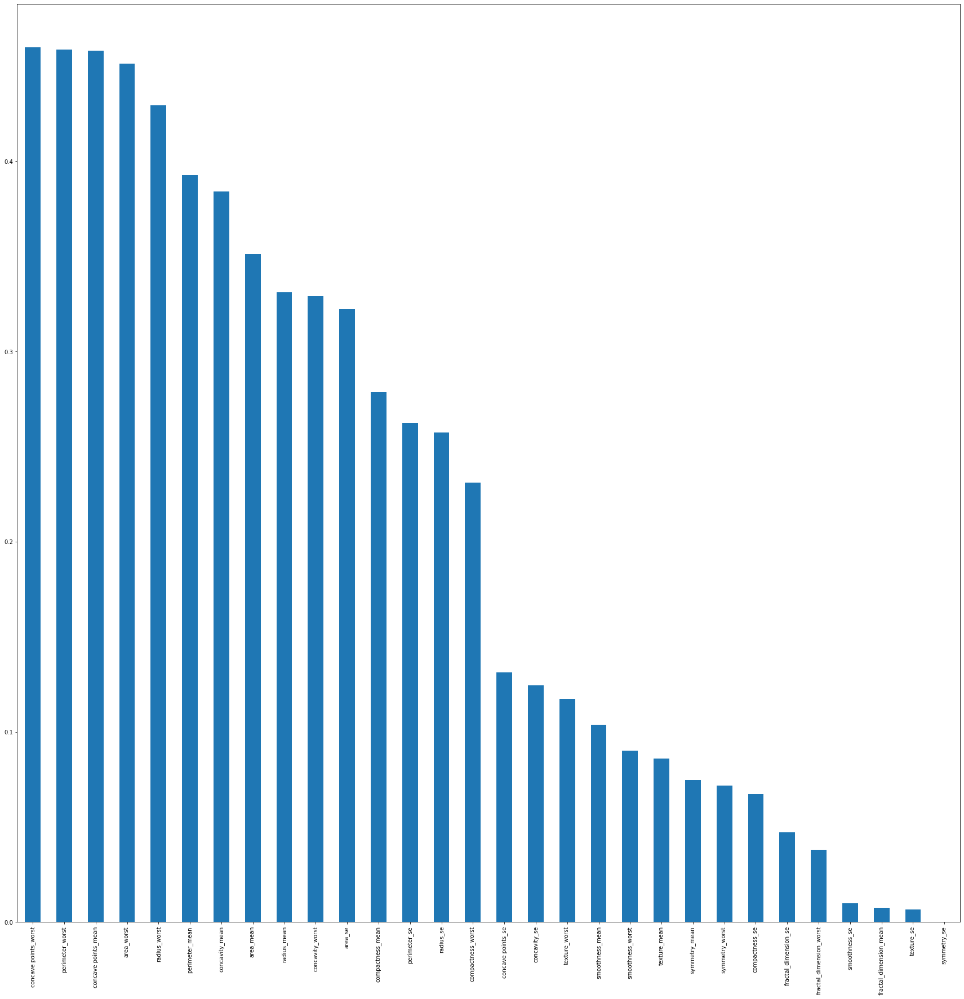

In [169]:
plt.figur
mutual_info.sort_values(ascending = False).plot.bar();

In [170]:
#Algorithm 4 - Feature Selection using RFECV (Recursive Feature Elimination with Cross Validation)

In [171]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import RFECV
from sklearn.model_selection import StratifiedKFold
import warnings
warnings.filterwarnings('ignore')

rfc = RandomForestClassifier(random_state=101)
rfecv = RFECV(estimator=rfc, step=1, cv=StratifiedKFold(5), scoring='accuracy')
rfecv.fit(X_train, y_train)

RFECV(cv=StratifiedKFold(n_splits=5, random_state=None, shuffle=False),
      estimator=RandomForestClassifier(random_state=101), scoring='accuracy')

In [172]:
print('Optimal number of features: {}'.format(rfecv.n_features_))

Optimal number of features: 26


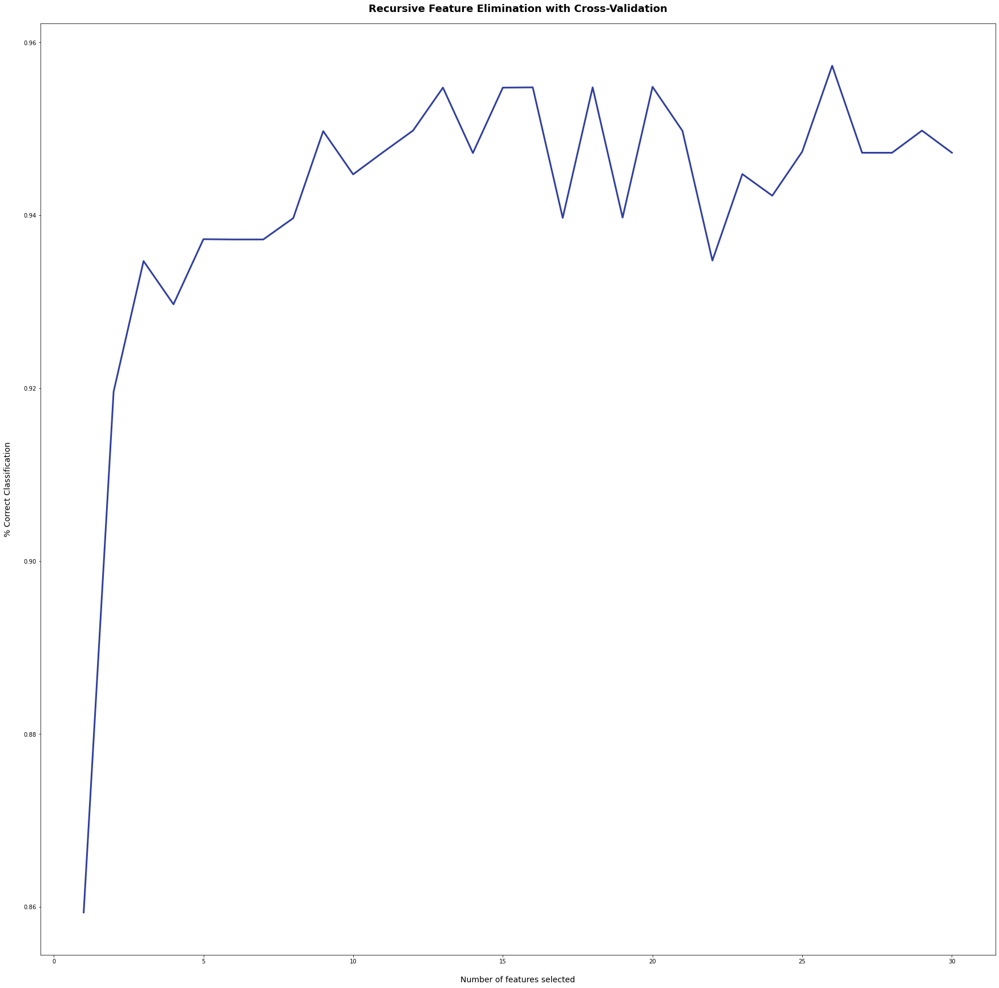

In [173]:
plt.figure(figsize=(30, 30))
plt.title('Recursive Feature Elimination with Cross-Validation', fontsize=18, fontweight='bold', pad=20)
plt.xlabel('Number of features selected', fontsize=14, labelpad=20)
plt.ylabel('% Correct Classification', fontsize=14, labelpad=20)
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_, color='#303F9F', linewidth=3)
plt.show()

In [174]:
print(np.where(rfecv.support_ == False)[0])

[ 8  9 15 16]


In [175]:
selected_features = X_train.drop(X_train.columns[np.where(rfecv.support_ == False)[0]], axis=1)

In [176]:
rfecv.estimator_.feature_importances_

array([0.04269318, 0.00873769, 0.05883408, 0.01873544, 0.00625645,
       0.00745431, 0.10352068, 0.13413346, 0.01605923, 0.00326232,
       0.01123346, 0.03752482, 0.00392839, 0.0048396 , 0.00434788,
       0.00587271, 0.05321265, 0.0160435 , 0.13098683, 0.1002763 ,
       0.01414697, 0.01334534, 0.03711   , 0.14124266, 0.01500796,
       0.01119411])

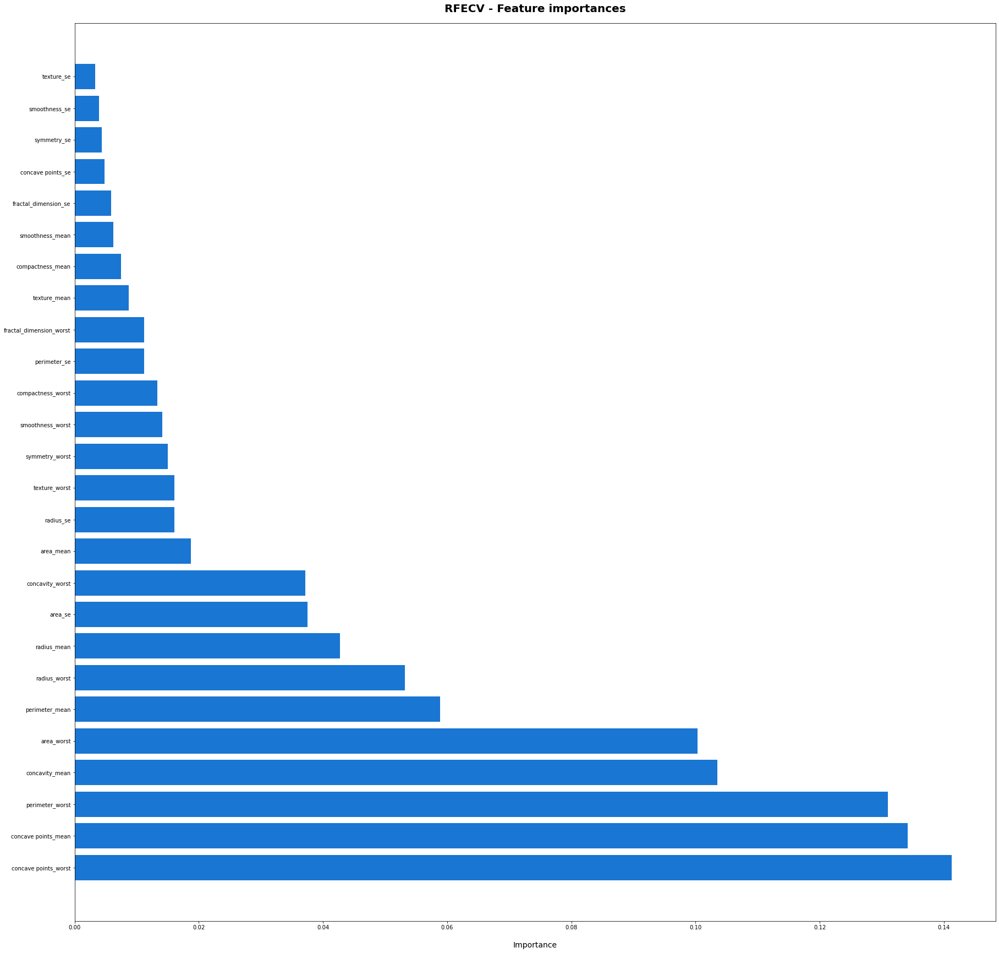

In [177]:
dset = pd.DataFrame()
dset['attr'] = selected_features.columns
dset['importance'] = rfecv.estimator_.feature_importances_
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(30, 30))
plt.barh(y=dset['attr'], width=dset['importance'], color='#1976D2')
plt.title('RFECV - Feature importances', fontsize=20, fontweight='bold', pad=20)
plt.xlabel('Importance', fontsize=14, labelpad=20)
plt.show()


In [178]:
dset

,attr,importance
23,concave points_worst,0.141243
7,concave points_mean,0.134133
18,perimeter_worst,0.130987
6,concavity_mean,0.103521
19,area_worst,0.100276
2,perimeter_mean,0.058834
16,radius_worst,0.053213
0,radius_mean,0.042693
11,area_se,0.037525
22,concavity_worst,0.037110


In [179]:
#Algorithm 1 - Dropping Constant Features using Variance Threshold Technique


In [180]:
from sklearn.feature_selection import VarianceThreshold
# By default, the threshold = 0 i.e. it will remove the zero-variance threshold
var_thresh = VarianceThreshold() # by default the threshold = 0
var_thresh.fit(X_train)

VarianceThreshold()

In [181]:
print("Features Selected: ", X_train.columns[var_thresh.get_support()])

Features Selected:  Index(['radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')


In [182]:
len(X_train.columns[var_thresh.get_support()])

30

In [183]:
#There's no feature with zero variance

In [184]:
#Algorithm 2 - Feature Selection with Pearson's correlation


In [185]:
#Idea Highly correlated features with the target variable are important features, 
High correlation between features, (say over 90% or over 80%) 
indicate the existence of duplicate features.In case of duplicate features, 
we do not need to take all the features but one one of them would suffice


In [186]:
# Let's find the feature correlations

corr = X_train.corr()
corr

# Note that the correlation values lie between -1 and +1
# A correlation value close to -1 indicates a strong negative linear correlation
# A correlation value close to +1 indicates a strong positive linear correlation
# A correlation value close to 0 indicates no linear correlation

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,perimeter_se,area_se,smoothness_se,compactness_se,concavity_se,concave points_se,symmetry_se,fractal_dimension_se,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
radius_mean,1.000000,0.303956,0.997992,0.994089,0.158698,0.512518,0.683094,0.809796,0.134016,-0.352623,0.687276,-0.169705,0.692992,0.834166,-0.265876,0.210244,0.284550,0.399114,-0.196521,-0.007801,0.974066,0.271711,0.968174,0.964369,0.135675,0.455660,0.565450,0.744701,0.180368,0.023879
texture_mean,0.303956,1.000000,0.311403,0.316776,-0.015091,0.236585,0.311320,0.287591,0.086588,-0.078566,0.309836,0.405093,0.324774,0.336794,0.040889,0.205189,0.203753,0.146384,-0.039252,0.092723,0.332961,0.906539,0.339949,0.338413,0.098051,0.269236,0.307871,0.279057,0.100176,0.108492
perimeter_mean,0.997992,0.311403,1.000000,0.992126,0.193652,0.560029,0.720754,0.838747,0.166687,-0.305738,0.700018,-0.158858,0.710641,0.842407,-0.244002,0.255076,0.322747,0.431502,-0.178460,0.033591,0.975637,0.279436,0.974182,0.966372,0.166076,0.496719,0.600812,0.773149,0.203775,0.066766
area_mean,0.994089,0.316776,0.992126,1.000000,0.157033,0.507300,0.685740,0.809928,0.139488,-0.336949,0.714215,-0.145587,0.716925,0.857778,-0.232805,0.213961,0.289061,0.396169,-0.177893,0.005309,0.974940,0.281358,0.968347,0.975187,0.143766,0.445304,0.561055,0.735021,0.175372,0.026733
smoothness_mean,0.158698,-0.015091,0.193652,0.157033,1.000000,0.660329,0.524171,0.548493,0.524972,0.586799,0.312905,0.100203,0.317188,0.279469,0.357969,0.335407,0.296364,0.415433,0.161027,0.378829,0.211858,0.051836,0.233210,0.212242,0.807301,0.475111,0.447380,0.501373,0.392636,0.504938
compactness_mean,0.512518,0.236585,0.560029,0.507300,0.660329,1.000000,0.895542,0.843216,0.591232,0.513985,0.535104,0.023299,0.578865,0.554791,0.153710,0.765584,0.698389,0.687306,0.125944,0.604636,0.554638,0.251590,0.598107,0.552134,0.595840,0.884779,0.845730,0.837111,0.512127,0.694764
concavity_mean,0.683094,0.311320,0.720754,0.685740,0.524171,0.895542,1.000000,0.937638,0.487524,0.284134,0.651998,0.056258,0.682483,0.702435,0.102379,0.669423,0.734691,0.685923,0.068229,0.481174,0.711552,0.315406,0.742878,0.714285,0.483582,0.786185,0.903561,0.883166,0.410525,0.526050
concave points_mean,0.809796,0.287591,0.838747,0.809928,0.548493,0.843216,0.937638,1.000000,0.451032,0.139008,0.733318,0.002794,0.755089,0.804725,0.033698,0.519719,0.551124,0.654357,0.019281,0.340529,0.831205,0.289199,0.852339,0.829989,0.467809,0.704571,0.790611,0.915313,0.385225,0.391315
symmetry_mean,0.134016,0.086588,0.166687,0.139488,0.524972,0.591232,0.487524,0.451032,1.000000,0.457742,0.317570,0.141672,0.319129,0.273593,0.230722,0.438966,0.366029,0.399395,0.424462,0.413730,0.172528,0.097537,0.200966,0.182328,0.415286,0.478206,0.441967,0.425367,0.717729,0.452838
fractal_dimension_mean,-0.352623,-0.078566,-0.305738,-0.336949,0.586799,0.513985,0.284134,0.139008,0.457742,1.000000,-0.031724,0.188679,-0.000943,-0.136291,0.448384,0.531057,0.399260,0.294111,0.315446,0.698188,-0.285627,-0.036766,-0.244364,-0.264537,0.526203,0.421734,0.302695,0.153359,0.322143,0.760977


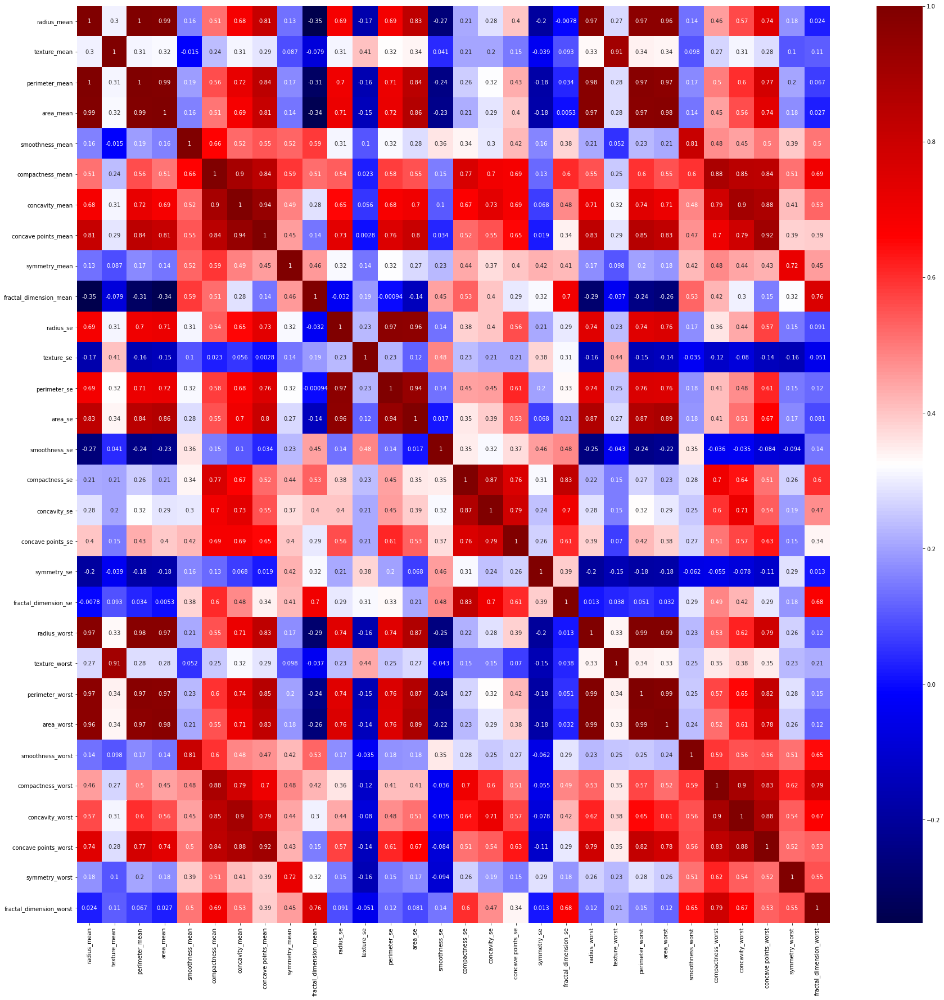

In [187]:
plt.figure(figsize = (30,30))
sns.heatmap(corr, annot = True, cmap = "seismic");

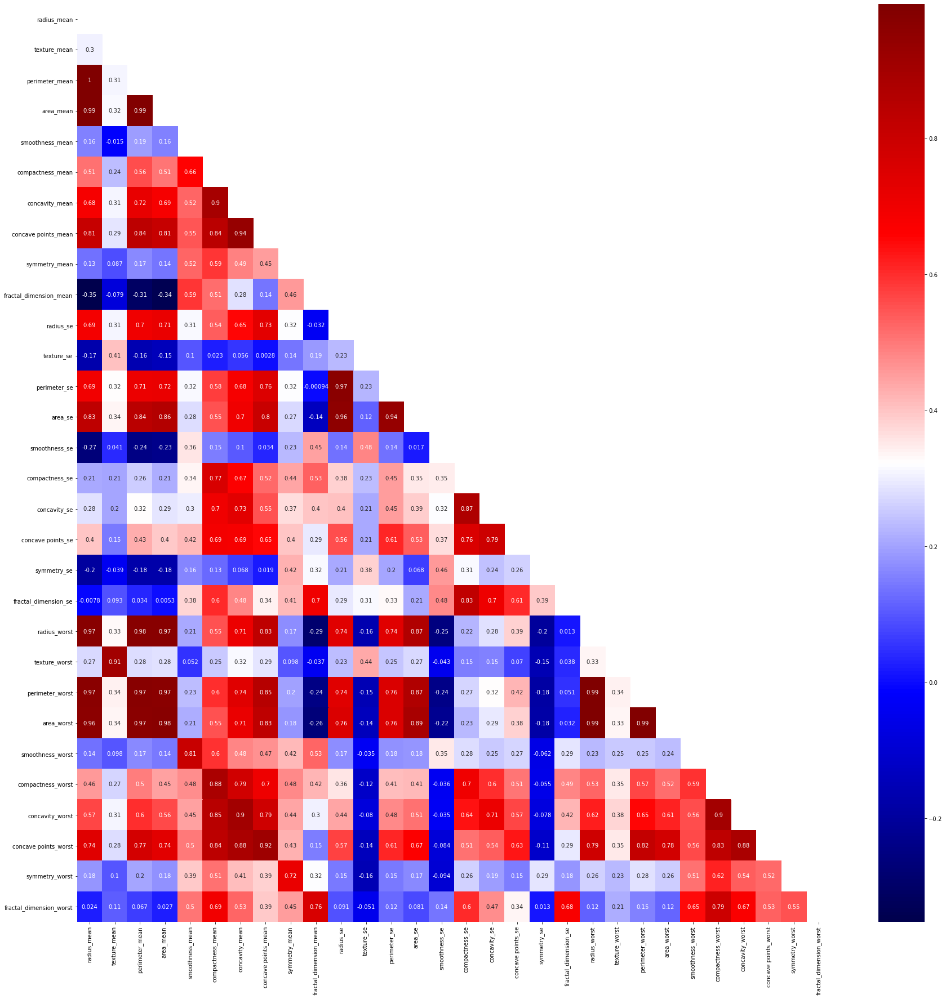

In [188]:
# use of the mask 
import numpy as np
mask1 = np.triu(np.ones_like(corr, dtype=bool))
mask2 = np.tril(np.ones_like(corr, dtype=bool))
plt.figure(figsize = (30,30))
sns.heatmap(corr, annot = True, cmap = "seismic", mask = mask1);

In [38]:
# with the following function we can select highly correlated features
# it will remove the first feature that is highly correlated with another feature

def correlation(dataset, threshold):
    col_corr = set() # Set of all the names of the redundant columns
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if(abs(corr_matrix.iloc[i, j])) > threshold:
                colname = corr_matrix.columns[i]
                col_corr.add(colname)
    return col_corr

In [39]:
corr_features = correlation(X_train, 0.85) # 85% is a good value of the threshold
print(len(corr_features))
print(corr_features)

13
{'perimeter_se', 'concave points_mean', 'compactness_worst', 'concavity_worst', 'texture_worst', 'area_se', 'concave points_worst', 'concavity_mean', 'perimeter_worst', 'area_mean', 'radius_worst', 'area_worst', 'perimeter_mean'}


In [40]:
X_train.drop(columns = corr_features, axis=1, inplace=True)
X_test.drop(columns = corr_features, axis=1, inplace=True)

print(X_train)
print(X_test)

     radius_mean  texture_mean  smoothness_mean  compactness_mean  \
478     0.213403      0.202490          0.10460           0.08228   
303     0.166075      0.369295          0.10680           0.06678   
155     0.249373      0.341494          0.08654           0.06679   
186     0.536182      0.368050          0.08588           0.08468   
101     0.000000      0.154357          0.11700           0.07568   
..           ...           ...              ...               ...   
277     0.559847      0.426141          0.08923           0.05884   
9       0.259312      0.594606          0.11860           0.23960   
359     0.116191      0.357261          0.10090           0.05956   
192     0.129632      0.353112          0.06950           0.02344   
559     0.214350      0.590041          0.09261           0.10210   

     symmetry_mean  fractal_dimension_mean  radius_se  texture_se  \
478         0.1779                 0.06574   0.033279    0.177613   
303         0.1482               

In [41]:
X1_train.drop(columns = corr_features, axis=1, inplace=True)
X1_test.drop(columns = corr_features, axis=1, inplace=True)

print(X1_train)
print(X1_test)

     radius_mean  texture_mean  smoothness_mean  compactness_mean  \
436     0.278716      0.332432          0.09136           0.07883   
181     0.667755      0.570172          0.11410           0.28320   
165     0.378106      0.339871          0.08421           0.05352   
392     0.402717      0.346973          0.11600           0.15620   
404     0.253632      0.177207          0.08682           0.04571   
..           ...           ...              ...               ...   
145     0.232808      0.167061          0.11520           0.12960   
564     0.690000      0.428813          0.11100           0.11590   
301     0.259312      0.344268          0.08451           0.10140   
314     0.076483      0.300643          0.10740           0.05847   
396     0.309007      0.310450          0.10590           0.11470   

     symmetry_mean  fractal_dimension_mean  radius_se  texture_se  \
436         0.1861                 0.06347   0.092341    0.123961   
181         0.2395               

# Model Creation and Evaluation

In [42]:
from sklearn import metrics

# With train-test split

# ZeroR classifier

In [43]:
# ZeroR classifier

from sklearn.dummy import DummyClassifier
from sklearn.metrics import accuracy_score
clf = DummyClassifier(strategy = "most_frequent")
clf.fit(X_train, y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
print("Train Accuracy: ", accuracy_score(y_pred_train, y_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y_test))

Train Accuracy:  0.6256281407035176
Test Accuracy:  0.631578947368421


In [44]:
ac_zero1 = accuracy_score(y_pred_test, y_test)

In [45]:
ac_zero1

0.631578947368421

In [46]:
print("Confusion Matrix for the Test Case")
print(metrics.confusion_matrix(y_test, y_pred_test))
print()
print("Classification Report")
print(metrics.classification_report(y_test, y_pred_test, digits = 3))

Confusion Matrix for the Test Case
[[108   0]
 [ 63   0]]

Classification Report
              precision    recall  f1-score   support

           B      0.632     1.000     0.774       108
           M      0.000     0.000     0.000        63

    accuracy                          0.632       171
   macro avg      0.316     0.500     0.387       171
weighted avg      0.399     0.632     0.489       171



# Decision Tree

In [47]:
from sklearn.tree import DecisionTreeClassifier
dt=DecisionTreeClassifier()

In [48]:
dt.fit(X_train, y_train)

DecisionTreeClassifier()

In [49]:
Y_pred=dt.predict(X_test)

In [50]:
from sklearn.metrics import accuracy_score

In [51]:
ac_dt1=accuracy_score(y_test,Y_pred)

In [52]:
ac_dt1

0.9064327485380117

Depth =  2 , Training Accuracy =  0.9170854271356784 , Test Accuracy =  0.8947368421052632 , Diff =  2.234858503041526  %
Depth =  3 , Training Accuracy =  0.9396984924623115 , Test Accuracy =  0.9181286549707602 , Diff =  2.156983749155128  %
Depth =  4 , Training Accuracy =  0.957286432160804 , Test Accuracy =  0.8947368421052632 , Diff =  6.254959005554084  %
Depth =  5 , Training Accuracy =  0.957286432160804 , Test Accuracy =  0.9064327485380117 , Diff =  5.08536836227923  %
Depth =  6 , Training Accuracy =  0.9899497487437185 , Test Accuracy =  0.9122807017543859 , Diff =  7.7669046989332635  %
Depth =  7 , Training Accuracy =  1.0 , Test Accuracy =  0.9005847953216374 , Diff =  9.941520467836263  %
Depth =  8 , Training Accuracy =  1.0 , Test Accuracy =  0.9064327485380117 , Diff =  9.35672514619883  %
Depth =  9 , Training Accuracy =  1.0 , Test Accuracy =  0.8947368421052632 , Diff =  10.526315789473683  %
Depth =  10 , Training Accuracy =  1.0 , Test Accuracy =  0.90643274853

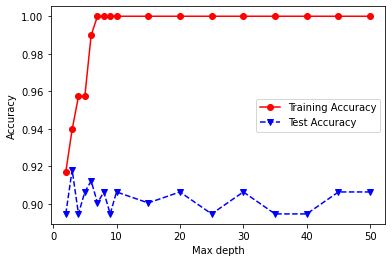

In [53]:
# Decision Tree analysis with the depth

from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
maxdepths = [2,3,4,5,6,7,8,9,10,15,20,25,30,35,40,45,50]
trainAcc = np.zeros(len(maxdepths))
testAcc = np.zeros(len(maxdepths))

index = 0
for depth in maxdepths:
    clf = DecisionTreeClassifier(max_depth=depth)
    clf = clf.fit(X_train, y_train)
    y_predTrain = clf.predict(X_train)
    y_predTest = clf.predict(X_test)
    trainAcc[index] = accuracy_score(y_train, y_predTrain)
    testAcc[index] = accuracy_score(y_test, y_predTest)
    print("Depth = ", depth, ", Training Accuracy = ", trainAcc[index], ", Test Accuracy = ", testAcc[index], 
          ", Diff = ", np.abs((trainAcc[index]-testAcc[index])*100), " %")
    index += 1

    
#########################################
# Plot of training and test accuracies
#########################################
    
plt.plot(maxdepths,trainAcc,'ro-',maxdepths,testAcc,'bv--')
plt.legend(['Training Accuracy','Test Accuracy'])
plt.xlabel('Max depth')
plt.ylabel('Accuracy');

In [54]:
# create a model 
dt2 = DecisionTreeClassifier(max_depth = 3, random_state=1)
dt2.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3, random_state=1)

In [55]:
Y_predt1=dt2.predict(X_test)

In [56]:
from sklearn.metrics import accuracy_score

In [57]:
ac_dt2=accuracy_score(y_test,Y_predt1)

In [58]:
ac_dt2

0.9181286549707602

# KNN

In [59]:
from sklearn.neighbors import KNeighborsClassifier
knn=KNeighborsClassifier()

In [60]:
knn.fit(X_train, y_train)

KNeighborsClassifier()

In [61]:
Y_pred_knn=knn.predict(X_test)

In [62]:
ac_knn1=accuracy_score(y_test,Y_pred_knn)

In [63]:
ac_knn1

0.9239766081871345

K =  1 , Training Accuracy =  1.0  Test Accuracy =  0.9181286549707602 , Difference =  8.187134502923977 %
K =  5 , Training Accuracy =  0.9698492462311558  Test Accuracy =  0.9239766081871345 , Difference =  4.587263804402131 %
K =  10 , Training Accuracy =  0.9447236180904522  Test Accuracy =  0.9181286549707602 , Difference =  2.6594963119692006 %
K =  15 , Training Accuracy =  0.9447236180904522  Test Accuracy =  0.9298245614035088 , Difference =  1.4899056686943468 %
K =  20 , Training Accuracy =  0.9346733668341709  Test Accuracy =  0.9239766081871345 , Difference =  1.0696758647036453 %
K =  25 , Training Accuracy =  0.9396984924623115  Test Accuracy =  0.9239766081871345 , Difference =  1.5721884275177067 %
K =  30 , Training Accuracy =  0.9396984924623115  Test Accuracy =  0.9239766081871345 , Difference =  1.5721884275177067 %
K =  60 , Training Accuracy =  0.9271356783919598  Test Accuracy =  0.9298245614035088 , Difference =  0.2688883011549015 %
K =  100 , Training Accurac

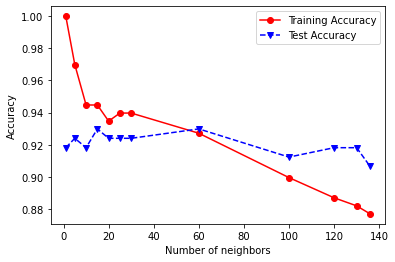

In [64]:
# KNN with Euclidean Distance Metric

from sklearn.neighbors import KNeighborsClassifier
numNeighbors = [1, 5, 10, 15, 20, 25, 30,60,100,120,130,136]
trainAcc = []
testAcc = []

for k in numNeighbors:
    clf = KNeighborsClassifier(n_neighbors=k, metric='minkowski', p=2)
    clf.fit(X_train, y_train)
    y_predTrain = clf.predict(X_train)
    y_predTest = clf.predict(X_test)
    trainAcc.append(accuracy_score(y_train, y_predTrain))
    testAcc.append(accuracy_score(y_test, y_predTest))

plt.plot(numNeighbors, trainAcc, 'ro-', numNeighbors, testAcc,'bv--')
plt.legend(['Training Accuracy','Test Accuracy'])
plt.xlabel('Number of neighbors')
plt.ylabel('Accuracy');

index = 0
for i in numNeighbors:
    print("K = ", numNeighbors[index], ", Training Accuracy = ", trainAcc[index], " Test Accuracy = ", testAcc[index], 
          ", Difference = ", np.abs(trainAcc[index]-testAcc[index])*100, "%")
    index+=1

K =  1 , Training Accuracy =  1.0  Test Accuracy =  0.9122807017543859 , Difference =  8.771929824561408 %
K =  5 , Training Accuracy =  0.9698492462311558  Test Accuracy =  0.935672514619883 , Difference =  3.417673161127277 %
K =  10 , Training Accuracy =  0.9447236180904522  Test Accuracy =  0.9473684210526315 , Difference =  0.26448029621792823 %
K =  15 , Training Accuracy =  0.949748743718593  Test Accuracy =  0.9415204678362573 , Difference =  0.8228275882335656 %
K =  20 , Training Accuracy =  0.9371859296482412  Test Accuracy =  0.935672514619883 , Difference =  0.15134150283582226 %
K =  25 , Training Accuracy =  0.9371859296482412  Test Accuracy =  0.935672514619883 , Difference =  0.15134150283582226 %
K =  30 , Training Accuracy =  0.9321608040201005  Test Accuracy =  0.935672514619883 , Difference =  0.35117105997825027 %
K =  40 , Training Accuracy =  0.9271356783919598  Test Accuracy =  0.935672514619883 , Difference =  0.8536836227923228 %
K =  50 , Training Accuracy =

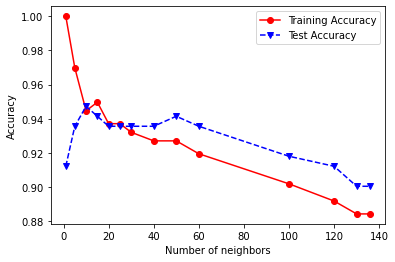

In [65]:
# KNN with Manhatten Distance Metric
numNeighbors = [1, 5, 10, 15, 20, 25, 30,40,50,60,100,120,130,136]
trainAcc = []
testAcc = []

for k in numNeighbors:
    clf = KNeighborsClassifier(n_neighbors=k, metric='minkowski', p=1)
    clf.fit(X_train, y_train)
    y_predTrain = clf.predict(X_train)
    y_predTest = clf.predict(X_test)
    trainAcc.append(accuracy_score(y_train, y_predTrain))
    testAcc.append(accuracy_score(y_test, y_predTest))

plt.plot(numNeighbors, trainAcc, 'ro-', numNeighbors, testAcc,'bv--')
plt.legend(['Training Accuracy','Test Accuracy'])
plt.xlabel('Number of neighbors')
plt.ylabel('Accuracy');

index = 0
for i in numNeighbors:
    print("K = ", numNeighbors[index], ", Training Accuracy = ", trainAcc[index], " Test Accuracy = ", testAcc[index], 
          ", Difference = ", np.abs(trainAcc[index]-testAcc[index])*100, "%")
    index+=1

In [66]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression
clf = LogisticRegression(penalty = 'none')

clf.fit(X_train, y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
print("Logistic Regression with no regularization")
print("Train Accuracy: ", accuracy_score(y_pred_train, y_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y_test))
print()


clf = LogisticRegression(penalty = 'l2')

clf.fit(X_train, y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
print("Logistic Regression with L2 regularization")
print("Train Accuracy: ", accuracy_score(y_pred_train, y_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y_test))
ac_lr1 = accuracy_score(y_pred_test, y_test)

Logistic Regression with no regularization
Train Accuracy:  0.9773869346733668
Test Accuracy:  0.9298245614035088

Logistic Regression with L2 regularization
Train Accuracy:  0.9246231155778895
Test Accuracy:  0.9298245614035088


In [67]:
ac_lr1

0.9298245614035088

# Random Forest

In [68]:
from sklearn.ensemble import RandomForestClassifier
rf=RandomForestClassifier()

In [69]:
rf.fit(X_train,y_train)

RandomForestClassifier()

In [70]:
Y_pred_rf=rf.predict(X_test)

In [71]:
ac_rf1=accuracy_score(y_test,Y_pred_rf)

In [72]:
ac_rf1

0.9415204678362573

In [73]:
from sklearn.linear_model import Perceptron
perc = Perceptron(tol=1e-3, random_state=0)
perc.fit(X_train, y_train)
y_pred_train = perc.predict(X_train)
y_pred_test = perc.predict(X_test)
print("Train Accuracy: ", accuracy_score(y_pred_train, y_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y_test))

Train Accuracy:  0.9472361809045227
Test Accuracy:  0.9590643274853801


In [74]:
ac_perceptron1 = accuracy_score(y_pred_test, y_test)

In [75]:
ac_perceptron1

0.9590643274853801

In [76]:
from sklearn.svm import SVC
clf = SVC(gamma = 'auto', random_state = 0)
clf.fit(X_train, y_train)
y_pred_train = clf.predict(X_train)
y_pred_test = clf.predict(X_test)
print("Train Accuracy: ", accuracy_score(y_pred_train, y_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y_test))


Train Accuracy:  0.8341708542713567
Test Accuracy:  0.8596491228070176


In [77]:
# for the SVC classifier
from sklearn import metrics
print("Confusion Matrix for the Test Case")
print(metrics.confusion_matrix(y_test, y_pred_test))
print()
print("Classification Report")
print(metrics.classification_report(y_test, y_pred_test, digits = 3))

Confusion Matrix for the Test Case
[[108   0]
 [ 24  39]]

Classification Report
              precision    recall  f1-score   support

           B      0.818     1.000     0.900       108
           M      1.000     0.619     0.765        63

    accuracy                          0.860       171
   macro avg      0.909     0.810     0.832       171
weighted avg      0.885     0.860     0.850       171



In [78]:
ac_svc1 = accuracy_score(y_pred_test, y_test)

In [79]:
ac_svc1

0.8596491228070176

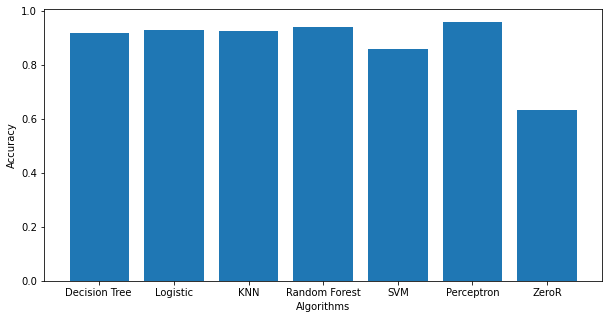

In [80]:
plt.figure(figsize = (10,5))
plt.bar(['Decision Tree ','Logistic','KNN','Random Forest','SVM','Perceptron','ZeroR'],
        [ac_dt2,ac_lr1,ac_knn1,ac_rf1,ac_svc1,ac_perceptron1,ac_zero1])
plt.xlabel("Algorithms")
plt.ylabel("Accuracy")
plt.show()

# Hyper Parameter Optimization

# DT HPT

In [232]:
#Manual

In [233]:
dt=DecisionTreeClassifier(max_depth=3,criterion= 'gini', min_samples_split= 10, splitter= 'best')
dt.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=3, min_samples_split=10)

In [234]:
prediction=dt.predict(X_test)
accuracy_dt=accuracy_score(y_test,prediction)*100
accuracy_dt

91.81286549707602

In [235]:
print("Accuracy on training set: {:.3f}".format(dt.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(dt.score(X_test, y_test)))

Accuracy on training set: 0.940
Accuracy on test set: 0.918


In [236]:
accuracy_score(prediction,y_test)

0.9181286549707602

In [237]:
#now let's try to do hyperparameter

In [238]:
dt.get_params().keys()

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'random_state', 'splitter'])

In [239]:
#let's try with Randomized Search Cv

In [240]:
import numpy as np
from sklearn.model_selection import RandomizedSearchCV
# Number of features to consider at every split
max_features = ['auto', 'sqrt','log2']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(1, 1000,10)]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10,14]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4,6,8]
splitter = ["best", "random"]
# Create the random grid
random_grid = {'splitter': splitter,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
              'criterion':['entropy','gini']}
print(random_grid)

{'splitter': ['best', 'random'], 'max_features': ['auto', 'sqrt', 'log2'], 'max_depth': [1, 112, 223, 334, 445, 556, 667, 778, 889, 1000], 'min_samples_split': [2, 5, 10, 14], 'min_samples_leaf': [1, 2, 4, 6, 8], 'criterion': ['entropy', 'gini']}


In [241]:
rf=DecisionTreeClassifier()
rf_randomcv=RandomizedSearchCV(estimator=rf,param_distributions=random_grid,n_iter=100,cv=3,verbose=2,
                               random_state=100,n_jobs=-1)
### fit the randomized model
rf_randomcv.fit(X_train,y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=DecisionTreeClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [1, 112, 223, 334, 445,
                                                      556, 667, 778, 889,
                                                      1000],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': [1, 2, 4, 6, 8],
                                        'min_samples_split': [2, 5, 10, 14],
                                        'splitter': ['best', 'random']},
                   random_state=100, verbose=2)

In [242]:
rf_randomcv.best_params_

{'splitter': 'best',
 'min_samples_split': 2,
 'min_samples_leaf': 8,
 'max_features': 'auto',
 'max_depth': 556,
 'criterion': 'entropy'}

In [243]:
rf_randomcv.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=556, max_features='auto',
                       min_samples_leaf=8)

In [244]:
best_random_grid=rf_randomcv.best_estimator_

In [245]:
from sklearn.metrics import accuracy_score
y_pred=best_random_grid.predict(X_test)

print("Accuracy Score {}".format(accuracy_score(y_test,y_pred)))


Accuracy Score 0.9122807017543859


In [246]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score

In [247]:
print(confusion_matrix(y_test,y_pred))
print(accuracy_score(y_test,y_pred))
print(classification_report(y_test,y_pred))

[[101   7]
 [  8  55]]
0.9122807017543859
              precision    recall  f1-score   support

           B       0.93      0.94      0.93       108
           M       0.89      0.87      0.88        63

    accuracy                           0.91       171
   macro avg       0.91      0.90      0.91       171
weighted avg       0.91      0.91      0.91       171



In [248]:
#GridSearch CV 

In [249]:
rf_randomcv.best_params_

{'splitter': 'best',
 'min_samples_split': 2,
 'min_samples_leaf': 8,
 'max_features': 'auto',
 'max_depth': 556,
 'criterion': 'entropy'}

In [250]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'criterion': [rf_randomcv.best_params_['criterion']],
    'max_depth': [rf_randomcv.best_params_['max_depth']],
    'max_features': [rf_randomcv.best_params_['max_features']],
    'min_samples_leaf': [rf_randomcv.best_params_['min_samples_leaf'], 
                         rf_randomcv.best_params_['min_samples_leaf']+2, 
                         rf_randomcv.best_params_['min_samples_leaf'] + 4],
    'min_samples_split': [rf_randomcv.best_params_['min_samples_split'] + 2,
                          rf_randomcv.best_params_['min_samples_split'] + 1,
                          rf_randomcv.best_params_['min_samples_split'], 
                          rf_randomcv.best_params_['min_samples_split'] + 3,
                          rf_randomcv.best_params_['min_samples_split'] + 4],
    'splitter': [rf_randomcv.best_params_['splitter']]}

print(param_grid)

{'criterion': ['entropy'], 'max_depth': [556], 'max_features': ['auto'], 'min_samples_leaf': [8, 10, 12], 'min_samples_split': [4, 3, 2, 5, 6], 'splitter': ['best']}


In [251]:
rf2=DecisionTreeClassifier()
grid_search=GridSearchCV(estimator=rf2,param_grid=param_grid,cv=10,n_jobs=-1,verbose=2)
grid_search.fit(X_train,y_train)


Fitting 10 folds for each of 15 candidates, totalling 150 fits


GridSearchCV(cv=10, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'], 'max_depth': [556],
                         'max_features': ['auto'],
                         'min_samples_leaf': [8, 10, 12],
                         'min_samples_split': [4, 3, 2, 5, 6],
                         'splitter': ['best']},
             verbose=2)

In [252]:
grid_search.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=556, max_features='auto',
                       min_samples_leaf=12, min_samples_split=6)

In [253]:
best_grid=grid_search.best_estimator_

In [254]:
best_grid

DecisionTreeClassifier(criterion='entropy', max_depth=556, max_features='auto',
                       min_samples_leaf=12, min_samples_split=6)

In [255]:
y_pred=best_grid.predict(X_test)
print(confusion_matrix(y_test,y_pred))
print("Accuracy Score {}".format(accuracy_score(y_test,y_pred)))
print("Classification report: {}".format(classification_report(y_test,y_pred)))

[[100   8]
 [ 12  51]]
Accuracy Score 0.8830409356725146
Classification report:               precision    recall  f1-score   support

           B       0.89      0.93      0.91       108
           M       0.86      0.81      0.84        63

    accuracy                           0.88       171
   macro avg       0.88      0.87      0.87       171
weighted avg       0.88      0.88      0.88       171



# KNN HPT

In [256]:
#Manual

In [257]:
knn=KNeighborsClassifier(n_neighbors=5, metric='minkowski', p=2)
knn.fit(X_train,y_train)

KNeighborsClassifier()

In [258]:
pred1=knn.predict(X_test)
accuracy_knn=accuracy_score(y_test,pred1)*100
accuracy_knn

91.81286549707602

In [259]:
print("Accuracy on training set: {:.3f}".format(knn.score(X_train, y_train)))
print("Accuracy on test set: {:.3f}".format(knn.score(X_test, y_test)))

Accuracy on training set: 0.957
Accuracy on test set: 0.918


In [260]:
accuracy_score(pred1,y_test)

0.9181286549707602

In [261]:
#now let's try to do hyperparameter

In [262]:
knn.get_params().keys()

dict_keys(['algorithm', 'leaf_size', 'metric', 'metric_params', 'n_jobs', 'n_neighbors', 'p', 'weights'])

In [263]:
#let's try with Randomized Search Cv

In [264]:
import numpy as np
from sklearn.model_selection import RandomizedSearchCV
n_neighbors = range(1, 200)
weights = ['uniform', 'distance']
metric = ['euclidean', 'manhattan', 'minkowski']

# Create the random grid
random_grid1 = {'n_neighbors': n_neighbors,
               'weights': weights,
               'metric': metric
               }
print(random_grid1)

{'n_neighbors': range(1, 200), 'weights': ['uniform', 'distance'], 'metric': ['euclidean', 'manhattan', 'minkowski']}


In [265]:
rf3=KNeighborsClassifier()
rf3_randomcv=RandomizedSearchCV(estimator=rf3,param_distributions=random_grid1,n_iter=100,cv=3,verbose=2,
                               random_state=100,n_jobs=-1)
### fit the randomized model
rf3_randomcv.fit(X_train,y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=KNeighborsClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'metric': ['euclidean', 'manhattan',
                                                   'minkowski'],
                                        'n_neighbors': range(1, 200),
                                        'weights': ['uniform', 'distance']},
                   random_state=100, verbose=2)

In [266]:
rf3_randomcv.best_params_

{'weights': 'distance', 'n_neighbors': 8, 'metric': 'manhattan'}

In [267]:
rf3_randomcv.best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=8, weights='distance')

In [268]:
best_random_grid1=rf3_randomcv.best_estimator_

In [269]:
from sklearn.metrics import accuracy_score
y_pred=best_random_grid1.predict(X_test)

print("Accuracy Score {}".format(accuracy_score(y_test,y_pred)))


Accuracy Score 0.9298245614035088


In [270]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score

In [271]:
print(confusion_matrix(y_test,y_pred))
print(accuracy_score(y_test,y_pred))
print(classification_report(y_test,y_pred))

[[104   4]
 [  8  55]]
0.9298245614035088
              precision    recall  f1-score   support

           B       0.93      0.96      0.95       108
           M       0.93      0.87      0.90        63

    accuracy                           0.93       171
   macro avg       0.93      0.92      0.92       171
weighted avg       0.93      0.93      0.93       171



In [272]:
#GridSearch CV 

In [273]:
rf3_randomcv.best_params_

{'weights': 'distance', 'n_neighbors': 8, 'metric': 'manhattan'}

In [274]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'weights': [rf3_randomcv.best_params_['weights']],
    
    'n_neighbors': [rf3_randomcv.best_params_['n_neighbors'], 
                         rf3_randomcv.best_params_['n_neighbors']+2, 
                         rf3_randomcv.best_params_['n_neighbors'] + 4,
                   rf3_randomcv.best_params_['n_neighbors']-2, 
                         rf3_randomcv.best_params_['n_neighbors'] - 4],
    'metric': [rf3_randomcv.best_params_['metric']]}

print(param_grid)

{'weights': ['distance'], 'n_neighbors': [8, 10, 12, 6, 4], 'metric': ['manhattan']}


In [275]:
rf4=KNeighborsClassifier()
grid_search=GridSearchCV(estimator=rf4,param_grid=param_grid,cv=10,n_jobs=-1,verbose=2)
grid_search.fit(X_train,y_train)


Fitting 10 folds for each of 5 candidates, totalling 50 fits


GridSearchCV(cv=10, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'metric': ['manhattan'],
                         'n_neighbors': [8, 10, 12, 6, 4],
                         'weights': ['distance']},
             verbose=2)

In [276]:
grid_search.best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=6, weights='distance')

In [277]:
best_grid1=grid_search.best_estimator_

In [278]:
best_grid1

KNeighborsClassifier(metric='manhattan', n_neighbors=6, weights='distance')

In [279]:
y_pred4=best_grid1.predict(X_test)
print(confusion_matrix(y_test,y_pred4))
print("Accuracy Score {}".format(accuracy_score(y_test,y_pred4)))
print("Classification report: {}".format(classification_report(y_test,y_pred4)))

[[106   2]
 [  8  55]]
Accuracy Score 0.9415204678362573
Classification report:               precision    recall  f1-score   support

           B       0.93      0.98      0.95       108
           M       0.96      0.87      0.92        63

    accuracy                           0.94       171
   macro avg       0.95      0.93      0.94       171
weighted avg       0.94      0.94      0.94       171



# Logistic regression

In [280]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression
clf6 = LogisticRegression(penalty = 'none')

clf6.fit(X_train, y_train)
y_pred_train = clf6.predict(X_train)
y_pred_test = clf6.predict(X_test)
print("Logistic Regression with no regularization")
print("Train Accuracy: ", accuracy_score(y_pred_train, y_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y_test))
print()



Logistic Regression with no regularization
Train Accuracy:  0.964824120603015
Test Accuracy:  0.9415204678362573



In [281]:
clf6.get_params().keys()

dict_keys(['C', 'class_weight', 'dual', 'fit_intercept', 'intercept_scaling', 'l1_ratio', 'max_iter', 'multi_class', 'n_jobs', 'penalty', 'random_state', 'solver', 'tol', 'verbose', 'warm_start'])

In [282]:
from sklearn.datasets import make_blobs
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
# define models and parameters
model = LogisticRegression()
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]
# define grid search
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X_train, y_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.958889 using {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.958077 (0.033323) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.958077 (0.033323) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.958889 (0.034126) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.942949 (0.035554) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.942949 (0.035554) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.942115 (0.034484) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.916090 (0.038557) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.916090 (0.038557) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.907692 (0.043839) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.839038 (0.049640) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.839038 (0.049640) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.851603 (0.049055) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
0.625641 (0.005875) wit

In [283]:
grid_y_predicted = grid_result.predict(X_test)

In [284]:
grid_y_predicted

array(['M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B',
       'B', 'M', 'M', 'B', 'M', 'M', 'M', 'M', 'M', 'B', 'B', 'M', 'B',
       'B', 'M', 'B', 'M', 'B', 'M', 'B', 'M', 'B', 'M', 'B', 'M', 'B',
       'M', 'M', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'M',
       'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'M', 'M', 'B', 'B', 'M',
       'B', 'M', 'M', 'M', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B',
       'B', 'B', 'M', 'M', 'M', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'B',
       'M', 'M', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'M',
       'M', 'B', 'M', 'B', 'B', 'M', 'B', 'M', 'M', 'B', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'B', 'M', 'B', 'M', 'B', 'B', 'B', 'B', 'B',
       'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M',
       'B', 'B', 'M', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M',
       'B', 'M', 'B', 'M', 'M', 'B', 'B', 'M', 'B', 'M', 'M', 'M', 'B',
       'B', 'B'], dtype=object)

In [285]:
logis_grid_score=accuracy_score(y_test, grid_y_predicted)

In [286]:
logis_grid_score

0.9532163742690059

In [287]:
confusion_matrix(y_test, grid_y_predicted)

array([[103,   5],
       [  3,  60]], dtype=int64)

In [288]:
print(classification_report(y_test,grid_y_predicted))

              precision    recall  f1-score   support

           B       0.97      0.95      0.96       108
           M       0.92      0.95      0.94        63

    accuracy                           0.95       171
   macro avg       0.95      0.95      0.95       171
weighted avg       0.95      0.95      0.95       171



Accuracy did not improve much after hyper parameter tuning 

# With Stratified Train Test split

In [289]:
from sklearn import metrics

# With train-test split

# ZeroR classifier

In [290]:
# ZeroR classifier

from sklearn.dummy import DummyClassifier
from sklearn.metrics import accuracy_score
clf = DummyClassifier(strategy = "most_frequent")
clf.fit(X1_train, y1_train)
y_pred_train = clf.predict(X1_train)
y_pred_test = clf.predict(X1_test)
print("Train Accuracy: ", accuracy_score(y_pred_train, y1_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y1_test))

Train Accuracy:  0.628140703517588
Test Accuracy:  0.6257309941520468


In [291]:
ac_zero2 = accuracy_score(y_pred_test, y1_test)

In [292]:
ac_zero2

0.6257309941520468

In [293]:
#As there is class imbalance issue,we need classification report as well

In [294]:
print("Confusion Matrix for the Test Case")
print(metrics.confusion_matrix(y1_test, y_pred_test))
print()
print("Classification Report")
print(metrics.classification_report(y1_test, y_pred_test, digits = 3))

Confusion Matrix for the Test Case
[[107   0]
 [ 64   0]]

Classification Report
              precision    recall  f1-score   support

           B      0.626     1.000     0.770       107
           M      0.000     0.000     0.000        64

    accuracy                          0.626       171
   macro avg      0.313     0.500     0.385       171
weighted avg      0.392     0.626     0.482       171



# Decision Tree

In [295]:
from sklearn.tree import DecisionTreeClassifier
dt=DecisionTreeClassifier()

In [296]:
dt.fit(X1_train, y1_train)

DecisionTreeClassifier()

In [297]:
Y_pred=dt.predict(X1_test)

In [298]:
from sklearn.metrics import accuracy_score

In [299]:
ac_dt4=accuracy_score(y1_test,Y_pred)

In [300]:
ac_dt4

0.8947368421052632

Depth =  2 , Training Accuracy =  0.9271356783919598 , Test Accuracy =  0.9005847953216374 , Diff =  2.6550883070322384  %
Depth =  3 , Training Accuracy =  0.949748743718593 , Test Accuracy =  0.8830409356725146 , Diff =  6.670780804607834  %
Depth =  4 , Training Accuracy =  0.9673366834170855 , Test Accuracy =  0.9181286549707602 , Diff =  4.920802844632521  %
Depth =  5 , Training Accuracy =  0.9824120603015075 , Test Accuracy =  0.9005847953216374 , Diff =  8.182726497987014  %
Depth =  6 , Training Accuracy =  0.9974874371859297 , Test Accuracy =  0.9122807017543859 , Diff =  8.520673543154377  %
Depth =  7 , Training Accuracy =  1.0 , Test Accuracy =  0.9122807017543859 , Diff =  8.771929824561408  %
Depth =  8 , Training Accuracy =  1.0 , Test Accuracy =  0.9064327485380117 , Diff =  9.35672514619883  %
Depth =  9 , Training Accuracy =  1.0 , Test Accuracy =  0.8947368421052632 , Diff =  10.526315789473683  %
Depth =  10 , Training Accuracy =  1.0 , Test Accuracy =  0.894736842

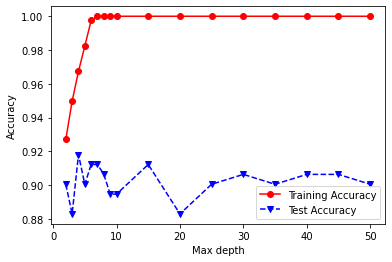

In [301]:
# Decision Tree analysis with the depth

from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
maxdepths = [2,3,4,5,6,7,8,9,10,15,20,25,30,35,40,45,50]
trainAcc = np.zeros(len(maxdepths))
testAcc = np.zeros(len(maxdepths))

index = 0
for depth in maxdepths:
    clf = DecisionTreeClassifier(max_depth=depth)
    clf = clf.fit(X1_train, y1_train)
    y_predTrain = clf.predict(X1_train)
    y_predTest = clf.predict(X1_test)
    trainAcc[index] = accuracy_score(y1_train, y_predTrain)
    testAcc[index] = accuracy_score(y1_test, y_predTest)
    print("Depth = ", depth, ", Training Accuracy = ", trainAcc[index], ", Test Accuracy = ", testAcc[index], 
          ", Diff = ", np.abs((trainAcc[index]-testAcc[index])*100), " %")
    index += 1

    
#########################################
# Plot of training and test accuracies
#########################################
    
plt.plot(maxdepths,trainAcc,'ro-',maxdepths,testAcc,'bv--')
plt.legend(['Training Accuracy','Test Accuracy'])
plt.xlabel('Max depth')
plt.ylabel('Accuracy');

In [302]:
# create a model 
dt5 = DecisionTreeClassifier(max_depth = 2, random_state=1)
dt5.fit(X1_train, y1_train)

DecisionTreeClassifier(max_depth=2, random_state=1)

In [303]:
Y_predt1=dt5.predict(X1_test)

In [304]:
from sklearn.metrics import accuracy_score

In [305]:
ac_dt2=accuracy_score(y1_test,Y_predt1)

In [306]:
ac_dt2

0.9005847953216374

# KNN

In [307]:
from sklearn.neighbors import KNeighborsClassifier
knn=KNeighborsClassifier()

In [308]:
knn.fit(X1_train, y1_train)

KNeighborsClassifier()

In [309]:
Y_pred_knn=knn.predict(X1_test)

In [310]:
ac_knn1=accuracy_score(y1_test,Y_pred_knn)

In [311]:
ac_knn1

0.9181286549707602

K =  1 , Training Accuracy =  1.0  Test Accuracy =  0.9181286549707602 , Difference =  8.187134502923977 %
K =  5 , Training Accuracy =  0.9472361809045227  Test Accuracy =  0.9181286549707602 , Difference =  2.9107525933762424 %
K =  10 , Training Accuracy =  0.9221105527638191  Test Accuracy =  0.9239766081871345 , Difference =  0.18660554233153048 %
K =  15 , Training Accuracy =  0.9221105527638191  Test Accuracy =  0.9473684210526315 , Difference =  2.525786828881238 %
K =  20 , Training Accuracy =  0.9170854271356784  Test Accuracy =  0.9181286549707602 , Difference =  0.1043227835081817 %
K =  25 , Training Accuracy =  0.9195979899497487  Test Accuracy =  0.935672514619883 , Difference =  1.607452467013426 %
K =  30 , Training Accuracy =  0.9095477386934674  Test Accuracy =  0.9181286549707602 , Difference =  0.8580916277292849 %
K =  60 , Training Accuracy =  0.8994974874371859  Test Accuracy =  0.8947368421052632 , Difference =  0.4760645331922775 %
K =  100 , Training Accuracy

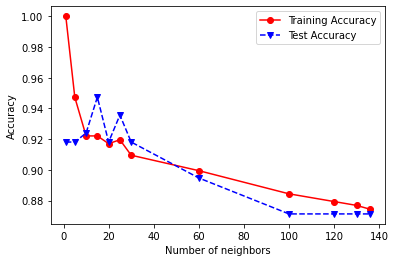

In [312]:
# KNN with Euclidean Distance Metric

from sklearn.neighbors import KNeighborsClassifier
numNeighbors = [1, 5, 10, 15, 20, 25, 30,60,100,120,130,136]
trainAcc = []
testAcc = []

for k in numNeighbors:
    clf = KNeighborsClassifier(n_neighbors=k, metric='minkowski', p=2)
    clf.fit(X1_train, y1_train)
    y_predTrain = clf.predict(X1_train)
    y_predTest = clf.predict(X1_test)
    trainAcc.append(accuracy_score(y1_train, y_predTrain))
    testAcc.append(accuracy_score(y1_test, y_predTest))

plt.plot(numNeighbors, trainAcc, 'ro-', numNeighbors, testAcc,'bv--')
plt.legend(['Training Accuracy','Test Accuracy'])
plt.xlabel('Number of neighbors')
plt.ylabel('Accuracy');

index = 0
for i in numNeighbors:
    print("K = ", numNeighbors[index], ", Training Accuracy = ", trainAcc[index], " Test Accuracy = ", testAcc[index], 
          ", Difference = ", np.abs(trainAcc[index]-testAcc[index])*100, "%")
    index+=1

K =  1 , Training Accuracy =  1.0  Test Accuracy =  0.9239766081871345 , Difference =  7.602339181286554 %
K =  5 , Training Accuracy =  0.9597989949748744  Test Accuracy =  0.9298245614035088 , Difference =  2.9974433571365644 %
K =  10 , Training Accuracy =  0.9422110552763819  Test Accuracy =  0.9298245614035088 , Difference =  1.238649387287316 %
K =  15 , Training Accuracy =  0.9346733668341709  Test Accuracy =  0.9415204678362573 , Difference =  0.6847101002086409 %
K =  20 , Training Accuracy =  0.9271356783919598  Test Accuracy =  0.9415204678362573 , Difference =  1.4384789444297552 %
K =  25 , Training Accuracy =  0.9271356783919598  Test Accuracy =  0.935672514619883 , Difference =  0.8536836227923228 %
K =  30 , Training Accuracy =  0.9195979899497487  Test Accuracy =  0.9473684210526315 , Difference =  2.7770431102882798 %
K =  40 , Training Accuracy =  0.9195979899497487  Test Accuracy =  0.9415204678362573 , Difference =  2.1922477886508585 %
K =  50 , Training Accuracy 

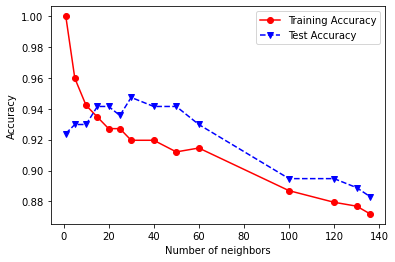

In [313]:
# KNN with Manhatten Distance Metric
numNeighbors = [1, 5, 10, 15, 20, 25, 30,40,50,60,100,120,130,136]
trainAcc = []
testAcc = []

for k in numNeighbors:
    clf = KNeighborsClassifier(n_neighbors=k, metric='minkowski', p=1)
    clf.fit(X1_train, y1_train)
    y_predTrain = clf.predict(X1_train)
    y_predTest = clf.predict(X1_test)
    trainAcc.append(accuracy_score(y1_train, y_predTrain))
    testAcc.append(accuracy_score(y1_test, y_predTest))

plt.plot(numNeighbors, trainAcc, 'ro-', numNeighbors, testAcc,'bv--')
plt.legend(['Training Accuracy','Test Accuracy'])
plt.xlabel('Number of neighbors')
plt.ylabel('Accuracy');

index = 0
for i in numNeighbors:
    print("K = ", numNeighbors[index], ", Training Accuracy = ", trainAcc[index], " Test Accuracy = ", testAcc[index], 
          ", Difference = ", np.abs(trainAcc[index]-testAcc[index])*100, "%")
    index+=1

In [314]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression
lr2 = LogisticRegression(penalty = 'none')

lr2.fit(X1_train, y1_train)
y_pred_train = lr2.predict(X1_train)
y_pred_test = lr2.predict(X1_test)
print("Logistic Regression with no regularization")
print("Train Accuracy: ", accuracy_score(y_pred_train, y1_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y1_test))
print()
ac_lr1 = accuracy_score(y_pred_test, y1_test)

lr3 = LogisticRegression(penalty = 'l2')

lr3.fit(X1_train, y1_train)
y_pred_train = lr3.predict(X1_train)
y_pred_test = lr3.predict(X1_test)
print("Logistic Regression with L2 regularization")
print("Train Accuracy: ", accuracy_score(y_pred_train, y1_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y1_test))

Logistic Regression with no regularization
Train Accuracy:  0.9874371859296482
Test Accuracy:  0.9122807017543859

Logistic Regression with L2 regularization
Train Accuracy:  0.9170854271356784
Test Accuracy:  0.9298245614035088


In [315]:
ac_lr1

0.9122807017543859

# Random Forest

In [316]:
from sklearn.ensemble import RandomForestClassifier
rf=RandomForestClassifier()

In [317]:
rf.fit(X1_train,y1_train)

RandomForestClassifier()

In [318]:
Y_pred_rf=rf.predict(X1_test)

In [319]:
ac_rf1=accuracy_score(y1_test,Y_pred_rf)

In [320]:
ac_rf1

0.9239766081871345

In [321]:
from sklearn.linear_model import Perceptron
perc1 = Perceptron(tol=1e-3, random_state=0)
perc1.fit(X1_train, y1_train)
y_pred_train = perc1.predict(X1_train)
y_pred_test = perc1.predict(X1_test)
print("Train Accuracy: ", accuracy_score(y_pred_train, y1_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y1_test))

Train Accuracy:  0.9447236180904522
Test Accuracy:  0.9298245614035088


In [322]:
ac_perceptron1 = accuracy_score(y_pred_test, y1_test)

In [323]:
ac_perceptron1

0.9298245614035088

In [324]:
from sklearn.svm import SVC
clf = SVC(gamma = 'auto', random_state = 0)
clf.fit(X1_train, y1_train)
y_pred_train = clf.predict(X1_train)
y_pred_test = clf.predict(X1_test)
print("Train Accuracy: ", accuracy_score(y_pred_train, y1_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y1_test))


Train Accuracy:  0.8793969849246231
Test Accuracy:  0.8771929824561403


In [325]:
# for the SVC classifier
from sklearn import metrics
print("Confusion Matrix for the Test Case")
print(metrics.confusion_matrix(y1_test, y_pred_test))
print()
print("Classification Report")
print(metrics.classification_report(y1_test, y_pred_test, digits = 3))

Confusion Matrix for the Test Case
[[107   0]
 [ 21  43]]

Classification Report
              precision    recall  f1-score   support

           B      0.836     1.000     0.911       107
           M      1.000     0.672     0.804        64

    accuracy                          0.877       171
   macro avg      0.918     0.836     0.857       171
weighted avg      0.897     0.877     0.871       171



In [326]:
ac_svc1 = accuracy_score(y_pred_test, y1_test)

In [327]:
ac_svc1

0.8771929824561403

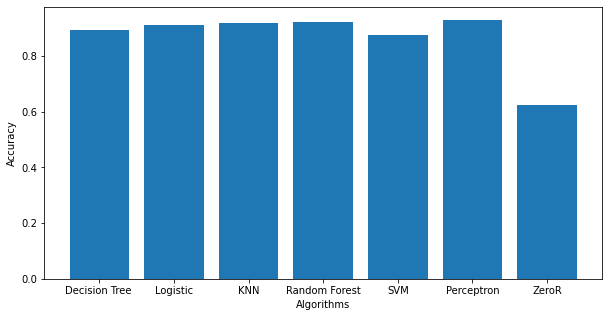

In [330]:
plt.figure(figsize = (10,5))
plt.bar(['Decision Tree ','Logistic','KNN','Random Forest','SVM','Perceptron','ZeroR'],
        [ac_dt4,ac_lr1,ac_knn1,ac_rf1,ac_svc1,ac_perceptron1,ac_zero2])
plt.xlabel("Algorithms")
plt.ylabel("Accuracy")
plt.show()

# Hyper Parameter Optimization

# DT HPT

In [331]:
#Manual

In [332]:
dt=DecisionTreeClassifier(max_depth=3,criterion= 'gini', min_samples_split= 10, splitter= 'best')
dt.fit(X1_train,y1_train)

DecisionTreeClassifier(max_depth=3, min_samples_split=10)

In [333]:
prediction=dt.predict(X1_test)
accuracy_dt=accuracy_score(y1_test,prediction)*100
accuracy_dt

89.47368421052632

In [334]:
print("Accuracy on training set: {:.3f}".format(dt.score(X1_train, y1_train)))
print("Accuracy on test set: {:.3f}".format(dt.score(X1_test, y1_test)))

Accuracy on training set: 0.950
Accuracy on test set: 0.895


In [335]:
accuracy_score(prediction,y1_test)

0.8947368421052632

In [336]:
#now let's try to do hyperparameter

In [337]:
dt.get_params().keys()

dict_keys(['ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'min_impurity_decrease', 'min_impurity_split', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'random_state', 'splitter'])

In [338]:
#let's try with Randomized Search Cv

In [339]:
import numpy as np
from sklearn.model_selection import RandomizedSearchCV
# Number of features to consider at every split
max_features = ['auto', 'sqrt','log2']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(1, 1000,10)]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10,14]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4,6,8]
splitter = ["best", "random"]
# Create the random grid
random_grid = {'splitter': splitter,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
              'criterion':['entropy','gini']}
print(random_grid)

{'splitter': ['best', 'random'], 'max_features': ['auto', 'sqrt', 'log2'], 'max_depth': [1, 112, 223, 334, 445, 556, 667, 778, 889, 1000], 'min_samples_split': [2, 5, 10, 14], 'min_samples_leaf': [1, 2, 4, 6, 8], 'criterion': ['entropy', 'gini']}


In [340]:
rf=DecisionTreeClassifier()
rf_randomcv=RandomizedSearchCV(estimator=rf,param_distributions=random_grid,n_iter=100,cv=3,verbose=2,
                               random_state=100,n_jobs=-1)
### fit the randomized model
rf_randomcv.fit(X1_train,y1_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=DecisionTreeClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'criterion': ['entropy', 'gini'],
                                        'max_depth': [1, 112, 223, 334, 445,
                                                      556, 667, 778, 889,
                                                      1000],
                                        'max_features': ['auto', 'sqrt',
                                                         'log2'],
                                        'min_samples_leaf': [1, 2, 4, 6, 8],
                                        'min_samples_split': [2, 5, 10, 14],
                                        'splitter': ['best', 'random']},
                   random_state=100, verbose=2)

In [341]:
rf_randomcv.best_params_

{'splitter': 'best',
 'min_samples_split': 14,
 'min_samples_leaf': 8,
 'max_features': 'log2',
 'max_depth': 112,
 'criterion': 'entropy'}

In [342]:
rf_randomcv.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=112, max_features='log2',
                       min_samples_leaf=8, min_samples_split=14)

In [343]:
best_random_grid=rf_randomcv.best_estimator_

In [344]:
from sklearn.metrics import accuracy_score
y_pred=best_random_grid.predict(X1_test)

print("Accuracy Score {}".format(accuracy_score(y_test,y_pred)))


Accuracy Score 0.4678362573099415


In [345]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score

In [346]:
print(confusion_matrix(y1_test,y_pred))
print(accuracy_score(y1_test,y_pred))
print(classification_report(y1_test,y_pred))

[[90 17]
 [13 51]]
0.8245614035087719
              precision    recall  f1-score   support

           B       0.87      0.84      0.86       107
           M       0.75      0.80      0.77        64

    accuracy                           0.82       171
   macro avg       0.81      0.82      0.81       171
weighted avg       0.83      0.82      0.83       171



In [347]:
#GridSearch CV 

In [348]:
rf_randomcv.best_params_

{'splitter': 'best',
 'min_samples_split': 14,
 'min_samples_leaf': 8,
 'max_features': 'log2',
 'max_depth': 112,
 'criterion': 'entropy'}

In [349]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'criterion': [rf_randomcv.best_params_['criterion']],
    'max_depth': [rf_randomcv.best_params_['max_depth']],
    'max_features': [rf_randomcv.best_params_['max_features']],
    'min_samples_leaf': [rf_randomcv.best_params_['min_samples_leaf'], 
                         rf_randomcv.best_params_['min_samples_leaf']+2, 
                         rf_randomcv.best_params_['min_samples_leaf'] + 4],
    'min_samples_split': [rf_randomcv.best_params_['min_samples_split'] + 2,
                          rf_randomcv.best_params_['min_samples_split'] + 1,
                          rf_randomcv.best_params_['min_samples_split'], 
                          rf_randomcv.best_params_['min_samples_split'] + 3,
                          rf_randomcv.best_params_['min_samples_split'] + 4],
    'splitter': [rf_randomcv.best_params_['splitter']]}

print(param_grid)

{'criterion': ['entropy'], 'max_depth': [112], 'max_features': ['log2'], 'min_samples_leaf': [8, 10, 12], 'min_samples_split': [16, 15, 14, 17, 18], 'splitter': ['best']}


In [350]:
rf2=DecisionTreeClassifier()
grid_search=GridSearchCV(estimator=rf2,param_grid=param_grid,cv=10,n_jobs=-1,verbose=2)
grid_search.fit(X1_train,y1_train)


Fitting 10 folds for each of 15 candidates, totalling 150 fits


GridSearchCV(cv=10, estimator=DecisionTreeClassifier(), n_jobs=-1,
             param_grid={'criterion': ['entropy'], 'max_depth': [112],
                         'max_features': ['log2'],
                         'min_samples_leaf': [8, 10, 12],
                         'min_samples_split': [16, 15, 14, 17, 18],
                         'splitter': ['best']},
             verbose=2)

In [351]:
grid_search.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=112, max_features='log2',
                       min_samples_leaf=8, min_samples_split=16)

In [352]:
best_grid=grid_search.best_estimator_

In [353]:
best_grid

DecisionTreeClassifier(criterion='entropy', max_depth=112, max_features='log2',
                       min_samples_leaf=8, min_samples_split=16)

In [354]:
y_pred=best_grid.predict(X1_test)
print(confusion_matrix(y1_test,y_pred))
print("Accuracy Score {}".format(accuracy_score(y1_test,y_pred)))
print("Classification report: {}".format(classification_report(y1_test,y_pred)))

[[98  9]
 [ 8 56]]
Accuracy Score 0.9005847953216374
Classification report:               precision    recall  f1-score   support

           B       0.92      0.92      0.92       107
           M       0.86      0.88      0.87        64

    accuracy                           0.90       171
   macro avg       0.89      0.90      0.89       171
weighted avg       0.90      0.90      0.90       171



# KNN HPT

In [355]:
#Manual

In [356]:
knn=KNeighborsClassifier(n_neighbors=30, metric='minkowski', p=2)
knn.fit(X1_train,y1_train)

KNeighborsClassifier(n_neighbors=30)

In [357]:
pred1=knn.predict(X1_test)
accuracy_knn=accuracy_score(y1_test,pred1)*100
accuracy_knn

91.81286549707602

In [358]:
print("Accuracy on training set: {:.3f}".format(knn.score(X1_train, y1_train)))
print("Accuracy on test set: {:.3f}".format(knn.score(X1_test, y1_test)))

Accuracy on training set: 0.910
Accuracy on test set: 0.918


In [359]:
accuracy_score(pred1,y1_test)

0.9181286549707602

In [360]:
#now let's try to do hyperparameter

In [361]:
knn.get_params().keys()

dict_keys(['algorithm', 'leaf_size', 'metric', 'metric_params', 'n_jobs', 'n_neighbors', 'p', 'weights'])

In [362]:
#let's try with Randomized Search Cv

In [363]:
import numpy as np
from sklearn.model_selection import RandomizedSearchCV
n_neighbors = range(1, 200)
weights = ['uniform', 'distance']
metric = ['euclidean', 'manhattan', 'minkowski']

# Create the random grid
random_grid1 = {'n_neighbors': n_neighbors,
               'weights': weights,
               'metric': metric
               }
print(random_grid1)

{'n_neighbors': range(1, 200), 'weights': ['uniform', 'distance'], 'metric': ['euclidean', 'manhattan', 'minkowski']}


In [364]:
rf3=KNeighborsClassifier()
rf3_randomcv=RandomizedSearchCV(estimator=rf3,param_distributions=random_grid1,n_iter=100,cv=3,verbose=2,
                               random_state=100,n_jobs=-1)
### fit the randomized model
rf3_randomcv.fit(X1_train,y1_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


RandomizedSearchCV(cv=3, estimator=KNeighborsClassifier(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'metric': ['euclidean', 'manhattan',
                                                   'minkowski'],
                                        'n_neighbors': range(1, 200),
                                        'weights': ['uniform', 'distance']},
                   random_state=100, verbose=2)

In [365]:
rf3_randomcv.best_params_

{'weights': 'distance', 'n_neighbors': 8, 'metric': 'manhattan'}

In [366]:
rf3_randomcv.best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=8, weights='distance')

In [367]:
best_random_grid1=rf3_randomcv.best_estimator_

In [368]:
from sklearn.metrics import accuracy_score
y_pred=best_random_grid1.predict(X1_test)

print("Accuracy Score {}".format(accuracy_score(y1_test,y_pred)))


Accuracy Score 0.9298245614035088


In [369]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score

In [370]:
print(confusion_matrix(y1_test,y_pred))
print(accuracy_score(y1_test,y_pred))
print(classification_report(y1_test,y_pred))

[[103   4]
 [  8  56]]
0.9298245614035088
              precision    recall  f1-score   support

           B       0.93      0.96      0.94       107
           M       0.93      0.88      0.90        64

    accuracy                           0.93       171
   macro avg       0.93      0.92      0.92       171
weighted avg       0.93      0.93      0.93       171



In [371]:
#GridSearch CV 

In [372]:
rf3_randomcv.best_params_

{'weights': 'distance', 'n_neighbors': 8, 'metric': 'manhattan'}

In [373]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'weights': [rf3_randomcv.best_params_['weights']],
    
    'n_neighbors': [rf3_randomcv.best_params_['n_neighbors'], 
                         rf3_randomcv.best_params_['n_neighbors']+2, 
                         rf3_randomcv.best_params_['n_neighbors'] + 4,
                   rf3_randomcv.best_params_['n_neighbors']-2, 
                         rf3_randomcv.best_params_['n_neighbors'] - 4],
    'metric': [rf3_randomcv.best_params_['metric']]}

print(param_grid)

{'weights': ['distance'], 'n_neighbors': [8, 10, 12, 6, 4], 'metric': ['manhattan']}


In [374]:
rf4=KNeighborsClassifier()
grid_search=GridSearchCV(estimator=rf4,param_grid=param_grid,cv=10,n_jobs=-1,verbose=2)
grid_search.fit(X1_train,y1_train)


Fitting 10 folds for each of 5 candidates, totalling 50 fits


GridSearchCV(cv=10, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'metric': ['manhattan'],
                         'n_neighbors': [8, 10, 12, 6, 4],
                         'weights': ['distance']},
             verbose=2)

In [375]:
grid_search.best_estimator_

KNeighborsClassifier(metric='manhattan', n_neighbors=8, weights='distance')

In [376]:
best_grid1=grid_search.best_estimator_

In [377]:
best_grid1

KNeighborsClassifier(metric='manhattan', n_neighbors=8, weights='distance')

In [378]:
y_pred4=best_grid1.predict(X1_test)
print(confusion_matrix(y_test,y_pred4))
print("Accuracy Score {}".format(accuracy_score(y_test,y_pred4)))
print("Classification report: {}".format(classification_report(y_test,y_pred4)))

[[72 36]
 [39 24]]
Accuracy Score 0.5614035087719298
Classification report:               precision    recall  f1-score   support

           B       0.65      0.67      0.66       108
           M       0.40      0.38      0.39        63

    accuracy                           0.56       171
   macro avg       0.52      0.52      0.52       171
weighted avg       0.56      0.56      0.56       171



# Logistic regression

In [379]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression
clf6 = LogisticRegression(penalty = 'none')

clf6.fit(X1_train, y1_train)
y_pred_train = clf6.predict(X1_train)
y_pred_test = clf6.predict(X1_test)
print("Logistic Regression with no regularization")
print("Train Accuracy: ", accuracy_score(y_pred_train, y1_train))
print("Test Accuracy: ", accuracy_score(y_pred_test, y1_test))
print()



Logistic Regression with no regularization
Train Accuracy:  0.9874371859296482
Test Accuracy:  0.9122807017543859



In [380]:
clf6.get_params().keys()

dict_keys(['C', 'class_weight', 'dual', 'fit_intercept', 'intercept_scaling', 'l1_ratio', 'max_iter', 'multi_class', 'n_jobs', 'penalty', 'random_state', 'solver', 'tol', 'verbose', 'warm_start'])

In [381]:
from sklearn.datasets import make_blobs
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
# define models and parameters
model = LogisticRegression()
solvers = ['newton-cg', 'lbfgs', 'liblinear']
penalty = ['l2']
c_values = [100, 10, 1.0, 0.1, 0.01]
# define grid search
grid = dict(solver=solvers,penalty=penalty,C=c_values)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, param_grid=grid, n_jobs=-1, cv=cv, scoring='accuracy',error_score=0)
grid_result = grid_search.fit(X1_train, y1_train)
# summarize results
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Best: 0.958141 using {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.957308 (0.036598) with: {'C': 100, 'penalty': 'l2', 'solver': 'newton-cg'}
0.957308 (0.036598) with: {'C': 100, 'penalty': 'l2', 'solver': 'lbfgs'}
0.958141 (0.035554) with: {'C': 100, 'penalty': 'l2', 'solver': 'liblinear'}
0.939786 (0.043518) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.939786 (0.043518) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.941453 (0.041933) with: {'C': 10, 'penalty': 'l2', 'solver': 'liblinear'}
0.915449 (0.036907) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.915449 (0.036907) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.913739 (0.038700) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
0.842628 (0.039679) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.842628 (0.039679) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}
0.848526 (0.041456) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'liblinear'}
0.628205 (0.006410) wit

In [382]:
grid_y_predicted = grid_result.predict(X1_test)

In [383]:
grid_y_predicted

array(['B', 'B', 'B', 'M', 'B', 'M', 'B', 'M', 'B', 'B', 'B', 'M', 'M',
       'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M', 'M', 'B', 'B', 'B', 'B',
       'M', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'M',
       'B', 'B', 'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'M', 'B',
       'M', 'B', 'M', 'M', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'B',
       'B', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B',
       'B', 'B', 'B', 'M', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'B', 'M',
       'B', 'B', 'B', 'M', 'B', 'B', 'M', 'B', 'B', 'B', 'M', 'B', 'B',
       'M', 'B', 'M', 'B', 'M', 'M', 'M', 'B', 'B', 'M', 'M', 'M', 'M',
       'B', 'M', 'B', 'B', 'M', 'M', 'M', 'B', 'M', 'M', 'M', 'B', 'M',
       'B', 'M', 'B', 'B', 'M', 'M', 'M', 'M', 'M', 'B', 'M', 'B', 'M',
       'B', 'M', 'B', 'B', 'M', 'M', 'B', 'M', 'M', 'B', 'B', 'B', 'M',
       'M', 'M', 'M', 'M', 'B', 'M', 'B', 'B', 'B', 'M', 'M', 'B', 'M',
       'M', 'B'], dtype=object)

In [384]:
logis_grid_score=accuracy_score(y1_test, grid_y_predicted)

In [385]:
logis_grid_score

0.9415204678362573

In [386]:
confusion_matrix(y1_test, grid_y_predicted)

array([[101,   6],
       [  4,  60]], dtype=int64)

In [387]:
print(classification_report(y1_test,grid_y_predicted))

              precision    recall  f1-score   support

           B       0.96      0.94      0.95       107
           M       0.91      0.94      0.92        64

    accuracy                           0.94       171
   macro avg       0.94      0.94      0.94       171
weighted avg       0.94      0.94      0.94       171



Accuracy did not improve much after hyper parameter tuning 